### Project assignment: FMAS System for Trading Crude Palm Oil Futures
Implementing the paper: "Quantified moving average strategy of crude oil futures
market based on fuzzy logic rules and genetic algorithms"
* Based on a trading rule called Fuzzy Moving Average Strategy (FMAS).
* Fuzzy logic rule and Moving Average Strategy (MAS) are combined for trading.

### Trading platform configuration
Backtrader is Python based backtesting/trading platform for developing home cooked indicators and trading strategies.

The basics of running this platform:

1. Create a Strategy
1. Decide on potential adjustable parameters
1. Instantiate the Indicators you need in the Strategy
1. Write down the logic for entering/exiting the market

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

from __future__ import (absolute_import, division, print_function,
                        unicode_literals)
import datetime  # For datetime objects
import os.path  # To manage paths
import sys  # To find out the script name (in argv[0])

# Import the backtrader platform
import backtrader as bt
import pandas as pd
import numpy as np

import warnings
warnings.filterwarnings('ignore')
import matplotlib.pylab as pylab
import csv

import pytz
import random
from os import listdir
from os.path import isfile, join

import skfuzzy as fuzz
from skfuzzy import control as ctrl
import math

import pdb
import operator
import time

In [2]:
def getFilesAndNames(dirpath):
    ''' Return only the Futures files from the directory'''
    onlyfiles = []
    for f in listdir(dirpath):
        fullpath = join(dirpath, f)
        if isfile(fullpath) and f.endswith("csv"):
            onlyfiles.append((fullpath,f.split(".")[0]))
    #print (onlyfiles)
    return onlyfiles

#getFilesAndNames(join(os.getcwd(),"Data"))

In [3]:
def getDataPath():
    return join(os.getcwd(),"Data")
    

In [4]:
# setup data
def setup_multiple_data(bt, cerebro, bTestMode):
    modPath = getDataPath()
    if bTestMode:
        modPath = join(modPath,"Test")
    else:
        modPath = join(modPath,"Prod")
    
    datalist = getFilesAndNames(modPath)
    
    #print (datalist)
    
    for i in range(len(datalist)):
        df = pd.read_csv(datalist[i][0])
        
       # print (df)
        
        start_test = datetime.datetime.strptime(df['DateTime'][0], "%d/%m/%Y %H:%M")
        end_test = datetime.datetime.strptime(df['DateTime'][len(df)-1], "%d/%m/%Y %H:%M")
        
        # setup the data path
        #datafile = "FCPO_6_years_NUS.xlsx"
        data = bt.feeds.GenericCSVData(
            dataname=datalist[i][0],
            fromdate= start_test,
            todate= end_test,
            nullvalue=0.0,
            dtformat=('%d/%m/%Y %H:%M'),
            tz = pytz.timezone('Asia/Jakarta'),
            datetime=2,
            high=4,
            low=5,
            open=3,
            close=6,
            volume=7#
        )
        # Add the Data Feed to Cerebro
        cerebro.adddata(data, name=datalist[i][1])
        
        return

#setup_multiple_data(bt, bt.Cerebro(), False)

### Trading rules
Initial allocation 10 million Malaysian Ringgit.
Trading cost per trade is maximum of (RM30, 0.2% x volume x price)

Short(sell order) incurs additional borrowing cost: 0.01% daily interest accrual based on original market value of borrowed positions from the short day, to be deducted from balance, (immediatelyafter short sell on the short day, and then at the beginning of a next new day onwards), until fully buying back/returning the borrowed positions.

In [5]:
def setup_platform(cerebro):
    ''' Setup the rules of engagement'''
    # Set our desired cash start, using MYR
    cerebro.broker.setcash(10000000.0)

    # Set the commission - max of 0.2% or RM30
    comminfo = CommInfo_Fut_Perc_Mult(
        commission=0.002,#,  # 0.2%
        mult=1, #lot size for futures trading
        margin = 4000, #Bursa malaysia futures margin cost
        interest = 0.01 #short selling interest
    )

    cerebro.broker.addcommissioninfo(comminfo)

In [6]:
class CommInfo_Fut_Perc_Mult(bt.CommInfoBase):
    def _getcommission(self, size, price, pseudoexec):
        return max(30, size * price * self.p.commission * self.p.mult)

In [7]:
def setup_plot():
    pylab.rcParams['figure.figsize'] = 45, 30  # that's default image size for this interactive session
    pylab.rcParams['font.family'] = 'sans-serif'
    pylab.rcParams['font.sans-serif'] = ['Bitstream Vera Sans']
    pylab.rcParams['font.serif'] = ['Bitstream Vera Sans']
    pylab.rcParams["font.size"] = "200"

### About the data
* Prices and trading volume for 37 Crude Palm Oil (FCPO) Futures
* 6 years per minute data
* Date from 2011 JAN 03 10:30 to 2016 DEC 30 17:59
* 355,959 valid records
* General: The financial instrumentcode for FCPO
* Price unit: Malaysian Ringgit
* Volume unit: thousands
* Volume data is from one broker only, not aggregation of entire FCPO market players.

In [8]:
modpath = join(getDataPath(),"Test")
datalist = getFilesAndNames(modpath)
df = pd.read_csv(datalist[0][0])

In [9]:
# Sort DataFrame by date
df = df.sort_values('DateTime')

# Double check the result
df.head()

,Date,Time,DateTime,Open,High,Low,Close,Volume
97365,20121001,10:30:00,1/10/2012 10:30,2508,2516,2508,2516,6
97366,20121001,10:31:00,1/10/2012 10:31,2516,2516,2516,2516,4
97367,20121001,10:32:00,1/10/2012 10:32,2513,2513,2510,2510,31
97368,20121001,10:33:00,1/10/2012 10:33,2510,2510,2507,2507,39
97369,20121001,10:34:00,1/10/2012 10:34,2506,2506,2504,2504,30


Test data is 3 years worth of data starting from 2011 JAN 03.

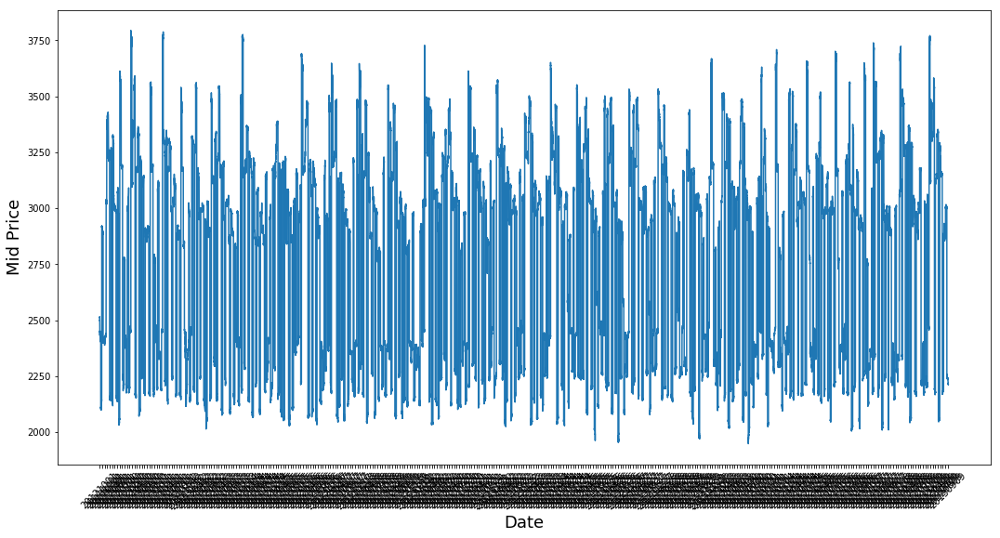

In [10]:
plt.figure(figsize = (18,9))
plt.plot(range(df.shape[0]),(df['Low']+df['High'])/2.0)
plotrange = 500
plt.xticks(range(0,df.shape[0],plotrange),df['Date'].loc[::plotrange],rotation=45)
plt.xlabel('Date',fontsize=18)
plt.ylabel('Mid Price',fontsize=18)
plt.show()

### Helper functions can be found here
This section contains the generic function used in this notebook.

In [11]:
# https://stackoverflow.com/questions/9489078/how-to-split-a-huge-csv-file-based-on-content-of-first-column
import csv
from itertools import groupby

def split_excel_to_csv():
    datafile = 'FCPO_6_years_NUS.csv'
    modpath = getDataPath()
    datapath = join(modpath, datafile)
    csv_header = 'Date,Time,DateTime,Open,High,Low,Close,Volume'
    reader = csv.reader(open(datapath))
    next(reader)
    for key, rows in groupby(reader,lambda row: row[0]):
        if key[-1] in ["1","2","3"]:
            outputpath = join(modpath,"Test","{}.csv".format(key))
        else:
            outputpath = join(modpath,"Prod","{}.csv".format(key))
        with open(outputpath, "w") as output:
            output.write(csv_header + "\n")
            for row in rows:
                row.pop(0) # remove the key
                output.write(",".join(row) + "\n")
                
#split_excel_to_csv()

In [12]:
def writeToCsv(filepath, data):
    ''' Generate a csv file which contains the seven fuzzy extent centroid value'''
    with open(filepath,'w') as f:
        #print ("max {} and min {}".format(max(data), min(data)))
        f.write(",".join(map(str,splitDataToSevenExtents(data))))
        
def loadFromCsv(filepath):
    ''' Load the previous stored fuzzy extent values from csv file'''
    with open(filepath, 'rt') as f:
        reader = csv.reader(f)
        return list(map(float,[r for r in reader][0]))

In [13]:
def splitDataToSevenExtents(data):
    ''' Split a list of array into seven parts meant for the fuzzy extent later
        Calculate the central point and also the std dev '''
    # get the max and min
    max_point = max(data)
    # split the positive into three parts
    min_point = min(data)
    # split the negative into three parts
    pos_part = 0
    if max_point > 0:
        pos_part = math.ceil(max_point / 3)
    neg_part = 0
    if min_point < 0:
        neg_part = math.floor(min_point / 3)
    
    return [neg_part * 3,
            neg_part * 2,
            neg_part,
            0,
            pos_part,
            pos_part * 2,
            pos_part * 3]

In [14]:
def generateAllCombinationsIndividuals():
    ''' Use to cache the fuzzy system model'''
    inds = ['sma','ama','tma','tpma']
    m = np.array([10, 20, 50, 100, 150, 200])
    n = np.array([3,5,10,15,20])
    ext = "M"
    rec = 0
    count = 0
    pop = dict()
    for count,i in enumerate(inds):
        rules = []
        for slow in m:
            for fast in n:
                if fast < slow:
                    rule = [i, fast, slow, ext, rec]
                    rules.append(rule)
                    
        pop[count] = {"individual":np.array(rules)}
    return pop
        
#generateAllCombinationsIndividuals()

In [15]:
def generateRandomRule():
    ''' generate one random rule'''
    inds = ['sma','ama','tma','tpma']
    m = np.array([10, 20, 50, 100, 150, 200])
    n = np.array([3,5,10,15,20])
    exts = ['VL','EL','L','M','H','VH','EH']
    neg = np.arange(-1,0,0.1)
    med = np.arange(-1,1,0.1)
    pos = np.arange(0,1,0.1)
    precision = 2

    sel_ext = random.choice(exts)
    rec = 0
    if sel_ext in ['VL','EL','L']:
        rec = round(random.choice(neg), precision)
    elif sel_ext in ['M']:
        rec = round(random.choice(med), precision)
    else:
        rec = round(random.choice(pos), precision)
        
    fast = random.choice(n)
    slow = random.choice(m[m>fast])

    return [random.choice(inds), fast, slow, sel_ext, rec]
    
#print (generateRandomRule())

def generateRandomIndividual():
    rules = []
    total_rules = 10
    for i in range(0,total_rules):
        rules.append(generateRandomRule())
    
    return {"individual":np.array(rules)}

#print (generateRandomIndividual())

def generateRandomPopulation(size=20):
    population = dict()
    for i in range(0,size):
        population[i] = generateRandomIndividual()
    return population

#pop= generateRandomPopulation()

In [16]:
# https://stackoverflow.com/questions/5998245/get-current-time-in-milliseconds-in-python
def getStartTime():
    t0 = time.time()
    return t0

def getEndTime(t0, funcName, threshold=50):
    t1 = time.time()
    totaltime = (t1-t0) * 1000 # in micro seconds
    if totaltime > threshold:
        print ("Total running time for function {} is {} ms".format(funcName,totaltime))
       # raise
    return totaltime

### Fuzzy Logic rule
The moving average provides the buy or sell signals. If we only use the moving average strategy,we must make decisions
immediately when the two moving average lines cross over. This method has large risks and may cause extra costs and
losses. Some researchers set a range parameter to make decisions until the differences of the two moving averages exceed
a certain range. By using the fuzzy logical rule, we cannot only set a range parameter, but also make the parameter change
along with different situations. The fuzzy logic rule is essential to precisely describe and process the fuzziness object. It extends the ordinary set, which take two values (0 and 1). The fuzzy set can take infinite values of [0, 1]. In addition, the concept ‘‘membership’’ is used to accurately portray the relation between elements and the fuzzy set.

In [17]:
def buildFuzzySystem(arr, bShowPlot=False, bDebug=False):
    '''Given an array of value, build and return a fuzzy system'''
    # New Antecedent/Consequent objects hold universe variables and membership functions

    feModel = ctrl.Antecedent(np.arange(arr[0], arr[-1], 0.1), 'feModel')
    recModel = ctrl.Consequent(np.arange(-1, 1, 0.1), 'recModel')

    recModel["Neg"] = fuzz.pimf(recModel.universe, -1, -1, -1, 0)
    recModel["Med"] = fuzz.pimf(recModel.universe, -1, 0, 0, 1)
    recModel["Pos"] = fuzz.pimf(recModel.universe, 0, 1, 1, 1)
    
    feModel["EL"] = fuzz.pimf(feModel.universe, arr[0], arr[0], arr[0],arr[1])
    feModel["VL"] = fuzz.pimf(feModel.universe, arr[0], arr[1], arr[1], arr[2])
    feModel["L"] = fuzz.pimf(feModel.universe, arr[1], arr[2], arr[2], arr[3])
    feModel["M"] = fuzz.pimf(feModel.universe, arr[2], arr[3], arr[3], arr[4])
    feModel["H"] = fuzz.pimf(feModel.universe, arr[3], arr[4], arr[4], arr[5])
    feModel["VH"] = fuzz.pimf(feModel.universe, arr[4], arr[5], arr[5], arr[6])
    feModel["EH"] = fuzz.pimf(feModel.universe, arr[5], arr[6], arr[6], arr[6])

    if bShowPlot:
        recModel.view()
        feModel.view()
    
    if bDebug:
        print (type(recModel))
        print (type(feModel))

    #build the rules
    rule1 = ctrl.Rule(feModel["EL"] | feModel["L"] | feModel["VL"], recModel["Neg"])
    rule2 = ctrl.Rule(feModel["M"], recModel["Med"])
    rule3 = ctrl.Rule(feModel["EH"] | feModel["H"] | feModel["VH"], recModel["Pos"])
    
    ctrl_sys = ctrl.ControlSystem([rule1, rule2, rule3])
    ctrl_instance = ctrl.ControlSystemSimulation(ctrl_sys)
    
    return ctrl_instance, feModel, recModel

In [18]:
def getFuzzyOutput(ctrl_instance, feModel, recModel, input_val, bShowPlot=False, bDebug=False):
    ''' Given the fuzzy system and the input value, compute and return the mf and the fuzzy extent'''

    ext = ""
    rec = 0
    ants = []
    try:
        ctrl_instance.input['feModel'] = input_val
        ctrl_instance.compute()

        if bShowPlot:
            recModel.view(sim=ctrl_instance)
            feModel.view(sim=ctrl_instance)
    
        ants = ctrl_instance.get_antecedents()
        
        if bDebug:
            print (type(recModel))
            print (type(feModel))
            #print (ctrl_instance.print_state())
 
        ext = ""
        if ants:
            ext = max(ants, key=ants.get)
            rec = ctrl_instance.output['recModel']
    except:
        print("Input val:{}. fe:{}, rec:{}, ctrl:{}".format(input_val, feModel, recModel,type(ctrl_instance)))
        print ("Type ants:{} and content:{}".format(type(ants), ants))
        exc_type, exc_obj, exc_tb = sys.exc_info()
        fname = os.path.split(exc_tb.tb_frame.f_code.co_filename)[1]
        print("Exception type:{}, File name:{} and line no:{}".format(exc_type, fname, exc_tb.tb_lineno))
        #TODO: Handle this error properly
        raise
    
    return (rec, ext)

In [19]:
def getFuzzyExtent(farr, val):
    ''' Given the values for the extent zones, return the matching extent name'''
    exts = ['VL','EL','L','M','H','VH','EH']
    zones = list(zip(farr,exts))
    
    #print (zones[0][0])
    
    for i, f in enumerate(zones):
        if val > zones[i-1][0] and val < zones[i][0]:
            #print ("My ext is:{}".format(f[1]))
            return f[1]

The difference between two moving averages is divided to 7 extents: Extremely Low (EL), Very Low (VL), Low (L), Middle
(M), High (H), Very High (VH), and Extremely High (EH). The extent division is based on the previous data. For example, if
the experimental data are in 2004, we need to calculate the moving average differences in 2003 and sort the entire year’s
differences in order from low to high. The lowest number is P1, and the highest number is P7.

To distinguish the upward and downward trend, we set the P4 value nearest to 0. The values less than 0 are divided into three parts of the same amount. The values greater than 0 are also treated in the same manner. Thus, the P1, P2 and P3 are less than or all equal to zero. In contrast, the P5, P6 and P7 are more than or all equal to zero. With these points, we can obtain our membership function.

In this paper, we choose a quadratic function because it performs better than a linear function, which can improve the recommended level. Thereafter, we shall calculate the moving average differences of every trading day in training data, and decide to which extent and on which range it falls.

One fuzzy logic rule contains an if part and a then part. Here we set the moving average method, the length of two periods,
the fuzzy extent as the if part, and the recommend value as then part. Multiply the degree value by the recommendation value. The result is the rating level that this fuzzy logic rule gives. It is worthy of attention that we set the recommend values of the first three fuzzy extents as positive numbers and the recommend values of the last three
fuzzy extents as negative numbers to obtain better performance.

H
<class 'skfuzzy.control.antecedent_consequent.Consequent'>
<class 'skfuzzy.control.antecedent_consequent.Antecedent'>
<class 'skfuzzy.control.antecedent_consequent.Consequent'>
<class 'skfuzzy.control.antecedent_consequent.Antecedent'>


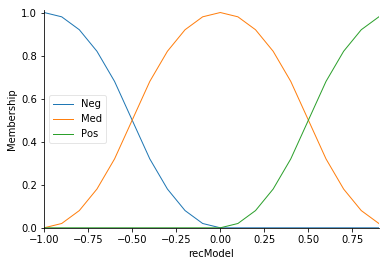

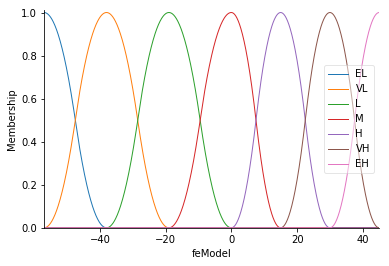

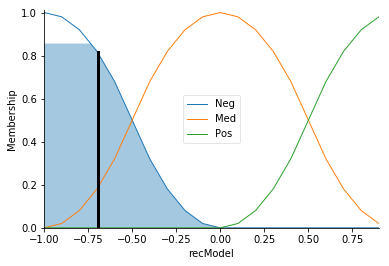

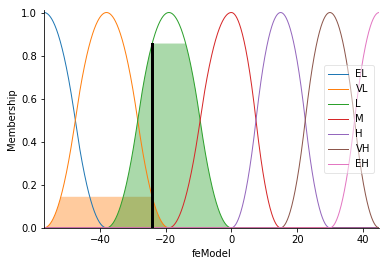

In [20]:
def testFuzzyLogic():
    #Input val:-1.6666666666669698. fe:Antecedent: fe, rec:0
    bShowPlot= True
    bDebug = True
    diffval = -24.0992834873864
    ind_type = "tpma"
    fast = "15"
    slow = "50"
    modpath = getDataPath()    
    filename = "{}_{}_{}.csv".format(ind_type, fast, slow)
    filepath = join(modpath,"Model",filename)  
    farr = loadFromCsv(filepath) 
    #print (farr)
    
    val = 10
    print (getFuzzyExtent(farr, val))
    
    fuzsys, fe, rec = buildFuzzySystem(farr, bShowPlot=bShowPlot, bDebug=bDebug)
    #print (filename)
    mf, ext = getFuzzyOutput(fuzsys, fe, rec, diffval, bShowPlot=bShowPlot, bDebug= bDebug)
    
testFuzzyLogic()


### Moving average strategy
The principle of the moving average strategy is to use the relative position of a long-term moving average line and a
short-term moving average line to estimate the market trend. When the short-term moving average line is above the longterm
moving average line, the strategy believes that the market price is increasing. Conversely, when the long-term moving
average line surpasses the short-term line, the market price is believed to be decreasing.

These moving averages have different calculation methods and have different performances. In this paper,
four MA are chosen which are SMA, AMA, TPMA, and TMA.

Besides the standard simple moving average, we also need to setup:
1. Adaptive moving average
1. Typical Price moving average
1. Triangular moving average

The moving average strategy calculates the moving averages of two periods, a short-term period and a long-term period.
In this paper, we use n and m to represent the two periods. If the moving average of n (the short period) exceeds the moving average of m (the long period), the price series can be regarded as having a rising trend and vice versa. 
In this paper, we select 6 n values and 6 m values, as shown in formula (5). Therefore, there are 32 different combinations of m and n since value m must be greater than value n.
* m ∈ {10, 20, 50, 100, 150, 200},
* n ∈ {1, 3, 5, 10, 15, 20}.

In [21]:
class TypicalPriceMovingAverage(bt.Indicator):
    lines = ('tpma',)
    params = (('period', 20),)

    def __init__(self):
        self.addminperiod(self.params.period)

    def next(self):
        dataline = self.data.get(size=self.p.period)
        datasum = max(dataline) + min(dataline) + dataline[-1]
        self.lines.tpma[0] = datasum/3

### Fitness function calculation
We will be using the following formula as per the paper to implement the rate of calculation with a slight modification. 
As the cost is already handled by the backtrader platform, we will exclude that from the calculation.
However for the risk free rate, we will be following Malaysia's central bank government securities yield with an interest rate of 3.28% to calculate the formula.

rreturn = (profit + riskfree − cost)/capital. (12)
Variable rreturn means rate of return. Variable profit indicates the money earned from the trade of crude oil futures
contracts. Variable riskfree means risk free return. Variable cost indicates the cost of handling charge. Constant capital means the initial capital the trader has in beginning.

In [22]:
cachedFuzModel = dict() #global cache for fuzzy model

def getDictKeySafeName(val):
    return (str(val).replace("-","neg").replace(".","dot"))

def getCachedFuzModel(fuzKey):
    ''' Caching the fuzzy model output to improve the performance'''
    bExist = False
    fuzKey = getDictKeySafeName(fuzKey)
    mf = ""
    ext = ""
    if bool(cachedFuzModel) and fuzKey in cachedFuzModel.keys():
        mf = cachedFuzModel[fuzKey]["mf"]
        ext = cachedFuzModel[fuzKey]["ext"]
        bExist = True
        
    return bExist, mf, ext

def storeCachedFuzModel(fuzKey, mf, ext):
    ''' Store a new fuzmodel info into the cache'''
    fuzKey = getDictKeySafeName(fuzKey)
    if bool(cachedFuzModel) and not fuzKey in cachedFuzModel.keys():
        cachedFuzModel[fuzKey] = {"mf":mf, "ext":ext}

    
#testdict = dict()
#testdict["Training_tma_3_200_129.5399009900989"] = 1

In [23]:
class FMASCrossOver(bt.Strategy):
    """A simple moving average crossover strategy; crossing of a fast and slow moving average generates buy/sell
       signals"""
    params = {"individual":[],
              "filePath": "",
              "bBenchmark": False, #benchmark speed of each function
              "bSilentMode":False, #no logging
              "bDebug":False, #debug printout mode
              "bFuzzyPlot": False, #show fuzzy plot
              "bGenMaDiffFiles": False, #generate ma diff files for fuzzy extent building
              "bGetRating": False} #get overall rating for individual
    
    def calcRateOfReturn(self, value, cash, capital):
        ''' used available cash against the treasury interests'''
        '''http://www.bnm.gov.my/index.php?tpl=2014_govtsecuritiesyield'''
        ''' assume the trading period is for the whole of the short term interest'''
        shortTermBillInterests = 0.0328
        return ((value + (cash * shortTermBillInterests))/capital)
    
    def getWritePath(self, ind_type, fast, slow):
        modpath = getDataPath()
        filename = "{}_{}_{}.csv".format(ind_type, fast, slow)
        filepath = join(modpath ,"Model", filename)
        return filepath
        
    def getFuzzyModel(self, ind_type, fast, slow, bShowPlot = False):
        t0 = 0
        if self.p.bBenchmark: 
            t0 = getStartTime()
        filepath = self.getWritePath(ind_type, fast, slow)        
        farr = loadFromCsv(filepath)
        fuzsys, fe, rec = buildFuzzySystem(farr, bShowPlot=bShowPlot)
        if self.p.bBenchmark:
            getEndTime(t0, "getFuzzyModel")
        return fuzsys, fe, rec, farr

    def getFuzzyPosition(self, fuzsys, fe, rec, diffval, bShowPlot = False):
        t0 = 0
        #if self.p.bBenchmark: 
        #    t0 = getStartTime()
        mf, ext = getFuzzyOutput(fuzsys, fe, rec, diffval, bShowPlot=bShowPlot)
        
        #if self.p.bBenchmark:
        #    getEndTime(t0, "getFuzzyPosition")
        return mf, ext
    
    def getLotSize(self, modal, price, rating, maxlotsize=0.02):
        #return min((modal/price)*rating, maxlotsize*modal)
        return (modal/price)*rating
    
    def setIndicator(self, ma_type, period_val, ind_type, d):
        t0 = 0
        if self.p.bBenchmark: 
            t0 = getStartTime()
        
        plottitle = "SlowMA: "
        #period_val = self.params.slow
        #ind_type = self.p.ind
        if ma_type == "fast":
            plottitle = "FastMA: "
         #   period_val = self.params.fast
            
        datafeed = self.getdatabyname(d)
        
        if self.p.bDebug:
            print ("ind:{}, ma type:{}, period:{}".format(ind_type, ma_type, period_val))
        
        ma = None
        if ind_type == 'sma':
            ma = bt.indicators.SMA(datafeed,      # The symbol for the moving average
                                   period=period_val,    # Fast moving average
                                   plotname=plottitle + d)

        elif ind_type == "ama":
            #ma = bt.indicators.KAMA(datafeed,      # The symbol for the moving average
            #                        period=period_val,    # Fast moving average
            #                        plotname=plottitle + d)
            ma = bt.talib.KAMA(datafeed, timeperiod=period_val, 
                               plotname=plottitle + d)


        elif ind_type == "tma":
            ma = bt.talib.TRIMA(datafeed,      # The symbol for the moving average
                               timeperiod=period_val,    # Fast moving average
                               plotname=plottitle + d)
        elif ind_type == "tpma":
            ma = TypicalPriceMovingAverage(datafeed,      # The symbol for the moving average
                                           period=period_val,    # Fast moving average
                                           plotname=plottitle + d)
        if self.p.bBenchmark:
            getEndTime(t0, "setIndicator")
        return ma

    def log(self, txt, dt=None):
        ''' Logging function for this strategy'''
        if not self.p.bSilentMode:
            #TODO: Fix the datas[0] hardcoding later
            dt = dt or self.datas[0].datetime.date(0)
            print('%s, %s' % (dt.isoformat(), txt))

    def __init__(self):
        """Initialize the strategy"""
        
        self.bStopRunning = False
        
        self.fastma = dict()
        self.slowma = dict()
        self.regime = dict()
        self.extent = dict()
        self.recommend = dict()
        
        # only use to build the fuzzy extent files
        self.madiff = dict()
        
        # To keep track of pending orders and buy price/commission
        self.order = None
        self.buyprice = None
        self.buycomm = None
        self.initialCapital = 0
        self.shortPosition = 0
        self.shortMaxLimit = -5000000 #Accumulated short position’s original market value is capped at 5million Ringgit.
        
        self.cachedFuzModel = dict()
        self.cachedExtents = dict()
        self.fuzsysModel = dict()
        self.feModel = dict()
        self.recModel = dict()
 
        # self._addobserver(True, bt.observers.BuySell)    # CAUTION: Abuse of the method, I will change this in future code (see: https://community.backtrader.com/topic/473/plotting-just-the-account-s-value/4)
        t0 = 0
        if self.p.bBenchmark: 
            t0 = getStartTime()
            
        for d in self.getdatanames():
 
            key = ""
            for rule in self.p.individual["individual"]:
                indtype = rule[0]
                fast = rule[1]
                slow = rule[2]
                extent = rule[3]
                recommend = rule[4]
                # The moving averages
                key = "{}_{}_{}_{}".format(d,indtype,fast,slow)
                self.fastma[key] = self.setIndicator("fast",int(fast), indtype,d)
                self.slowma[key] = self.setIndicator("slow",int(slow), indtype,d)
                self.madiff[key] = []
                #ma_type, period_val, ind_type, d
                
                # Get the regime
                self.regime[key] = self.fastma[key] - self.slowma[key]    # Positive when bullish
                self.extent[key] = extent
                self.recommend[key] = float(recommend)               
                self.fuzsysModel[key], self.feModel[key], self.recModel[key], self.cachedExtents[key] \
                    = self.getFuzzyModel(indtype,fast,slow, bShowPlot=self.p.bFuzzyPlot)
        
        if self.p.bBenchmark:
            getEndTime(t0, "__init__")
        
    def next(self):
        #skip the rest of the data after we can get the rating
        if self.bStopRunning:
            return
        
        t0 = 0
        if self.p.bBenchmark: 
            t0 = getStartTime()
        
        # Check if an order is pending ... if yes, we cannot send a 2nd one
        if self.order:
            return
        
        if self.initialCapital == 0:
            self.initialCapital = self.stats.broker.cash[0]
        
        #Loop through each data feed
        for i, d in enumerate(self.datas):
            dt, dn = self.datetime.date(), d._name
            pos = self.getposition(d).size
            
            key = ""
            ratings = []
            #loop through each rules within this individual
            for rule in self.p.individual["individual"]:
                key = "{}_{}_{}_{}".format(dn,rule[0],rule[1],rule[2])
            
                # for generate ma diff files, we want to collect all the ma diff for a particular key
                if self.p.bGenMaDiffFiles:
                    self.madiff[key].append(self.regime[key][0])
                    if self.p.bDebug:
                        self.log("Regime: {}".format(self.regime[key][0]))                 
                else:
                    try:
                        #check if the given extent matches based on the value
                        if key in self.cachedExtents.keys():
                            matchExt = getFuzzyExtent(self.cachedExtents[key], self.regime[key][0])
                            # skip if non matching
                            #print ("Matching:{} and extent:{}".format(matchExt, self.extent[key]))
                            if matchExt != self.extent[key]:
                                #print("breaking when match {} and ext {}".format(matchExt, self.extent[key]))
                                break
                        
                        fuzKey = "{}_{}".format(key, self.regime[key][0])
                        bExist, mf, ext = getCachedFuzModel(fuzKey)
                        
                        if not bExist:              
                            mf,ext = self.getFuzzyPosition(self.fuzsysModel[key], self.feModel[key],\
                                                           self.recModel[key], 
                                                           self.regime[key][0], bShowPlot=self.p.bFuzzyPlot)
                            storeCachedFuzModel(fuzKey, mf, ext)
                            
                        # get the fe and recommended value based on past data
                        # check if the fe are the same 
                        rating = 0
                        if(ext == self.extent[key]):
                            # if it is then calculate the overall rating per rule
                            rating = mf * self.recommend[key]
                            ratings.append(rating)
                    #        if self.p.bDebug:
                   #             print ("Rating:{} and extent:{} for key:{}".format(rating,ext, key))
                            
                    except:
                        exc_type, exc_obj, exc_tb = sys.exc_info()
                        print ("fuzkey:{}".format(fuzKey))
                        print("Exception type:{} and line no:{}".format(exc_type, exc_tb.tb_lineno))
                        #print ("Rating:{} and extent:{} for key:{}".format(rating,ext, key))
                        raise
            
            if not self.p.bGenMaDiffFiles and ratings:
                #calculate the rating at individual level
                avg_rating = np.average(ratings)
                if not math.isnan(avg_rating) and self.p.bDebug:
                    print ("Average rating:{} and pos is:{} for key:{}".format(avg_rating, pos, key))


                # for bGetRating mode, we just want to get the rating for the individual and exit
                if (avg_rating > 0 or avg_rating < 0): # and self.p.bGetRating:
                    self.p.individual["rating"] = avg_rating
                #    print ("EXITING THE PROGRAM")
                #    self.bStopRunning = True
                #else:
                    if avg_rating > 0:    # A buy signal
                        # BUY, BUY, BUY!!! (with default parameters)
                        self.log('%s BUY CREATE, %.2f with volume %.2f' % (dn, d.high[0], d.volume[0]), 
                                 dt=d.datetime.date(0))
                        buySize = self.getLotSize(self.initialCapital,d.high[0],avg_rating)
                        
                        #reduce the short position
                        self.shortPosition = self.shortPosition - (d.high[0] * buySize)
                        
                        # Keep track of the created order to avoid a 2nd order
                        self.order = self.buy(data=d, price=d.high[0], size = buySize)
                    #No trade when avg_rating is 0
                    elif avg_rating < 0:    # A sell signal
                            # SELL, SELL, SELL!!! (with all possible default parameters)
                            self.log('%s SELL CREATE, %.2f with volume %.2f' % (dn, d.low[0], d.volume[0]), 
                                     dt=d.datetime.date(0))
                            
                            bSkipSelling = False
                            sellSize = self.getLotSize(self.initialCapital,d.low[0],avg_rating)
                            #Check if this is a short sell and handle it separately
                            if self.p.bDebug:
                                print ("Position is {}, sell size {} and short sell position is:{}".format(pos, sellSize, self.shortPosition))
                            
                            if pos < sellSize:
                                #negative open short position must be lesser than the max limit
                                if self.shortPosition + (d.low[0] * sellSize) < self.shortMaxLimit:
                                    bSkipSelling = True
                                    self.log("Skip short selling as limit {} has been hit with total position {} and new short sell lot size : {}".format(
                                        self.shortMaxLimit, self.shortPosition, d.low[0] * sellSize))
                                else:
                                    #increase the short position
                                    self.shortPosition = self.shortPosition + d.low[0] * sellSize
                                    
                            if not bSkipSelling:
                                # Keep track of the created order to avoid a 2nd order
                                self.order = self.sell(data=d, price=d.low[0], size = sellSize)
            else:
                self.p.individual["rating"] = 0
        try:
            if self.p.bBenchmark:
                getEndTime(t0, "next")
        except:
            exc_type, exc_obj, exc_tb = sys.exc_info()
            print("Exception type:{} and line no:{}".format(exc_type, exc_tb.tb_lineno))           
            #print ("Key:{}".format(key))
            #print ("Average rating:{} and pos is:{} for key:{}".format(avg_rating, pos, key))

                    
    def notify_order(self, order):
        t0 = 0
        if self.p.bBenchmark:
            t0 = getStartTime()
        
        if order.status in [order.Submitted, order.Accepted]:
            # Buy/Sell order submitted/accepted to/by broker - Nothing to do
            return

        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log('BUY EXECUTED, Size: %.2f, Price: %.2f, Cost: %.2f, Comm %.2f, Portfolio Value: %.2f, Cash: %.2f' %
                    (order.executed.size,
                     order.executed.price,
                     order.executed.value,
                     order.executed.comm,
                     self.stats.broker.value[0],
                     self.stats.broker.cash[0]))

                self.buyprice = order.executed.price
                self.buycomm = order.executed.comm
            elif order.issell():
                self.log('SELL EXECUTED, Size: %.2f, Price: %.2f, Cost: %.2f, Comm %.2f, Portfolio Value: %.2f, Cash: %.2f' %
                         (order.executed.size,
                          order.executed.price,
                          order.executed.value,
                          order.executed.comm,
                         self.stats.broker.value[0],
                         self.stats.broker.cash[0]))

            self.bar_executed = len(self)

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')

        # Write down: no pending order
        self.order = None
        
        if self.p.bBenchmark:
            getEndTime(t0, "notify_order")
    
    def notify_trade(self, trade):
        t0 = 0
        if self.p.bBenchmark:
            t0 = getStartTime()
        
        if not trade.isclosed:
            return

        self.log('OPERATION PROFIT, GROSS %.2f, NET %.2f' %
                 (trade.pnl, trade.pnlcomm))
        
        if self.p.bBenchmark:
            getEndTime(t0, "notify_trade")
        
    def stop(self):
        t0 = 0
        if self.p.bBenchmark:
            t0 = getStartTime()
        
        if self.p.bGenMaDiffFiles:
            for i, d in enumerate(self.datas):
                dt, dn = self.datetime.date(), d._name

                key = ""
                #loop through each rules within this individual
                for rule in self.p.individual["individual"]:
                    key = "{}_{}_{}_{}".format(dn,rule[0],rule[1],rule[2])

                    writePath = self.getWritePath(rule[0],rule[1],rule[2])
                    writeToCsv(writePath, self.madiff[key])
                    #self.log(len(self.madiff_arr))
            return
        
        # else get the cash for a normal trade
        if "rating" not in self.p.individual.keys():
            self.p.individual['rating'] = 0
        # add the final profit value to the individual
        self.p.individual['profit'] = self.stats.broker.value[0]
        self.p.individual['ror'] = self.calcRateOfReturn(self.stats.broker.value[0],
                                                            self.stats.broker.cash[0], self.initialCapital)
        if self.p.bBenchmark:
            getEndTime(t0, "stop")
        

In [24]:
#from report import Cerebro

#if __name__ == '__main__':
def main(individual, bGetRating= False, plotFileName = "", bDebug=False, 
         bFuzzyPlot=False, bSilentMode=False,bGenMaDiffFiles=False, bTestMode=True,
         bBenchmark=False):
    # Create a cerebro entity
    cerebro = bt.Cerebro()
    
    # Add a strategy
    cerebro.addstrategy(FMASCrossOver, individual=individual, bGetRating=bGetRating,bDebug=bDebug,
                        bFuzzyPlot=bFuzzyPlot,bSilentMode=bSilentMode,bGenMaDiffFiles=bGenMaDiffFiles,
                       bBenchmark=bBenchmark)

    # Create a Data Feed
    setup_multiple_data(bt, cerebro, bTestMode)

    setup_platform(cerebro)

    # Print out the starting conditions
    if not bSilentMode:
        print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

    # Run over everything
    cerebro.run()

    # Print out the final result
    print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())
    
    return cerebro

    # Plot the result
    if not plotFileName == "":
        imagefile = "graph{}.png".format(plotFileName)
        datapath = join(getDataPath(),"Graph",imagefile)
        cerebro.plot(style='candlestick', iplot=False, ytight=True, subplot=False, path=datapath)

In [25]:
#generate an individual that has all the combinations for indicator type, fast and slow
# Build and cache all the fuzzy models
def writeAllFuzzyExtentsToFiles():
    inds = generateAllCombinationsIndividuals()
    for ind in inds.values():
        main(ind, bSilentMode=True, bDebug=True,bGenMaDiffFiles=True)

In [26]:
def testMainOne():
    pind = {'individual': [['ama', '10', '150', 'VH', '0.1'],
           ['ama', '5', '200', 'EH', '0.5'],
           ['ama', '3', '10', 'EH', '0.7000000000000001'],
           ['tma', '3', '50', 'VH', '0.2'],
           ['tma', '15', '200', 'VL', '-0.5000000000000001'],
           ['tpma', '15', '200', 'VL', '-0.5000000000000001'],
           ['tma', '15', '150', 'EH', '0.4'],
           ['ama', '3', '20', 'M', '0.19999999999999973'],
           ['sma', '3', '100', 'VH', '0.1'],
           ['tpma', '15', '50', 'VL', '-0.40000000000000013']]}
    #build the fuzzy model on the first run
    #main(pind, bSilentMode=True,bGenMaDiffFiles=True)
    t0 = getStartTime()
    main(pind, bSilentMode=True, bDebug=False, bBenchmark=True)
    t1 = getEndTime(t0, "main")
    print (pind)

### Strategy starts here
1. Generate the initial population. Randomly generate 20 individuals. Each individual contains 10 rules in accordance with the rules set.
1. Calculate the fuzzy moving averages in the training period. Calculate the differences between two moving averages in the training period and the previous training period using the moving average method and the length of two moving averages that the rule provides. 
1. Next, obtain the membership function according to the moving average differences of the previous training period. 
1. Calculate the rating level according to the moving average differences of this training period, the membership function, and the recommend values that the individual provides. Because every individual provides a set of recommend values, there are ultimately 20 sets of rating levels.

In [27]:
pop= generateRandomPopulation()
#for individual in pop.items():
    #individual = np.append(individual,["ST"])
#    print (individual)

#print (pop[1])
i = 1
runName = ""
for ind in pop.values():
    #print (ind)
    t0 = getStartTime()
    print ("Starting run: {}".format(i))
    main(ind, bSilentMode=True, bBenchmark = True)
    i = i+1
    getEndTime(t0, "main")
    
#print(params[:,0],params[:,1], params[:,2], params[:,3], params[:,4])
#main(params[:,0],params[:,1], params[:,2], params[:,3], params[:,4])
#main(pop[1], bBestIndv=True)

Starting run: 1
Total running time for function __init__ is 98.9534854888916 ms
Final Portfolio Value: 10000000.00
Total running time for function main is 291622.24769592285 ms
Starting run: 2
Total running time for function __init__ is 100.95882415771484 ms
Final Portfolio Value: 7637163.68
Total running time for function main is 182988.47556114197 ms
Starting run: 3
Total running time for function __init__ is 100.97217559814453 ms
Total running time for function next is 83.95743370056152 ms
Total running time for function next is 104.6457290649414 ms
Total running time for function next is 126.30605697631836 ms
Total running time for function next is 215.70777893066406 ms
Total running time for function next is 220.11542320251465 ms
Total running time for function next is 265.52724838256836 ms
Total running time for function next is 384.0749263763428 ms
Total running time for function next is 417.3605442047119 ms
Total running time for function next is 502.683162689209 ms
Final Portf

5. Select the best individual in the training period. Calculate the trading volume using the initial capital and the rating degree. Then, calculate the rate of return according to the rate of return calculation method provided above. Every individual has a rate of return. The one that has the highest rate of return is the best individual in the training period.
1. Calculate the rate of return in the selection period using the best individual in the training period. Calculate the differences between the two moving averages of this selection period and the previous selection period. Then, obtain the membership function and calculate the rating level and the rate of return.
1. Mark the best individual. In the first cycle, mark the rate of return as the best rate of return and the best individual in the training period as the overall best individual. From the second cycle, compare the rate of return in this loop and the best rate of return. If the rate of return from this loop is higher than the best individual in the last loop, and the gap is over 0.05, replace the best rate of return and the overall best individual.

In [28]:
def printPopulation(pop):
    #Display the population after the ror has been added
    i = 1
    runName = ""
    for ind in pop.values():
        #print (ind)
        print ("Individiual with rating:{}, profit:{}, ror:{}".format(ind["rating"], ind["profit"], ind["ror"]))    


#printPopulation(pop)
        
def getBestIndividual(pop):
    ''' Given a population return the best individual based on ror'''
    # Show the best individual
    listOfKeys = [key  for (key, value) in pop.items() if value['ror'] == max(d['ror'] for d in pop.values())]
    #print (listOfKeys)
    bestIndividual = pop[listOfKeys[0]]
    return bestIndividual

# Print the best individual
print ("Best individual is:\n{}".format(getBestIndividual(pop)))

Best individual is:
{'individual': array([['ama', '5', '200', 'M', '0.9'],
       ['tpma', '5', '200', 'VH', '0.1'],
       ['ama', '15', '20', 'EL', '-0.5'],
       ['ama', '5', '100', 'VL', '-0.4'],
       ['tma', '5', '150', 'EL', '-0.8'],
       ['sma', '10', '200', 'VH', '0.9'],
       ['sma', '20', '50', 'VL', '-0.4'],
       ['tpma', '20', '100', 'VL', '-0.5'],
       ['tpma', '10', '200', 'VH', '0.9'],
       ['ama', '10', '150', 'EL', '-0.8']],
      dtype='<U4'), 'rating': -0.0050212024811177166, 'profit': 11758397.687621295, 'ror': 1.1931798349619276}


### Genetic algorithms
the moving average method has four options. The values of n andmhave 32 options. The fuzzy extent
has seven options and the recommend value has 21 options (range from−1 to 1, and the interval is 0.1). Since the first three fuzzy extents solely cause negative recommend values, and the last three solely cause positive values, we will finally have 11 136 types of rules, as shown in formula (6). We choose 10 of these as a set. There are approximately 8.05 ∗ 1033 sets.

Genetic algorithms can search the optimal solutions by using the processes of selection, crossover and
mutation. Compared with other optimization algorithms such as neural network or partial swarm optimization, genetic
algorithms method has a transparent mechanism and a lower possibility of local convergence. Since we need the
estimates of all parameters in the intermediate process, the genetic algorithms method is more suitable and adopted for this paper. In the genetic algorithms, the fuzzy sets are called individuals. The collection of individuals is called a population. In this paper, every population contains 20 individuals.

In [29]:
def testGeneratePopulationForGA():
    pop= generateRandomPopulation()
    #print (pop[0])
    # add ror and rating for testing
    for ind in pop.values():
        ror = random.uniform(0,2)
        profit = random.uniform(9000000,13000000)
        rating = random.uniform(-1,1)
        ind["ror"] =ror 
        ind["profit"] = profit
        ind["rating"] =rating
        #print (ind)    
        #print ("ror:{}, profit:{} and rating:{}".format(ror, profit, rating))
    return pop

1. Conduct a population evolution. Use genetic algorithms to choose 10% of the individuals from the old population in terms of their rate of return. Next, choose 80% of the individuals from the old population together with 10% randomly generated new individuals to experience the crossover and mutation. Finally, these two parts combined to form the new population.
1. Repeat Steps (4)–(6) for 50 repetitions. 
1. Calculate the rate of return of the best individual in the test period using the overall best individual selected in the previous steps. Calculate the two moving averages in this test period and the previous test period. Then, obtain the membership function and calculate the rating level and the rate of return.
1. Move forward to the next experiment period and return to step (1).

In [30]:
def generateGAPopulation(old_population, crossover_rate=0.7, mutation_rate = 0.01):
    idx = 0
    newpop = dict()
    #rws select 10% of the population
    first_select = 0.1
    skipCrossoverRate = 1
    
    for i in range(int(first_select * len(old_population))):
        newpop[i]=selectBasedOnRWS(old_population)
        newpop[i]["co_rate"] = skipCrossoverRate
        idx = i
    
    #rws select 80% of the population
    second_select = 0.8
    co_start = 0
    co_end = 0
    for i in range(int(second_select * len(old_population))):
        idx = idx + 1
        if co_start == 0:
            co_start = idx
        newpop[idx]=selectBasedOnRWS(old_population)
        newpop[idx]["co_rate"] = random.uniform(0,1)
        co_end = idx
        
    #print("start:{} and finish:{}".format(co_start,co_end))
    #start the crossover and mutation here
    co_idxs = [key  for (key, value) in newpop.items() if value['co_rate'] < crossover_rate]
    for i in range(0,len(co_idxs),2):
        crossOver(newpop[i], newpop[i+1])
        
    for i in range(len(co_idxs)):
        #generate a list of probability to determine which rules need to go through mutation
        mutRate = []
        for i in range(len(newpop[i]['individual'])):
            mutRate.append(random.uniform(0,1))

        mut_idxs = [mutRate.index(x) for x in mutRate if x < mutation_rate]
        # do the rule mutation swap
        for j in range(0,len(mut_idxs),2):
             mutationSwap(newpop[i]['individual'][j], newpop[i]['individual'][j+1])
        
        #do the mutation bit flip
        for j in range(len(mut_idxs)):
            mutation(newpop[i]["individual"][j])
        
    # generate two new individuals
    third_select = 0.1
    for i in range(int(third_select * len(old_population))):
        idx = idx + 1
        newpop[idx]=generateRandomIndividual()
        newpop[idx]["co_rate"] = skipCrossoverRate

    return newpop

After one experiment of one generation, the population needs to evolve. We take the rate of return as the fitness value
and use Roulette Wheel Selection (RWS) to choose 10% of the 20 individuals from the old population. They are most likely
the two best individuals. We retain the two individuals as the first part of the new population. The second part of the new
population is two individuals that are randomly generated. Then we continue use RWS to select 80% of the 20 individuals
from the old population which is mostly like the 16 best individuals. These 16 individuals need to go through crossover and
mutation to become the third part of the new population.

In [31]:
# RWS to select first two
# https://stackoverflow.com/questions/44430194/roulette-wheel-selection-with-positive-and-negative-fitness-values-for-minimizat
def selectBasedOnRWS(pop):
    ''' Populate the population with profit first'''
    criteria = 'ror'
    fitness_sum = sum(d[criteria] for d in pop.values())
    probability_offset = 0
    ratio = 0
    for ind in pop.values():
        ratio = (ind[criteria] / fitness_sum)
        ind['probability'] = probability_offset + ratio 
        probability_offset = ind['probability']
        #print ("Ror:{}, Sum:{}, Offset:{}, ratio:{} and %:{}".format(ind[criteria], fitness_sum, probability_offset,ratio, ind['probability']))
    
    r = random.uniform(0, probability_offset)
    #print ("r is {}".format(r))

    selected_ind = None # initialize
    for ind in pop.values():
        if ind['probability'] > r: 
            selected_ind = ind
            #print ("Selected:{}".format(selected_ind[criteria]/fitness_sum))
            return selected_ind

The mutation means a change within one rule and the exchange between two rules. The latter is also a type of crossover,
but it occurs within an individual. Therefore, we would call it mutation in this paper. For the former, the mutation probability is 0.01, which means a rule choice with a 0.01 probability and a spot randomly generated in the rule. Next, the binary string on the point changes from 0 to 1, or 1 to 0. The exchange between the two rules is similar to the
crossover process. The algorithm generates a spot and the part after the spot exchange,

In [32]:
def mutationSwap(rule1, rule2, bDebug=False):
    ''' switch rules with each other based on 0.01 mutation'''
    if bDebug:
        print (rule1)
        print (rule2)
    
    #generate a spot in the individual
    maxlen = len(rule1)
    i1 = random.sample(range(maxlen),1)[0]
    # add special handling for fast and slow - treated as a pair
    if i1 == 2: #have to take the fast param as well for swap
        i1 = 1
    # rules after the spot are swapped
    tmp = np.copy(rule2[i1:maxlen])
    tmp2 = np.copy(rule1[i1:maxlen])
    rule1[i1:maxlen] = tmp
    rule2[i1:maxlen] = tmp2
    
    if bDebug:
        print ("Index changes are on {}".format(i1))
        print (rule1)
        print (rule2)
    
    return rule1, rule2

In [33]:
def mutation(rule1, bDebug=False):
    ''' randomly replace one part of the rule'''
    rule2 = generateRandomRule()
    if bDebug:
        print (rule1)
        print (rule2)
    
    #generate a spot in the individual
    maxlen = len(rule1)
    i1 = random.sample(range(maxlen),1)[0]
    # add special handling for fast and slow - treated as a pair
    if i1 in [1,2]:
        rule1[1] = rule2[1]
        rule1[2] = rule2[2]
    else:
        # rules after the spot are swapped
        rule1[i1] = rule2[i1]
    
    if bDebug:
        print ("Index changes are on {}".format(i1))
        print (rule1)
        print (rule2)
    
    return rule1, rule2

In [34]:
def testMutationSwap():
    newpop = testGeneratePopulationForGA()
    #print (ind1['individual'])
    ind1 = newpop[0]
    print (ind1['individual'])
    maxlen = len(ind1['individual'])
    #print (maxlen)
    #generate a list of probability to determine which rules need to go through mutation
    mutRate = []
    for i in range(maxlen):
        mutRate.append(random.uniform(0,1))

    #print ([mutRate.index(x) for x in mutRate if x > 0.01])
    rules = ind1['individual']
    #print (rules[0][1:3])

    mutationSwap(rules[0], rules[1], bDebug=True)
    
#testMutationSwap()

In [35]:
def testMutation():
    mutation(rules[0], bDebug=True)

In [36]:
def testSelectBasedOnRWS():
    print (selectBasedOnRWS(pop))

The crossover here indicates the exchange rules between two individuals. The crossover probability is 0.7, which is the
most commonly used. We choose two individuals with a 0.7 probability and randomly generate a spot in the individuals.
The rules after the spot in the two individuals exchange from each other. In this way, two new individuals are generated.

In [37]:
#https://stackoverflow.com/questions/47724017/swap-two-values-randomly-in-list
def crossOver(ind1, ind2, bDebug=False):
    ''' switch rules with each other based on 0.7 crossover'''
    if bDebug:
        print (ind['individual'])
        print (ind2['individual'])
    
    #generate a spot in the individual
    maxlen = len(ind1['individual'])
    i1 = random.sample(range(maxlen),1)[0]
    # rules after the spot are swapped
    tmp = np.copy(ind2['individual'][i1:maxlen])
    tmp2 = np.copy(ind1['individual'][i1:maxlen])
    ind1['individual'][i1:maxlen] = tmp
    ind2['individual'][i1:maxlen] = tmp2
    
    if bDebug:
        print ("Index changes are on {}".format(i1))
        print (ind1['individual'])
        print (ind2['individual'])
    
    return ind1, ind2

In [38]:
def testCrossOver():
    listOfKeys = [key  for (key, value) in newpop.items() if value['co_rate'] < 0.7]
    print (listOfKeys)
    #for i in range(0,len(listOfKeys),2):
    #    print (newpop[i], newpop[i+1])

    ind1 = newpop[0]
    ind2 = newpop[3]
    #print(ind1, ind2)
    #newpop[0], newpop[2] = 
    crossOver(ind1, ind2, bDebug=True)
    #ind1['individual'][8] = ind2['individual'][8]    
    #print(ind1, ind2)

    #print (ind1['individual'][0:])

In [39]:
def testCaching():
    print (newtestpop[0])
    unique_pop = dict()
    if np.array_equal(testpop[0]['individual'],testpop[0]['individual']):
        print ("equal")
        newtestpop[0] = testpop[0]

    print (newtestpop[0])

    i = 0
    j = 1
    if not np.array_equal(testpop[0]['individual'],newtestpop[j]['individual']):
        print ("not equal")
        unique_pop[i] = newtestpop[j]

    print ("keys:{}".format(unique_pop.keys()))

    newInd = testpop[0]

    print (max(d for d in unique_pop.keys()))

#global cache
unique_pop = dict()

def getFromIndividualCache(newInd):
    ''' Return from the cache if it is an individual which we have seen before '''
    bExist = False
    if bool(unique_pop):
        for uniqueInd in unique_pop.values():

            # not a unique individual
            if np.array_equal(uniqueInd['individual'],newInd['individual']):
                #print (uniqueInd['individual'])
                bExist = True
                #retrieve from cache the calculation
                newInd = uniqueInd

        #if not found within the cache
        if not bExist:
            newIdx = max(d for d in unique_pop.keys())
            unique_pop[newIdx] = newInd
    else:
        unique_pop[0] = newInd

    return bExist, newInd

In [40]:
# Keep track of all population
allPop = dict()
allPop[0] = pop

numberOfTrials = 50
bestInd = getBestIndividual(pop)

training = dict()
training[0] = bestInd["ror"]
for i in range(1, numberOfTrials + 1):
    print ("Starting round: {}".format(i))
    # Get a new population using ga
    newPop = generateGAPopulation(pop)
    
    j = 1
    for ind in newPop.values():
        #print (ind)
        t0 = getStartTime()
        print ("Starting run: {}".format(j))
        bExist, ind = getFromIndividualCache(ind)
        if not bExist:
            main(ind, bSilentMode=True)
        j = j+1
        getEndTime(t0, "main")

    # Store all the population
    allPop[i] = newPop
    
    #check if the new population best individual ror is more than 0.05 / 5% than the previous population.
    # If is it then replace the population and use that to start the next round
    gap = 0.05
    bestNewInd = getBestIndividual(newPop)
    training[i] = bestNewInd["ror"]
    if bestNewInd["ror"] - bestInd["ror"] >= gap:
        pop = newPop
        bestInd = bestNewInd


Starting round: 1
Starting run: 1
Final Portfolio Value: 10000000.00
Total running time for function main is 234823.18592071533 ms
Starting run: 2
Final Portfolio Value: 6837304.88
Total running time for function main is 381165.54594039917 ms
Starting run: 3
Final Portfolio Value: 6892929.87
Total running time for function main is 279879.62675094604 ms
Starting run: 4
Final Portfolio Value: 7637163.68
Total running time for function main is 197759.131193161 ms
Starting run: 5
Final Portfolio Value: 6892929.87
Total running time for function main is 280606.12511634827 ms
Starting run: 6
Final Portfolio Value: 6934121.97
Total running time for function main is 391301.73420906067 ms
Starting run: 7
Final Portfolio Value: 6944327.93
Total running time for function main is 348848.76251220703 ms
Starting run: 8
Final Portfolio Value: 10129461.31
Total running time for function main is 274307.18994140625 ms
Starting run: 9
Final Portfolio Value: 10000000.00
Total running time for function mai

Final Portfolio Value: 8933859.57
Total running time for function main is 191351.57465934753 ms
Starting run: 18
Final Portfolio Value: 8409605.99
Total running time for function main is 223313.35878372192 ms
Starting run: 19
Final Portfolio Value: 6973410.55
Total running time for function main is 317274.4266986847 ms
Starting run: 20
Final Portfolio Value: 7739120.76
Total running time for function main is 258731.82106018066 ms
Starting round: 5
Starting run: 1
Final Portfolio Value: 7843768.42
Total running time for function main is 317726.7761230469 ms
Starting run: 2
Final Portfolio Value: 7340297.54
Total running time for function main is 220623.8398551941 ms
Starting run: 3
Final Portfolio Value: 7843768.42
Total running time for function main is 317961.55881881714 ms
Starting run: 4
Final Portfolio Value: 8409605.99
Total running time for function main is 213674.28874969482 ms
Starting run: 5
Final Portfolio Value: 8646167.86
Total running time for function main is 191590.91687

Final Portfolio Value: 10000000.00
Total running time for function main is 173647.38941192627 ms
Starting run: 2
Final Portfolio Value: 8244908.20
Total running time for function main is 288839.9658203125 ms
Starting run: 3
Starting run: 4
Starting run: 5
Starting run: 6
Starting run: 7
Starting run: 8
Starting run: 9
Starting run: 10
Starting run: 11
Final Portfolio Value: 10000000.00
Total running time for function main is 172944.83971595764 ms
Starting run: 12
Final Portfolio Value: 8244908.20
Total running time for function main is 288663.9082431793 ms
Starting run: 13
Starting run: 14
Starting run: 15
Starting run: 16
Starting run: 17
Starting run: 18
Starting run: 19
Final Portfolio Value: 7033202.48
Total running time for function main is 310435.3153705597 ms
Starting run: 20
Final Portfolio Value: 8003539.39
Total running time for function main is 291813.95983695984 ms
Starting round: 12
Starting run: 1
Final Portfolio Value: 8244908.20
Total running time for function main is 2

Final Portfolio Value: 10000000.00
Total running time for function main is 172647.48883247375 ms
Starting run: 8
Starting run: 9
Final Portfolio Value: 8328878.22
Total running time for function main is 202262.32504844666 ms
Starting run: 10
Starting run: 11
Starting run: 12
Starting run: 13
Starting run: 14
Starting run: 15
Starting run: 16
Starting run: 17
Starting run: 18
Starting run: 19
Final Portfolio Value: 8406958.30
Total running time for function main is 240500.44107437134 ms
Starting run: 20
Final Portfolio Value: 6903567.23
Total running time for function main is 286889.7211551666 ms
Starting round: 20
Starting run: 1
Final Portfolio Value: 10926934.39
Total running time for function main is 421708.5831165314 ms
Starting run: 2
Starting run: 3
Starting run: 4
Final Portfolio Value: 10000000.00
Total running time for function main is 206636.2659931183 ms
Starting run: 5
Final Portfolio Value: 10926934.39
Total running time for function main is 419623.73995780945 ms
Starting 

Final Portfolio Value: 8419407.66
Total running time for function main is 174350.5036830902 ms
Starting round: 28
Starting run: 1
Final Portfolio Value: 9079174.70
Total running time for function main is 313244.9984550476 ms
Starting run: 2
Starting run: 3
Starting run: 4
Starting run: 5
Starting run: 6
Starting run: 7
Starting run: 8
Starting run: 9
Starting run: 10
Starting run: 11
Starting run: 12
Starting run: 13
Starting run: 14
Starting run: 15
Starting run: 16
Starting run: 17
Starting run: 18
Starting run: 19
Final Portfolio Value: 8000990.30
Total running time for function main is 284310.7452392578 ms
Starting run: 20
Final Portfolio Value: 10064578.56
Total running time for function main is 510279.1531085968 ms
Starting round: 29
Starting run: 1
Final Portfolio Value: 8030652.96
Total running time for function main is 300965.73519706726 ms
Starting run: 2
Final Portfolio Value: 10000000.00
Total running time for function main is 288875.54359436035 ms
Starting run: 3
Final Por

Final Portfolio Value: 10000000.00
Total running time for function main is 273957.0634365082 ms
Starting run: 6
Final Portfolio Value: 8250721.02
Total running time for function main is 246599.58910942078 ms
Starting run: 7
Starting run: 8
Starting run: 9
Starting run: 10
Starting run: 11
Starting run: 12
Final Portfolio Value: 10000000.00
Total running time for function main is 221799.02052879333 ms
Starting run: 13
Final Portfolio Value: 8250721.02
Total running time for function main is 243543.57171058655 ms
Starting run: 14
Starting run: 15
Starting run: 16
Final Portfolio Value: 10000000.00
Total running time for function main is 280605.2210330963 ms
Starting run: 17
Final Portfolio Value: 8250721.02
Total running time for function main is 241324.04160499573 ms
Starting run: 18
Starting run: 19
Final Portfolio Value: 8288040.06
Total running time for function main is 258975.31867027283 ms
Starting run: 20
Final Portfolio Value: 8236612.06
Total running time for function main is 23

Final Portfolio Value: 8220171.36
Total running time for function main is 208329.25415039062 ms
Starting run: 2
Final Portfolio Value: 11927082.80
Total running time for function main is 224687.39819526672 ms
Starting run: 3
Starting run: 4
Starting run: 5
Starting run: 6
Starting run: 7
Final Portfolio Value: 10000000.00
Total running time for function main is 346753.0584335327 ms
Starting run: 8
Final Portfolio Value: 11927082.80
Total running time for function main is 220380.30862808228 ms
Starting run: 9
Starting run: 10
Starting run: 11
Starting run: 12
Starting run: 13
Starting run: 14
Starting run: 15
Starting run: 16
Starting run: 17
Starting run: 18
Starting run: 19
Final Portfolio Value: 7420085.06
Total running time for function main is 239328.33194732666 ms
Starting run: 20
Final Portfolio Value: 6960579.29
Total running time for function main is 467926.2547492981 ms
Starting round: 45
Starting run: 1
Final Portfolio Value: 10856914.20
Total running time for function main i

In [41]:
def testGenPopulation():
    pop = testGeneratePopulationForGA()
    newPop = generateGAPopulation(pop)
    print (newPop)

In [42]:
def printBestIndividuals(allPop):
    for i in range(len(allPop)):
        bestNewInd = getBestIndividual(allPop[i])
        print (bestNewInd)
        
printBestIndividuals(allPop)

{'individual': array([['ama', '5', '200', 'M', '0.9'],
       ['tpma', '5', '200', 'VH', '0.1'],
       ['tpma', '10', '20', 'H', '0.1'],
       ['ama', '5', '10', 'EH', '0.8'],
       ['tma', '3', '150', 'M', '0.2'],
       ['tpma', '10', '100', 'H', '0.3'],
       ['sma', '3', '10', 'VH', '0.4'],
       ['ama', '10', '150', 'H', '0.7'],
       ['ama', '3', '100', 'EL', '-0.7'],
       ['sma', '5', '100', 'H', '0.0']],
      dtype='<U4'), 'rating': -0.0050212024811177166, 'profit': 11758397.687621295, 'ror': 1.1931798349619276, 'probability': 0.25382107594183784, 'co_rate': 0.8542704553388297}
{'individual': array([['ama', '5', '200', 'M', '0.9'],
       ['tpma', '5', '200', 'VH', '0.1'],
       ['tpma', '10', '20', 'H', '0.1'],
       ['ama', '5', '10', 'EH', '0.8'],
       ['tma', '3', '150', 'M', '0.2'],
       ['tpma', '10', '100', 'H', '0.3'],
       ['sma', '3', '10', 'VH', '0.4'],
       ['ama', '10', '150', 'H', '0.7'],
       ['ama', '3', '100', 'EL', '-0.7'],
       ['sma', 

Check the convergence plot.

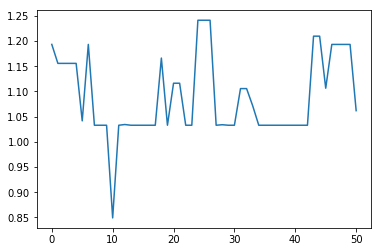

In [43]:
plt.plot(training.keys(), training.values())
plt.show()

### Trading with testing data
Using the best population, we can now run it against the new data to check the result

In [44]:
finalBestInd = getBestIndividual(pop)
print (finalBestInd)

{'individual': array([['ama', '5', '200', 'M', '0.9'],
       ['tpma', '5', '200', 'VH', '0.1'],
       ['tpma', '10', '20', 'H', '0.1'],
       ['ama', '5', '10', 'EH', '0.8'],
       ['tma', '3', '150', 'M', '0.2'],
       ['tpma', '10', '100', 'H', '0.3'],
       ['sma', '3', '10', 'VH', '0.4'],
       ['ama', '10', '150', 'H', '0.7'],
       ['ama', '3', '100', 'EL', '-0.7'],
       ['sma', '5', '100', 'H', '0.0']],
      dtype='<U4'), 'rating': -0.0050212024811177166, 'profit': 11758397.687621295, 'ror': 1.1931798349619276, 'probability': 0.25382107594183784, 'co_rate': 0.8542704553388297}


In [45]:
cerebro = main(finalBestInd, bSilentMode=False, bTestMode=False, plotFileName="finalRun.png")

Starting Portfolio Value: 10000000.00
2014-01-03, Testing SELL CREATE, 2463.00 with volume 66.00
2014-01-03, SELL EXECUTED, Size: -3.53, Price: 2462.00, Cost: 14123.37, Comm 30.00, Portfolio Value: 10000000.00, Cash: 10000000.00
2014-01-03, Testing SELL CREATE, 2462.00 with volume 9.00
2014-01-03, SELL EXECUTED, Size: -4.55, Price: 2464.00, Cost: 18194.87, Comm 30.00, Portfolio Value: 9999962.94, Cash: 9985839.57
2014-01-03, Testing SELL CREATE, 2463.00 with volume 4.00
2014-01-03, SELL EXECUTED, Size: -4.53, Price: 2463.00, Cost: 18103.46, Comm 30.00, Portfolio Value: 9999941.02, Cash: 9967622.78
2014-01-03, Testing SELL CREATE, 2463.00 with volume 4.00
2014-01-03, SELL EXECUTED, Size: -4.62, Price: 2463.00, Cost: 18493.02, Comm 30.00, Portfolio Value: 9999911.02, Cash: 9949489.32
2014-01-03, Testing SELL CREATE, 2462.00 with volume 3.00
2014-01-03, SELL EXECUTED, Size: -4.60, Price: 2463.00, Cost: 18403.73, Comm 30.00, Portfolio Value: 9999881.02, Cash: 9930966.30
2014-01-03, Testing

2014-01-03, Testing SELL CREATE, 2457.00 with volume 63.00
2014-01-03, SELL EXECUTED, Size: -34.28, Price: 2457.00, Cost: 137107.53, Comm 30.00, Portfolio Value: 10000796.93, Cash: 7064623.89
2014-01-03, Testing SELL CREATE, 2457.00 with volume 16.00
2014-01-03, SELL EXECUTED, Size: -38.24, Price: 2458.00, Cost: 152947.76, Comm 30.00, Portfolio Value: 10000766.93, Cash: 6927486.36
2014-01-03, Testing SELL CREATE, 2457.00 with volume 43.00
2014-01-03, SELL EXECUTED, Size: -36.97, Price: 2458.00, Cost: 147895.14, Comm 30.00, Portfolio Value: 9999968.61, Cash: 6773740.28
2014-01-03, Testing SELL CREATE, 2458.00 with volume 53.00
2014-01-03, SELL EXECUTED, Size: -36.36, Price: 2459.00, Cost: 145425.56, Comm 30.00, Portfolio Value: 9999095.08, Cash: 6624971.60
2014-01-03, Testing SELL CREATE, 2458.00 with volume 49.00
2014-01-03, SELL EXECUTED, Size: -34.69, Price: 2458.00, Cost: 138748.32, Comm 30.00, Portfolio Value: 9999065.08, Cash: 6479516.05
2014-01-03, Testing SELL CREATE, 2458.00 wi

2014-01-09, Testing SELL CREATE, 2357.00 with volume 172.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -730981.6606239296
2014-01-09, Testing SELL CREATE, 2358.00 with volume 53.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -758156.5832404009
2014-01-09, Testing SELL CREATE, 2359.00 with volume 27.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -672389.8288947834
2014-01-09, Testing SELL CREATE, 2359.00 with volume 102.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -596605.5293304358
2014-01-09, Testing SELL CREATE, 2361.00 with volume 23.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-01-09, Testing SELL CREATE, 2363.00 with volume 8.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13751.936875706226
2014-01-09, Testing SELL CREATE, 2363.00 with volume 8.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14174.72122050704
2014-01-09, Testing SELL CREATE, 2362.00 with volume 80.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14294.74438064112
2014-01-09, Testing SELL CREATE, 2360.00 with volume 315.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25966.620169281974
2014-01-09, Testing SELL CREATE, 2360.00 with volume 75.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-01-09, Testing SELL CREATE, 2352.00 with volume 15.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9574.949719906203
2014-01-09, Testing SELL CREATE, 2349.00 with volume 91.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9522.72170959091
2014-01-09, Testing SELL CREATE, 2349.00 with volume 16.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9469.189345503775
2014-01-09, Testing SELL CREATE, 2347.00 with volume 69.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9443.481413825706
2014-01-09, Testing SELL CREATE, 2347.00 with volume 15.00
2014-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-01-10, Testing SELL CREATE, 2332.00 with volume 136.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1289198.7362092668
2014-01-10, Testing SELL CREATE, 2331.00 with volume 86.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1441809.647008766
2014-01-10, Testing SELL CREATE, 2332.00 with volume 7.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1390618.4289011601
2014-01-10, Testing SELL CREATE, 2331.00 with volume 114.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1379838.210294754
2014-01-10, Testing SELL CREATE, 2332.00 with volume 42.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-01-10, Testing SELL CREATE, 2332.00 with volume 69.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92248.23237204614
2014-01-10, Testing SELL CREATE, 2332.00 with volume 53.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114173.98880912515
2014-01-10, Testing SELL CREATE, 2331.00 with volume 24.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144592.6886210157
2014-01-10, Testing SELL CREATE, 2331.00 with volume 102.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -133959.4239717037
2014-01-10, Testing SELL CREATE, 2331.00 with volume 45.00
2014-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -504326.07524255285
2014-01-11, Testing SELL CREATE, 2336.00 with volume 98.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -487643.65549746645
2014-01-11, Testing SELL CREATE, 2337.00 with volume 30.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -446777.56738666666
2014-01-11, Testing SELL CREATE, 2337.00 with volume 130.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -398539.38210003194
2014-01-11, Testing SELL CREATE, 2335.00 with volume 80.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -386447.5786201806
2014-01-11, Te

2014-01-11, Testing SELL CREATE, 2323.00 with volume 231.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -257508.11034140317
2014-01-11, Testing SELL CREATE, 2322.00 with volume 130.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -345523.5228032654
2014-01-11, Testing SELL CREATE, 2322.00 with volume 56.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -331729.47839236725
2014-01-11, Testing SELL CREATE, 2324.00 with volume 60.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -314043.5424928458
2014-01-11, Testing SELL CREATE, 2323.00 with volume 60.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-01-11, Testing SELL CREATE, 2328.00 with volume 4.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12042.833243649033
2014-01-11, Testing SELL CREATE, 2328.00 with volume 26.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11877.284474133701
2014-01-11, Testing SELL CREATE, 2328.00 with volume 1.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11717.075306514525
2014-01-11, Testing SELL CREATE, 2327.00 with volume 20.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11670.915879639357
2014-01-11, Testing SELL CREATE, 2327.00 with volume 9.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-01-11, Testing SELL CREATE, 2324.00 with volume 22.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14586.230819012777
2014-01-11, Testing SELL CREATE, 2325.00 with volume 50.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13683.603385963037
2014-01-11, Testing SELL CREATE, 2327.00 with volume 4.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10542.548007945306
2014-01-11, Testing SELL CREATE, 2327.00 with volume 75.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9394.555573934906
2014-01-11, Testing SELL CREATE, 2326.00 with volume 236.00
2014-01-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-01-14, Testing SELL CREATE, 2313.00 with volume 1.00
2014-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -293531.7864316062
2014-01-14, Testing SELL CREATE, 2312.00 with volume 57.00
2014-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -284902.69689093524
2014-01-14, Testing SELL CREATE, 2312.00 with volume 30.00
2014-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -310140.7704376043
2014-01-14, Testing SELL CREATE, 2310.00 with volume 49.00
2014-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -407782.8800186134
2014-01-14, Testing SELL CREATE, 2311.00 with volume 2.00
2014-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-01-16, Testing SELL CREATE, 2306.00 with volume 5.00
2014-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127165.19822759672
2014-01-16, Testing SELL CREATE, 2306.00 with volume 2.00
2014-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128728.90786677341
2014-01-16, Testing SELL CREATE, 2305.00 with volume 12.00
2014-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193446.1890492797
2014-01-16, Testing SELL CREATE, 2307.00 with volume 6.00
2014-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187597.96525166626
2014-01-16, Testing SELL CREATE, 2302.00 with volume 43.00
2014-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-01-17, Testing SELL CREATE, 2338.00 with volume 7.00
2014-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.099907065529
2014-01-17, Testing SELL CREATE, 2338.00 with volume 5.00
2014-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.499504685298
2014-01-17, Testing SELL CREATE, 2337.00 with volume 10.00
2014-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10075.792622638595
2014-01-17, Testing SELL CREATE, 2336.00 with volume 19.00
2014-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10432.510076799805
2014-01-17, Testing SELL CREATE, 2336.00 with volume 201.00
2014-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-01-22, Testing SELL CREATE, 2355.00 with volume 12.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -689675.4764714845
2014-01-22, Testing SELL CREATE, 2358.00 with volume 6.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -634158.6265508266
2014-01-22, Testing SELL CREATE, 2357.00 with volume 23.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -621492.4882074238
2014-01-22, Testing SELL CREATE, 2356.00 with volume 7.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -535321.9135713556
2014-01-22, Testing SELL CREATE, 2359.00 with volume 14.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-01-22, Testing SELL CREATE, 2368.00 with volume 19.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11071.745538724104
2014-01-22, Testing SELL CREATE, 2369.00 with volume 101.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9723.476884165004
2014-01-22, Testing SELL CREATE, 2371.00 with volume 42.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.72996070959
2014-01-22, Testing SELL CREATE, 2366.00 with volume 4.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8858.304711146659
2014-01-22, Testing SELL CREATE, 2368.00 with volume 6.00
2014-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-01-23, Testing SELL CREATE, 2366.00 with volume 1.00
2014-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -352122.75711922214
2014-01-23, Testing SELL CREATE, 2365.00 with volume 1.00
2014-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -345970.28818829823
2014-01-23, Testing SELL CREATE, 2366.00 with volume 7.00
2014-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -343174.08500981174
2014-01-23, Testing SELL CREATE, 2367.00 with volume 13.00
2014-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -338616.62666842935
2014-01-23, Testing SELL CREATE, 2366.00 with volume 1.00
2014-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-01-24, Testing SELL CREATE, 2374.00 with volume 30.00
2014-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13448.897252494928
2014-01-24, Testing SELL CREATE, 2375.00 with volume 17.00
2014-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11140.728258852609
2014-01-25, Testing SELL CREATE, 2381.00 with volume 3.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11404.894592620363
2014-01-25, Testing SELL CREATE, 2382.00 with volume 20.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11313.742248894112
2014-01-25, Testing SELL CREATE, 2383.00 with volume 6.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-01-25, Testing SELL CREATE, 2381.00 with volume 1.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15186.213692913218
2014-01-25, Testing SELL CREATE, 2381.00 with volume 1.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15375.4426938091
2014-01-25, Testing SELL CREATE, 2381.00 with volume 1.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15406.165989603678
2014-01-25, Testing SELL CREATE, 2381.00 with volume 19.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16039.609379080688
2014-01-25, Testing SELL CREATE, 2382.00 with volume 2.00
2014-01-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-01-28, Testing SELL CREATE, 2370.00 with volume 20.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -317246.03732889297
2014-01-28, Testing SELL CREATE, 2368.00 with volume 8.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -376497.0455142676
2014-01-28, Testing SELL CREATE, 2369.00 with volume 10.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -404083.7460550262
2014-01-28, Testing SELL CREATE, 2369.00 with volume 14.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -389870.04625591624
2014-01-28, Testing SELL CREATE, 2370.00 with volume 9.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-01-28, Testing SELL CREATE, 2369.00 with volume 2.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62894.68710538181
2014-01-28, Testing SELL CREATE, 2370.00 with volume 28.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60918.5647937915
2014-01-28, Testing SELL CREATE, 2370.00 with volume 6.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58991.90080680507
2014-01-28, Testing SELL CREATE, 2369.00 with volume 1.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56152.662232400224
2014-01-28, Testing SELL CREATE, 2369.00 with volume 2.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-01-28, Testing SELL CREATE, 2360.00 with volume 6.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58766.57921931735
2014-01-28, Testing SELL CREATE, 2361.00 with volume 1.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56851.35993506639
2014-01-28, Testing SELL CREATE, 2361.00 with volume 169.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54993.53094705522
2014-01-28, Testing SELL CREATE, 2360.00 with volume 7.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54520.6643592021
2014-01-28, Testing SELL CREATE, 2360.00 with volume 63.00
2014-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1108989.04746796
2014-01-29, Testing SELL CREATE, 2331.00 with volume 4.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1365723.603280531
2014-01-29, Testing SELL CREATE, 2331.00 with volume 3.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1141854.2269466508
2014-01-29, Testing SELL CREATE, 2331.00 with volume 2.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1047555.8038910542
2014-01-29, Testing SELL CREATE, 2330.00 with volume 13.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1237283.083561084
2014-01-29, Testing S

2014-01-29, Testing SELL CREATE, 2322.00 with volume 13.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106852.71016622125
2014-01-29, Testing SELL CREATE, 2321.00 with volume 3.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93975.20959284029
2014-01-29, Testing SELL CREATE, 2321.00 with volume 4.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86052.02534142087
2014-01-29, Testing SELL CREATE, 2321.00 with volume 5.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78944.24858743975
2014-01-29, Testing SELL CREATE, 2322.00 with volume 3.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-01-29, Testing SELL CREATE, 2320.00 with volume 8.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8519.819305138684
2014-01-29, Testing SELL CREATE, 2317.00 with volume 41.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8679.799888453914
2014-01-29, Testing SELL CREATE, 2314.00 with volume 238.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13783.058672124049
2014-01-29, Testing SELL CREATE, 2314.00 with volume 118.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22725.59352540802
2014-01-29, Testing SELL CREATE, 2315.00 with volume 47.00
2014-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-05, Testing SELL CREATE, 2334.00 with volume 5.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8484.308490711255
2014-02-05, Testing SELL CREATE, 2336.00 with volume 4.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8526.203878660479
2014-02-05, Testing SELL CREATE, 2336.00 with volume 4.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8564.183143499895
2014-02-05, Testing SELL CREATE, 2337.00 with volume 5.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8587.347581271879
2014-02-05, Testing SELL CREATE, 2337.00 with volume 2.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-02-05, Testing SELL CREATE, 2325.00 with volume 16.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184902.11942374753
2014-02-05, Testing SELL CREATE, 2324.00 with volume 11.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196255.04624607493
2014-02-05, Testing SELL CREATE, 2325.00 with volume 3.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220774.3001553711
2014-02-05, Testing SELL CREATE, 2324.00 with volume 11.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -253728.15909342445
2014-02-05, Testing SELL CREATE, 2324.00 with volume 2.00
2014-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-02-06, Testing SELL CREATE, 2332.00 with volume 16.00
2014-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9954.974915252735
2014-02-06, Testing SELL CREATE, 2332.00 with volume 1.00
2014-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9911.013487049107
2014-02-06, Testing SELL CREATE, 2332.00 with volume 3.00
2014-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9786.260702303018
2014-02-06, Testing SELL CREATE, 2332.00 with volume 20.00
2014-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8852.287960694404
2014-02-06, Testing SELL CREATE, 2333.00 with volume 1.00
2014-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-07, Testing SELL CREATE, 2352.00 with volume 134.00
2014-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.727237441473
2014-02-07, Testing SELL CREATE, 2352.00 with volume 4.00
2014-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.202174270162
2014-02-07, Testing SELL CREATE, 2353.00 with volume 4.00
2014-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.913790247916
2014-02-07, Testing SELL CREATE, 2353.00 with volume 5.00
2014-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.706451153637
2014-02-07, Testing SELL CREATE, 2354.00 with volume 7.00
2014-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-11, Testing SELL CREATE, 2390.00 with volume 18.00
2014-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.413120281031
2014-02-11, Testing SELL CREATE, 2391.00 with volume 3.00
2014-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8474.799788809356
2014-02-11, Testing SELL CREATE, 2390.00 with volume 7.00
2014-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8535.237903193914
2014-02-11, Testing SELL CREATE, 2390.00 with volume 7.00
2014-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8982.832221898061
2014-02-11, Testing SELL CREATE, 2391.00 with volume 7.00
2014-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-02-12, Testing SELL CREATE, 2395.00 with volume 4.00
2014-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.766176849842
2014-02-12, Testing SELL CREATE, 2395.00 with volume 32.00
2014-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.85912069683
2014-02-12, Testing SELL CREATE, 2394.00 with volume 28.00
2014-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8494.365152486404
2014-02-12, Testing SELL CREATE, 2395.00 with volume 43.00
2014-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8554.411028977336
2014-02-12, Testing SELL CREATE, 2396.00 with volume 2.00
2014-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-13, Testing SELL CREATE, 2398.00 with volume 16.00
2014-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8803.370233871783
2014-02-13, Testing SELL CREATE, 2399.00 with volume 2.00
2014-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8901.239173848882
2014-02-13, Testing SELL CREATE, 2398.00 with volume 9.00
2014-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9282.147250464115
2014-02-13, Testing SELL CREATE, 2397.00 with volume 8.00
2014-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10199.573558702707
2014-02-13, Testing SELL CREATE, 2398.00 with volume 5.00
2014-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-14, Testing SELL CREATE, 2435.00 with volume 10.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9921.9261812106
2014-02-14, Testing SELL CREATE, 2434.00 with volume 37.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14063.5257062129
2014-02-14, Testing SELL CREATE, 2435.00 with volume 4.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17470.56787664062
2014-02-14, Testing SELL CREATE, 2433.00 with volume 110.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37194.94686166801
2014-02-14, Testing SELL CREATE, 2434.00 with volume 55.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-14, Testing SELL CREATE, 2442.00 with volume 42.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11142.69416840769
2014-02-14, Testing SELL CREATE, 2442.00 with volume 75.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11074.051721726175
2014-02-14, Testing SELL CREATE, 2442.00 with volume 9.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11377.021770754976
2014-02-14, Testing SELL CREATE, 2444.00 with volume 7.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10391.458473063574
2014-02-14, Testing SELL CREATE, 2444.00 with volume 82.00
2014-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-02-15, Testing SELL CREATE, 2458.00 with volume 1.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134683.92334047437
2014-02-15, Testing SELL CREATE, 2457.00 with volume 8.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131779.23879265407
2014-02-15, Testing SELL CREATE, 2459.00 with volume 29.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124770.10629374192
2014-02-15, Testing SELL CREATE, 2458.00 with volume 11.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119613.02684531154
2014-02-15, Testing SELL CREATE, 2457.00 with volume 14.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-15, Testing SELL CREATE, 2449.00 with volume 297.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104938.10188117824
2014-02-15, Testing SELL CREATE, 2449.00 with volume 30.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111508.66018146374
2014-02-15, Testing SELL CREATE, 2449.00 with volume 80.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129028.00359144463
2014-02-15, Testing SELL CREATE, 2449.00 with volume 67.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147187.6859931227
2014-02-15, Testing SELL CREATE, 2447.00 with volume 97.00
2014-02-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-02-18, Testing SELL CREATE, 2442.00 with volume 4.00
2014-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80856.46917492921
2014-02-18, Testing SELL CREATE, 2442.00 with volume 12.00
2014-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77358.69329353566
2014-02-18, Testing SELL CREATE, 2442.00 with volume 60.00
2014-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72413.98966339372
2014-02-18, Testing SELL CREATE, 2443.00 with volume 35.00
2014-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68124.26209052694
2014-02-18, Testing SELL CREATE, 2443.00 with volume 2.00
2014-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-02-19, Testing SELL CREATE, 2486.00 with volume 97.00
2014-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25025.21141718152
2014-02-19, Testing SELL CREATE, 2486.00 with volume 27.00
2014-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39244.63487497217
2014-02-19, Testing SELL CREATE, 2486.00 with volume 11.00
2014-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38099.7675671421
2014-02-19, Testing SELL CREATE, 2485.00 with volume 134.00
2014-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41807.3757226762
2014-02-19, Testing SELL CREATE, 2484.00 with volume 81.00
2014-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-02-20, Testing SELL CREATE, 2513.00 with volume 74.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8423.228546202181
2014-02-20, Testing SELL CREATE, 2513.00 with volume 251.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8421.074103312358
2014-02-20, Testing SELL CREATE, 2514.00 with volume 163.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8435.520919433622
2014-02-20, Testing SELL CREATE, 2513.00 with volume 104.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.143185747158
2014-02-20, Testing SELL CREATE, 2513.00 with volume 152.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-02-20, Testing SELL CREATE, 2512.00 with volume 7.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14377.821209596912
2014-02-20, Testing SELL CREATE, 2512.00 with volume 10.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14609.359661145625
2014-02-20, Testing SELL CREATE, 2512.00 with volume 1.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14581.516817999478
2014-02-20, Testing SELL CREATE, 2512.00 with volume 2.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14454.559548424195
2014-02-20, Testing SELL CREATE, 2513.00 with volume 1.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-02-20, Testing SELL CREATE, 2498.00 with volume 47.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -312669.67559869535
2014-02-20, Testing SELL CREATE, 2498.00 with volume 11.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -317049.41436843947
2014-02-20, Testing SELL CREATE, 2498.00 with volume 8.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -314169.49903019104
2014-02-20, Testing SELL CREATE, 2498.00 with volume 107.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -277079.795248787
2014-02-20, Testing SELL CREATE, 2501.00 with volume 99.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-20, Testing SELL CREATE, 2506.00 with volume 60.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20058.21247076448
2014-02-20, Testing SELL CREATE, 2506.00 with volume 37.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29704.45096635993
2014-02-20, Testing SELL CREATE, 2504.00 with volume 52.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35289.13534809391
2014-02-20, Testing SELL CREATE, 2504.00 with volume 95.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55991.537153010075
2014-02-20, Testing SELL CREATE, 2500.00 with volume 182.00
2014-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-22, Testing SELL CREATE, 2535.00 with volume 143.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12132.423381412054
2014-02-22, Testing SELL CREATE, 2530.00 with volume 188.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39912.0709972254
2014-02-22, Testing SELL CREATE, 2528.00 with volume 360.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114378.48825119263
2014-02-22, Testing SELL CREATE, 2527.00 with volume 127.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -242464.68921504047
2014-02-22, Testing SELL CREATE, 2528.00 with volume 69.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-02-22, Testing SELL CREATE, 2521.00 with volume 123.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -499183.73700014467
2014-02-22, Testing SELL CREATE, 2520.00 with volume 147.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -495178.8184143587
2014-02-22, Testing SELL CREATE, 2522.00 with volume 14.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -509648.2926382787
2014-02-22, Testing SELL CREATE, 2521.00 with volume 50.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -508022.3929972888
2014-02-22, Testing SELL CREATE, 2522.00 with volume 66.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-02-22, Testing SELL CREATE, 2521.00 with volume 8.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173388.1694714687
2014-02-22, Testing SELL CREATE, 2520.00 with volume 29.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176860.9141959379
2014-02-22, Testing SELL CREATE, 2521.00 with volume 7.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176271.157674115
2014-02-22, Testing SELL CREATE, 2520.00 with volume 2.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196987.18169034907
2014-02-22, Testing SELL CREATE, 2521.00 with volume 44.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-02-22, Testing SELL CREATE, 2527.00 with volume 25.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8634.51599979037
2014-02-22, Testing SELL CREATE, 2524.00 with volume 81.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8429.713067038749
2014-02-22, Testing SELL CREATE, 2524.00 with volume 7.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8487.70461283457
2014-02-22, Testing SELL CREATE, 2520.00 with volume 57.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11543.377119264434
2014-02-22, Testing SELL CREATE, 2520.00 with volume 61.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-02-22, Testing SELL CREATE, 2522.00 with volume 119.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10865.986276375956
2014-02-22, Testing SELL CREATE, 2523.00 with volume 13.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10832.860459270658
2014-02-22, Testing SELL CREATE, 2522.00 with volume 6.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10801.64648532052
2014-02-22, Testing SELL CREATE, 2523.00 with volume 13.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10767.879429611656
2014-02-22, Testing SELL CREATE, 2523.00 with volume 3.00
2014-02-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-25, Testing SELL CREATE, 2547.00 with volume 120.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -717607.0112196237
2014-02-25, Testing SELL CREATE, 2547.00 with volume 43.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -729704.1661043401
2014-02-25, Testing SELL CREATE, 2547.00 with volume 51.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -713653.9703596046
2014-02-25, Testing SELL CREATE, 2548.00 with volume 19.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -699768.8354374367
2014-02-25, Testing SELL CREATE, 2546.00 with volume 81.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-02-25, Testing SELL CREATE, 2548.00 with volume 20.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241800.36577390053
2014-02-25, Testing SELL CREATE, 2548.00 with volume 37.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -242052.16677587325
2014-02-25, Testing SELL CREATE, 2548.00 with volume 60.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -239602.97900256465
2014-02-25, Testing SELL CREATE, 2546.00 with volume 108.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -236945.52988924706
2014-02-25, Testing SELL CREATE, 2547.00 with volume 42.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -314914.2045259134
2014-02-25, Testing SELL CREATE, 2535.00 with volume 0.00
2014-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -314386.1289244138
2014-02-26, Testing SELL CREATE, 2522.00 with volume 747.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -447260.7470214144
2014-02-26, Testing SELL CREATE, 2525.00 with volume 283.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -537091.0028222336
2014-02-26, Testing SELL CREATE, 2527.00 with volume 159.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -504801.29800719296
2014-02-26, Test

2014-02-26, Testing SELL CREATE, 2535.00 with volume 113.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11824.855944907447
2014-02-26, Testing SELL CREATE, 2535.00 with volume 15.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17154.596908568252
2014-02-26, Testing SELL CREATE, 2533.00 with volume 243.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43920.933250607384
2014-02-26, Testing SELL CREATE, 2533.00 with volume 108.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45443.02850082987
2014-02-26, Testing SELL CREATE, 2532.00 with volume 97.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-02-26, Testing SELL CREATE, 2538.00 with volume 36.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9465.69157119422
2014-02-26, Testing SELL CREATE, 2539.00 with volume 19.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8919.597727876637
2014-02-26, Testing SELL CREATE, 2539.00 with volume 9.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8689.628593973923
2014-02-26, Testing SELL CREATE, 2538.00 with volume 6.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8513.281830219488
2014-02-26, Testing SELL CREATE, 2538.00 with volume 3.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-02-26, Testing SELL CREATE, 2535.00 with volume 84.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12606.201131059514
2014-02-26, Testing SELL CREATE, 2535.00 with volume 113.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12569.485665496011
2014-02-26, Testing SELL CREATE, 2533.00 with volume 280.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13566.337312991076
2014-02-26, Testing SELL CREATE, 2530.00 with volume 92.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17259.59157231629
2014-02-26, Testing SELL CREATE, 2529.00 with volume 59.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-02-26, Testing SELL CREATE, 2535.00 with volume 70.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11878.219216919175
2014-02-26, Testing SELL CREATE, 2536.00 with volume 33.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11540.390754499138
2014-02-26, Testing SELL CREATE, 2536.00 with volume 18.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10213.785059577107
2014-02-26, Testing SELL CREATE, 2536.00 with volume 8.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10132.13969290043
2014-02-26, Testing SELL CREATE, 2535.00 with volume 16.00
2014-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-28, Testing SELL CREATE, 2588.00 with volume 134.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.889793171555
2014-02-28, Testing SELL CREATE, 2592.00 with volume 374.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8553.31374019711
2014-02-28, Testing SELL CREATE, 2593.00 with volume 115.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8552.440630074516
2014-02-28, Testing SELL CREATE, 2592.00 with volume 96.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8493.914589746144
2014-02-28, Testing SELL CREATE, 2588.00 with volume 265.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-02-28, Testing SELL CREATE, 2584.00 with volume 17.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -177243.9502838205
2014-02-28, Testing SELL CREATE, 2585.00 with volume 12.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173696.32586230748
2014-02-28, Testing SELL CREATE, 2585.00 with volume 4.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -166907.31865813665
2014-02-28, Testing SELL CREATE, 2586.00 with volume 42.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156945.16026907213
2014-02-28, Testing SELL CREATE, 2587.00 with volume 5.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-02-28, Testing SELL CREATE, 2578.00 with volume 33.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349282.7517840243
2014-02-28, Testing SELL CREATE, 2577.00 with volume 53.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349097.16453117476
2014-02-28, Testing SELL CREATE, 2576.00 with volume 114.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -341799.26007115823
2014-02-28, Testing SELL CREATE, 2579.00 with volume 15.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -329643.5040816613
2014-02-28, Testing SELL CREATE, 2581.00 with volume 1.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-28, Testing SELL CREATE, 2583.00 with volume 2.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17299.622995413527
2014-02-28, Testing SELL CREATE, 2582.00 with volume 2.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18770.164549430123
2014-02-28, Testing SELL CREATE, 2582.00 with volume 23.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19953.44894017756
2014-02-28, Testing SELL CREATE, 2580.00 with volume 39.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21864.811425522046
2014-02-28, Testing SELL CREATE, 2581.00 with volume 29.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-02-28, Testing SELL CREATE, 2565.00 with volume 63.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -520153.00391485693
2014-02-28, Testing SELL CREATE, 2566.00 with volume 26.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -495985.71410627704
2014-02-28, Testing SELL CREATE, 2567.00 with volume 12.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -468665.67507207574
2014-02-28, Testing SELL CREATE, 2566.00 with volume 21.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -446082.277451101
2014-02-28, Testing SELL CREATE, 2566.00 with volume 14.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19916.56660562158
2014-02-28, Testing SELL CREATE, 2572.00 with volume 366.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19330.69003898894
2014-02-28, Testing SELL CREATE, 2572.00 with volume 509.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18747.490480309683
2014-02-28, Testing SELL CREATE, 2573.00 with volume 0.00
2014-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19413.740141190403
2014-03-01, Testing SELL CREATE, 2556.00 with volume 438.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134196.8752655733
2014-03-01, Tes

2014-03-01, Testing SELL CREATE, 2553.00 with volume 167.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228097.65391114893
2014-03-01, Testing SELL CREATE, 2553.00 with volume 162.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -249306.30647538003
2014-03-01, Testing SELL CREATE, 2554.00 with volume 28.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -323485.0055646977
2014-03-01, Testing SELL CREATE, 2551.00 with volume 291.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -429892.2071019074
2014-03-01, Testing SELL CREATE, 2552.00 with volume 39.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-03-01, Testing SELL CREATE, 2564.00 with volume 22.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8435.96663853641
2014-03-01, Testing SELL CREATE, 2562.00 with volume 80.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8471.318704775944
2014-03-01, Testing SELL CREATE, 2563.00 with volume 24.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8514.882941498205
2014-03-01, Testing SELL CREATE, 2562.00 with volume 70.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9861.467308576179
2014-03-01, Testing SELL CREATE, 2561.00 with volume 39.00
2014-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-03-04, Testing SELL CREATE, 2629.00 with volume 21.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17066.027446106105
2014-03-04, Testing SELL CREATE, 2631.00 with volume 20.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16477.93942989894
2014-03-04, Testing SELL CREATE, 2632.00 with volume 29.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15931.987187991766
2014-03-04, Testing SELL CREATE, 2632.00 with volume 35.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15431.971340704273
2014-03-04, Testing SELL CREATE, 2630.00 with volume 33.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-04, Testing SELL CREATE, 2621.00 with volume 224.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96506.69017051338
2014-03-04, Testing SELL CREATE, 2620.00 with volume 105.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150187.62879688665
2014-03-04, Testing SELL CREATE, 2619.00 with volume 55.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -204527.16386607048
2014-03-04, Testing SELL CREATE, 2619.00 with volume 96.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -200469.92670939822
2014-03-04, Testing SELL CREATE, 2618.00 with volume 95.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-03-04, Testing SELL CREATE, 2617.00 with volume 8.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -227034.52757806366
2014-03-04, Testing SELL CREATE, 2616.00 with volume 37.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205035.07875384198
2014-03-04, Testing SELL CREATE, 2616.00 with volume 48.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -192876.43872444547
2014-03-04, Testing SELL CREATE, 2612.00 with volume 190.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -313591.295129988
2014-03-04, Testing SELL CREATE, 2610.00 with volume 197.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-04, Testing SELL CREATE, 2602.00 with volume 54.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223132.7711970521
2014-03-04, Testing SELL CREATE, 2603.00 with volume 17.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212166.56101459797
2014-03-04, Testing SELL CREATE, 2604.00 with volume 56.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -202377.72609546394
2014-03-04, Testing SELL CREATE, 2606.00 with volume 30.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193182.92444655506
2014-03-04, Testing SELL CREATE, 2607.00 with volume 65.00
2014-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-05, Testing SELL CREATE, 2604.00 with volume 16.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31218.31969346735
2014-03-05, Testing SELL CREATE, 2602.00 with volume 132.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70833.91812693674
2014-03-05, Testing SELL CREATE, 2603.00 with volume 27.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99709.98484453981
2014-03-05, Testing SELL CREATE, 2602.00 with volume 69.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143378.1174363546
2014-03-05, Testing SELL CREATE, 2602.00 with volume 84.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-03-05, Testing SELL CREATE, 2596.00 with volume 12.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56442.85596451795
2014-03-05, Testing SELL CREATE, 2596.00 with volume 1.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75658.68250644072
2014-03-05, Testing SELL CREATE, 2597.00 with volume 42.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73756.76257692215
2014-03-05, Testing SELL CREATE, 2597.00 with volume 86.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72972.55754751059
2014-03-05, Testing SELL CREATE, 2598.00 with volume 17.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-03-05, Testing SELL CREATE, 2594.00 with volume 82.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74201.64999564261
2014-03-05, Testing SELL CREATE, 2593.00 with volume 34.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -137821.82754933668
2014-03-05, Testing SELL CREATE, 2595.00 with volume 9.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138843.21982349345
2014-03-05, Testing SELL CREATE, 2594.00 with volume 17.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149293.72802495328
2014-03-05, Testing SELL CREATE, 2592.00 with volume 229.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-05, Testing SELL CREATE, 2588.00 with volume 47.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -203531.14311040746
2014-03-05, Testing SELL CREATE, 2588.00 with volume 16.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221215.32787559408
2014-03-05, Testing SELL CREATE, 2588.00 with volume 14.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228470.6269891465
2014-03-05, Testing SELL CREATE, 2585.00 with volume 60.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -286655.81905702775
2014-03-05, Testing SELL CREATE, 2585.00 with volume 10.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-05, Testing SELL CREATE, 2586.00 with volume 57.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111456.43539186615
2014-03-05, Testing SELL CREATE, 2587.00 with volume 4.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109867.629910887
2014-03-05, Testing SELL CREATE, 2588.00 with volume 25.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106442.07527133774
2014-03-05, Testing SELL CREATE, 2587.00 with volume 11.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102621.45063543778
2014-03-05, Testing SELL CREATE, 2588.00 with volume 100.00
2014-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121682.3579608246
2014-03-06, Testing SELL CREATE, 2635.00 with volume 7.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155988.75555963616
2014-03-06, Testing SELL CREATE, 2634.00 with volume 87.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -200076.86645510944
2014-03-06, Testing SELL CREATE, 2632.00 with volume 216.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -282951.68083810655
2014-03-06, Testing SELL CREATE, 2631.00 with volume 127.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -386737.9197488648
2014-03-06, Tes

2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165718.61595351138
2014-03-06, Testing SELL CREATE, 2630.00 with volume 11.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -168364.2222815141
2014-03-06, Testing SELL CREATE, 2629.00 with volume 39.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -247842.49872575872
2014-03-06, Testing SELL CREATE, 2628.00 with volume 91.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240832.46495705706
2014-03-06, Testing SELL CREATE, 2630.00 with volume 19.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -234530.69195059998
2014-03-06, Tes

2014-03-07, Testing SELL CREATE, 2612.00 with volume 23.00
2014-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77891.80196480239
2014-03-07, Testing SELL CREATE, 2612.00 with volume 8.00
2014-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67616.75566563601
2014-03-07, Testing SELL CREATE, 2611.00 with volume 147.00
2014-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23580.719942490232
2014-03-07, Testing SELL CREATE, 2614.00 with volume 292.00
2014-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10948.687828757056
2014-03-07, Testing SELL CREATE, 2615.00 with volume 52.00
2014-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-08, Testing SELL CREATE, 2670.00 with volume 25.00
2014-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88639.17262968207
2014-03-08, Testing SELL CREATE, 2669.00 with volume 22.00
2014-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88250.02602866068
2014-03-08, Testing SELL CREATE, 2669.00 with volume 6.00
2014-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87183.3441733917
2014-03-08, Testing SELL CREATE, 2671.00 with volume 15.00
2014-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85334.2762162843
2014-03-08, Testing SELL CREATE, 2671.00 with volume 18.00
2014-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-03-11, Testing SELL CREATE, 2658.00 with volume 13.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1003367.5563960954
2014-03-11, Testing SELL CREATE, 2658.00 with volume 18.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -969039.378288608
2014-03-11, Testing SELL CREATE, 2656.00 with volume 66.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -949045.161250809
2014-03-11, Testing SELL CREATE, 2657.00 with volume 5.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -917344.4225834939
2014-03-11, Testing SELL CREATE, 2657.00 with volume 24.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-03-11, Testing SELL CREATE, 2665.00 with volume 21.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11287.481407814375
2014-03-11, Testing SELL CREATE, 2665.00 with volume 1.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11645.754383747102
2014-03-11, Testing SELL CREATE, 2664.00 with volume 8.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12369.470976867677
2014-03-11, Testing SELL CREATE, 2664.00 with volume 3.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15071.128570084042
2014-03-11, Testing SELL CREATE, 2664.00 with volume 3.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-03-12, Testing SELL CREATE, 2673.00 with volume 95.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -734174.1891939166
2014-03-12, Testing SELL CREATE, 2674.00 with volume 83.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -696195.2559100753
2014-03-12, Testing SELL CREATE, 2674.00 with volume 245.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -665127.7673671002
2014-03-12, Testing SELL CREATE, 2674.00 with volume 526.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -628192.259466481
2014-03-12, Testing SELL CREATE, 2677.00 with volume 95.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-03-12, Testing SELL CREATE, 2684.00 with volume 2.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10248.379553196191
2014-03-12, Testing SELL CREATE, 2683.00 with volume 12.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10708.810608578506
2014-03-12, Testing SELL CREATE, 2684.00 with volume 2.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10811.908359916153
2014-03-12, Testing SELL CREATE, 2684.00 with volume 2.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10836.530517257726
2014-03-12, Testing SELL CREATE, 2684.00 with volume 2.00
2014-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-03-13, Testing SELL CREATE, 2634.00 with volume 79.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1364215.9448344195
2014-03-13, Testing SELL CREATE, 2634.00 with volume 22.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1153426.1014979775
2014-03-13, Testing SELL CREATE, 2633.00 with volume 176.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -941649.3961133662
2014-03-13, Testing SELL CREATE, 2633.00 with volume 115.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -751820.1325992325
2014-03-13, Testing SELL CREATE, 2632.00 with volume 96.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-03-13, Testing SELL CREATE, 2641.00 with volume 64.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13770.925239284272
2014-03-13, Testing SELL CREATE, 2640.00 with volume 29.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19071.866156673943
2014-03-13, Testing SELL CREATE, 2638.00 with volume 129.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41685.64884014228
2014-03-13, Testing SELL CREATE, 2632.00 with volume 246.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88171.6898944107
2014-03-13, Testing SELL CREATE, 2635.00 with volume 21.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-13, Testing SELL CREATE, 2613.00 with volume 107.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1451881.3252565258
2014-03-13, Testing SELL CREATE, 2614.00 with volume 50.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1328762.4067169959
2014-03-13, Testing SELL CREATE, 2614.00 with volume 52.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1244981.7807820998
2014-03-13, Testing SELL CREATE, 2609.00 with volume 173.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1390338.03550141
2014-03-13, Testing SELL CREATE, 2613.00 with volume 22.00
2014-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-03-14, Testing SELL CREATE, 2635.00 with volume 43.00
2014-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8710.473027958655
2014-03-14, Testing SELL CREATE, 2628.00 with volume 425.00
2014-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15583.889332275568
2014-03-14, Testing SELL CREATE, 2628.00 with volume 118.00
2014-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16250.492299653377
2014-03-14, Testing SELL CREATE, 2631.00 with volume 23.00
2014-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17932.437162877908
2014-03-14, Testing SELL CREATE, 2632.00 with volume 69.00
2014-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-03-15, Testing SELL CREATE, 2574.00 with volume 23.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1442890.0428707572
2014-03-15, Testing SELL CREATE, 2574.00 with volume 11.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1282304.1734814902
2014-03-15, Testing SELL CREATE, 2574.00 with volume 80.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1108761.947496233
2014-03-15, Testing SELL CREATE, 2577.00 with volume 31.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -810271.7354301102
2014-03-15, Testing SELL CREATE, 2578.00 with volume 594.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-15, Testing SELL CREATE, 2577.00 with volume 68.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10341.380017323461
2014-03-15, Testing SELL CREATE, 2578.00 with volume 3.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10413.368428517015
2014-03-15, Testing SELL CREATE, 2577.00 with volume 10.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10462.422802838208
2014-03-15, Testing SELL CREATE, 2578.00 with volume 20.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10392.835332818877
2014-03-15, Testing SELL CREATE, 2578.00 with volume 10.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-15, Testing SELL CREATE, 2575.00 with volume 90.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8598.388834903793
2014-03-15, Testing SELL CREATE, 2577.00 with volume 40.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9179.078115173694
2014-03-15, Testing SELL CREATE, 2577.00 with volume 4.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9661.57345000163
2014-03-15, Testing SELL CREATE, 2577.00 with volume 9.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9649.358837841884
2014-03-15, Testing SELL CREATE, 2577.00 with volume 3.00
2014-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-03-18, Testing SELL CREATE, 2576.00 with volume 3.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11637.25919251221
2014-03-18, Testing SELL CREATE, 2576.00 with volume 11.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11632.473017614584
2014-03-18, Testing SELL CREATE, 2576.00 with volume 1.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11573.243004358621
2014-03-18, Testing SELL CREATE, 2576.00 with volume 25.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11458.416455426484
2014-03-18, Testing SELL CREATE, 2577.00 with volume 29.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-03-18, Testing SELL CREATE, 2571.00 with volume 82.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21976.262533203615
2014-03-18, Testing SELL CREATE, 2572.00 with volume 22.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21702.237195019265
2014-03-18, Testing SELL CREATE, 2571.00 with volume 49.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22169.53914059624
2014-03-18, Testing SELL CREATE, 2571.00 with volume 32.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23004.626646420584
2014-03-18, Testing SELL CREATE, 2572.00 with volume 27.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12060.455878587416
2014-03-18, Testing SELL CREATE, 2575.00 with volume 16.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10849.589447058052
2014-03-18, Testing SELL CREATE, 2575.00 with volume 10.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10276.57107834599
2014-03-18, Testing SELL CREATE, 2576.00 with volume 1.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9209.81281504163
2014-03-18, Testing SELL CREATE, 2576.00 with volume 51.00
2014-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8809.842726264596
2014-03-18, Testing

2014-03-19, Testing SELL CREATE, 2560.00 with volume 104.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150363.3257733534
2014-03-19, Testing SELL CREATE, 2560.00 with volume 117.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150249.1391704922
2014-03-19, Testing SELL CREATE, 2561.00 with volume 66.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144165.69086613014
2014-03-19, Testing SELL CREATE, 2563.00 with volume 30.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129014.54778065234
2014-03-19, Testing SELL CREATE, 2563.00 with volume 72.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-03-19, Testing SELL CREATE, 2564.00 with volume 2.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21758.54436225874
2014-03-19, Testing SELL CREATE, 2564.00 with volume 5.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21220.279021143266
2014-03-19, Testing SELL CREATE, 2562.00 with volume 44.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24568.204047989737
2014-03-19, Testing SELL CREATE, 2560.00 with volume 22.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54934.666074009016
2014-03-19, Testing SELL CREATE, 2560.00 with volume 8.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-03-19, Testing SELL CREATE, 2563.00 with volume 9.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12598.609600252288
2014-03-19, Testing SELL CREATE, 2563.00 with volume 33.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11132.30394087761
2014-03-19, Testing SELL CREATE, 2565.00 with volume 1.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9546.614229074617
2014-03-19, Testing SELL CREATE, 2564.00 with volume 14.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8959.908542183559
2014-03-19, Testing SELL CREATE, 2565.00 with volume 7.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-03-19, Testing SELL CREATE, 2564.00 with volume 24.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8690.258589602423
2014-03-19, Testing SELL CREATE, 2565.00 with volume 82.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.666132261798
2014-03-19, Testing SELL CREATE, 2563.00 with volume 118.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8447.028043261531
2014-03-19, Testing SELL CREATE, 2559.00 with volume 123.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9917.718000737405
2014-03-19, Testing SELL CREATE, 2558.00 with volume 141.00
2014-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-21, Testing SELL CREATE, 2578.00 with volume 46.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1246852.182095398
2014-03-21, Testing SELL CREATE, 2579.00 with volume 14.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -887414.4119007116
2014-03-21, Testing SELL CREATE, 2578.00 with volume 2.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -827553.3539325083
2014-03-21, Testing SELL CREATE, 2578.00 with volume 5.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -780698.7293080009
2014-03-21, Testing SELL CREATE, 2576.00 with volume 1.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-03-22, Testing SELL CREATE, 2579.00 with volume 5.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.459279705046
2014-03-22, Testing SELL CREATE, 2581.00 with volume 1.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.247336473993
2014-03-22, Testing SELL CREATE, 2580.00 with volume 5.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8578.93319404695
2014-03-22, Testing SELL CREATE, 2580.00 with volume 3.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8564.575427954154
2014-03-22, Testing SELL CREATE, 2578.00 with volume 14.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-03-22, Testing SELL CREATE, 2578.00 with volume 27.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12960.565546436708
2014-03-22, Testing SELL CREATE, 2578.00 with volume 2.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12493.227177009643
2014-03-22, Testing SELL CREATE, 2578.00 with volume 2.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12226.575136502397
2014-03-22, Testing SELL CREATE, 2576.00 with volume 111.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15360.306627563927
2014-03-22, Testing SELL CREATE, 2575.00 with volume 21.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -113039.23458434078
2014-03-22, Testing SELL CREATE, 2571.00 with volume 12.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87220.37311947394
2014-03-22, Testing SELL CREATE, 2570.00 with volume 1.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86826.51741278678
2014-03-22, Testing SELL CREATE, 2571.00 with volume 6.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84197.54004789029
2014-03-22, Testing SELL CREATE, 2572.00 with volume 13.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77262.75382372548
2014-03-22, Testing 

2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41436.48435074705
2014-03-22, Testing SELL CREATE, 2567.00 with volume 10.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38904.57353490215
2014-03-22, Testing SELL CREATE, 2567.00 with volume 1.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37671.11817981724
2014-03-22, Testing SELL CREATE, 2566.00 with volume 10.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44179.78628460082
2014-03-22, Testing SELL CREATE, 2565.00 with volume 24.00
2014-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55824.51786034992
2014-03-22, Testing 

2014-03-25, Testing SELL CREATE, 2566.00 with volume 2.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9184.771919254868
2014-03-25, Testing SELL CREATE, 2566.00 with volume 2.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10344.042861099811
2014-03-25, Testing SELL CREATE, 2566.00 with volume 1.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11201.378440418712
2014-03-25, Testing SELL CREATE, 2564.00 with volume 1.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14865.389605324788
2014-03-25, Testing SELL CREATE, 2563.00 with volume 10.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-03-25, Testing SELL CREATE, 2536.00 with volume 112.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -485966.8262225055
2014-03-25, Testing SELL CREATE, 2535.00 with volume 1.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -468738.6405141352
2014-03-25, Testing SELL CREATE, 2532.00 with volume 55.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -567237.0226485746
2014-03-25, Testing SELL CREATE, 2530.00 with volume 57.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -700396.9855755517
2014-03-25, Testing SELL CREATE, 2531.00 with volume 15.00
2014-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-03-26, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18677.31743543624
2014-03-26, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15540.937264831922
2014-03-26, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14318.623607197365
2014-03-26, Testing SELL CREATE, 2530.00 with volume 1.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12135.337902429908
2014-03-26, Testing SELL CREATE, 2530.00 with volume 1.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-03-26, Testing SELL CREATE, 2517.00 with volume 12.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69613.47262098118
2014-03-26, Testing SELL CREATE, 2518.00 with volume 2.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66748.26894650816
2014-03-26, Testing SELL CREATE, 2517.00 with volume 5.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64525.13656090919
2014-03-26, Testing SELL CREATE, 2517.00 with volume 5.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62958.51037241625
2014-03-26, Testing SELL CREATE, 2517.00 with volume 6.00
2014-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-03-27, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -402156.9157007997
2014-03-27, Testing SELL CREATE, 2530.00 with volume 3.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -393682.60366695974
2014-03-27, Testing SELL CREATE, 2528.00 with volume 47.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -394819.4940958903
2014-03-27, Testing SELL CREATE, 2528.00 with volume 2.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -389358.7205847933
2014-03-27, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149669.6602189197
2014-03-27, Testing SELL CREATE, 2529.00 with volume 2.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150290.5891837748
2014-03-27, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147273.9871740012
2014-03-27, Testing SELL CREATE, 2528.00 with volume 1.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -192630.35767906965
2014-03-27, Testing SELL CREATE, 2529.00 with volume 1.00
2014-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -189955.10389712016
2014-03-27, Testing S

2014-03-28, Testing SELL CREATE, 2521.00 with volume 1.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105499.09969186626
2014-03-28, Testing SELL CREATE, 2523.00 with volume 5.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94015.17224239126
2014-03-28, Testing SELL CREATE, 2523.00 with volume 24.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90686.55329501443
2014-03-28, Testing SELL CREATE, 2523.00 with volume 2.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84016.9309816707
2014-03-28, Testing SELL CREATE, 2522.00 with volume 1.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48103.58307898985
2014-03-28, Testing SELL CREATE, 2513.00 with volume 30.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45958.37761686505
2014-03-28, Testing SELL CREATE, 2516.00 with volume 3.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44759.18950822847
2014-03-28, Testing SELL CREATE, 2517.00 with volume 84.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41955.67234013732
2014-03-28, Testing SELL CREATE, 2520.00 with volume 90.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36393.39253308828
2014-03-28, Testing 

2014-03-28, Testing SELL CREATE, 2512.00 with volume 4.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83111.63574567263
2014-03-28, Testing SELL CREATE, 2509.00 with volume 93.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132982.3982687452
2014-03-28, Testing SELL CREATE, 2509.00 with volume 88.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165899.33784153766
2014-03-28, Testing SELL CREATE, 2508.00 with volume 100.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -182116.57115352902
2014-03-28, Testing SELL CREATE, 2509.00 with volume 2.00
2014-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-03-29, Testing SELL CREATE, 2496.00 with volume 24.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160137.84798643802
2014-03-29, Testing SELL CREATE, 2498.00 with volume 12.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155426.92898477108
2014-03-29, Testing SELL CREATE, 2499.00 with volume 160.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80737.12741329856
2014-03-29, Testing SELL CREATE, 2499.00 with volume 6.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56649.90713230642
2014-03-29, Testing SELL CREATE, 2499.00 with volume 78.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-03-29, Testing SELL CREATE, 2490.00 with volume 47.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -113787.18207942048
2014-03-29, Testing SELL CREATE, 2491.00 with volume 4.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -145678.18656650063
2014-03-29, Testing SELL CREATE, 2495.00 with volume 6.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140523.66216470898
2014-03-29, Testing SELL CREATE, 2495.00 with volume 8.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -137424.30983844853
2014-03-29, Testing SELL CREATE, 2495.00 with volume 1.00
2014-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-01, Testing SELL CREATE, 2494.00 with volume 4.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100468.06134516468
2014-04-01, Testing SELL CREATE, 2495.00 with volume 1.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95113.76607785486
2014-04-01, Testing SELL CREATE, 2494.00 with volume 3.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92872.66061829912
2014-04-01, Testing SELL CREATE, 2496.00 with volume 2.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90434.47147766025
2014-04-01, Testing SELL CREATE, 2498.00 with volume 2.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-01, Testing SELL CREATE, 2484.00 with volume 1.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -330109.6584805402
2014-04-01, Testing SELL CREATE, 2485.00 with volume 1.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -309490.66250281007
2014-04-01, Testing SELL CREATE, 2484.00 with volume 6.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -296228.4335919171
2014-04-01, Testing SELL CREATE, 2485.00 with volume 1.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -280911.38484685664
2014-04-01, Testing SELL CREATE, 2485.00 with volume 5.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-04-01, Testing SELL CREATE, 2470.00 with volume 3.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84067.92966801657
2014-04-01, Testing SELL CREATE, 2472.00 with volume 5.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80044.53287019265
2014-04-01, Testing SELL CREATE, 2473.00 with volume 5.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76690.20690172327
2014-04-01, Testing SELL CREATE, 2473.00 with volume 15.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55625.08773703381
2014-04-01, Testing SELL CREATE, 2473.00 with volume 9.00
2014-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-02, Testing SELL CREATE, 2463.00 with volume 19.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173648.38314735953
2014-04-02, Testing SELL CREATE, 2462.00 with volume 57.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175719.33070046772
2014-04-02, Testing SELL CREATE, 2463.00 with volume 80.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -232403.28019718392
2014-04-02, Testing SELL CREATE, 2461.00 with volume 1005.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -333452.54216009617
2014-04-02, Testing SELL CREATE, 2460.00 with volume 25.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85393.30376660917
2014-04-02, Testing SELL CREATE, 2464.00 with volume 1.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91072.43838374942
2014-04-02, Testing SELL CREATE, 2465.00 with volume 5.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89872.57916996739
2014-04-02, Testing SELL CREATE, 2465.00 with volume 5.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88703.32031766138
2014-04-02, Testing SELL CREATE, 2464.00 with volume 3.00
2014-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89063.06803146277
2014-04-02, Testing SEL

2014-04-04, Testing SELL CREATE, 2481.00 with volume 12.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1224310.6701401505
2014-04-04, Testing SELL CREATE, 2480.00 with volume 4.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1139794.7437873858
2014-04-04, Testing SELL CREATE, 2480.00 with volume 1.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1063658.6539797795
2014-04-04, Testing SELL CREATE, 2480.00 with volume 4.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1022350.2905081201
2014-04-04, Testing SELL CREATE, 2480.00 with volume 2.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-04, Testing SELL CREATE, 2476.00 with volume 228.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57299.445067788496
2014-04-04, Testing SELL CREATE, 2474.00 with volume 108.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63973.46905593524
2014-04-04, Testing SELL CREATE, 2475.00 with volume 10.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64992.402533143126
2014-04-04, Testing SELL CREATE, 2475.00 with volume 14.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60550.34642406614
2014-04-04, Testing SELL CREATE, 2476.00 with volume 30.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -148773.66238212475
2014-04-04, Testing SELL CREATE, 2452.00 with volume 2.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127281.30502445191
2014-04-04, Testing SELL CREATE, 2450.00 with volume 5.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -110920.87368700388
2014-04-04, Testing SELL CREATE, 2448.00 with volume 148.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93727.66830157625
2014-04-04, Testing SELL CREATE, 2449.00 with volume 5.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83748.29160711996
2014-04-04, Testin

2014-04-05, Testing SELL CREATE, 2495.00 with volume 1.00
2014-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10517.61901883428
2014-04-05, Testing SELL CREATE, 2495.00 with volume 5.00
2014-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10250.578142047716
2014-04-05, Testing SELL CREATE, 2496.00 with volume 3.00
2014-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9596.713634457625
2014-04-05, Testing SELL CREATE, 2496.00 with volume 2.00
2014-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9274.867370982442
2014-04-05, Testing SELL CREATE, 2495.00 with volume 3.00
2014-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-08, Testing SELL CREATE, 2478.00 with volume 2.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -390595.5888984389
2014-04-08, Testing SELL CREATE, 2480.00 with volume 4.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -382436.4998899741
2014-04-08, Testing SELL CREATE, 2480.00 with volume 2.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -376193.1672431523
2014-04-08, Testing SELL CREATE, 2478.00 with volume 21.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -367101.88789644255
2014-04-08, Testing SELL CREATE, 2478.00 with volume 13.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-08, Testing SELL CREATE, 2468.00 with volume 3.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195689.29240356042
2014-04-08, Testing SELL CREATE, 2470.00 with volume 1.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172746.25798521578
2014-04-08, Testing SELL CREATE, 2470.00 with volume 1.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -162405.77648417797
2014-04-08, Testing SELL CREATE, 2470.00 with volume 3.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152960.174890978
2014-04-08, Testing SELL CREATE, 2471.00 with volume 6.00
2014-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-04-09, Testing SELL CREATE, 2468.00 with volume 4.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8959.415340537735
2014-04-09, Testing SELL CREATE, 2465.00 with volume 6.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9242.758668536586
2014-04-09, Testing SELL CREATE, 2463.00 with volume 6.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16890.987820175775
2014-04-09, Testing SELL CREATE, 2465.00 with volume 1.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18047.19965124873
2014-04-09, Testing SELL CREATE, 2465.00 with volume 5.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-09, Testing SELL CREATE, 2451.00 with volume 17.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -596969.1490669643
2014-04-09, Testing SELL CREATE, 2451.00 with volume 3.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -609805.0315736978
2014-04-09, Testing SELL CREATE, 2452.00 with volume 6.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -592955.6771844685
2014-04-09, Testing SELL CREATE, 2453.00 with volume 1.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -574292.5364743631
2014-04-09, Testing SELL CREATE, 2453.00 with volume 2.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-09, Testing SELL CREATE, 2442.00 with volume 2.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -339179.99361708976
2014-04-09, Testing SELL CREATE, 2443.00 with volume 1.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -336818.95320862014
2014-04-09, Testing SELL CREATE, 2441.00 with volume 103.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -389721.7853255254
2014-04-09, Testing SELL CREATE, 2440.00 with volume 6.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -409898.134865929
2014-04-09, Testing SELL CREATE, 2440.00 with volume 7.00
2014-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-10, Testing SELL CREATE, 2438.00 with volume 5.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18960.74693322215
2014-04-10, Testing SELL CREATE, 2438.00 with volume 5.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17497.372569982115
2014-04-10, Testing SELL CREATE, 2438.00 with volume 15.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14145.484608083121
2014-04-10, Testing SELL CREATE, 2438.00 with volume 3.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13905.260792947694
2014-04-10, Testing SELL CREATE, 2439.00 with volume 3.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-10, Testing SELL CREATE, 2426.00 with volume 80.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34375.68381268058
2014-04-10, Testing SELL CREATE, 2428.00 with volume 2.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33687.37951345968
2014-04-10, Testing SELL CREATE, 2427.00 with volume 1.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49340.89670782925
2014-04-10, Testing SELL CREATE, 2427.00 with volume 2.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58002.50902769671
2014-04-10, Testing SELL CREATE, 2430.00 with volume 1.00
2014-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-04-12, Testing SELL CREATE, 2425.00 with volume 114.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1302350.0909977017
2014-04-12, Testing SELL CREATE, 2428.00 with volume 53.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1436429.3068985278
2014-04-12, Testing SELL CREATE, 2429.00 with volume 2.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1377001.3965276165
2014-04-12, Testing SELL CREATE, 2427.00 with volume 28.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1331516.9564662832
2014-04-12, Testing SELL CREATE, 2431.00 with volume 2.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-04-12, Testing SELL CREATE, 2437.00 with volume 3.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10786.366685273453
2014-04-12, Testing SELL CREATE, 2436.00 with volume 2.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10809.01778665989
2014-04-12, Testing SELL CREATE, 2436.00 with volume 20.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11074.638106085597
2014-04-12, Testing SELL CREATE, 2435.00 with volume 3.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13598.48743736704
2014-04-12, Testing SELL CREATE, 2435.00 with volume 1.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-12, Testing SELL CREATE, 2432.00 with volume 3.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51357.58401787272
2014-04-12, Testing SELL CREATE, 2432.00 with volume 1.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50348.26809359679
2014-04-12, Testing SELL CREATE, 2430.00 with volume 3.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49834.680172776345
2014-04-12, Testing SELL CREATE, 2429.00 with volume 7.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52055.6149051418
2014-04-12, Testing SELL CREATE, 2429.00 with volume 1.00
2014-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21745.23141666634
2014-04-15, Testing SELL CREATE, 2487.00 with volume 15.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14562.509969146595
2014-04-15, Testing SELL CREATE, 2487.00 with volume 1.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12670.291646929447
2014-04-15, Testing SELL CREATE, 2486.00 with volume 1.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12269.798848873328
2014-04-15, Testing SELL CREATE, 2486.00 with volume 2.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12130.48078564918
2014-04-15, Testing

2014-04-16, Testing SELL CREATE, 2478.00 with volume 11.00
2014-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27977.257161237634
2014-04-16, Testing SELL CREATE, 2480.00 with volume 25.00
2014-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25929.921215665905
2014-04-16, Testing SELL CREATE, 2483.00 with volume 9.00
2014-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24775.09074593331
2014-04-16, Testing SELL CREATE, 2484.00 with volume 31.00
2014-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22147.879065466666
2014-04-16, Testing SELL CREATE, 2485.00 with volume 117.00
2014-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-04-18, Testing SELL CREATE, 2535.00 with volume 6.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -225282.51344072894
2014-04-18, Testing SELL CREATE, 2535.00 with volume 12.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221454.1815719592
2014-04-18, Testing SELL CREATE, 2534.00 with volume 14.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218296.9335269459
2014-04-18, Testing SELL CREATE, 2533.00 with volume 10.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -219501.90616936667
2014-04-18, Testing SELL CREATE, 2533.00 with volume 56.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-04-18, Testing SELL CREATE, 2535.00 with volume 18.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75033.47160491727
2014-04-18, Testing SELL CREATE, 2535.00 with volume 12.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77693.22507749507
2014-04-18, Testing SELL CREATE, 2534.00 with volume 7.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84252.83284676126
2014-04-18, Testing SELL CREATE, 2534.00 with volume 38.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85478.58215961358
2014-04-18, Testing SELL CREATE, 2534.00 with volume 13.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-18, Testing SELL CREATE, 2524.00 with volume 34.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -321391.93621423724
2014-04-18, Testing SELL CREATE, 2524.00 with volume 16.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -296343.5692046902
2014-04-18, Testing SELL CREATE, 2524.00 with volume 1.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276716.2840151468
2014-04-18, Testing SELL CREATE, 2523.00 with volume 4.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -258898.6828279252
2014-04-18, Testing SELL CREATE, 2523.00 with volume 5.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-18, Testing SELL CREATE, 2516.00 with volume 6.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75489.6696313831
2014-04-18, Testing SELL CREATE, 2515.00 with volume 32.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70892.08507212391
2014-04-18, Testing SELL CREATE, 2516.00 with volume 55.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67855.88005816845
2014-04-18, Testing SELL CREATE, 2516.00 with volume 35.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66377.87474087816
2014-04-18, Testing SELL CREATE, 2517.00 with volume 42.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-18, Testing SELL CREATE, 2505.00 with volume 0.00
2014-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -233588.6317722989
2014-04-19, Testing SELL CREATE, 2503.00 with volume 177.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221563.31289035032
2014-04-19, Testing SELL CREATE, 2508.00 with volume 90.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -211807.74560999515
2014-04-19, Testing SELL CREATE, 2506.00 with volume 94.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -200845.43277774504
2014-04-19, Testing SELL CREATE, 2500.00 with volume 115.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-04-19, Testing SELL CREATE, 2491.00 with volume 119.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -154130.596684982
2014-04-19, Testing SELL CREATE, 2490.00 with volume 137.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138465.9720047701
2014-04-19, Testing SELL CREATE, 2490.00 with volume 53.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138146.61744962403
2014-04-19, Testing SELL CREATE, 2488.00 with volume 204.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -161820.05822264237
2014-04-19, Testing SELL CREATE, 2487.00 with volume 237.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-04-19, Testing SELL CREATE, 2487.00 with volume 238.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12834.019306699605
2014-04-19, Testing SELL CREATE, 2487.00 with volume 156.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12941.670812265364
2014-04-19, Testing SELL CREATE, 2489.00 with volume 84.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12776.690169675283
2014-04-19, Testing SELL CREATE, 2491.00 with volume 29.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12717.42381623143
2014-04-19, Testing SELL CREATE, 2491.00 with volume 15.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-04-19, Testing SELL CREATE, 2492.00 with volume 2.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11574.893554587947
2014-04-19, Testing SELL CREATE, 2491.00 with volume 131.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11595.887107133534
2014-04-19, Testing SELL CREATE, 2491.00 with volume 9.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11614.78167157467
2014-04-19, Testing SELL CREATE, 2490.00 with volume 8.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11578.194087327802
2014-04-19, Testing SELL CREATE, 2490.00 with volume 1.00
2014-04-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-22, Testing SELL CREATE, 2483.00 with volume 13.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152702.63226043497
2014-04-22, Testing SELL CREATE, 2483.00 with volume 41.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -164144.72066464255
2014-04-22, Testing SELL CREATE, 2484.00 with volume 67.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -135569.5738227105
2014-04-22, Testing SELL CREATE, 2486.00 with volume 53.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -118634.64069198641
2014-04-22, Testing SELL CREATE, 2488.00 with volume 160.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-04-22, Testing SELL CREATE, 2486.00 with volume 11.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52758.8104197159
2014-04-22, Testing SELL CREATE, 2488.00 with volume 61.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27876.043403514162
2014-04-22, Testing SELL CREATE, 2489.00 with volume 2.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17033.236854693398
2014-04-22, Testing SELL CREATE, 2489.00 with volume 3.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15163.629583334909
2014-04-22, Testing SELL CREATE, 2488.00 with volume 11.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-22, Testing SELL CREATE, 2471.00 with volume 26.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -383075.636349604
2014-04-22, Testing SELL CREATE, 2471.00 with volume 26.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -357949.0383180924
2014-04-22, Testing SELL CREATE, 2471.00 with volume 23.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -332085.9965818549
2014-04-22, Testing SELL CREATE, 2472.00 with volume 50.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306776.6183439962
2014-04-22, Testing SELL CREATE, 2473.00 with volume 27.00
2014-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-24, Testing SELL CREATE, 2522.00 with volume 190.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19871.53178243731
2014-04-24, Testing SELL CREATE, 2521.00 with volume 192.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160857.38979713028
2014-04-24, Testing SELL CREATE, 2521.00 with volume 98.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -247264.2447230177
2014-04-24, Testing SELL CREATE, 2522.00 with volume 64.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -382974.362563711
2014-04-24, Testing SELL CREATE, 2521.00 with volume 52.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-04-24, Testing SELL CREATE, 2516.00 with volume 30.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1140277.7863171091
2014-04-24, Testing SELL CREATE, 2516.00 with volume 60.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -980205.3224307336
2014-04-24, Testing SELL CREATE, 2516.00 with volume 71.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -951510.5413480509
2014-04-24, Testing SELL CREATE, 2517.00 with volume 24.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -913506.1901510609
2014-04-24, Testing SELL CREATE, 2518.00 with volume 24.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-04-24, Testing SELL CREATE, 2521.00 with volume 14.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37661.88172787753
2014-04-24, Testing SELL CREATE, 2520.00 with volume 11.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36327.27230150268
2014-04-24, Testing SELL CREATE, 2521.00 with volume 12.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35042.33017719541
2014-04-24, Testing SELL CREATE, 2521.00 with volume 3.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33911.417174223905
2014-04-24, Testing SELL CREATE, 2521.00 with volume 1.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-24, Testing SELL CREATE, 2515.00 with volume 43.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47101.43772295212
2014-04-24, Testing SELL CREATE, 2515.00 with volume 200.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45676.57127077729
2014-04-24, Testing SELL CREATE, 2517.00 with volume 163.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42207.5859107747
2014-04-24, Testing SELL CREATE, 2517.00 with volume 4.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38966.44954097569
2014-04-24, Testing SELL CREATE, 2517.00 with volume 9.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-24, Testing SELL CREATE, 2505.00 with volume 54.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -204527.21856639322
2014-04-24, Testing SELL CREATE, 2505.00 with volume 40.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -198182.12873573115
2014-04-24, Testing SELL CREATE, 2507.00 with volume 43.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -186638.3128975272
2014-04-24, Testing SELL CREATE, 2507.00 with volume 7.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142531.37062398062
2014-04-24, Testing SELL CREATE, 2507.00 with volume 51.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-04-24, Testing SELL CREATE, 2510.00 with volume 114.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9369.842748110066
2014-04-24, Testing SELL CREATE, 2510.00 with volume 26.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9691.931467404564
2014-04-24, Testing SELL CREATE, 2510.00 with volume 6.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9666.619914644101
2014-04-24, Testing SELL CREATE, 2510.00 with volume 31.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9954.018160918904
2014-04-24, Testing SELL CREATE, 2509.00 with volume 101.00
2014-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-04-25, Testing SELL CREATE, 2510.00 with volume 7.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8765.13304091429
2014-04-25, Testing SELL CREATE, 2511.00 with volume 1.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8559.914427238884
2014-04-25, Testing SELL CREATE, 2508.00 with volume 181.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10931.05951994721
2014-04-25, Testing SELL CREATE, 2508.00 with volume 12.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14480.177292913639
2014-04-25, Testing SELL CREATE, 2508.00 with volume 56.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-04-25, Testing SELL CREATE, 2505.00 with volume 14.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65538.19731614678
2014-04-25, Testing SELL CREATE, 2505.00 with volume 11.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64504.380381078285
2014-04-25, Testing SELL CREATE, 2505.00 with volume 26.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62718.71663891361
2014-04-25, Testing SELL CREATE, 2506.00 with volume 61.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58132.02207722658
2014-04-25, Testing SELL CREATE, 2505.00 with volume 54.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-04-25, Testing SELL CREATE, 2504.00 with volume 12.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15139.011415551075
2014-04-25, Testing SELL CREATE, 2504.00 with volume 44.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14821.965042378817
2014-04-25, Testing SELL CREATE, 2505.00 with volume 1.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14737.29287455649
2014-04-25, Testing SELL CREATE, 2505.00 with volume 1.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13353.671585667033
2014-04-25, Testing SELL CREATE, 2504.00 with volume 14.00
2014-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-04-26, Testing SELL CREATE, 2518.00 with volume 14.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69185.97059236829
2014-04-26, Testing SELL CREATE, 2520.00 with volume 8.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61366.83134748244
2014-04-26, Testing SELL CREATE, 2518.00 with volume 11.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59515.77680440427
2014-04-26, Testing SELL CREATE, 2518.00 with volume 6.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56740.29920550897
2014-04-26, Testing SELL CREATE, 2519.00 with volume 13.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-04-26, Testing SELL CREATE, 2519.00 with volume 31.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12172.493561501551
2014-04-26, Testing SELL CREATE, 2519.00 with volume 42.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11880.558026591414
2014-04-26, Testing SELL CREATE, 2519.00 with volume 17.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11911.152656781278
2014-04-26, Testing SELL CREATE, 2520.00 with volume 63.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11735.746500398494
2014-04-26, Testing SELL CREATE, 2520.00 with volume 29.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-04-29, Testing SELL CREATE, 2531.00 with volume 8.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13011.165206508547
2014-04-29, Testing SELL CREATE, 2531.00 with volume 27.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12909.116227973444
2014-04-29, Testing SELL CREATE, 2531.00 with volume 14.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12826.648581686653
2014-04-29, Testing SELL CREATE, 2531.00 with volume 17.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12948.54693398987
2014-04-29, Testing SELL CREATE, 2530.00 with volume 13.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-04-29, Testing SELL CREATE, 2531.00 with volume 18.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11241.854807664957
2014-04-29, Testing SELL CREATE, 2529.00 with volume 38.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11191.329154474002
2014-04-29, Testing SELL CREATE, 2529.00 with volume 39.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12365.305597313256
2014-04-29, Testing SELL CREATE, 2529.00 with volume 9.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13073.862170630255
2014-04-29, Testing SELL CREATE, 2530.00 with volume 5.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-04-29, Testing SELL CREATE, 2528.00 with volume 2.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16594.499091608923
2014-04-29, Testing SELL CREATE, 2528.00 with volume 5.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16977.637534569025
2014-04-29, Testing SELL CREATE, 2528.00 with volume 16.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16767.84545150557
2014-04-29, Testing SELL CREATE, 2529.00 with volume 13.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16563.64441366055
2014-04-29, Testing SELL CREATE, 2530.00 with volume 27.00
2014-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-30, Testing SELL CREATE, 2518.00 with volume 24.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45205.89198300948
2014-04-30, Testing SELL CREATE, 2519.00 with volume 6.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27269.189511239594
2014-04-30, Testing SELL CREATE, 2517.00 with volume 27.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26546.76004446387
2014-04-30, Testing SELL CREATE, 2516.00 with volume 30.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25952.347631644396
2014-04-30, Testing SELL CREATE, 2516.00 with volume 7.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-30, Testing SELL CREATE, 2513.00 with volume 4.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18983.149124048177
2014-04-30, Testing SELL CREATE, 2513.00 with volume 14.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16156.96601048905
2014-04-30, Testing SELL CREATE, 2513.00 with volume 6.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13946.373145368805
2014-04-30, Testing SELL CREATE, 2513.00 with volume 19.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13630.104884225775
2014-04-30, Testing SELL CREATE, 2512.00 with volume 3.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-04-30, Testing SELL CREATE, 2514.00 with volume 11.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9941.721424046975
2014-04-30, Testing SELL CREATE, 2514.00 with volume 12.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10014.086960783394
2014-04-30, Testing SELL CREATE, 2514.00 with volume 12.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10045.616325328003
2014-04-30, Testing SELL CREATE, 2514.00 with volume 1.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10051.151812060862
2014-04-30, Testing SELL CREATE, 2513.00 with volume 9.00
2014-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -334502.2788283773
2014-05-01, Testing SELL CREATE, 2492.00 with volume 77.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -451833.82264453307
2014-05-01, Testing SELL CREATE, 2492.00 with volume 73.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -414050.90600529604
2014-05-01, Testing SELL CREATE, 2493.00 with volume 40.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -376078.78809986863
2014-05-01, Testing SELL CREATE, 2493.00 with volume 27.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349037.8110294676
2014-05-01, Test

2014-05-01, Testing SELL CREATE, 2499.00 with volume 6.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10582.20796198778
2014-05-01, Testing SELL CREATE, 2498.00 with volume 22.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10890.738783944518
2014-05-01, Testing SELL CREATE, 2497.00 with volume 16.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10947.516084628223
2014-05-01, Testing SELL CREATE, 2497.00 with volume 22.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11487.565623096123
2014-05-01, Testing SELL CREATE, 2495.00 with volume 72.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-05-01, Testing SELL CREATE, 2493.00 with volume 27.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13610.099387916596
2014-05-01, Testing SELL CREATE, 2494.00 with volume 1.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12950.857187798174
2014-05-01, Testing SELL CREATE, 2493.00 with volume 3.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12565.42688832672
2014-05-01, Testing SELL CREATE, 2493.00 with volume 5.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13555.17075804542
2014-05-01, Testing SELL CREATE, 2494.00 with volume 21.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-05-01, Testing SELL CREATE, 2482.00 with volume 13.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9422.050640377955
2014-05-01, Testing SELL CREATE, 2483.00 with volume 28.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9374.27878084512
2014-05-01, Testing SELL CREATE, 2483.00 with volume 25.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9333.100659951675
2014-05-01, Testing SELL CREATE, 2482.00 with volume 47.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9298.105192194684
2014-05-01, Testing SELL CREATE, 2483.00 with volume 25.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51291.130003863145
2014-05-01, Testing SELL CREATE, 2473.00 with volume 354.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58190.42893676569
2014-05-01, Testing SELL CREATE, 2473.00 with volume 59.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59995.05720228517
2014-05-01, Testing SELL CREATE, 2473.00 with volume 43.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69565.76771324706
2014-05-01, Testing SELL CREATE, 2473.00 with volume 7.00
2014-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73030.40118449199
2014-05-01, Testin

2014-05-03, Testing SELL CREATE, 2428.00 with volume 3.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8503.938094784688
2014-05-03, Testing SELL CREATE, 2427.00 with volume 52.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9051.316304883021
2014-05-03, Testing SELL CREATE, 2426.00 with volume 121.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8978.961524400134
2014-05-03, Testing SELL CREATE, 2427.00 with volume 53.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8915.183663363852
2014-05-03, Testing SELL CREATE, 2427.00 with volume 52.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-05-03, Testing SELL CREATE, 2421.00 with volume 30.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9717.064665543996
2014-05-03, Testing SELL CREATE, 2420.00 with volume 34.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11580.140102451454
2014-05-03, Testing SELL CREATE, 2420.00 with volume 23.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11285.952314824372
2014-05-03, Testing SELL CREATE, 2421.00 with volume 77.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11035.514539515929
2014-05-03, Testing SELL CREATE, 2424.00 with volume 32.00
2014-05-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-05-06, Testing SELL CREATE, 2449.00 with volume 2.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73053.6219953332
2014-05-06, Testing SELL CREATE, 2449.00 with volume 34.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52209.171415741344
2014-05-06, Testing SELL CREATE, 2441.00 with volume 169.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73154.26196645244
2014-05-06, Testing SELL CREATE, 2440.00 with volume 141.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175797.63668080606
2014-05-06, Testing SELL CREATE, 2438.00 with volume 221.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-05-06, Testing SELL CREATE, 2445.00 with volume 13.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41547.43277306194
2014-05-06, Testing SELL CREATE, 2445.00 with volume 7.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43067.08905962444
2014-05-06, Testing SELL CREATE, 2445.00 with volume 5.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43528.50169225886
2014-05-06, Testing SELL CREATE, 2443.00 with volume 54.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52637.70493140404
2014-05-06, Testing SELL CREATE, 2443.00 with volume 78.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-06, Testing SELL CREATE, 2437.00 with volume 212.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53415.67768335492
2014-05-06, Testing SELL CREATE, 2433.00 with volume 313.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147590.78730837963
2014-05-06, Testing SELL CREATE, 2433.00 with volume 192.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176284.08719502756
2014-05-06, Testing SELL CREATE, 2434.00 with volume 127.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165146.07997650772
2014-05-06, Testing SELL CREATE, 2437.00 with volume 24.00
2014-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49402.78930933092
2014-05-07, Testing SELL CREATE, 2427.00 with volume 111.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52028.46580497455
2014-05-07, Testing SELL CREATE, 2428.00 with volume 22.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53926.85651161704
2014-05-07, Testing SELL CREATE, 2429.00 with volume 165.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52289.25069936796
2014-05-07, Testing SELL CREATE, 2432.00 with volume 29.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38460.939908683424
2014-05-07, Test

2014-05-07, Testing SELL CREATE, 2426.00 with volume 2.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53580.19594207263
2014-05-07, Testing SELL CREATE, 2426.00 with volume 2.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52066.38633363589
2014-05-07, Testing SELL CREATE, 2426.00 with volume 4.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50373.52047098619
2014-05-07, Testing SELL CREATE, 2426.00 with volume 2.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48614.63418649262
2014-05-07, Testing SELL CREATE, 2424.00 with volume 38.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-05-07, Testing SELL CREATE, 2419.00 with volume 7.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72885.78233946345
2014-05-07, Testing SELL CREATE, 2419.00 with volume 5.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71247.12554673232
2014-05-07, Testing SELL CREATE, 2420.00 with volume 450.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28178.112005514304
2014-05-07, Testing SELL CREATE, 2424.00 with volume 69.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25710.552507945697
2014-05-07, Testing SELL CREATE, 2425.00 with volume 11.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-07, Testing SELL CREATE, 2418.00 with volume 160.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44315.00333671244
2014-05-07, Testing SELL CREATE, 2418.00 with volume 55.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43349.1450890756
2014-05-07, Testing SELL CREATE, 2419.00 with volume 3.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42380.44723531313
2014-05-07, Testing SELL CREATE, 2419.00 with volume 8.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41491.68015232344
2014-05-07, Testing SELL CREATE, 2420.00 with volume 53.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-07, Testing SELL CREATE, 2422.00 with volume 17.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12079.824548575281
2014-05-07, Testing SELL CREATE, 2422.00 with volume 38.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11940.285607977725
2014-05-07, Testing SELL CREATE, 2422.00 with volume 7.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11503.1973873997
2014-05-07, Testing SELL CREATE, 2422.00 with volume 30.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11470.850959497704
2014-05-07, Testing SELL CREATE, 2422.00 with volume 90.00
2014-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-08, Testing SELL CREATE, 2425.00 with volume 98.00
2014-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8917.302521843923
2014-05-08, Testing SELL CREATE, 2425.00 with volume 9.00
2014-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9664.873244366912
2014-05-08, Testing SELL CREATE, 2425.00 with volume 26.00
2014-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9605.717282391142
2014-05-08, Testing SELL CREATE, 2426.00 with volume 26.00
2014-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9595.67075006364
2014-05-08, Testing SELL CREATE, 2426.00 with volume 5.00
2014-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-05-09, Testing SELL CREATE, 2427.00 with volume 155.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40179.73324232079
2014-05-09, Testing SELL CREATE, 2427.00 with volume 133.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60652.06042745865
2014-05-09, Testing SELL CREATE, 2427.00 with volume 152.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58696.763603835774
2014-05-09, Testing SELL CREATE, 2429.00 with volume 45.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58624.23022664143
2014-05-09, Testing SELL CREATE, 2430.00 with volume 151.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-05-09, Testing SELL CREATE, 2428.00 with volume 33.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16832.27017692284
2014-05-09, Testing SELL CREATE, 2429.00 with volume 26.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16573.38798772549
2014-05-09, Testing SELL CREATE, 2429.00 with volume 24.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16218.9944536129
2014-05-09, Testing SELL CREATE, 2429.00 with volume 19.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16042.27866428069
2014-05-09, Testing SELL CREATE, 2429.00 with volume 2.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-09, Testing SELL CREATE, 2422.00 with volume 78.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67890.31787326101
2014-05-09, Testing SELL CREATE, 2420.00 with volume 157.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70045.64150822608
2014-05-09, Testing SELL CREATE, 2419.00 with volume 286.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134963.0155891957
2014-05-09, Testing SELL CREATE, 2418.00 with volume 233.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -207765.19474964213
2014-05-09, Testing SELL CREATE, 2418.00 with volume 158.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-05-09, Testing SELL CREATE, 2415.00 with volume 307.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27439.299787326854
2014-05-09, Testing SELL CREATE, 2417.00 with volume 97.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26029.410274704343
2014-05-09, Testing SELL CREATE, 2417.00 with volume 32.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24491.617608498975
2014-05-09, Testing SELL CREATE, 2416.00 with volume 105.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22673.337624623637
2014-05-09, Testing SELL CREATE, 2416.00 with volume 8.00
2014-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-05-10, Testing SELL CREATE, 2417.00 with volume 12.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8456.732928550977
2014-05-10, Testing SELL CREATE, 2415.00 with volume 86.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9001.704784667396
2014-05-10, Testing SELL CREATE, 2415.00 with volume 18.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9158.654616060729
2014-05-10, Testing SELL CREATE, 2415.00 with volume 58.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10908.15184650703
2014-05-10, Testing SELL CREATE, 2411.00 with volume 214.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-10, Testing SELL CREATE, 2440.00 with volume 2.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8564.55884184653
2014-05-10, Testing SELL CREATE, 2440.00 with volume 47.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9073.410613431724
2014-05-10, Testing SELL CREATE, 2439.00 with volume 48.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10330.584222503998
2014-05-10, Testing SELL CREATE, 2438.00 with volume 267.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12569.167194071411
2014-05-10, Testing SELL CREATE, 2439.00 with volume 42.00
2014-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-13, Testing SELL CREATE, 2436.00 with volume 18.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15745.927607375896
2014-05-13, Testing SELL CREATE, 2436.00 with volume 28.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15588.117718916796
2014-05-13, Testing SELL CREATE, 2436.00 with volume 5.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15595.015309751374
2014-05-13, Testing SELL CREATE, 2436.00 with volume 2.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15609.372217266997
2014-05-13, Testing SELL CREATE, 2436.00 with volume 4.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-13, Testing SELL CREATE, 2437.00 with volume 24.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9641.75626345738
2014-05-13, Testing SELL CREATE, 2436.00 with volume 4.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9598.823710111721
2014-05-13, Testing SELL CREATE, 2436.00 with volume 23.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8926.201025182243
2014-05-13, Testing SELL CREATE, 2437.00 with volume 29.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8916.50587849883
2014-05-13, Testing SELL CREATE, 2438.00 with volume 165.00
2014-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-15, Testing SELL CREATE, 2456.00 with volume 155.00
2014-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8546.362046349146
2014-05-15, Testing SELL CREATE, 2454.00 with volume 171.00
2014-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9940.868207453275
2014-05-15, Testing SELL CREATE, 2454.00 with volume 242.00
2014-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10570.011161992843
2014-05-15, Testing SELL CREATE, 2455.00 with volume 96.00
2014-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10617.633276875546
2014-05-15, Testing SELL CREATE, 2455.00 with volume 220.00
2014-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-05-16, Testing SELL CREATE, 2477.00 with volume 40.00
2014-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8575.149276503225
2014-05-16, Testing SELL CREATE, 2477.00 with volume 3.00
2014-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8568.704475853472
2014-05-16, Testing SELL CREATE, 2478.00 with volume 4.00
2014-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8563.034551951094
2014-05-16, Testing SELL CREATE, 2477.00 with volume 50.00
2014-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8951.17653733007
2014-05-16, Testing SELL CREATE, 2478.00 with volume 4.00
2014-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74547.32234039361
2014-05-17, Testing SELL CREATE, 2472.00 with volume 43.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42583.98322956449
2014-05-17, Testing SELL CREATE, 2474.00 with volume 21.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21230.94952888191
2014-05-17, Testing SELL CREATE, 2475.00 with volume 26.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12024.992680587837
2014-05-17, Testing SELL CREATE, 2476.00 with volume 31.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9821.795663213295
2014-05-17, Testin

2014-05-17, Testing SELL CREATE, 2473.00 with volume 13.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14144.453510704274
2014-05-17, Testing SELL CREATE, 2473.00 with volume 10.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14060.538391467755
2014-05-17, Testing SELL CREATE, 2473.00 with volume 1.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13540.531867921844
2014-05-17, Testing SELL CREATE, 2473.00 with volume 1.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13229.997207648637
2014-05-17, Testing SELL CREATE, 2473.00 with volume 1.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-17, Testing SELL CREATE, 2465.00 with volume 6.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56455.23740944658
2014-05-17, Testing SELL CREATE, 2465.00 with volume 9.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49931.62977175705
2014-05-17, Testing SELL CREATE, 2464.00 with volume 17.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49212.8248564759
2014-05-17, Testing SELL CREATE, 2463.00 with volume 13.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47414.621118269046
2014-05-17, Testing SELL CREATE, 2464.00 with volume 6.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-05-17, Testing SELL CREATE, 2456.00 with volume 2.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156098.05180823215
2014-05-17, Testing SELL CREATE, 2455.00 with volume 1.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144451.69225192728
2014-05-17, Testing SELL CREATE, 2455.00 with volume 7.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134459.22970151933
2014-05-17, Testing SELL CREATE, 2456.00 with volume 27.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124965.70607762437
2014-05-17, Testing SELL CREATE, 2455.00 with volume 19.00
2014-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-20, Testing SELL CREATE, 2432.00 with volume 37.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -442945.1923381851
2014-05-20, Testing SELL CREATE, 2435.00 with volume 47.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -424626.6484593473
2014-05-20, Testing SELL CREATE, 2438.00 with volume 12.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -392262.69637536496
2014-05-20, Testing SELL CREATE, 2437.00 with volume 13.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -364368.5101672884
2014-05-20, Testing SELL CREATE, 2437.00 with volume 29.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-20, Testing SELL CREATE, 2429.00 with volume 15.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10528.041683053892
2014-05-20, Testing SELL CREATE, 2429.00 with volume 1.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11741.592026589144
2014-05-20, Testing SELL CREATE, 2429.00 with volume 2.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11747.543868605891
2014-05-20, Testing SELL CREATE, 2428.00 with volume 11.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12433.14626669283
2014-05-20, Testing SELL CREATE, 2427.00 with volume 13.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-20, Testing SELL CREATE, 2425.00 with volume 7.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10028.97668796331
2014-05-20, Testing SELL CREATE, 2427.00 with volume 4.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9928.353449175322
2014-05-20, Testing SELL CREATE, 2427.00 with volume 7.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9892.56956707293
2014-05-20, Testing SELL CREATE, 2427.00 with volume 5.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9436.987343731953
2014-05-20, Testing SELL CREATE, 2428.00 with volume 8.00
2014-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-05-21, Testing SELL CREATE, 2411.00 with volume 7.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -192678.08657986464
2014-05-21, Testing SELL CREATE, 2410.00 with volume 5.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238188.3879913114
2014-05-21, Testing SELL CREATE, 2411.00 with volume 1.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -229677.39043803158
2014-05-21, Testing SELL CREATE, 2411.00 with volume 1.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220062.8917049048
2014-05-21, Testing SELL CREATE, 2411.00 with volume 1.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116297.42805522868
2014-05-21, Testing SELL CREATE, 2391.00 with volume 5.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139347.22034588555
2014-05-21, Testing SELL CREATE, 2389.00 with volume 6.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187097.0479143796
2014-05-21, Testing SELL CREATE, 2391.00 with volume 1.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165467.87977669446
2014-05-21, Testing SELL CREATE, 2392.00 with volume 4.00
2014-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147305.0873535983
2014-05-21, Testing 

2014-05-22, Testing SELL CREATE, 2389.00 with volume 6.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8557.795621213068
2014-05-22, Testing SELL CREATE, 2386.00 with volume 31.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14097.020407694105
2014-05-22, Testing SELL CREATE, 2385.00 with volume 33.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44135.55933810598
2014-05-22, Testing SELL CREATE, 2381.00 with volume 24.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152254.00905734627
2014-05-22, Testing SELL CREATE, 2379.00 with volume 26.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-05-22, Testing SELL CREATE, 2387.00 with volume 11.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58329.83809187672
2014-05-22, Testing SELL CREATE, 2388.00 with volume 1.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26644.656759626097
2014-05-22, Testing SELL CREATE, 2392.00 with volume 2.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10080.565665670008
2014-05-22, Testing SELL CREATE, 2388.00 with volume 3.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9079.069846272701
2014-05-22, Testing SELL CREATE, 2388.00 with volume 2.00
2014-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-23, Testing SELL CREATE, 2389.00 with volume 2.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8500.083202238
2014-05-23, Testing SELL CREATE, 2388.00 with volume 1.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10486.850894247093
2014-05-23, Testing SELL CREATE, 2387.00 with volume 1.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14292.67567336734
2014-05-23, Testing SELL CREATE, 2385.00 with volume 6.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30945.8124293284
2014-05-23, Testing SELL CREATE, 2384.00 with volume 7.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sel

2014-05-23, Testing SELL CREATE, 2381.00 with volume 9.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51643.41918340396
2014-05-23, Testing SELL CREATE, 2383.00 with volume 1.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46474.378875501054
2014-05-23, Testing SELL CREATE, 2383.00 with volume 1.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45251.919686131485
2014-05-23, Testing SELL CREATE, 2383.00 with volume 12.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42016.832689971685
2014-05-23, Testing SELL CREATE, 2382.00 with volume 4.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-05-23, Testing SELL CREATE, 2385.00 with volume 13.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8489.797155811702
2014-05-23, Testing SELL CREATE, 2385.00 with volume 14.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.904687720003
2014-05-23, Testing SELL CREATE, 2384.00 with volume 11.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8586.67193915905
2014-05-23, Testing SELL CREATE, 2383.00 with volume 86.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9254.218284371062
2014-05-23, Testing SELL CREATE, 2383.00 with volume 199.00
2014-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19054.853821328907
2014-05-27, Testing SELL CREATE, 2375.00 with volume 39.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68247.92110473855
2014-05-27, Testing SELL CREATE, 2379.00 with volume 6.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101250.78827781252
2014-05-27, Testing SELL CREATE, 2380.00 with volume 3.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125701.20130794997
2014-05-27, Testing SELL CREATE, 2381.00 with volume 15.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -133578.56993173223
2014-05-27, Testi

2014-05-27, Testing SELL CREATE, 2367.00 with volume 8.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -334962.96693010017
2014-05-27, Testing SELL CREATE, 2367.00 with volume 1.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -372686.4874048817
2014-05-27, Testing SELL CREATE, 2367.00 with volume 3.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -381054.9436377895
2014-05-27, Testing SELL CREATE, 2367.00 with volume 8.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -372292.86369153357
2014-05-27, Testing SELL CREATE, 2367.00 with volume 1.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9268.19164281635
2014-05-27, Testing SELL CREATE, 2368.00 with volume 1.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9157.354864992905
2014-05-27, Testing SELL CREATE, 2368.00 with volume 1.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9100.356100225956
2014-05-27, Testing SELL CREATE, 2368.00 with volume 1.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9049.732731062099
2014-05-27, Testing SELL CREATE, 2366.00 with volume 43.00
2014-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9141.839675347577
2014-05-27, Testing SEL

2014-05-28, Testing SELL CREATE, 2372.00 with volume 2.00
2014-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10752.236368347338
2014-05-28, Testing SELL CREATE, 2370.00 with volume 1.00
2014-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10701.275166220772
2014-05-28, Testing SELL CREATE, 2369.00 with volume 3.00
2014-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10648.957175614138
2014-05-28, Testing SELL CREATE, 2371.00 with volume 1.00
2014-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10602.24801107128
2014-05-28, Testing SELL CREATE, 2372.00 with volume 1.00
2014-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-29, Testing SELL CREATE, 2384.00 with volume 145.00
2014-05-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8637.41704022946
2014-05-29, Testing SELL CREATE, 2381.00 with volume 25.00
2014-05-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13704.151667076161
2014-05-29, Testing SELL CREATE, 2381.00 with volume 10.00
2014-05-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23343.479797246076
2014-05-29, Testing SELL CREATE, 2383.00 with volume 1.00
2014-05-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22335.92653446323
2014-05-29, Testing SELL CREATE, 2382.00 with volume 1.00
2014-05-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-05-30, Testing SELL CREATE, 2367.00 with volume 2.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -795466.3557449237
2014-05-30, Testing SELL CREATE, 2365.00 with volume 3.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -779707.9285647579
2014-05-30, Testing SELL CREATE, 2365.00 with volume 16.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -769255.9209825126
2014-05-30, Testing SELL CREATE, 2365.00 with volume 13.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -761982.3897917154
2014-05-30, Testing SELL CREATE, 2366.00 with volume 20.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -476335.890651729
2014-05-30, Testing SELL CREATE, 2364.00 with volume 10.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -466337.27717549994
2014-05-30, Testing SELL CREATE, 2364.00 with volume 1.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -465447.0727567769
2014-05-30, Testing SELL CREATE, 2363.00 with volume 2.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -479610.9690033065
2014-05-30, Testing SELL CREATE, 2363.00 with volume 10.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -473410.6944921695
2014-05-30, Testing S

2014-05-30, Testing SELL CREATE, 2350.00 with volume 1.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -331233.03547707957
2014-05-30, Testing SELL CREATE, 2349.00 with volume 25.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -294191.8246141702
2014-05-30, Testing SELL CREATE, 2350.00 with volume 9.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -267093.5963248061
2014-05-30, Testing SELL CREATE, 2349.00 with volume 7.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241666.4358195384
2014-05-30, Testing SELL CREATE, 2349.00 with volume 7.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-05-30, Testing SELL CREATE, 2339.00 with volume 17.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53029.13313762515
2014-05-30, Testing SELL CREATE, 2340.00 with volume 29.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49264.975650282344
2014-05-30, Testing SELL CREATE, 2339.00 with volume 11.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45998.518543632366
2014-05-30, Testing SELL CREATE, 2338.00 with volume 45.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42814.388775221676
2014-05-30, Testing SELL CREATE, 2338.00 with volume 1.00
2014-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-05-31, Testing SELL CREATE, 2328.00 with volume 13.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26114.83841447139
2014-05-31, Testing SELL CREATE, 2327.00 with volume 21.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39031.87777349241
2014-05-31, Testing SELL CREATE, 2327.00 with volume 81.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36928.88712047661
2014-05-31, Testing SELL CREATE, 2328.00 with volume 104.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35528.48297728473
2014-05-31, Testing SELL CREATE, 2331.00 with volume 1.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-05-31, Testing SELL CREATE, 2307.00 with volume 2.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173992.56577880884
2014-05-31, Testing SELL CREATE, 2306.00 with volume 16.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -161262.70847571173
2014-05-31, Testing SELL CREATE, 2305.00 with volume 17.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159055.60709523485
2014-05-31, Testing SELL CREATE, 2305.00 with volume 43.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155222.1820876334
2014-05-31, Testing SELL CREATE, 2304.00 with volume 43.00
2014-05-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-06-03, Testing SELL CREATE, 2286.00 with volume 12.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -865121.0152528981
2014-06-03, Testing SELL CREATE, 2284.00 with volume 14.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -800009.971741092
2014-06-03, Testing SELL CREATE, 2284.00 with volume 11.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -713049.5144560984
2014-06-03, Testing SELL CREATE, 2286.00 with volume 1.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -686934.8887406999
2014-06-03, Testing SELL CREATE, 2286.00 with volume 1.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-06-03, Testing SELL CREATE, 2264.00 with volume 64.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140222.52529192864
2014-06-03, Testing SELL CREATE, 2264.00 with volume 11.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184417.9202244833
2014-06-03, Testing SELL CREATE, 2264.00 with volume 24.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199120.53228991284
2014-06-03, Testing SELL CREATE, 2264.00 with volume 1.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -194431.69495620482
2014-06-03, Testing SELL CREATE, 2267.00 with volume 3.00
2014-06-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-04, Testing SELL CREATE, 2282.00 with volume 508.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33070.99822348363
2014-06-04, Testing SELL CREATE, 2280.00 with volume 281.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75644.56171666329
2014-06-04, Testing SELL CREATE, 2280.00 with volume 6.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -133816.08604157018
2014-06-04, Testing SELL CREATE, 2282.00 with volume 32.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126190.39329772175
2014-06-04, Testing SELL CREATE, 2282.00 with volume 14.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-06-04, Testing SELL CREATE, 2255.00 with volume 2.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -378690.4989379262
2014-06-04, Testing SELL CREATE, 2252.00 with volume 182.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -383159.7971617242
2014-06-04, Testing SELL CREATE, 2253.00 with volume 1.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -540057.1517587912
2014-06-04, Testing SELL CREATE, 2252.00 with volume 61.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -673090.4157072968
2014-06-04, Testing SELL CREATE, 2250.00 with volume 63.00
2014-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-06-06, Testing SELL CREATE, 2302.00 with volume 5.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8573.968184448811
2014-06-06, Testing SELL CREATE, 2303.00 with volume 5.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8570.215752463937
2014-06-06, Testing SELL CREATE, 2302.00 with volume 4.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8604.963532372269
2014-06-06, Testing SELL CREATE, 2303.00 with volume 15.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8598.863912912213
2014-06-06, Testing SELL CREATE, 2303.00 with volume 9.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-06-06, Testing SELL CREATE, 2288.00 with volume 7.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349078.441045249
2014-06-06, Testing SELL CREATE, 2286.00 with volume 28.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -340179.4741541124
2014-06-06, Testing SELL CREATE, 2285.00 with volume 4.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -333872.101555804
2014-06-06, Testing SELL CREATE, 2285.00 with volume 8.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -363710.11039742787
2014-06-06, Testing SELL CREATE, 2283.00 with volume 37.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -571681.5023399341
2014-06-06, Testing SELL CREATE, 2282.00 with volume 1.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -558157.0834688362
2014-06-06, Testing SELL CREATE, 2279.00 with volume 14.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -600389.2808817298
2014-06-06, Testing SELL CREATE, 2279.00 with volume 6.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -585632.0161980303
2014-06-06, Testing SELL CREATE, 2280.00 with volume 2.00
2014-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -571964.1267322382
2014-06-06, Testing SE

2014-06-07, Testing SELL CREATE, 2270.00 with volume 5.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -692950.2760293315
2014-06-07, Testing SELL CREATE, 2271.00 with volume 23.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -640561.2715462169
2014-06-07, Testing SELL CREATE, 2272.00 with volume 66.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -529951.1431160296
2014-06-07, Testing SELL CREATE, 2274.00 with volume 11.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -466022.7732199007
2014-06-07, Testing SELL CREATE, 2274.00 with volume 5.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-07, Testing SELL CREATE, 2273.00 with volume 9.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65982.51860069414
2014-06-07, Testing SELL CREATE, 2275.00 with volume 5.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63735.07468956062
2014-06-07, Testing SELL CREATE, 2274.00 with volume 2.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60736.95793216365
2014-06-07, Testing SELL CREATE, 2274.00 with volume 4.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58124.8784647802
2014-06-07, Testing SELL CREATE, 2274.00 with volume 3.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-06-07, Testing SELL CREATE, 2279.00 with volume 4.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8458.835098748807
2014-06-07, Testing SELL CREATE, 2278.00 with volume 3.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9110.711723885493
2014-06-07, Testing SELL CREATE, 2277.00 with volume 78.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10767.863501797578
2014-06-07, Testing SELL CREATE, 2277.00 with volume 8.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10758.51478912299
2014-06-07, Testing SELL CREATE, 2277.00 with volume 10.00
2014-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10496.353797152582
2014-06-10, Testing SELL CREATE, 2283.00 with volume 23.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10883.370042974268
2014-06-10, Testing SELL CREATE, 2283.00 with volume 6.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10864.548867546055
2014-06-10, Testing SELL CREATE, 2285.00 with volume 4.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10771.718595747248
2014-06-10, Testing SELL CREATE, 2286.00 with volume 20.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9156.355728970648
2014-06-10, Testi

2014-06-10, Testing SELL CREATE, 2274.00 with volume 20.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -291380.4163801117
2014-06-10, Testing SELL CREATE, 2275.00 with volume 1.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -282957.04485168494
2014-06-10, Testing SELL CREATE, 2277.00 with volume 4.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144069.11328291002
2014-06-10, Testing SELL CREATE, 2277.00 with volume 13.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86592.5602995027
2014-06-10, Testing SELL CREATE, 2280.00 with volume 333.00
2014-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-11, Testing SELL CREATE, 2283.00 with volume 3.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8462.117347486706
2014-06-11, Testing SELL CREATE, 2284.00 with volume 23.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8444.481713859059
2014-06-11, Testing SELL CREATE, 2281.00 with volume 149.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8910.333519957301
2014-06-11, Testing SELL CREATE, 2281.00 with volume 1.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9249.427896425672
2014-06-11, Testing SELL CREATE, 2280.00 with volume 22.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-06-11, Testing SELL CREATE, 2265.00 with volume 12.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -503050.19545255235
2014-06-11, Testing SELL CREATE, 2264.00 with volume 25.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -719204.1222951896
2014-06-11, Testing SELL CREATE, 2262.00 with volume 33.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -952628.104132153
2014-06-11, Testing SELL CREATE, 2262.00 with volume 3.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1085415.3809223503
2014-06-11, Testing SELL CREATE, 2262.00 with volume 11.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-11, Testing SELL CREATE, 2261.00 with volume 30.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61176.592250332185
2014-06-11, Testing SELL CREATE, 2260.00 with volume 3.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59951.08927862054
2014-06-11, Testing SELL CREATE, 2260.00 with volume 5.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67687.2775183776
2014-06-11, Testing SELL CREATE, 2259.00 with volume 40.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81845.3135984874
2014-06-11, Testing SELL CREATE, 2260.00 with volume 3.00
2014-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-06-12, Testing SELL CREATE, 2250.00 with volume 23.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212778.3234629067
2014-06-12, Testing SELL CREATE, 2248.00 with volume 23.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -210554.48084592778
2014-06-12, Testing SELL CREATE, 2249.00 with volume 6.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196380.07093831679
2014-06-12, Testing SELL CREATE, 2251.00 with volume 13.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -179792.1491538795
2014-06-12, Testing SELL CREATE, 2253.00 with volume 49.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-12, Testing SELL CREATE, 2251.00 with volume 4.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14766.322991936444
2014-06-12, Testing SELL CREATE, 2250.00 with volume 1.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14988.388038698968
2014-06-12, Testing SELL CREATE, 2251.00 with volume 4.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14723.52203373838
2014-06-12, Testing SELL CREATE, 2252.00 with volume 3.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14415.55106238745
2014-06-12, Testing SELL CREATE, 2251.00 with volume 3.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13967.266558190193
2014-06-12, Testing SELL CREATE, 2247.00 with volume 18.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15629.92459681338
2014-06-12, Testing SELL CREATE, 2246.00 with volume 65.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16542.659870561318
2014-06-12, Testing SELL CREATE, 2245.00 with volume 56.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22997.292526971367
2014-06-12, Testing SELL CREATE, 2247.00 with volume 15.00
2014-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22018.90610821575
2014-06-12, Test

2014-06-13, Testing SELL CREATE, 2239.00 with volume 67.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -186769.77483141894
2014-06-13, Testing SELL CREATE, 2239.00 with volume 94.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176943.49217828462
2014-06-13, Testing SELL CREATE, 2239.00 with volume 152.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -168340.6757966457
2014-06-13, Testing SELL CREATE, 2239.00 with volume 100.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -164419.32402167283
2014-06-13, Testing SELL CREATE, 2239.00 with volume 40.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-06-13, Testing SELL CREATE, 2245.00 with volume 7.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10967.27808725604
2014-06-13, Testing SELL CREATE, 2246.00 with volume 2.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10939.850053837075
2014-06-13, Testing SELL CREATE, 2246.00 with volume 10.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10912.583851546202
2014-06-13, Testing SELL CREATE, 2246.00 with volume 1.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9649.684709103703
2014-06-13, Testing SELL CREATE, 2246.00 with volume 8.00
2014-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-14, Testing SELL CREATE, 2313.00 with volume 2.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.919843218751
2014-06-14, Testing SELL CREATE, 2313.00 with volume 1.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8600.046128989965
2014-06-14, Testing SELL CREATE, 2313.00 with volume 1.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8739.066068214592
2014-06-14, Testing SELL CREATE, 2314.00 with volume 25.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8677.538011066681
2014-06-14, Testing SELL CREATE, 2315.00 with volume 1.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-06-14, Testing SELL CREATE, 2304.00 with volume 4.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55788.118455361786
2014-06-14, Testing SELL CREATE, 2304.00 with volume 7.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76239.1833804674
2014-06-14, Testing SELL CREATE, 2306.00 with volume 3.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74718.02775790865
2014-06-14, Testing SELL CREATE, 2304.00 with volume 53.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72946.4947311369
2014-06-14, Testing SELL CREATE, 2305.00 with volume 33.00
2014-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-06-17, Testing SELL CREATE, 2309.00 with volume 1.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28641.843113272265
2014-06-17, Testing SELL CREATE, 2310.00 with volume 1.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21835.183644749028
2014-06-17, Testing SELL CREATE, 2309.00 with volume 5.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17010.028498179436
2014-06-17, Testing SELL CREATE, 2309.00 with volume 7.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16934.02212224231
2014-06-17, Testing SELL CREATE, 2309.00 with volume 77.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-06-17, Testing SELL CREATE, 2300.00 with volume 11.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55596.11391060113
2014-06-17, Testing SELL CREATE, 2299.00 with volume 54.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54494.09952916819
2014-06-17, Testing SELL CREATE, 2300.00 with volume 16.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58280.21679253142
2014-06-17, Testing SELL CREATE, 2300.00 with volume 16.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56697.99896460143
2014-06-17, Testing SELL CREATE, 2299.00 with volume 109.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-17, Testing SELL CREATE, 2304.00 with volume 50.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.312258560178
2014-06-17, Testing SELL CREATE, 2303.00 with volume 107.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8889.059398578449
2014-06-17, Testing SELL CREATE, 2303.00 with volume 34.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9062.899331888162
2014-06-17, Testing SELL CREATE, 2303.00 with volume 21.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9254.910149441355
2014-06-17, Testing SELL CREATE, 2303.00 with volume 14.00
2014-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-18, Testing SELL CREATE, 2297.00 with volume 31.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22277.416068901126
2014-06-18, Testing SELL CREATE, 2298.00 with volume 9.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21689.87777136345
2014-06-18, Testing SELL CREATE, 2300.00 with volume 42.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21140.17718077493
2014-06-18, Testing SELL CREATE, 2301.00 with volume 201.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20303.647246677432
2014-06-18, Testing SELL CREATE, 2301.00 with volume 226.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-06-18, Testing SELL CREATE, 2314.00 with volume 12.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41220.380082873904
2014-06-18, Testing SELL CREATE, 2313.00 with volume 12.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39615.418063262485
2014-06-18, Testing SELL CREATE, 2313.00 with volume 1.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38238.55834260225
2014-06-18, Testing SELL CREATE, 2312.00 with volume 88.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38750.39241967531
2014-06-18, Testing SELL CREATE, 2312.00 with volume 16.00
2014-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-19, Testing SELL CREATE, 2325.00 with volume 20.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.540407199433
2014-06-19, Testing SELL CREATE, 2324.00 with volume 17.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.262834957633
2014-06-19, Testing SELL CREATE, 2322.00 with volume 151.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9654.321381656417
2014-06-19, Testing SELL CREATE, 2322.00 with volume 117.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9707.220650655076
2014-06-19, Testing SELL CREATE, 2324.00 with volume 10.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-06-20, Testing SELL CREATE, 2335.00 with volume 17.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10464.751360998043
2014-06-20, Testing SELL CREATE, 2335.00 with volume 8.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10854.927803817953
2014-06-20, Testing SELL CREATE, 2335.00 with volume 8.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11060.430825140467
2014-06-20, Testing SELL CREATE, 2334.00 with volume 48.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11155.643230319802
2014-06-20, Testing SELL CREATE, 2334.00 with volume 6.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-20, Testing SELL CREATE, 2339.00 with volume 27.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46116.6291465036
2014-06-20, Testing SELL CREATE, 2341.00 with volume 34.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45331.78198265141
2014-06-20, Testing SELL CREATE, 2340.00 with volume 17.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28944.216565080187
2014-06-20, Testing SELL CREATE, 2342.00 with volume 6.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20957.215980117442
2014-06-20, Testing SELL CREATE, 2342.00 with volume 39.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-20, Testing SELL CREATE, 2344.00 with volume 5.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9848.470285364809
2014-06-20, Testing SELL CREATE, 2343.00 with volume 16.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9859.147067250638
2014-06-20, Testing SELL CREATE, 2343.00 with volume 7.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11176.398481711514
2014-06-20, Testing SELL CREATE, 2344.00 with volume 5.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11138.597209538351
2014-06-20, Testing SELL CREATE, 2344.00 with volume 9.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-20, Testing SELL CREATE, 2334.00 with volume 25.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183032.818701231
2014-06-20, Testing SELL CREATE, 2333.00 with volume 8.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176547.8141588258
2014-06-20, Testing SELL CREATE, 2334.00 with volume 4.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -170662.26635326806
2014-06-20, Testing SELL CREATE, 2332.00 with volume 109.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165683.81518616073
2014-06-20, Testing SELL CREATE, 2332.00 with volume 11.00
2014-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9234.038340026047
2014-06-21, Testing SELL CREATE, 2339.00 with volume 1.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9407.454628236272
2014-06-21, Testing SELL CREATE, 2339.00 with volume 7.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9503.922496608384
2014-06-21, Testing SELL CREATE, 2339.00 with volume 3.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9551.48050311592
2014-06-21, Testing SELL CREATE, 2339.00 with volume 7.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9572.50230887764
2014-06-21, Testing SELL 

2014-06-21, Testing SELL CREATE, 2336.00 with volume 11.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16388.33988108272
2014-06-21, Testing SELL CREATE, 2336.00 with volume 1.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16294.995590903356
2014-06-21, Testing SELL CREATE, 2335.00 with volume 15.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16195.15024775014
2014-06-21, Testing SELL CREATE, 2332.00 with volume 311.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37159.50036910592
2014-06-21, Testing SELL CREATE, 2333.00 with volume 69.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-21, Testing SELL CREATE, 2321.00 with volume 64.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -385491.96758193726
2014-06-21, Testing SELL CREATE, 2321.00 with volume 76.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -412649.78690488
2014-06-21, Testing SELL CREATE, 2322.00 with volume 80.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -383875.00214207225
2014-06-21, Testing SELL CREATE, 2323.00 with volume 57.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -354840.3698340223
2014-06-21, Testing SELL CREATE, 2323.00 with volume 127.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-21, Testing SELL CREATE, 2324.00 with volume 4.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25547.64734142924
2014-06-21, Testing SELL CREATE, 2324.00 with volume 24.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20183.52615597068
2014-06-21, Testing SELL CREATE, 2325.00 with volume 10.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17099.92387016283
2014-06-21, Testing SELL CREATE, 2323.00 with volume 64.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16785.157400577787
2014-06-21, Testing SELL CREATE, 2323.00 with volume 68.00
2014-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-24, Testing SELL CREATE, 2358.00 with volume 13.00
2014-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8421.060395605193
2014-06-24, Testing SELL CREATE, 2356.00 with volume 84.00
2014-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8462.35585119774
2014-06-24, Testing SELL CREATE, 2357.00 with volume 4.00
2014-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8458.002470899208
2014-06-24, Testing SELL CREATE, 2357.00 with volume 104.00
2014-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8772.853694003976
2014-06-24, Testing SELL CREATE, 2358.00 with volume 45.00
2014-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-06-25, Testing SELL CREATE, 2356.00 with volume 49.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10010.79754420094
2014-06-25, Testing SELL CREATE, 2356.00 with volume 17.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9889.466980640986
2014-06-25, Testing SELL CREATE, 2354.00 with volume 14.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9907.792166124662
2014-06-25, Testing SELL CREATE, 2355.00 with volume 10.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9923.978669255452
2014-06-25, Testing SELL CREATE, 2354.00 with volume 13.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-25, Testing SELL CREATE, 2349.00 with volume 25.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24824.206471711896
2014-06-25, Testing SELL CREATE, 2350.00 with volume 6.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28771.55001714652
2014-06-25, Testing SELL CREATE, 2349.00 with volume 5.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30380.565683730496
2014-06-25, Testing SELL CREATE, 2350.00 with volume 12.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30873.251037011934
2014-06-25, Testing SELL CREATE, 2348.00 with volume 11.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-06-25, Testing SELL CREATE, 2350.00 with volume 21.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10509.239516340507
2014-06-25, Testing SELL CREATE, 2351.00 with volume 4.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9590.915286646512
2014-06-25, Testing SELL CREATE, 2350.00 with volume 39.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9190.076848622324
2014-06-25, Testing SELL CREATE, 2350.00 with volume 6.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9241.137264158624
2014-06-25, Testing SELL CREATE, 2349.00 with volume 5.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-25, Testing SELL CREATE, 2349.00 with volume 14.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11207.495466820083
2014-06-25, Testing SELL CREATE, 2349.00 with volume 15.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10117.073681968437
2014-06-25, Testing SELL CREATE, 2350.00 with volume 22.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9623.799490530077
2014-06-25, Testing SELL CREATE, 2350.00 with volume 56.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8801.580686588599
2014-06-25, Testing SELL CREATE, 2350.00 with volume 12.00
2014-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-06-26, Testing SELL CREATE, 2372.00 with volume 101.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9080.661553915861
2014-06-26, Testing SELL CREATE, 2372.00 with volume 66.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11207.565690835941
2014-06-26, Testing SELL CREATE, 2374.00 with volume 53.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10894.955968908329
2014-06-26, Testing SELL CREATE, 2374.00 with volume 15.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11001.136154524558
2014-06-26, Testing SELL CREATE, 2375.00 with volume 6.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-06-26, Testing SELL CREATE, 2359.00 with volume 245.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -492100.40153250925
2014-06-26, Testing SELL CREATE, 2358.00 with volume 342.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -505908.5497601954
2014-06-26, Testing SELL CREATE, 2359.00 with volume 350.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -535046.1518934395
2014-06-26, Testing SELL CREATE, 2360.00 with volume 0.00
2014-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -517547.9973891922
2014-06-27, Testing SELL CREATE, 2354.00 with volume 380.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-06-27, Testing SELL CREATE, 2368.00 with volume 8.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12246.386361719733
2014-06-27, Testing SELL CREATE, 2368.00 with volume 13.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12147.805725010136
2014-06-27, Testing SELL CREATE, 2369.00 with volume 10.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12114.068989129453
2014-06-27, Testing SELL CREATE, 2370.00 with volume 77.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11217.158670439409
2014-06-27, Testing SELL CREATE, 2371.00 with volume 23.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-06-27, Testing SELL CREATE, 2362.00 with volume 41.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81382.6298070319
2014-06-27, Testing SELL CREATE, 2361.00 with volume 53.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111706.53292384496
2014-06-27, Testing SELL CREATE, 2360.00 with volume 7.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155092.3543858936
2014-06-27, Testing SELL CREATE, 2360.00 with volume 28.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -179163.19805355291
2014-06-27, Testing SELL CREATE, 2360.00 with volume 12.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-06-27, Testing SELL CREATE, 2354.00 with volume 189.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -260112.63645325994
2014-06-27, Testing SELL CREATE, 2352.00 with volume 269.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -273530.60128426197
2014-06-27, Testing SELL CREATE, 2353.00 with volume 25.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276909.69562101224
2014-06-27, Testing SELL CREATE, 2352.00 with volume 44.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -274481.25996805617
2014-06-27, Testing SELL CREATE, 2353.00 with volume 41.00
2014-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15576.16661221148
2014-06-28, Testing SELL CREATE, 2333.00 with volume 55.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19133.17520765675
2014-06-28, Testing SELL CREATE, 2330.00 with volume 445.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23454.023443222362
2014-06-28, Testing SELL CREATE, 2332.00 with volume 34.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20695.102139538863
2014-06-28, Testing SELL CREATE, 2333.00 with volume 42.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18207.88796396802
2014-06-28, Test

2014-06-28, Testing SELL CREATE, 2323.00 with volume 5.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13544.30462162879
2014-06-28, Testing SELL CREATE, 2323.00 with volume 4.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11619.221829546816
2014-06-28, Testing SELL CREATE, 2323.00 with volume 2.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10672.35966591618
2014-06-28, Testing SELL CREATE, 2323.00 with volume 1.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10154.966651530991
2014-06-28, Testing SELL CREATE, 2322.00 with volume 13.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-06-28, Testing SELL CREATE, 2319.00 with volume 262.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8489.395454080124
2014-06-28, Testing SELL CREATE, 2319.00 with volume 41.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10029.208467350143
2014-06-28, Testing SELL CREATE, 2320.00 with volume 37.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10192.624056021266
2014-06-28, Testing SELL CREATE, 2319.00 with volume 46.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10329.061310494775
2014-06-28, Testing SELL CREATE, 2319.00 with volume 191.00
2014-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-07-01, Testing SELL CREATE, 2305.00 with volume 18.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -360454.9576910378
2014-07-01, Testing SELL CREATE, 2304.00 with volume 33.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -365411.66932925384
2014-07-01, Testing SELL CREATE, 2304.00 with volume 127.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -351676.6452571041
2014-07-01, Testing SELL CREATE, 2309.00 with volume 96.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -335682.7826616945
2014-07-01, Testing SELL CREATE, 2309.00 with volume 77.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-01, Testing SELL CREATE, 2307.00 with volume 73.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -110203.1101203737
2014-07-01, Testing SELL CREATE, 2308.00 with volume 91.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90496.68795257543
2014-07-01, Testing SELL CREATE, 2309.00 with volume 33.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73852.50740311916
2014-07-01, Testing SELL CREATE, 2309.00 with volume 23.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59530.069538239135
2014-07-01, Testing SELL CREATE, 2310.00 with volume 29.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-07-01, Testing SELL CREATE, 2311.00 with volume 19.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9669.996879305085
2014-07-01, Testing SELL CREATE, 2312.00 with volume 107.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9255.499037873047
2014-07-01, Testing SELL CREATE, 2312.00 with volume 11.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9056.196919889404
2014-07-01, Testing SELL CREATE, 2312.00 with volume 7.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8950.765074383648
2014-07-01, Testing SELL CREATE, 2311.00 with volume 3.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-01, Testing SELL CREATE, 2308.00 with volume 12.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14392.799657155787
2014-07-01, Testing SELL CREATE, 2308.00 with volume 29.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13891.280823180521
2014-07-01, Testing SELL CREATE, 2307.00 with volume 83.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13898.844250415877
2014-07-01, Testing SELL CREATE, 2307.00 with volume 2.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13902.162318477569
2014-07-01, Testing SELL CREATE, 2305.00 with volume 91.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-07-01, Testing SELL CREATE, 2303.00 with volume 27.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37946.68456011191
2014-07-01, Testing SELL CREATE, 2303.00 with volume 33.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36135.16874760673
2014-07-01, Testing SELL CREATE, 2303.00 with volume 70.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34333.56581328865
2014-07-01, Testing SELL CREATE, 2304.00 with volume 51.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33154.45389546973
2014-07-01, Testing SELL CREATE, 2303.00 with volume 11.00
2014-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-02, Testing SELL CREATE, 2273.00 with volume 34.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69324.13674501385
2014-07-02, Testing SELL CREATE, 2274.00 with volume 12.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45899.55681888724
2014-07-02, Testing SELL CREATE, 2273.00 with volume 110.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41316.7346347725
2014-07-02, Testing SELL CREATE, 2274.00 with volume 67.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35589.249671133824
2014-07-02, Testing SELL CREATE, 2274.00 with volume 61.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-07-02, Testing SELL CREATE, 2266.00 with volume 7.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12348.786439135607
2014-07-02, Testing SELL CREATE, 2266.00 with volume 10.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12050.314130986164
2014-07-02, Testing SELL CREATE, 2266.00 with volume 14.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11991.967747828052
2014-07-02, Testing SELL CREATE, 2266.00 with volume 6.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11762.554521278575
2014-07-02, Testing SELL CREATE, 2266.00 with volume 16.00
2014-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-03, Testing SELL CREATE, 2284.00 with volume 37.00
2014-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9004.693550739139
2014-07-03, Testing SELL CREATE, 2284.00 with volume 12.00
2014-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10245.955725747526
2014-07-03, Testing SELL CREATE, 2285.00 with volume 75.00
2014-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10159.481241828045
2014-07-03, Testing SELL CREATE, 2286.00 with volume 113.00
2014-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9213.058967518498
2014-07-03, Testing SELL CREATE, 2303.00 with volume 119.00
2014-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-07-04, Testing SELL CREATE, 2291.00 with volume 14.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -389132.1774508095
2014-07-04, Testing SELL CREATE, 2290.00 with volume 109.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -490920.52641168184
2014-07-04, Testing SELL CREATE, 2291.00 with volume 149.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -477041.20883007033
2014-07-04, Testing SELL CREATE, 2292.00 with volume 58.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -467531.97672680876
2014-07-04, Testing SELL CREATE, 2291.00 with volume 16.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-07-04, Testing SELL CREATE, 2292.00 with volume 74.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69550.28992452146
2014-07-04, Testing SELL CREATE, 2292.00 with volume 10.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68896.42759183505
2014-07-04, Testing SELL CREATE, 2292.00 with volume 3.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72255.75032787
2014-07-04, Testing SELL CREATE, 2292.00 with volume 5.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70263.4159186886
2014-07-04, Testing SELL CREATE, 2292.00 with volume 19.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-07-04, Testing SELL CREATE, 2293.00 with volume 48.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13112.451308656182
2014-07-04, Testing SELL CREATE, 2294.00 with volume 32.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12964.791848946847
2014-07-04, Testing SELL CREATE, 2288.00 with volume 415.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15032.26882663324
2014-07-04, Testing SELL CREATE, 2290.00 with volume 228.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17045.109704772745
2014-07-04, Testing SELL CREATE, 2291.00 with volume 45.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-07-04, Testing SELL CREATE, 2292.00 with volume 50.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9543.19117089065
2014-07-04, Testing SELL CREATE, 2292.00 with volume 14.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9499.156146026226
2014-07-04, Testing SELL CREATE, 2293.00 with volume 15.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9487.176730464273
2014-07-04, Testing SELL CREATE, 2293.00 with volume 19.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9453.58790968764
2014-07-04, Testing SELL CREATE, 2293.00 with volume 13.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-07-04, Testing SELL CREATE, 2291.00 with volume 39.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14993.603369199178
2014-07-04, Testing SELL CREATE, 2292.00 with volume 4.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14757.82182813227
2014-07-04, Testing SELL CREATE, 2292.00 with volume 17.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14546.174613576988
2014-07-04, Testing SELL CREATE, 2292.00 with volume 27.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14108.040635544487
2014-07-04, Testing SELL CREATE, 2293.00 with volume 3.00
2014-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-07-05, Testing SELL CREATE, 2291.00 with volume 36.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57053.9308205953
2014-07-05, Testing SELL CREATE, 2290.00 with volume 4.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49540.69862346781
2014-07-05, Testing SELL CREATE, 2289.00 with volume 43.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45307.83588099581
2014-07-05, Testing SELL CREATE, 2290.00 with volume 4.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44593.60268977343
2014-07-05, Testing SELL CREATE, 2290.00 with volume 1.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143126.32192476525
2014-07-05, Testing SELL CREATE, 2283.00 with volume 18.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139830.73269960683
2014-07-05, Testing SELL CREATE, 2284.00 with volume 3.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -136770.95972368453
2014-07-05, Testing SELL CREATE, 2284.00 with volume 39.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -133416.73040359793
2014-07-05, Testing SELL CREATE, 2285.00 with volume 19.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109267.48575676365
2014-07-05, Tes

2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9128.41178508769
2014-07-05, Testing SELL CREATE, 2286.00 with volume 38.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9569.954327763724
2014-07-05, Testing SELL CREATE, 2286.00 with volume 11.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10034.094886167051
2014-07-05, Testing SELL CREATE, 2287.00 with volume 29.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10039.519550255738
2014-07-05, Testing SELL CREATE, 2287.00 with volume 2.00
2014-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10206.483437321576
2014-07-05, Testin

2014-07-08, Testing SELL CREATE, 2280.00 with volume 125.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8684.033572995111
2014-07-08, Testing SELL CREATE, 2280.00 with volume 21.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9579.418615264454
2014-07-08, Testing SELL CREATE, 2278.00 with volume 174.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11451.3329054933
2014-07-08, Testing SELL CREATE, 2278.00 with volume 26.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11429.762321229848
2014-07-08, Testing SELL CREATE, 2281.00 with volume 42.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8495.314187348773
2014-07-08, Testing SELL CREATE, 2277.00 with volume 50.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10589.556186353124
2014-07-08, Testing SELL CREATE, 2277.00 with volume 3.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12918.487455578073
2014-07-08, Testing SELL CREATE, 2277.00 with volume 17.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12841.5014663873
2014-07-08, Testing SELL CREATE, 2278.00 with volume 15.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12757.128187604814
2014-07-08, Testin

2014-07-08, Testing SELL CREATE, 2278.00 with volume 61.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9738.904746476652
2014-07-08, Testing SELL CREATE, 2279.00 with volume 30.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9102.322200280529
2014-07-08, Testing SELL CREATE, 2279.00 with volume 2.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8835.47045914034
2014-07-08, Testing SELL CREATE, 2279.00 with volume 218.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8446.974243222336
2014-07-08, Testing SELL CREATE, 2278.00 with volume 205.00
2014-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-09, Testing SELL CREATE, 2279.00 with volume 7.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49903.89518544307
2014-07-09, Testing SELL CREATE, 2279.00 with volume 1.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55669.676297357364
2014-07-09, Testing SELL CREATE, 2279.00 with volume 18.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54958.79802262572
2014-07-09, Testing SELL CREATE, 2279.00 with volume 5.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48390.68961037342
2014-07-09, Testing SELL CREATE, 2280.00 with volume 9.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-07-09, Testing SELL CREATE, 2271.00 with volume 51.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -210154.25444436018
2014-07-09, Testing SELL CREATE, 2272.00 with volume 9.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205671.2962492117
2014-07-09, Testing SELL CREATE, 2271.00 with volume 26.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201361.501182235
2014-07-09, Testing SELL CREATE, 2271.00 with volume 6.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196461.53391625296
2014-07-09, Testing SELL CREATE, 2271.00 with volume 78.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-09, Testing SELL CREATE, 2271.00 with volume 7.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29191.217294594186
2014-07-09, Testing SELL CREATE, 2271.00 with volume 18.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27324.78066314876
2014-07-09, Testing SELL CREATE, 2272.00 with volume 15.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26126.507566343662
2014-07-09, Testing SELL CREATE, 2271.00 with volume 53.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23621.48549361091
2014-07-09, Testing SELL CREATE, 2273.00 with volume 2.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-09, Testing SELL CREATE, 2265.00 with volume 143.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19049.396338815084
2014-07-09, Testing SELL CREATE, 2265.00 with volume 160.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17986.299694595866
2014-07-09, Testing SELL CREATE, 2266.00 with volume 94.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16829.60003933083
2014-07-09, Testing SELL CREATE, 2268.00 with volume 84.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16265.596477384923
2014-07-09, Testing SELL CREATE, 2267.00 with volume 29.00
2014-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -297522.02458954795
2014-07-10, Testing SELL CREATE, 2251.00 with volume 83.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -280754.2867518398
2014-07-10, Testing SELL CREATE, 2252.00 with volume 51.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -264168.1184404295
2014-07-10, Testing SELL CREATE, 2250.00 with volume 83.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -275347.978042668
2014-07-10, Testing SELL CREATE, 2251.00 with volume 22.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -281835.40727976715
2014-07-10, Testin

2014-07-10, Testing SELL CREATE, 2255.00 with volume 13.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10676.823994693745
2014-07-10, Testing SELL CREATE, 2255.00 with volume 7.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10632.561274942374
2014-07-10, Testing SELL CREATE, 2256.00 with volume 2.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10588.797194701638
2014-07-10, Testing SELL CREATE, 2255.00 with volume 4.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10581.844886006425
2014-07-10, Testing SELL CREATE, 2255.00 with volume 5.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-10, Testing SELL CREATE, 2254.00 with volume 14.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9754.999887772465
2014-07-10, Testing SELL CREATE, 2255.00 with volume 50.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9607.533499345167
2014-07-10, Testing SELL CREATE, 2251.00 with volume 118.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10502.876850223702
2014-07-10, Testing SELL CREATE, 2251.00 with volume 29.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10486.762738108611
2014-07-10, Testing SELL CREATE, 2252.00 with volume 74.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-07-10, Testing SELL CREATE, 2252.00 with volume 143.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8445.56790338915
2014-07-10, Testing SELL CREATE, 2252.00 with volume 30.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8436.620175164195
2014-07-10, Testing SELL CREATE, 2250.00 with volume 25.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.472915068483
2014-07-10, Testing SELL CREATE, 2250.00 with volume 27.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8446.414647480846
2014-07-10, Testing SELL CREATE, 2248.00 with volume 44.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69890.99318927078
2014-07-10, Testing SELL CREATE, 2242.00 with volume 77.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68308.45179319652
2014-07-10, Testing SELL CREATE, 2242.00 with volume 7.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67131.80522386279
2014-07-10, Testing SELL CREATE, 2241.00 with volume 7.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69990.67389335737
2014-07-10, Testing SELL CREATE, 2242.00 with volume 6.00
2014-07-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68878.673620529
2014-07-10, Testing SELL

2014-07-11, Testing SELL CREATE, 2237.00 with volume 86.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8571.11171948796
2014-07-11, Testing SELL CREATE, 2239.00 with volume 225.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8944.029616018848
2014-07-11, Testing SELL CREATE, 2238.00 with volume 138.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8869.326540367732
2014-07-11, Testing SELL CREATE, 2236.00 with volume 66.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8846.812076391674
2014-07-11, Testing SELL CREATE, 2235.00 with volume 12.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-07-11, Testing SELL CREATE, 2236.00 with volume 85.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16693.16458379055
2014-07-11, Testing SELL CREATE, 2237.00 with volume 20.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13867.222736805405
2014-07-11, Testing SELL CREATE, 2236.00 with volume 59.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13447.238960338935
2014-07-11, Testing SELL CREATE, 2237.00 with volume 18.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13231.438475265053
2014-07-11, Testing SELL CREATE, 2236.00 with volume 13.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-07-11, Testing SELL CREATE, 2228.00 with volume 23.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33003.29679463448
2014-07-11, Testing SELL CREATE, 2228.00 with volume 1.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40622.05976433754
2014-07-11, Testing SELL CREATE, 2228.00 with volume 19.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37739.85176509867
2014-07-11, Testing SELL CREATE, 2229.00 with volume 7.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36342.77252353467
2014-07-11, Testing SELL CREATE, 2229.00 with volume 2.00
2014-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-07-12, Testing SELL CREATE, 2249.00 with volume 23.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201891.853851338
2014-07-12, Testing SELL CREATE, 2250.00 with volume 55.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -190986.47382191283
2014-07-12, Testing SELL CREATE, 2250.00 with volume 56.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150741.44705327298
2014-07-12, Testing SELL CREATE, 2251.00 with volume 24.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128802.68732292016
2014-07-12, Testing SELL CREATE, 2251.00 with volume 7.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-07-12, Testing SELL CREATE, 2242.00 with volume 26.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106830.3844085885
2014-07-12, Testing SELL CREATE, 2241.00 with volume 7.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119821.13069678971
2014-07-12, Testing SELL CREATE, 2241.00 with volume 24.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124006.36088880363
2014-07-12, Testing SELL CREATE, 2240.00 with volume 91.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122732.85716019194
2014-07-12, Testing SELL CREATE, 2238.00 with volume 192.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-07-12, Testing SELL CREATE, 2239.00 with volume 2.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9917.636080037359
2014-07-12, Testing SELL CREATE, 2239.00 with volume 10.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9793.99513986242
2014-07-12, Testing SELL CREATE, 2239.00 with volume 2.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9678.247399393233
2014-07-12, Testing SELL CREATE, 2239.00 with volume 3.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9845.556448251455
2014-07-12, Testing SELL CREATE, 2237.00 with volume 46.00
2014-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-07-15, Testing SELL CREATE, 2197.00 with volume 169.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -843795.4759997188
2014-07-15, Testing SELL CREATE, 2198.00 with volume 24.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -699059.1128030168
2014-07-15, Testing SELL CREATE, 2201.00 with volume 19.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -602600.6724253205
2014-07-15, Testing SELL CREATE, 2201.00 with volume 56.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -512791.3424729922
2014-07-15, Testing SELL CREATE, 2200.00 with volume 151.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-15, Testing SELL CREATE, 2195.00 with volume 12.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11266.191925499574
2014-07-15, Testing SELL CREATE, 2196.00 with volume 4.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10583.67296716758
2014-07-15, Testing SELL CREATE, 2195.00 with volume 9.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10291.94536059515
2014-07-15, Testing SELL CREATE, 2196.00 with volume 1.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10113.678200296863
2014-07-15, Testing SELL CREATE, 2195.00 with volume 31.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-15, Testing SELL CREATE, 2196.00 with volume 1.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8463.364420824193
2014-07-15, Testing SELL CREATE, 2196.00 with volume 5.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.602472451124
2014-07-15, Testing SELL CREATE, 2195.00 with volume 51.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8462.50304266982
2014-07-15, Testing SELL CREATE, 2195.00 with volume 13.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8932.639084234304
2014-07-15, Testing SELL CREATE, 2195.00 with volume 8.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-07-15, Testing SELL CREATE, 2191.00 with volume 43.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22233.87631332436
2014-07-15, Testing SELL CREATE, 2192.00 with volume 8.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18265.574367430803
2014-07-15, Testing SELL CREATE, 2190.00 with volume 17.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18910.280521208766
2014-07-15, Testing SELL CREATE, 2189.00 with volume 63.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22620.266228538258
2014-07-15, Testing SELL CREATE, 2188.00 with volume 92.00
2014-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-17, Testing SELL CREATE, 2188.00 with volume 7.00
2014-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.032641497986
2014-07-17, Testing SELL CREATE, 2190.00 with volume 3.00
2014-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8424.082181945407
2014-07-17, Testing SELL CREATE, 2189.00 with volume 4.00
2014-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8693.586418318664
2014-07-17, Testing SELL CREATE, 2189.00 with volume 4.00
2014-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8754.601155442524
2014-07-17, Testing SELL CREATE, 2190.00 with volume 4.00
2014-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-07-18, Testing SELL CREATE, 2194.00 with volume 2.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172365.3375568423
2014-07-18, Testing SELL CREATE, 2194.00 with volume 6.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -213390.26989996977
2014-07-18, Testing SELL CREATE, 2195.00 with volume 15.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214791.55669431237
2014-07-18, Testing SELL CREATE, 2197.00 with volume 29.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -211566.5970684862
2014-07-18, Testing SELL CREATE, 2198.00 with volume 11.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-07-18, Testing SELL CREATE, 2191.00 with volume 1.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132993.18916953166
2014-07-18, Testing SELL CREATE, 2192.00 with volume 1.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103194.87833028687
2014-07-18, Testing SELL CREATE, 2192.00 with volume 1.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88700.14543727941
2014-07-18, Testing SELL CREATE, 2191.00 with volume 1.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86742.52769326528
2014-07-18, Testing SELL CREATE, 2191.00 with volume 2.00
2014-07-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-07-19, Testing SELL CREATE, 2186.00 with volume 51.00
2014-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75101.8390723069
2014-07-19, Testing SELL CREATE, 2185.00 with volume 30.00
2014-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88761.61811178083
2014-07-19, Testing SELL CREATE, 2186.00 with volume 1.00
2014-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96327.23677945831
2014-07-19, Testing SELL CREATE, 2187.00 with volume 7.00
2014-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90688.64348389204
2014-07-19, Testing SELL CREATE, 2187.00 with volume 10.00
2014-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-07-22, Testing SELL CREATE, 2187.00 with volume 1.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54139.28659927646
2014-07-22, Testing SELL CREATE, 2188.00 with volume 1.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41871.402849920305
2014-07-22, Testing SELL CREATE, 2187.00 with volume 1.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41662.33628705431
2014-07-22, Testing SELL CREATE, 2185.00 with volume 6.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46777.344036504706
2014-07-22, Testing SELL CREATE, 2186.00 with volume 1.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-07-22, Testing SELL CREATE, 2193.00 with volume 1.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8503.805876676772
2014-07-22, Testing SELL CREATE, 2191.00 with volume 32.00
2014-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.395359146292
2014-07-23, Testing SELL CREATE, 2182.00 with volume 53.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29760.489838008845
2014-07-23, Testing SELL CREATE, 2181.00 with volume 10.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94631.31134499364
2014-07-23, Testing SELL CREATE, 2180.00 with volume 4.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-23, Testing SELL CREATE, 2184.00 with volume 1.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17858.01170616934
2014-07-23, Testing SELL CREATE, 2183.00 with volume 8.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17336.2815040211
2014-07-23, Testing SELL CREATE, 2184.00 with volume 1.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17073.19905990805
2014-07-23, Testing SELL CREATE, 2183.00 with volume 100.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17452.241845619028
2014-07-23, Testing SELL CREATE, 2180.00 with volume 100.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-23, Testing SELL CREATE, 2168.00 with volume 11.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -545569.5822404774
2014-07-23, Testing SELL CREATE, 2167.00 with volume 2.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -681433.3752410302
2014-07-23, Testing SELL CREATE, 2167.00 with volume 16.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -744848.9669909931
2014-07-23, Testing SELL CREATE, 2167.00 with volume 2.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -756251.3084753887
2014-07-23, Testing SELL CREATE, 2169.00 with volume 10.00
2014-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-07-24, Testing SELL CREATE, 2151.00 with volume 25.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193878.88681865233
2014-07-24, Testing SELL CREATE, 2151.00 with volume 8.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -186705.09473151565
2014-07-24, Testing SELL CREATE, 2151.00 with volume 7.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214508.4213666908
2014-07-24, Testing SELL CREATE, 2151.00 with volume 5.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -206338.09139882366
2014-07-24, Testing SELL CREATE, 2152.00 with volume 2.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-24, Testing SELL CREATE, 2151.00 with volume 7.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26886.92458138031
2014-07-24, Testing SELL CREATE, 2152.00 with volume 2.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25046.857313011424
2014-07-24, Testing SELL CREATE, 2153.00 with volume 1.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23314.567551398377
2014-07-24, Testing SELL CREATE, 2154.00 with volume 12.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18414.491968655526
2014-07-24, Testing SELL CREATE, 2154.00 with volume 2.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14567.495295136534
2014-07-24, Testing SELL CREATE, 2150.00 with volume 8.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14059.215529760895
2014-07-24, Testing SELL CREATE, 2150.00 with volume 1.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13781.10907525948
2014-07-24, Testing SELL CREATE, 2149.00 with volume 1.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13441.2511411621
2014-07-24, Testing SELL CREATE, 2148.00 with volume 14.00
2014-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13228.6847660975
2014-07-24, Testing SE

2014-07-26, Testing SELL CREATE, 2179.00 with volume 10.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9355.164616871783
2014-07-26, Testing SELL CREATE, 2178.00 with volume 9.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11067.424039392783
2014-07-26, Testing SELL CREATE, 2179.00 with volume 6.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12865.5780755258
2014-07-26, Testing SELL CREATE, 2177.00 with volume 30.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14179.495842969116
2014-07-26, Testing SELL CREATE, 2179.00 with volume 22.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-07-26, Testing SELL CREATE, 2180.00 with volume 1.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11927.878997400845
2014-07-26, Testing SELL CREATE, 2179.00 with volume 20.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12115.543950800655
2014-07-26, Testing SELL CREATE, 2179.00 with volume 1.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12277.109900734973
2014-07-26, Testing SELL CREATE, 2174.00 with volume 303.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22535.12995886148
2014-07-26, Testing SELL CREATE, 2173.00 with volume 12.00
2014-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-07-31, Testing SELL CREATE, 2171.00 with volume 17.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8495.635856801666
2014-07-31, Testing SELL CREATE, 2172.00 with volume 1.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8689.506204015535
2014-07-31, Testing SELL CREATE, 2172.00 with volume 3.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8914.967811416376
2014-07-31, Testing SELL CREATE, 2172.00 with volume 2.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9085.782491165002
2014-07-31, Testing SELL CREATE, 2171.00 with volume 4.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -628929.9065478595
2014-07-31, Testing SELL CREATE, 2151.00 with volume 4.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -605256.2146003903
2014-07-31, Testing SELL CREATE, 2151.00 with volume 1.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -589861.3146308652
2014-07-31, Testing SELL CREATE, 2152.00 with volume 1.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -568516.1258958998
2014-07-31, Testing SELL CREATE, 2154.00 with volume 6.00
2014-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -403110.54391061945
2014-07-31, Testing SE

2014-08-01, Testing SELL CREATE, 2162.00 with volume 20.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8456.08133078663
2014-08-01, Testing SELL CREATE, 2162.00 with volume 4.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8884.444195661506
2014-08-01, Testing SELL CREATE, 2164.00 with volume 9.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8839.39289603317
2014-08-01, Testing SELL CREATE, 2165.00 with volume 5.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8774.260656969771
2014-08-01, Testing SELL CREATE, 2166.00 with volume 2.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-08-01, Testing SELL CREATE, 2152.00 with volume 1.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -189380.7627117691
2014-08-01, Testing SELL CREATE, 2151.00 with volume 45.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193513.79628861853
2014-08-01, Testing SELL CREATE, 2151.00 with volume 33.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -245711.64105127103
2014-08-01, Testing SELL CREATE, 2150.00 with volume 54.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -307166.1099953099
2014-08-01, Testing SELL CREATE, 2151.00 with volume 4.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-01, Testing SELL CREATE, 2149.00 with volume 2.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -287229.0111456853
2014-08-01, Testing SELL CREATE, 2149.00 with volume 23.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -224489.48512114267
2014-08-01, Testing SELL CREATE, 2150.00 with volume 7.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143605.99994434262
2014-08-01, Testing SELL CREATE, 2150.00 with volume 1.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132888.63686399776
2014-08-01, Testing SELL CREATE, 2150.00 with volume 1.00
2014-08-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-05, Testing SELL CREATE, 2153.00 with volume 1.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -763335.0552022586
2014-08-05, Testing SELL CREATE, 2150.00 with volume 84.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -796638.6350431287
2014-08-05, Testing SELL CREATE, 2150.00 with volume 21.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -790084.2642928907
2014-08-05, Testing SELL CREATE, 2150.00 with volume 2.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -757690.1145417892
2014-08-05, Testing SELL CREATE, 2150.00 with volume 4.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-08-05, Testing SELL CREATE, 2155.00 with volume 27.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9349.922068982209
2014-08-05, Testing SELL CREATE, 2157.00 with volume 15.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.463033157499
2014-08-05, Testing SELL CREATE, 2155.00 with volume 2.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.280283662514
2014-08-05, Testing SELL CREATE, 2155.00 with volume 12.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8463.043712837392
2014-08-05, Testing SELL CREATE, 2154.00 with volume 14.00
2014-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-06, Testing SELL CREATE, 2143.00 with volume 9.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -401323.8009563616
2014-08-06, Testing SELL CREATE, 2143.00 with volume 3.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -427525.59607704467
2014-08-06, Testing SELL CREATE, 2142.00 with volume 11.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -485778.7798505354
2014-08-06, Testing SELL CREATE, 2144.00 with volume 18.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -476250.697436918
2014-08-06, Testing SELL CREATE, 2145.00 with volume 4.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-08-06, Testing SELL CREATE, 2150.00 with volume 2.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10427.38404683429
2014-08-06, Testing SELL CREATE, 2151.00 with volume 18.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9903.575331563798
2014-08-06, Testing SELL CREATE, 2152.00 with volume 5.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9514.499898911385
2014-08-06, Testing SELL CREATE, 2153.00 with volume 5.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8720.06099807859
2014-08-06, Testing SELL CREATE, 2152.00 with volume 5.00
2014-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-08-07, Testing SELL CREATE, 2146.00 with volume 7.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36077.934644960755
2014-08-07, Testing SELL CREATE, 2147.00 with volume 4.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34204.15941892982
2014-08-07, Testing SELL CREATE, 2146.00 with volume 5.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33822.83857768261
2014-08-07, Testing SELL CREATE, 2144.00 with volume 3.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40805.432021837136
2014-08-07, Testing SELL CREATE, 2145.00 with volume 1.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-08-07, Testing SELL CREATE, 2134.00 with volume 35.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -244762.74309175406
2014-08-07, Testing SELL CREATE, 2135.00 with volume 5.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235977.8957437603
2014-08-07, Testing SELL CREATE, 2136.00 with volume 54.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187327.07387538566
2014-08-07, Testing SELL CREATE, 2137.00 with volume 7.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138118.94939427046
2014-08-07, Testing SELL CREATE, 2138.00 with volume 1.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-07, Testing SELL CREATE, 2141.00 with volume 14.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8605.43901553796
2014-08-07, Testing SELL CREATE, 2141.00 with volume 8.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8600.59435440738
2014-08-07, Testing SELL CREATE, 2140.00 with volume 7.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8595.347721980204
2014-08-07, Testing SELL CREATE, 2142.00 with volume 25.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8526.670278297152
2014-08-07, Testing SELL CREATE, 2140.00 with volume 8.00
2014-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-08-09, Testing SELL CREATE, 2150.00 with volume 4.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.092337295118
2014-08-09, Testing SELL CREATE, 2150.00 with volume 2.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.728789048497
2014-08-09, Testing SELL CREATE, 2150.00 with volume 4.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.917204551666
2014-08-09, Testing SELL CREATE, 2150.00 with volume 24.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8422.220880037425
2014-08-09, Testing SELL CREATE, 2150.00 with volume 1.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-08-09, Testing SELL CREATE, 2130.00 with volume 75.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306809.7043346295
2014-08-09, Testing SELL CREATE, 2133.00 with volume 20.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251665.99383166234
2014-08-09, Testing SELL CREATE, 2132.00 with volume 10.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220922.57898982495
2014-08-09, Testing SELL CREATE, 2133.00 with volume 23.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -202284.6140065695
2014-08-09, Testing SELL CREATE, 2132.00 with volume 1.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-09, Testing SELL CREATE, 2128.00 with volume 18.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117644.13160051918
2014-08-09, Testing SELL CREATE, 2128.00 with volume 6.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111760.3812382629
2014-08-09, Testing SELL CREATE, 2128.00 with volume 2.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103529.17951235837
2014-08-09, Testing SELL CREATE, 2126.00 with volume 107.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96434.46074907444
2014-08-09, Testing SELL CREATE, 2129.00 with volume 7.00
2014-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-12, Testing SELL CREATE, 2122.00 with volume 14.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51243.746598847094
2014-08-12, Testing SELL CREATE, 2121.00 with volume 3.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80735.64510445995
2014-08-12, Testing SELL CREATE, 2120.00 with volume 76.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116032.24033881052
2014-08-12, Testing SELL CREATE, 2120.00 with volume 1.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134329.44339103982
2014-08-12, Testing SELL CREATE, 2121.00 with volume 21.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-12, Testing SELL CREATE, 2118.00 with volume 3.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17212.78392501271
2014-08-12, Testing SELL CREATE, 2118.00 with volume 1.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16613.86732252432
2014-08-12, Testing SELL CREATE, 2117.00 with volume 1.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15958.340891585643
2014-08-12, Testing SELL CREATE, 2115.00 with volume 26.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31999.933554773634
2014-08-12, Testing SELL CREATE, 2113.00 with volume 28.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-12, Testing SELL CREATE, 2099.00 with volume 1.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112428.7139662742
2014-08-12, Testing SELL CREATE, 2099.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82103.51675466078
2014-08-12, Testing SELL CREATE, 2100.00 with volume 11.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58296.46512217946
2014-08-12, Testing SELL CREATE, 2100.00 with volume 4.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44996.222350001655
2014-08-12, Testing SELL CREATE, 2100.00 with volume 3.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-08-12, Testing SELL CREATE, 2091.00 with volume 7.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21479.61518214415
2014-08-12, Testing SELL CREATE, 2091.00 with volume 4.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17716.160011240165
2014-08-12, Testing SELL CREATE, 2090.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20257.230079881392
2014-08-12, Testing SELL CREATE, 2090.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20231.4835840959
2014-08-12, Testing SELL CREATE, 2090.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-08-12, Testing SELL CREATE, 2078.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9700.04726256533
2014-08-12, Testing SELL CREATE, 2079.00 with volume 2.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9064.592209506605
2014-08-12, Testing SELL CREATE, 2077.00 with volume 1.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9031.115223441411
2014-08-12, Testing SELL CREATE, 2074.00 with volume 3.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9331.624627601926
2014-08-12, Testing SELL CREATE, 2073.00 with volume 6.00
2014-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-08-13, Testing SELL CREATE, 2066.00 with volume 6.00
2014-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.761838668735
2014-08-13, Testing SELL CREATE, 2066.00 with volume 2.00
2014-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9421.934534001182
2014-08-13, Testing SELL CREATE, 2065.00 with volume 18.00
2014-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9660.156650635405
2014-08-13, Testing SELL CREATE, 2065.00 with volume 4.00
2014-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10627.685356910279
2014-08-13, Testing SELL CREATE, 2064.00 with volume 12.00
2014-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-08-14, Testing SELL CREATE, 2078.00 with volume 2.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13386.40331467185
2014-08-14, Testing SELL CREATE, 2076.00 with volume 21.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21620.965809933605
2014-08-14, Testing SELL CREATE, 2073.00 with volume 25.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49027.019373009534
2014-08-14, Testing SELL CREATE, 2078.00 with volume 4.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47960.01203949233
2014-08-14, Testing SELL CREATE, 2077.00 with volume 1.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-14, Testing SELL CREATE, 2072.00 with volume 9.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129166.68573051611
2014-08-14, Testing SELL CREATE, 2073.00 with volume 9.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116451.95057310649
2014-08-14, Testing SELL CREATE, 2075.00 with volume 38.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90984.96005304201
2014-08-14, Testing SELL CREATE, 2076.00 with volume 9.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73500.80956744286
2014-08-14, Testing SELL CREATE, 2075.00 with volume 10.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-14, Testing SELL CREATE, 2063.00 with volume 41.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -922393.5352739355
2014-08-14, Testing SELL CREATE, 2063.00 with volume 40.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -903631.4806197449
2014-08-14, Testing SELL CREATE, 2063.00 with volume 20.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -821773.8479642173
2014-08-14, Testing SELL CREATE, 2063.00 with volume 9.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -768788.2914544782
2014-08-14, Testing SELL CREATE, 2065.00 with volume 2.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-08-14, Testing SELL CREATE, 2071.00 with volume 59.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15457.892335837416
2014-08-14, Testing SELL CREATE, 2074.00 with volume 137.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13372.357832825723
2014-08-14, Testing SELL CREATE, 2075.00 with volume 7.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11934.450789545357
2014-08-14, Testing SELL CREATE, 2073.00 with volume 24.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11843.913939764117
2014-08-14, Testing SELL CREATE, 2071.00 with volume 13.00
2014-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-08-15, Testing SELL CREATE, 2029.00 with volume 7.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -287209.78298173647
2014-08-15, Testing SELL CREATE, 2028.00 with volume 19.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -268397.9350229502
2014-08-15, Testing SELL CREATE, 2031.00 with volume 3.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -244296.643065311
2014-08-15, Testing SELL CREATE, 2031.00 with volume 7.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -226702.15645248236
2014-08-15, Testing SELL CREATE, 2032.00 with volume 32.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-08-15, Testing SELL CREATE, 2022.00 with volume 13.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144188.44262710607
2014-08-15, Testing SELL CREATE, 2021.00 with volume 59.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155969.96545007938
2014-08-15, Testing SELL CREATE, 2019.00 with volume 52.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -178904.2517177921
2014-08-15, Testing SELL CREATE, 2019.00 with volume 7.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -207541.22999511208
2014-08-15, Testing SELL CREATE, 2019.00 with volume 13.00
2014-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-08-16, Testing SELL CREATE, 2019.00 with volume 19.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9059.245819025575
2014-08-16, Testing SELL CREATE, 2018.00 with volume 48.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11711.465775502578
2014-08-16, Testing SELL CREATE, 2018.00 with volume 56.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11542.132950304795
2014-08-16, Testing SELL CREATE, 2019.00 with volume 15.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11431.708135252813
2014-08-16, Testing SELL CREATE, 2022.00 with volume 116.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16536.6450179251
2014-08-16, Testing SELL CREATE, 2019.00 with volume 14.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16198.903440563397
2014-08-16, Testing SELL CREATE, 2018.00 with volume 16.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16708.8940021242
2014-08-16, Testing SELL CREATE, 2018.00 with volume 15.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16614.505575939933
2014-08-16, Testing SELL CREATE, 2016.00 with volume 22.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18935.975925051167
2014-08-16, Testin

2014-08-16, Testing SELL CREATE, 2006.00 with volume 8.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -372194.6435419139
2014-08-16, Testing SELL CREATE, 2006.00 with volume 12.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -359554.97664278763
2014-08-16, Testing SELL CREATE, 2005.00 with volume 9.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -371848.995761662
2014-08-16, Testing SELL CREATE, 2005.00 with volume 6.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -380562.4201688648
2014-08-16, Testing SELL CREATE, 2005.00 with volume 4.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-08-16, Testing SELL CREATE, 1993.00 with volume 47.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -729435.2041966389
2014-08-16, Testing SELL CREATE, 1995.00 with volume 8.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -683746.9912395856
2014-08-16, Testing SELL CREATE, 1997.00 with volume 25.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -641889.0053674565
2014-08-16, Testing SELL CREATE, 1998.00 with volume 14.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -598396.4733294861
2014-08-16, Testing SELL CREATE, 1996.00 with volume 46.00
2014-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-19, Testing SELL CREATE, 1990.00 with volume 16.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15606.294596394997
2014-08-19, Testing SELL CREATE, 1991.00 with volume 16.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14515.339632727559
2014-08-19, Testing SELL CREATE, 1990.00 with volume 93.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11097.09844631847
2014-08-19, Testing SELL CREATE, 1993.00 with volume 28.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9786.786977933922
2014-08-19, Testing SELL CREATE, 1993.00 with volume 15.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12847.701622319837
2014-08-19, Testing SELL CREATE, 1985.00 with volume 6.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12808.68509199312
2014-08-19, Testing SELL CREATE, 1984.00 with volume 30.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12471.204169008195
2014-08-19, Testing SELL CREATE, 1985.00 with volume 6.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12247.289704449378
2014-08-19, Testing SELL CREATE, 1985.00 with volume 5.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12018.473182961203
2014-08-19, Testin

2014-08-19, Testing SELL CREATE, 1983.00 with volume 7.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10560.441751723522
2014-08-19, Testing SELL CREATE, 1984.00 with volume 1.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9571.57495289018
2014-08-19, Testing SELL CREATE, 1983.00 with volume 2.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9146.29172212143
2014-08-19, Testing SELL CREATE, 1983.00 with volume 2.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8945.296852087222
2014-08-19, Testing SELL CREATE, 1984.00 with volume 9.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-08-19, Testing SELL CREATE, 1982.00 with volume 29.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9613.729313391776
2014-08-19, Testing SELL CREATE, 1983.00 with volume 41.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9007.927183940508
2014-08-19, Testing SELL CREATE, 1983.00 with volume 23.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8758.448516003733
2014-08-19, Testing SELL CREATE, 1983.00 with volume 23.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8646.176472484967
2014-08-19, Testing SELL CREATE, 1983.00 with volume 23.00
2014-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-20, Testing SELL CREATE, 1986.00 with volume 4.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.230655260391
2014-08-20, Testing SELL CREATE, 1986.00 with volume 43.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8422.69963915539
2014-08-20, Testing SELL CREATE, 1985.00 with volume 15.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8667.707851185289
2014-08-20, Testing SELL CREATE, 1985.00 with volume 17.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8932.7262536557
2014-08-20, Testing SELL CREATE, 1985.00 with volume 14.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-08-20, Testing SELL CREATE, 1972.00 with volume 19.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -290088.4077236139
2014-08-20, Testing SELL CREATE, 1972.00 with volume 5.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276553.28882205277
2014-08-20, Testing SELL CREATE, 1972.00 with volume 4.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -261690.5962931291
2014-08-20, Testing SELL CREATE, 1972.00 with volume 34.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -215837.30891619058
2014-08-20, Testing SELL CREATE, 1972.00 with volume 62.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-20, Testing SELL CREATE, 1965.00 with volume 44.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34393.298713807606
2014-08-20, Testing SELL CREATE, 1966.00 with volume 12.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32401.332845391484
2014-08-20, Testing SELL CREATE, 1964.00 with volume 176.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30284.907290180905
2014-08-20, Testing SELL CREATE, 1964.00 with volume 300.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30545.790646116373
2014-08-20, Testing SELL CREATE, 1962.00 with volume 357.00
2014-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2014-08-21, Testing SELL CREATE, 1955.00 with volume 134.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13728.649867687645
2014-08-21, Testing SELL CREATE, 1955.00 with volume 174.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13226.805035290943
2014-08-21, Testing SELL CREATE, 1956.00 with volume 75.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11490.706937442501
2014-08-21, Testing SELL CREATE, 1957.00 with volume 104.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9820.900978253861
2014-08-21, Testing SELL CREATE, 1958.00 with volume 51.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18481.06333792291
2014-08-21, Testing SELL CREATE, 1949.00 with volume 2.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19574.842324785044
2014-08-21, Testing SELL CREATE, 1949.00 with volume 36.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15967.771047883018
2014-08-21, Testing SELL CREATE, 1950.00 with volume 28.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14863.429767120342
2014-08-21, Testing SELL CREATE, 1950.00 with volume 16.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14193.526241102209
2014-08-21, Test

2014-08-21, Testing SELL CREATE, 1943.00 with volume 543.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20383.40987266658
2014-08-21, Testing SELL CREATE, 1942.00 with volume 80.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42620.159570230775
2014-08-21, Testing SELL CREATE, 1941.00 with volume 100.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66455.99065684248
2014-08-21, Testing SELL CREATE, 1941.00 with volume 36.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67245.85928020043
2014-08-21, Testing SELL CREATE, 1941.00 with volume 63.00
2014-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-08-22, Testing SELL CREATE, 1946.00 with volume 58.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8447.418070561507
2014-08-22, Testing SELL CREATE, 1946.00 with volume 24.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10417.13703875179
2014-08-22, Testing SELL CREATE, 1945.00 with volume 29.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12772.358713562482
2014-08-22, Testing SELL CREATE, 1946.00 with volume 107.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12730.08151474494
2014-08-22, Testing SELL CREATE, 1946.00 with volume 62.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-08-22, Testing SELL CREATE, 1944.00 with volume 110.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17006.32724216256
2014-08-22, Testing SELL CREATE, 1942.00 with volume 183.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35363.352254967474
2014-08-22, Testing SELL CREATE, 1944.00 with volume 40.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36895.72568580151
2014-08-22, Testing SELL CREATE, 1944.00 with volume 23.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37384.457376067796
2014-08-22, Testing SELL CREATE, 1944.00 with volume 40.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-08-22, Testing SELL CREATE, 1939.00 with volume 13.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62158.81143247064
2014-08-22, Testing SELL CREATE, 1938.00 with volume 98.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58857.00305490274
2014-08-22, Testing SELL CREATE, 1937.00 with volume 147.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71944.94428628069
2014-08-22, Testing SELL CREATE, 1936.00 with volume 186.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89009.38025811482
2014-08-22, Testing SELL CREATE, 1935.00 with volume 77.00
2014-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-08-23, Testing SELL CREATE, 1934.00 with volume 7.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9056.695839988417
2014-08-23, Testing SELL CREATE, 1935.00 with volume 27.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9045.873924162352
2014-08-23, Testing SELL CREATE, 1935.00 with volume 76.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9035.183781035725
2014-08-23, Testing SELL CREATE, 1936.00 with volume 1.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8458.009601165351
2014-08-23, Testing SELL CREATE, 1935.00 with volume 44.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-08-23, Testing SELL CREATE, 1926.00 with volume 64.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44632.35537511464
2014-08-23, Testing SELL CREATE, 1928.00 with volume 61.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42998.19992467512
2014-08-23, Testing SELL CREATE, 1927.00 with volume 48.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41208.16882686981
2014-08-23, Testing SELL CREATE, 1927.00 with volume 2.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39945.142201315546
2014-08-23, Testing SELL CREATE, 1926.00 with volume 46.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-23, Testing SELL CREATE, 1914.00 with volume 68.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -225094.7961892962
2014-08-23, Testing SELL CREATE, 1914.00 with volume 83.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212883.0382611766
2014-08-23, Testing SELL CREATE, 1914.00 with volume 3.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201185.8182385189
2014-08-23, Testing SELL CREATE, 1914.00 with volume 30.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187684.10427701683
2014-08-23, Testing SELL CREATE, 1914.00 with volume 22.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-23, Testing SELL CREATE, 1916.00 with volume 57.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9239.128717893582
2014-08-23, Testing SELL CREATE, 1916.00 with volume 108.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9084.391037442003
2014-08-23, Testing SELL CREATE, 1916.00 with volume 15.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8993.37484157269
2014-08-23, Testing SELL CREATE, 1916.00 with volume 15.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8933.191896106657
2014-08-23, Testing SELL CREATE, 1916.00 with volume 4.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-23, Testing SELL CREATE, 1898.00 with volume 19.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16832.647734154045
2014-08-23, Testing SELL CREATE, 1898.00 with volume 62.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28488.7638855612
2014-08-23, Testing SELL CREATE, 1896.00 with volume 129.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41365.125115521514
2014-08-23, Testing SELL CREATE, 1894.00 with volume 589.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72796.73802242748
2014-08-23, Testing SELL CREATE, 1893.00 with volume 169.00
2014-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-08-26, Testing SELL CREATE, 1877.00 with volume 11.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10800.369923417942
2014-08-26, Testing SELL CREATE, 1879.00 with volume 12.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10524.94721275363
2014-08-26, Testing SELL CREATE, 1879.00 with volume 10.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9522.01637179062
2014-08-26, Testing SELL CREATE, 1879.00 with volume 10.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9087.182183122617
2014-08-26, Testing SELL CREATE, 1878.00 with volume 8.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-26, Testing SELL CREATE, 1860.00 with volume 69.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65720.16486861739
2014-08-26, Testing SELL CREATE, 1860.00 with volume 283.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62085.56686932495
2014-08-26, Testing SELL CREATE, 1857.00 with volume 227.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84626.87240992904
2014-08-26, Testing SELL CREATE, 1855.00 with volume 330.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111498.95502301477
2014-08-26, Testing SELL CREATE, 1855.00 with volume 67.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-08-27, Testing SELL CREATE, 1903.00 with volume 17.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104540.56124825103
2014-08-27, Testing SELL CREATE, 1902.00 with volume 83.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112201.97870471561
2014-08-27, Testing SELL CREATE, 1901.00 with volume 38.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -118480.29737504633
2014-08-27, Testing SELL CREATE, 1903.00 with volume 75.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114715.27820350521
2014-08-27, Testing SELL CREATE, 1903.00 with volume 136.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-08-27, Testing SELL CREATE, 1903.00 with volume 15.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61528.81091950238
2014-08-27, Testing SELL CREATE, 1903.00 with volume 21.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60770.99181852985
2014-08-27, Testing SELL CREATE, 1903.00 with volume 13.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59951.68326736535
2014-08-27, Testing SELL CREATE, 1903.00 with volume 52.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63684.42040890502
2014-08-27, Testing SELL CREATE, 1903.00 with volume 40.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-27, Testing SELL CREATE, 1891.00 with volume 87.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66045.82958686644
2014-08-27, Testing SELL CREATE, 1890.00 with volume 29.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63199.28050791189
2014-08-27, Testing SELL CREATE, 1891.00 with volume 34.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59778.68741555519
2014-08-27, Testing SELL CREATE, 1889.00 with volume 28.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56940.40647667289
2014-08-27, Testing SELL CREATE, 1890.00 with volume 15.00
2014-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-28, Testing SELL CREATE, 1926.00 with volume 22.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.649408219688
2014-08-28, Testing SELL CREATE, 1926.00 with volume 29.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8471.853601665174
2014-08-28, Testing SELL CREATE, 1925.00 with volume 109.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8481.488550928265
2014-08-28, Testing SELL CREATE, 1927.00 with volume 19.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8483.416240557573
2014-08-28, Testing SELL CREATE, 1925.00 with volume 28.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-28, Testing SELL CREATE, 1907.00 with volume 84.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -880538.5178308953
2014-08-28, Testing SELL CREATE, 1908.00 with volume 251.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -742025.6072770968
2014-08-28, Testing SELL CREATE, 1908.00 with volume 61.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -679101.9283214321
2014-08-28, Testing SELL CREATE, 1907.00 with volume 81.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -667345.2246170813
2014-08-28, Testing SELL CREATE, 1908.00 with volume 7.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-28, Testing SELL CREATE, 1904.00 with volume 33.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94040.83188633944
2014-08-28, Testing SELL CREATE, 1903.00 with volume 26.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96835.12314752744
2014-08-28, Testing SELL CREATE, 1902.00 with volume 23.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173923.84490053073
2014-08-28, Testing SELL CREATE, 1899.00 with volume 85.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -274957.8523485453
2014-08-28, Testing SELL CREATE, 1899.00 with volume 67.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-28, Testing SELL CREATE, 1884.00 with volume 47.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -391916.32571696315
2014-08-28, Testing SELL CREATE, 1885.00 with volume 146.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -396427.5181286553
2014-08-28, Testing SELL CREATE, 1883.00 with volume 133.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -452602.63280246896
2014-08-28, Testing SELL CREATE, 1883.00 with volume 129.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -430825.65924713557
2014-08-28, Testing SELL CREATE, 1884.00 with volume 53.00
2014-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-08-29, Testing SELL CREATE, 1861.00 with volume 313.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -192696.01880518923
2014-08-29, Testing SELL CREATE, 1861.00 with volume 187.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -171938.32085964162
2014-08-29, Testing SELL CREATE, 1867.00 with volume 71.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152351.00847185677
2014-08-29, Testing SELL CREATE, 1870.00 with volume 108.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -136001.31820436308
2014-08-29, Testing SELL CREATE, 1870.00 with volume 95.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2014-08-29, Testing SELL CREATE, 1875.00 with volume 51.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9219.621399056236
2014-08-29, Testing SELL CREATE, 1872.00 with volume 41.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9236.212168237395
2014-08-29, Testing SELL CREATE, 1872.00 with volume 30.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9186.80557434554
2014-08-29, Testing SELL CREATE, 1875.00 with volume 3.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9158.54237208785
2014-08-29, Testing SELL CREATE, 1875.00 with volume 17.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-08-29, Testing SELL CREATE, 1880.00 with volume 22.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8588.500204863558
2014-08-29, Testing SELL CREATE, 1879.00 with volume 16.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8929.173315627868
2014-08-29, Testing SELL CREATE, 1879.00 with volume 21.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9080.790434893936
2014-08-29, Testing SELL CREATE, 1879.00 with volume 13.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9371.989918589865
2014-08-29, Testing SELL CREATE, 1879.00 with volume 7.00
2014-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-30, Testing SELL CREATE, 1871.00 with volume 29.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41875.816723664204
2014-08-30, Testing SELL CREATE, 1870.00 with volume 6.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40929.70837622299
2014-08-30, Testing SELL CREATE, 1871.00 with volume 50.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38648.634312078575
2014-08-30, Testing SELL CREATE, 1874.00 with volume 7.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37074.12201004643
2014-08-30, Testing SELL CREATE, 1874.00 with volume 5.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-08-30, Testing SELL CREATE, 1872.00 with volume 1.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26329.434480758497
2014-08-30, Testing SELL CREATE, 1872.00 with volume 1.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25669.483035914865
2014-08-30, Testing SELL CREATE, 1872.00 with volume 10.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18506.501878046107
2014-08-30, Testing SELL CREATE, 1872.00 with volume 12.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17997.33624746219
2014-08-30, Testing SELL CREATE, 1872.00 with volume 6.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-08-30, Testing SELL CREATE, 1852.00 with volume 32.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -538207.4844468698
2014-08-30, Testing SELL CREATE, 1853.00 with volume 49.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -493704.7698360844
2014-08-30, Testing SELL CREATE, 1854.00 with volume 7.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -457588.3274236751
2014-08-30, Testing SELL CREATE, 1852.00 with volume 132.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -421870.7586116927
2014-08-30, Testing SELL CREATE, 1851.00 with volume 355.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-30, Testing SELL CREATE, 1847.00 with volume 13.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35448.19742522801
2014-08-30, Testing SELL CREATE, 1848.00 with volume 6.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28853.972746981523
2014-08-30, Testing SELL CREATE, 1848.00 with volume 16.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18535.117745808737
2014-08-30, Testing SELL CREATE, 1849.00 with volume 2.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15730.982217993205
2014-08-30, Testing SELL CREATE, 1848.00 with volume 19.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-08-30, Testing SELL CREATE, 1825.00 with volume 84.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89660.93599144973
2014-08-30, Testing SELL CREATE, 1828.00 with volume 28.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80363.21989434621
2014-08-30, Testing SELL CREATE, 1829.00 with volume 2.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72295.03934143971
2014-08-30, Testing SELL CREATE, 1828.00 with volume 6.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66386.47466506614
2014-08-30, Testing SELL CREATE, 1828.00 with volume 3.00
2014-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-09-03, Testing SELL CREATE, 1826.00 with volume 106.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8511.220249316964
2014-09-03, Testing SELL CREATE, 1828.00 with volume 7.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9107.693418399187
2014-09-03, Testing SELL CREATE, 1828.00 with volume 14.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9291.017621300449
2014-09-03, Testing SELL CREATE, 1827.00 with volume 20.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12249.799450612183
2014-09-03, Testing SELL CREATE, 1827.00 with volume 76.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-09-03, Testing SELL CREATE, 1826.00 with volume 93.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43834.358113661816
2014-09-03, Testing SELL CREATE, 1826.00 with volume 112.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27881.459075837593
2014-09-03, Testing SELL CREATE, 1828.00 with volume 49.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12517.875844306274
2014-09-03, Testing SELL CREATE, 1828.00 with volume 16.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12355.406336479187
2014-09-03, Testing SELL CREATE, 1827.00 with volume 15.00
2014-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-09-04, Testing SELL CREATE, 1851.00 with volume 173.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -958875.3377296272
2014-09-04, Testing SELL CREATE, 1850.00 with volume 35.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1232008.0926688558
2014-09-04, Testing SELL CREATE, 1850.00 with volume 19.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1389651.5667757995
2014-09-04, Testing SELL CREATE, 1852.00 with volume 5.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1327553.9855730287
2014-09-04, Testing SELL CREATE, 1852.00 with volume 7.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-09-04, Testing SELL CREATE, 1863.00 with volume 2.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12970.495504127523
2014-09-04, Testing SELL CREATE, 1863.00 with volume 54.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14045.941915493466
2014-09-04, Testing SELL CREATE, 1864.00 with volume 8.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13996.324084274263
2014-09-04, Testing SELL CREATE, 1863.00 with volume 2.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13945.471015531128
2014-09-04, Testing SELL CREATE, 1863.00 with volume 32.00
2014-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-09-06, Testing SELL CREATE, 1910.00 with volume 59.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -320927.0713717055
2014-09-06, Testing SELL CREATE, 1914.00 with volume 34.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308583.76219236536
2014-09-06, Testing SELL CREATE, 1913.00 with volume 51.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -301248.5933680349
2014-09-06, Testing SELL CREATE, 1916.00 with volume 116.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -246577.19634584678
2014-09-06, Testing SELL CREATE, 1917.00 with volume 50.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199302.41930079967
2014-09-06, Testing SELL CREATE, 1913.00 with volume 4.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193883.47630039667
2014-09-06, Testing SELL CREATE, 1913.00 with volume 14.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -178905.14549141887
2014-09-06, Testing SELL CREATE, 1915.00 with volume 53.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99913.63465232124
2014-09-06, Testing SELL CREATE, 1915.00 with volume 18.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73497.2823323141
2014-09-06, Testin

2014-09-06, Testing SELL CREATE, 1917.00 with volume 58.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8885.600190261965
2014-09-06, Testing SELL CREATE, 1916.00 with volume 31.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8773.708863157466
2014-09-06, Testing SELL CREATE, 1919.00 with volume 67.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8538.254433859343
2014-09-06, Testing SELL CREATE, 1918.00 with volume 13.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8537.078014519284
2014-09-06, Testing SELL CREATE, 1914.00 with volume 58.00
2014-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-09, Testing SELL CREATE, 1933.00 with volume 68.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -591026.2396937947
2014-09-09, Testing SELL CREATE, 1934.00 with volume 56.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -603841.7327875524
2014-09-09, Testing SELL CREATE, 1935.00 with volume 60.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -570022.3837561316
2014-09-09, Testing SELL CREATE, 1936.00 with volume 48.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -548727.8352504157
2014-09-09, Testing SELL CREATE, 1937.00 with volume 27.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-09, Testing SELL CREATE, 1939.00 with volume 36.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21361.278695657424
2014-09-09, Testing SELL CREATE, 1939.00 with volume 38.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45806.81998511785
2014-09-09, Testing SELL CREATE, 1939.00 with volume 18.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62339.5190325569
2014-09-09, Testing SELL CREATE, 1938.00 with volume 71.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72282.07595193651
2014-09-09, Testing SELL CREATE, 1938.00 with volume 19.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-09, Testing SELL CREATE, 1929.00 with volume 52.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -463791.21924250346
2014-09-09, Testing SELL CREATE, 1930.00 with volume 25.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -437366.4845759652
2014-09-09, Testing SELL CREATE, 1930.00 with volume 12.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -410153.3268826127
2014-09-09, Testing SELL CREATE, 1931.00 with volume 6.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -298960.3283670469
2014-09-09, Testing SELL CREATE, 1931.00 with volume 45.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-09, Testing SELL CREATE, 1931.00 with volume 41.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13236.557493924662
2014-09-09, Testing SELL CREATE, 1931.00 with volume 65.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13761.126869405882
2014-09-09, Testing SELL CREATE, 1931.00 with volume 18.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13962.302556890701
2014-09-09, Testing SELL CREATE, 1931.00 with volume 141.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13400.048548282164
2014-09-09, Testing SELL CREATE, 1933.00 with volume 108.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45005.73652983667
2014-09-10, Testing SELL CREATE, 1927.00 with volume 8.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49041.603758503596
2014-09-10, Testing SELL CREATE, 1927.00 with volume 3.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50619.03735347584
2014-09-10, Testing SELL CREATE, 1926.00 with volume 10.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60369.56553237775
2014-09-10, Testing SELL CREATE, 1926.00 with volume 17.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65100.59332608112
2014-09-10, Testing 

2014-09-10, Testing SELL CREATE, 1915.00 with volume 9.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -224939.9274901999
2014-09-10, Testing SELL CREATE, 1913.00 with volume 46.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221150.74288916937
2014-09-10, Testing SELL CREATE, 1913.00 with volume 39.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220606.4324135423
2014-09-10, Testing SELL CREATE, 1911.00 with volume 76.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -253279.08767999866
2014-09-10, Testing SELL CREATE, 1912.00 with volume 6.00
2014-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-11, Testing SELL CREATE, 1908.00 with volume 160.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10277.892272695579
2014-09-11, Testing SELL CREATE, 1907.00 with volume 112.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90605.23843020172
2014-09-11, Testing SELL CREATE, 1904.00 with volume 213.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349628.79480508604
2014-09-11, Testing SELL CREATE, 1904.00 with volume 124.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -652015.4132979824
2014-09-11, Testing SELL CREATE, 1904.00 with volume 76.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-09-11, Testing SELL CREATE, 1901.00 with volume 3.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -492248.9199599633
2014-09-11, Testing SELL CREATE, 1902.00 with volume 133.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -473940.2271221933
2014-09-11, Testing SELL CREATE, 1904.00 with volume 39.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -401382.48930482334
2014-09-11, Testing SELL CREATE, 1904.00 with volume 9.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -344256.51639953564
2014-09-11, Testing SELL CREATE, 1905.00 with volume 6.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-11, Testing SELL CREATE, 1902.00 with volume 42.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81114.15140938162
2014-09-11, Testing SELL CREATE, 1902.00 with volume 4.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74427.93004878466
2014-09-11, Testing SELL CREATE, 1903.00 with volume 5.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63357.42700653833
2014-09-11, Testing SELL CREATE, 1902.00 with volume 28.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52435.80332226192
2014-09-11, Testing SELL CREATE, 1904.00 with volume 37.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-09-11, Testing SELL CREATE, 1908.00 with volume 63.00
2014-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.48100545657
2014-09-12, Testing SELL CREATE, 1907.00 with volume 304.00
2014-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.821574884883
2014-09-12, Testing SELL CREATE, 1910.00 with volume 154.00
2014-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8830.036312504697
2014-09-12, Testing SELL CREATE, 1909.00 with volume 111.00
2014-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24871.431865134604
2014-09-12, Testing SELL CREATE, 1909.00 with volume 65.00
2014-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-09-13, Testing SELL CREATE, 1961.00 with volume 29.00
2014-09-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44474.53956360402
2014-09-13, Testing SELL CREATE, 1961.00 with volume 23.00
2014-09-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43245.8756071322
2014-09-13, Testing SELL CREATE, 1962.00 with volume 8.00
2014-09-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42208.12332810752
2014-09-13, Testing SELL CREATE, 1963.00 with volume 40.00
2014-09-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36468.488558598496
2014-09-13, Testing SELL CREATE, 1963.00 with volume 28.00
2014-09-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-09-16, Testing SELL CREATE, 2001.00 with volume 256.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8578.251102332188
2014-09-16, Testing SELL CREATE, 2002.00 with volume 109.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8664.641039934466
2014-09-16, Testing SELL CREATE, 2005.00 with volume 179.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8651.452399120355
2014-09-16, Testing SELL CREATE, 2006.00 with volume 149.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8641.441119902658
2014-09-16, Testing SELL CREATE, 2005.00 with volume 263.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-09-16, Testing SELL CREATE, 1994.00 with volume 48.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193776.8249654163
2014-09-16, Testing SELL CREATE, 1995.00 with volume 359.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -166859.3297393219
2014-09-16, Testing SELL CREATE, 1996.00 with volume 130.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107937.5525494028
2014-09-16, Testing SELL CREATE, 1997.00 with volume 24.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83688.23925391388
2014-09-16, Testing SELL CREATE, 1995.00 with volume 95.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35726.68037389194
2014-09-16, Testing SELL CREATE, 1996.00 with volume 32.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35137.3404566717
2014-09-16, Testing SELL CREATE, 1995.00 with volume 159.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36451.57022456181
2014-09-16, Testing SELL CREATE, 1990.00 with volume 601.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51970.76553752981
2014-09-16, Testing SELL CREATE, 1990.00 with volume 213.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77062.6318487951
2014-09-16, Testin

2014-09-18, Testing SELL CREATE, 1997.00 with volume 2.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14536.555988468645
2014-09-18, Testing SELL CREATE, 1997.00 with volume 3.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14897.69594731747
2014-09-18, Testing SELL CREATE, 1997.00 with volume 4.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15051.170769297078
2014-09-18, Testing SELL CREATE, 1995.00 with volume 94.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17035.6891508656
2014-09-18, Testing SELL CREATE, 1997.00 with volume 19.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-09-18, Testing SELL CREATE, 1994.00 with volume 10.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10130.264669246299
2014-09-18, Testing SELL CREATE, 1994.00 with volume 40.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13767.759731039414
2014-09-18, Testing SELL CREATE, 1991.00 with volume 22.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36573.849299025365
2014-09-18, Testing SELL CREATE, 1991.00 with volume 3.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58987.72972449772
2014-09-18, Testing SELL CREATE, 1991.00 with volume 4.00
2014-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-09-19, Testing SELL CREATE, 2035.00 with volume 5.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124887.58953368409
2014-09-19, Testing SELL CREATE, 2035.00 with volume 2.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120399.28820521316
2014-09-19, Testing SELL CREATE, 2036.00 with volume 16.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115070.28113078282
2014-09-19, Testing SELL CREATE, 2035.00 with volume 51.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102427.91732198917
2014-09-19, Testing SELL CREATE, 2036.00 with volume 25.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-09-19, Testing SELL CREATE, 2025.00 with volume 126.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -257538.4509409514
2014-09-19, Testing SELL CREATE, 2028.00 with volume 0.00
2014-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269303.5263723469
2014-09-20, Testing SELL CREATE, 2005.00 with volume 39.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1145021.1249844928
2014-09-20, Testing SELL CREATE, 2000.00 with volume 4.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1313938.9330399341
2014-09-20, Testing SELL CREATE, 1999.00 with volume 3.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-09-20, Testing SELL CREATE, 2000.00 with volume 1.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77377.7668772743
2014-09-20, Testing SELL CREATE, 2000.00 with volume 1.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73682.6049017505
2014-09-20, Testing SELL CREATE, 2000.00 with volume 1.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70118.8327579303
2014-09-20, Testing SELL CREATE, 1998.00 with volume 10.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71896.98229798545
2014-09-20, Testing SELL CREATE, 1998.00 with volume 3.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short se

2014-09-20, Testing SELL CREATE, 2003.00 with volume 6.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8642.954331737064
2014-09-20, Testing SELL CREATE, 2001.00 with volume 21.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8868.210479180261
2014-09-20, Testing SELL CREATE, 2000.00 with volume 15.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10230.063113836166
2014-09-20, Testing SELL CREATE, 2000.00 with volume 9.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11236.249918373765
2014-09-20, Testing SELL CREATE, 2002.00 with volume 3.00
2014-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-09-23, Testing SELL CREATE, 1969.00 with volume 113.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -381219.42474806664
2014-09-23, Testing SELL CREATE, 1968.00 with volume 77.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -835148.3209748905
2014-09-23, Testing SELL CREATE, 1962.00 with volume 15.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1366717.224744636
2014-09-23, Testing SELL CREATE, 1960.00 with volume 30.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1341610.6701208383
2014-09-23, Testing SELL CREATE, 1959.00 with volume 82.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-09-23, Testing SELL CREATE, 1959.00 with volume 1.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9677.307723488908
2014-09-23, Testing SELL CREATE, 1960.00 with volume 22.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8946.164317102543
2014-09-23, Testing SELL CREATE, 1961.00 with volume 2.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8910.557838026481
2014-09-23, Testing SELL CREATE, 1961.00 with volume 1.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8737.946949970206
2014-09-23, Testing SELL CREATE, 1962.00 with volume 46.00
2014-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-09-24, Testing SELL CREATE, 2007.00 with volume 2.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9335.8510144222
2014-09-24, Testing SELL CREATE, 2007.00 with volume 6.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9314.622274996693
2014-09-24, Testing SELL CREATE, 2006.00 with volume 10.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9335.96560742468
2014-09-24, Testing SELL CREATE, 2006.00 with volume 8.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9307.59642977603
2014-09-24, Testing SELL CREATE, 2007.00 with volume 1.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sel

2014-09-27, Testing SELL CREATE, 2075.00 with volume 50.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8417.418897345406
2014-09-27, Testing SELL CREATE, 2078.00 with volume 2.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8419.785574981022
2014-09-27, Testing SELL CREATE, 2077.00 with volume 2.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8419.737644518736
2014-09-27, Testing SELL CREATE, 2078.00 with volume 1.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.279601729746
2014-09-27, Testing SELL CREATE, 2079.00 with volume 8.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-09-27, Testing SELL CREATE, 2062.00 with volume 6.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -360190.13365196076
2014-09-27, Testing SELL CREATE, 2062.00 with volume 8.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -345213.0172989225
2014-09-27, Testing SELL CREATE, 2061.00 with volume 18.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -329893.4982862435
2014-09-27, Testing SELL CREATE, 2061.00 with volume 10.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -314205.1837187382
2014-09-27, Testing SELL CREATE, 2062.00 with volume 9.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-09-27, Testing SELL CREATE, 2060.00 with volume 56.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59920.28203093021
2014-09-27, Testing SELL CREATE, 2060.00 with volume 57.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65141.00325381879
2014-09-27, Testing SELL CREATE, 2060.00 with volume 2.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67689.65320849339
2014-09-27, Testing SELL CREATE, 2059.00 with volume 153.00
2014-09-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48826.40358576797
2014-09-30, Testing SELL CREATE, 2044.00 with volume 209.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-09-30, Testing SELL CREATE, 2055.00 with volume 32.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8581.951658895561
2014-09-30, Testing SELL CREATE, 2054.00 with volume 20.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10110.604641604325
2014-09-30, Testing SELL CREATE, 2053.00 with volume 7.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12931.449841384592
2014-09-30, Testing SELL CREATE, 2053.00 with volume 4.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14953.376207865522
2014-09-30, Testing SELL CREATE, 2053.00 with volume 11.00
2014-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-02, Testing SELL CREATE, 2081.00 with volume 5.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -437232.95692778245
2014-10-02, Testing SELL CREATE, 2082.00 with volume 1.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -374080.9970703856
2014-10-02, Testing SELL CREATE, 2082.00 with volume 1.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -335302.60741707677
2014-10-02, Testing SELL CREATE, 2082.00 with volume 12.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -309195.15642266796
2014-10-02, Testing SELL CREATE, 2082.00 with volume 1.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-02, Testing SELL CREATE, 2087.00 with volume 5.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16024.799918059947
2014-10-02, Testing SELL CREATE, 2087.00 with volume 22.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12228.118846900059
2014-10-02, Testing SELL CREATE, 2087.00 with volume 10.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10670.924331752869
2014-10-02, Testing SELL CREATE, 2088.00 with volume 45.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9975.960264582636
2014-10-02, Testing SELL CREATE, 2089.00 with volume 2.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-02, Testing SELL CREATE, 2080.00 with volume 22.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89824.79618885138
2014-10-02, Testing SELL CREATE, 2080.00 with volume 10.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87920.69396480657
2014-10-02, Testing SELL CREATE, 2081.00 with volume 6.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86672.65909252429
2014-10-02, Testing SELL CREATE, 2081.00 with volume 1.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87988.20902116084
2014-10-02, Testing SELL CREATE, 2082.00 with volume 25.00
2014-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42216.31666442593
2014-10-03, Testing SELL CREATE, 2084.00 with volume 15.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29348.351119433813
2014-10-03, Testing SELL CREATE, 2085.00 with volume 4.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22476.99887048979
2014-10-03, Testing SELL CREATE, 2086.00 with volume 2.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12002.914839649866
2014-10-03, Testing SELL CREATE, 2085.00 with volume 1.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11300.350164509571
2014-10-03, Testing

2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159110.17861721554
2014-10-03, Testing SELL CREATE, 2047.00 with volume 1.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149737.9096132049
2014-10-03, Testing SELL CREATE, 2045.00 with volume 101.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163202.38455741914
2014-10-03, Testing SELL CREATE, 2046.00 with volume 17.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -148547.87168557936
2014-10-03, Testing SELL CREATE, 2046.00 with volume 5.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143869.69177619487
2014-10-03, Test

2014-10-03, Testing SELL CREATE, 2036.00 with volume 6.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19332.58943098311
2014-10-03, Testing SELL CREATE, 2037.00 with volume 3.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17761.042406879456
2014-10-03, Testing SELL CREATE, 2036.00 with volume 1.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16689.695348446887
2014-10-03, Testing SELL CREATE, 2034.00 with volume 8.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19715.771558586657
2014-10-03, Testing SELL CREATE, 2033.00 with volume 28.00
2014-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-04, Testing SELL CREATE, 2037.00 with volume 4.00
2014-10-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8471.840234213265
2014-10-04, Testing SELL CREATE, 2037.00 with volume 3.00
2014-10-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8627.571258502605
2014-10-04, Testing SELL CREATE, 2037.00 with volume 2.00
2014-10-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8742.003832737364
2014-10-04, Testing SELL CREATE, 2038.00 with volume 2.00
2014-10-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8740.874059333168
2014-10-04, Testing SELL CREATE, 2038.00 with volume 6.00
2014-10-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-10-08, Testing SELL CREATE, 2067.00 with volume 12.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18234.594635126316
2014-10-08, Testing SELL CREATE, 2067.00 with volume 6.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17214.264854694145
2014-10-08, Testing SELL CREATE, 2067.00 with volume 5.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16879.45578986586
2014-10-08, Testing SELL CREATE, 2067.00 with volume 16.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16258.858753011367
2014-10-08, Testing SELL CREATE, 2066.00 with volume 14.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-08, Testing SELL CREATE, 2058.00 with volume 7.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220134.93527201493
2014-10-08, Testing SELL CREATE, 2059.00 with volume 1.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214922.06237865146
2014-10-08, Testing SELL CREATE, 2059.00 with volume 4.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209835.16204216334
2014-10-08, Testing SELL CREATE, 2059.00 with volume 1.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201461.23115975247
2014-10-08, Testing SELL CREATE, 2060.00 with volume 1.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-08, Testing SELL CREATE, 2059.00 with volume 21.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64593.31225545543
2014-10-08, Testing SELL CREATE, 2058.00 with volume 162.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58027.26753164123
2014-10-08, Testing SELL CREATE, 2059.00 with volume 0.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55205.8565037736
2014-10-09, Testing SELL CREATE, 2057.00 with volume 108.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49914.73915513346
2014-10-09, Testing SELL CREATE, 2064.00 with volume 189.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-09, Testing SELL CREATE, 2062.00 with volume 2.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89460.16614726408
2014-10-09, Testing SELL CREATE, 2063.00 with volume 2.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88527.50051184723
2014-10-09, Testing SELL CREATE, 2063.00 with volume 1.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64657.9739795753
2014-10-09, Testing SELL CREATE, 2064.00 with volume 2.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43482.99872939848
2014-10-09, Testing SELL CREATE, 2065.00 with volume 6.00
2014-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-10-10, Testing SELL CREATE, 2055.00 with volume 1.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -145738.3063127048
2014-10-10, Testing SELL CREATE, 2054.00 with volume 24.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139279.70436108098
2014-10-10, Testing SELL CREATE, 2054.00 with volume 50.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139389.54858133692
2014-10-10, Testing SELL CREATE, 2053.00 with volume 50.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132793.5807508608
2014-10-10, Testing SELL CREATE, 2053.00 with volume 6.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-10, Testing SELL CREATE, 2068.00 with volume 4.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8459.434798678987
2014-10-10, Testing SELL CREATE, 2069.00 with volume 56.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8453.576142999766
2014-10-10, Testing SELL CREATE, 2068.00 with volume 6.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.967942826579
2014-10-10, Testing SELL CREATE, 2068.00 with volume 1.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8492.67491903433
2014-10-10, Testing SELL CREATE, 2069.00 with volume 1.00
2014-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-10-11, Testing SELL CREATE, 2063.00 with volume 2.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16534.510395295663
2014-10-11, Testing SELL CREATE, 2063.00 with volume 4.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16352.076749588909
2014-10-11, Testing SELL CREATE, 2064.00 with volume 3.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16012.118523391606
2014-10-11, Testing SELL CREATE, 2064.00 with volume 2.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15700.265374062332
2014-10-11, Testing SELL CREATE, 2063.00 with volume 1.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -554084.4655268424
2014-10-11, Testing SELL CREATE, 2047.00 with volume 1.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -516821.1410940943
2014-10-11, Testing SELL CREATE, 2046.00 with volume 2.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -482900.8301373991
2014-10-11, Testing SELL CREATE, 2044.00 with volume 18.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -461505.3433273665
2014-10-11, Testing SELL CREATE, 2043.00 with volume 6.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -497487.7865314929
2014-10-11, Testing SE

2014-10-11, Testing SELL CREATE, 2046.00 with volume 2.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9597.25296415542
2014-10-11, Testing SELL CREATE, 2047.00 with volume 18.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9612.817521178249
2014-10-11, Testing SELL CREATE, 2047.00 with volume 1.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9677.646648009324
2014-10-11, Testing SELL CREATE, 2048.00 with volume 3.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9622.85157773361
2014-10-11, Testing SELL CREATE, 2050.00 with volume 1.00
2014-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2014-10-14, Testing SELL CREATE, 2041.00 with volume 6.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84455.79388671051
2014-10-14, Testing SELL CREATE, 2041.00 with volume 2.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82251.2808934075
2014-10-14, Testing SELL CREATE, 2042.00 with volume 43.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55917.90593521507
2014-10-14, Testing SELL CREATE, 2044.00 with volume 4.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51841.66360867314
2014-10-14, Testing SELL CREATE, 2044.00 with volume 4.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10143.651788039466
2014-10-14, Testing SELL CREATE, 2047.00 with volume 1.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8744.606968359143
2014-10-14, Testing SELL CREATE, 2047.00 with volume 1.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8437.87675818068
2014-10-14, Testing SELL CREATE, 2046.00 with volume 1.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.343416026493
2014-10-14, Testing SELL CREATE, 2046.00 with volume 2.00
2014-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.286309016099
2014-10-14, Testing SEL

2014-10-15, Testing SELL CREATE, 2048.00 with volume 230.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12237.14147129524
2014-10-15, Testing SELL CREATE, 2047.00 with volume 57.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10909.405814512436
2014-10-15, Testing SELL CREATE, 2047.00 with volume 91.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8923.710974341204
2014-10-15, Testing SELL CREATE, 2047.00 with volume 99.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8629.881610826531
2014-10-15, Testing SELL CREATE, 2045.00 with volume 6.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-15, Testing SELL CREATE, 2035.00 with volume 80.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142065.80679881378
2014-10-15, Testing SELL CREATE, 2034.00 with volume 22.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -154333.16898121333
2014-10-15, Testing SELL CREATE, 2031.00 with volume 63.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -286941.8400426744
2014-10-15, Testing SELL CREATE, 2030.00 with volume 74.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -437441.3369126048
2014-10-15, Testing SELL CREATE, 2030.00 with volume 80.00
2014-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-16, Testing SELL CREATE, 2018.00 with volume 25.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -582452.1569248397
2014-10-16, Testing SELL CREATE, 2018.00 with volume 12.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -539097.1334663461
2014-10-16, Testing SELL CREATE, 2021.00 with volume 33.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -499878.9970090326
2014-10-16, Testing SELL CREATE, 2021.00 with volume 6.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -527418.5966771395
2014-10-16, Testing SELL CREATE, 2020.00 with volume 25.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-16, Testing SELL CREATE, 2016.00 with volume 22.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96198.45921916488
2014-10-16, Testing SELL CREATE, 2017.00 with volume 3.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87690.15026358135
2014-10-16, Testing SELL CREATE, 2018.00 with volume 27.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78377.75796138159
2014-10-16, Testing SELL CREATE, 2018.00 with volume 5.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72779.66298400614
2014-10-16, Testing SELL CREATE, 2017.00 with volume 3.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-10-16, Testing SELL CREATE, 2020.00 with volume 6.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8799.371367922888
2014-10-16, Testing SELL CREATE, 2019.00 with volume 35.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8795.625426429642
2014-10-16, Testing SELL CREATE, 2019.00 with volume 21.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8800.764956159333
2014-10-16, Testing SELL CREATE, 2018.00 with volume 11.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9536.945130079248
2014-10-16, Testing SELL CREATE, 2018.00 with volume 3.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-10-16, Testing SELL CREATE, 2000.00 with volume 13.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117826.66000816133
2014-10-16, Testing SELL CREATE, 2000.00 with volume 14.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111334.74296316663
2014-10-16, Testing SELL CREATE, 2000.00 with volume 6.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115544.98412876211
2014-10-16, Testing SELL CREATE, 2000.00 with volume 3.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117700.94263436961
2014-10-16, Testing SELL CREATE, 2000.00 with volume 14.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-16, Testing SELL CREATE, 1987.00 with volume 24.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20698.920487899184
2014-10-16, Testing SELL CREATE, 1988.00 with volume 71.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17096.088062542418
2014-10-16, Testing SELL CREATE, 1989.00 with volume 31.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13247.552931619728
2014-10-16, Testing SELL CREATE, 1989.00 with volume 9.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11562.174013557724
2014-10-16, Testing SELL CREATE, 1988.00 with volume 2.00
2014-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-17, Testing SELL CREATE, 1987.00 with volume 18.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9864.188172530767
2014-10-17, Testing SELL CREATE, 1988.00 with volume 4.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9825.29788035879
2014-10-17, Testing SELL CREATE, 1987.00 with volume 5.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11860.36731621487
2014-10-17, Testing SELL CREATE, 1986.00 with volume 47.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13312.406432007703
2014-10-17, Testing SELL CREATE, 1986.00 with volume 63.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-10-17, Testing SELL CREATE, 1979.00 with volume 92.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122625.17277477622
2014-10-17, Testing SELL CREATE, 1980.00 with volume 25.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93881.72751702483
2014-10-17, Testing SELL CREATE, 1979.00 with volume 73.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83320.30126065736
2014-10-17, Testing SELL CREATE, 1979.00 with volume 15.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82702.69854365515
2014-10-17, Testing SELL CREATE, 1979.00 with volume 40.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-10-17, Testing SELL CREATE, 1978.00 with volume 60.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8569.823252502858
2014-10-17, Testing SELL CREATE, 1977.00 with volume 196.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9048.488907711859
2014-10-17, Testing SELL CREATE, 1977.00 with volume 39.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9705.368411480053
2014-10-17, Testing SELL CREATE, 1976.00 with volume 29.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14934.357273116084
2014-10-17, Testing SELL CREATE, 1976.00 with volume 20.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-17, Testing SELL CREATE, 1980.00 with volume 366.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8588.547169293333
2014-10-17, Testing SELL CREATE, 1978.00 with volume 86.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8602.003511931867
2014-10-17, Testing SELL CREATE, 1978.00 with volume 106.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8525.806464710962
2014-10-17, Testing SELL CREATE, 1979.00 with volume 127.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8517.782621626728
2014-10-17, Testing SELL CREATE, 1979.00 with volume 79.00
2014-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-10-18, Testing SELL CREATE, 1996.00 with volume 28.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21950.473517009403
2014-10-18, Testing SELL CREATE, 1998.00 with volume 35.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16989.258585872143
2014-10-18, Testing SELL CREATE, 1999.00 with volume 49.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14087.648102172127
2014-10-18, Testing SELL CREATE, 2000.00 with volume 123.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10475.912369379956
2014-10-18, Testing SELL CREATE, 2001.00 with volume 64.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-10-21, Testing SELL CREATE, 1986.00 with volume 16.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195525.96852970112
2014-10-21, Testing SELL CREATE, 1985.00 with volume 102.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221815.89316006287
2014-10-21, Testing SELL CREATE, 1985.00 with volume 17.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -233324.42314962528
2014-10-21, Testing SELL CREATE, 1985.00 with volume 12.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235863.33062792892
2014-10-21, Testing SELL CREATE, 1983.00 with volume 52.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-10-21, Testing SELL CREATE, 1994.00 with volume 36.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.359012663685
2014-10-21, Testing SELL CREATE, 1994.00 with volume 68.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8476.053493161195
2014-10-21, Testing SELL CREATE, 1995.00 with volume 19.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8477.560830285382
2014-10-21, Testing SELL CREATE, 1995.00 with volume 12.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8479.031108177056
2014-10-21, Testing SELL CREATE, 1993.00 with volume 34.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-21, Testing SELL CREATE, 1989.00 with volume 35.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62912.28199247454
2014-10-21, Testing SELL CREATE, 1989.00 with volume 4.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59993.36773532528
2014-10-21, Testing SELL CREATE, 1988.00 with volume 2.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53843.854861591644
2014-10-21, Testing SELL CREATE, 1990.00 with volume 11.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45171.164933044995
2014-10-21, Testing SELL CREATE, 1990.00 with volume 24.00
2014-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14099.781514261274
2014-10-22, Testing SELL CREATE, 1992.00 with volume 102.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20503.334958467334
2014-10-22, Testing SELL CREATE, 1991.00 with volume 114.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20179.709969238054
2014-10-22, Testing SELL CREATE, 1992.00 with volume 60.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19954.528306278553
2014-10-22, Testing SELL CREATE, 1993.00 with volume 5.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19732.920680059735
2014-10-22, T

2014-10-22, Testing SELL CREATE, 1996.00 with volume 69.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.621506546668
2014-10-22, Testing SELL CREATE, 1997.00 with volume 24.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8496.68196872644
2014-10-22, Testing SELL CREATE, 1997.00 with volume 28.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8576.379619697153
2014-10-22, Testing SELL CREATE, 1996.00 with volume 25.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9104.847940664662
2014-10-22, Testing SELL CREATE, 1996.00 with volume 50.00
2014-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-24, Testing SELL CREATE, 2026.00 with volume 59.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77994.85618109434
2014-10-24, Testing SELL CREATE, 2026.00 with volume 1.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88323.80373239772
2014-10-24, Testing SELL CREATE, 2027.00 with volume 18.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85648.69480938563
2014-10-24, Testing SELL CREATE, 2027.00 with volume 10.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83849.72116916196
2014-10-24, Testing SELL CREATE, 2028.00 with volume 17.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-10-24, Testing SELL CREATE, 2032.00 with volume 62.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8735.015077277385
2014-10-24, Testing SELL CREATE, 2032.00 with volume 7.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8610.302352795403
2014-10-24, Testing SELL CREATE, 2031.00 with volume 26.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8552.878342744882
2014-10-24, Testing SELL CREATE, 2032.00 with volume 100.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8523.732731440467
2014-10-24, Testing SELL CREATE, 2032.00 with volume 12.00
2014-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-25, Testing SELL CREATE, 2044.00 with volume 1.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89240.42265488327
2014-10-25, Testing SELL CREATE, 2044.00 with volume 10.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86847.5907271979
2014-10-25, Testing SELL CREATE, 2044.00 with volume 11.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84742.06207663259
2014-10-25, Testing SELL CREATE, 2044.00 with volume 67.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83073.3589769337
2014-10-25, Testing SELL CREATE, 2044.00 with volume 65.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-10-25, Testing SELL CREATE, 2041.00 with volume 274.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31022.59132699551
2014-10-25, Testing SELL CREATE, 2041.00 with volume 50.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33238.92270525194
2014-10-25, Testing SELL CREATE, 2043.00 with volume 14.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34627.57971243062
2014-10-25, Testing SELL CREATE, 2043.00 with volume 43.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33350.321924510135
2014-10-25, Testing SELL CREATE, 2044.00 with volume 44.00
2014-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-28, Testing SELL CREATE, 2033.00 with volume 9.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101705.29128523835
2014-10-28, Testing SELL CREATE, 2032.00 with volume 107.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112965.49828242541
2014-10-28, Testing SELL CREATE, 2031.00 with volume 86.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105235.88840001039
2014-10-28, Testing SELL CREATE, 2033.00 with volume 53.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -97853.7132852663
2014-10-28, Testing SELL CREATE, 2033.00 with volume 27.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-10-28, Testing SELL CREATE, 2035.00 with volume 1.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10810.287700368339
2014-10-28, Testing SELL CREATE, 2035.00 with volume 31.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10131.004337962317
2014-10-28, Testing SELL CREATE, 2035.00 with volume 14.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9793.635788215093
2014-10-28, Testing SELL CREATE, 2035.00 with volume 3.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9610.835388389507
2014-10-28, Testing SELL CREATE, 2035.00 with volume 23.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8460.59742723516
2014-10-28, Testing SELL CREATE, 2036.00 with volume 3.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8463.49923812285
2014-10-28, Testing SELL CREATE, 2036.00 with volume 2.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.755286794825
2014-10-28, Testing SELL CREATE, 2036.00 with volume 11.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8465.09990397851
2014-10-28, Testing SELL CREATE, 2036.00 with volume 9.00
2014-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.77438200287
2014-10-28, Testing SELL C

2014-10-29, Testing SELL CREATE, 2053.00 with volume 16.00
2014-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8460.56932420761
2014-10-29, Testing SELL CREATE, 2053.00 with volume 9.00
2014-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8536.73294334962
2014-10-29, Testing SELL CREATE, 2051.00 with volume 23.00
2014-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9003.578117250489
2014-10-29, Testing SELL CREATE, 2051.00 with volume 4.00
2014-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10190.905265388852
2014-10-29, Testing SELL CREATE, 2051.00 with volume 20.00
2014-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-10-31, Testing SELL CREATE, 2158.00 with volume 24.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.780187790886
2014-10-31, Testing SELL CREATE, 2157.00 with volume 35.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8514.261797980042
2014-10-31, Testing SELL CREATE, 2156.00 with volume 59.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8495.497974269461
2014-10-31, Testing SELL CREATE, 2157.00 with volume 10.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.017653642948
2014-10-31, Testing SELL CREATE, 2156.00 with volume 64.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-10-31, Testing SELL CREATE, 2144.00 with volume 49.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33571.09995545781
2014-10-31, Testing SELL CREATE, 2144.00 with volume 228.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18782.399250185736
2014-10-31, Testing SELL CREATE, 2146.00 with volume 86.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13680.246049184376
2014-10-31, Testing SELL CREATE, 2147.00 with volume 198.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8954.384835548366
2014-10-31, Testing SELL CREATE, 2146.00 with volume 29.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-10-31, Testing SELL CREATE, 2143.00 with volume 30.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13077.607717370074
2014-10-31, Testing SELL CREATE, 2142.00 with volume 11.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13011.62843987357
2014-10-31, Testing SELL CREATE, 2143.00 with volume 8.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12915.154263404267
2014-10-31, Testing SELL CREATE, 2143.00 with volume 6.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12604.625573446348
2014-10-31, Testing SELL CREATE, 2144.00 with volume 3.00
2014-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-01, Testing SELL CREATE, 2150.00 with volume 30.00
2014-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.28147957842
2014-11-01, Testing SELL CREATE, 2150.00 with volume 1.00
2014-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.995367647578
2014-11-01, Testing SELL CREATE, 2151.00 with volume 15.00
2014-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.183045205553
2014-11-01, Testing SELL CREATE, 2151.00 with volume 6.00
2014-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.3662019805
2014-11-01, Testing SELL CREATE, 2151.00 with volume 21.00
2014-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-11-04, Testing SELL CREATE, 2196.00 with volume 72.00
2014-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8954.843738751155
2014-11-04, Testing SELL CREATE, 2197.00 with volume 56.00
2014-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8866.462359332734
2014-11-04, Testing SELL CREATE, 2197.00 with volume 16.00
2014-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8677.248283501372
2014-11-04, Testing SELL CREATE, 2197.00 with volume 9.00
2014-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8668.289766944283
2014-11-04, Testing SELL CREATE, 2198.00 with volume 2.00
2014-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-11-05, Testing SELL CREATE, 2178.00 with volume 25.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1385207.613779271
2014-11-05, Testing SELL CREATE, 2178.00 with volume 10.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1329117.8376786306
2014-11-05, Testing SELL CREATE, 2177.00 with volume 103.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1269934.857097277
2014-11-05, Testing SELL CREATE, 2177.00 with volume 292.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1107608.7899712175
2014-11-05, Testing SELL CREATE, 2177.00 with volume 61.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-11-05, Testing SELL CREATE, 2183.00 with volume 22.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60381.83922960808
2014-11-05, Testing SELL CREATE, 2182.00 with volume 4.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76388.64321614512
2014-11-05, Testing SELL CREATE, 2182.00 with volume 15.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73847.79597284355
2014-11-05, Testing SELL CREATE, 2183.00 with volume 1.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71488.73125059855
2014-11-05, Testing SELL CREATE, 2184.00 with volume 41.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-11-05, Testing SELL CREATE, 2163.00 with volume 184.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -589784.3011110341
2014-11-05, Testing SELL CREATE, 2164.00 with volume 20.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -549543.9016474296
2014-11-05, Testing SELL CREATE, 2165.00 with volume 31.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -513646.11787167744
2014-11-05, Testing SELL CREATE, 2165.00 with volume 65.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -481376.78695695504
2014-11-05, Testing SELL CREATE, 2165.00 with volume 29.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-11-05, Testing SELL CREATE, 2170.00 with volume 104.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.168633449359
2014-11-05, Testing SELL CREATE, 2170.00 with volume 53.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.669888154958
2014-11-05, Testing SELL CREATE, 2170.00 with volume 7.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8604.961635758324
2014-11-05, Testing SELL CREATE, 2170.00 with volume 75.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8616.780046221063
2014-11-05, Testing SELL CREATE, 2171.00 with volume 52.00
2014-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -365701.63378250814
2014-11-06, Testing SELL CREATE, 2133.00 with volume 21.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -382351.4143787968
2014-11-06, Testing SELL CREATE, 2134.00 with volume 58.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -357638.28469703696
2014-11-06, Testing SELL CREATE, 2136.00 with volume 48.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -335747.74236228707
2014-11-06, Testing SELL CREATE, 2137.00 with volume 9.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -191929.42372842267
2014-11-06, Test

2014-11-06, Testing SELL CREATE, 2125.00 with volume 104.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -274966.35115784674
2014-11-06, Testing SELL CREATE, 2121.00 with volume 487.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -244673.9888433565
2014-11-06, Testing SELL CREATE, 2119.00 with volume 430.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -232156.72414184545
2014-11-06, Testing SELL CREATE, 2121.00 with volume 359.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212113.39963182653
2014-11-06, Testing SELL CREATE, 2123.00 with volume 73.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2014-11-06, Testing SELL CREATE, 2120.00 with volume 109.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9119.35583097252
2014-11-06, Testing SELL CREATE, 2120.00 with volume 77.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8639.923323897841
2014-11-06, Testing SELL CREATE, 2121.00 with volume 2.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8487.70546113061
2014-11-06, Testing SELL CREATE, 2121.00 with volume 8.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.85641494321
2014-11-06, Testing SELL CREATE, 2121.00 with volume 3.00
2014-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-11-07, Testing SELL CREATE, 2121.00 with volume 707.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12894.112343689612
2014-11-07, Testing SELL CREATE, 2121.00 with volume 428.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38537.82858039065
2014-11-07, Testing SELL CREATE, 2122.00 with volume 37.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37816.31931447356
2014-11-07, Testing SELL CREATE, 2120.00 with volume 515.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37171.876474355704
2014-11-07, Testing SELL CREATE, 2124.00 with volume 129.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9471.760631879024
2014-11-07, Testing SELL CREATE, 2125.00 with volume 38.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10525.030479997125
2014-11-07, Testing SELL CREATE, 2127.00 with volume 20.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10401.816683963916
2014-11-07, Testing SELL CREATE, 2128.00 with volume 51.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10289.945884633771
2014-11-07, Testing SELL CREATE, 2128.00 with volume 20.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10209.63656048888
2014-11-07, Test

2014-11-07, Testing SELL CREATE, 2092.00 with volume 59.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117786.15866551128
2014-11-07, Testing SELL CREATE, 2092.00 with volume 2.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119331.05847321889
2014-11-07, Testing SELL CREATE, 2092.00 with volume 1.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112415.02821292475
2014-11-07, Testing SELL CREATE, 2089.00 with volume 111.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116776.52613715421
2014-11-07, Testing SELL CREATE, 2091.00 with volume 14.00
2014-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-11-08, Testing SELL CREATE, 2099.00 with volume 147.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.694034644317
2014-11-08, Testing SELL CREATE, 2101.00 with volume 23.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8887.126484427574
2014-11-08, Testing SELL CREATE, 2102.00 with volume 9.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9327.55679212565
2014-11-08, Testing SELL CREATE, 2101.00 with volume 21.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10550.083930055785
2014-11-08, Testing SELL CREATE, 2097.00 with volume 79.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-08, Testing SELL CREATE, 2070.00 with volume 98.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49910.487258471876
2014-11-08, Testing SELL CREATE, 2070.00 with volume 34.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44518.16136140485
2014-11-08, Testing SELL CREATE, 2071.00 with volume 5.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39658.2812686078
2014-11-08, Testing SELL CREATE, 2070.00 with volume 27.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36020.57714967146
2014-11-08, Testing SELL CREATE, 2070.00 with volume 8.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-11-08, Testing SELL CREATE, 2061.00 with volume 107.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24544.581392378564
2014-11-08, Testing SELL CREATE, 2058.00 with volume 303.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51044.51976132565
2014-11-08, Testing SELL CREATE, 2058.00 with volume 180.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47629.11889919653
2014-11-08, Testing SELL CREATE, 2061.00 with volume 103.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44459.63647892789
2014-11-08, Testing SELL CREATE, 2061.00 with volume 119.00
2014-11-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2014-11-11, Testing SELL CREATE, 2077.00 with volume 38.00
2014-11-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10061.397486654705
2014-11-11, Testing SELL CREATE, 2076.00 with volume 74.00
2014-11-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10173.00003295788
2014-11-11, Testing SELL CREATE, 2070.00 with volume 735.00
2014-11-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12551.33567388916
2014-11-11, Testing SELL CREATE, 2068.00 with volume 464.00
2014-11-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17104.86958564717
2014-11-11, Testing SELL CREATE, 2070.00 with volume 269.00
2014-11-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-11-12, Testing SELL CREATE, 2103.00 with volume 40.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8865.954213840609
2014-11-12, Testing SELL CREATE, 2102.00 with volume 51.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8888.243618579343
2014-11-12, Testing SELL CREATE, 2102.00 with volume 20.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8870.49211071781
2014-11-12, Testing SELL CREATE, 2103.00 with volume 39.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8853.63401776457
2014-11-12, Testing SELL CREATE, 2103.00 with volume 1.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-11-13, Testing SELL CREATE, 2132.00 with volume 41.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26718.98416476455
2014-11-13, Testing SELL CREATE, 2132.00 with volume 2.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24662.85181656784
2014-11-13, Testing SELL CREATE, 2132.00 with volume 2.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32482.147664186916
2014-11-13, Testing SELL CREATE, 2132.00 with volume 22.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30474.494157221972
2014-11-13, Testing SELL CREATE, 2132.00 with volume 19.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-13, Testing SELL CREATE, 2134.00 with volume 2.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13467.156126194275
2014-11-13, Testing SELL CREATE, 2135.00 with volume 5.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13391.105291814605
2014-11-13, Testing SELL CREATE, 2135.00 with volume 4.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13312.322377844524
2014-11-13, Testing SELL CREATE, 2135.00 with volume 6.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13183.631485551085
2014-11-13, Testing SELL CREATE, 2135.00 with volume 4.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-11-13, Testing SELL CREATE, 2132.00 with volume 20.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15982.137429795906
2014-11-13, Testing SELL CREATE, 2132.00 with volume 2.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16120.350847576234
2014-11-13, Testing SELL CREATE, 2132.00 with volume 45.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16266.513546444854
2014-11-13, Testing SELL CREATE, 2132.00 with volume 4.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19710.97675071587
2014-11-13, Testing SELL CREATE, 2131.00 with volume 37.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-11-14, Testing SELL CREATE, 2101.00 with volume 10.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16574.191318926736
2014-11-14, Testing SELL CREATE, 2100.00 with volume 38.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25743.41564241877
2014-11-14, Testing SELL CREATE, 2100.00 with volume 111.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22850.08997572254
2014-11-14, Testing SELL CREATE, 2101.00 with volume 13.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20032.70641325703
2014-11-14, Testing SELL CREATE, 2102.00 with volume 25.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-11-14, Testing SELL CREATE, 2099.00 with volume 46.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9446.437707307554
2014-11-14, Testing SELL CREATE, 2100.00 with volume 8.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9293.486128362258
2014-11-14, Testing SELL CREATE, 2099.00 with volume 10.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11183.62518920919
2014-11-14, Testing SELL CREATE, 2099.00 with volume 31.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12514.025781517143
2014-11-14, Testing SELL CREATE, 2098.00 with volume 30.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12104.56836791321
2014-11-14, Testing SELL CREATE, 2093.00 with volume 27.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11733.262870168666
2014-11-14, Testing SELL CREATE, 2091.00 with volume 96.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11074.758779121294
2014-11-14, Testing SELL CREATE, 2089.00 with volume 173.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27545.80240245596
2014-11-14, Testing SELL CREATE, 2089.00 with volume 32.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32525.084130302614
2014-11-14, Tes

2014-11-14, Testing SELL CREATE, 2090.00 with volume 26.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13456.507420015538
2014-11-14, Testing SELL CREATE, 2088.00 with volume 487.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23764.754453638932
2014-11-14, Testing SELL CREATE, 2087.00 with volume 215.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35430.64403940175
2014-11-14, Testing SELL CREATE, 2088.00 with volume 45.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41945.87539414768
2014-11-14, Testing SELL CREATE, 2086.00 with volume 76.00
2014-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-11-15, Testing SELL CREATE, 2088.00 with volume 2.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15166.868537203683
2014-11-15, Testing SELL CREATE, 2088.00 with volume 22.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14891.86085447503
2014-11-15, Testing SELL CREATE, 2088.00 with volume 22.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14616.215126714513
2014-11-15, Testing SELL CREATE, 2086.00 with volume 70.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15009.729076300813
2014-11-15, Testing SELL CREATE, 2087.00 with volume 10.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-11-15, Testing SELL CREATE, 2070.00 with volume 130.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -337751.6381056338
2014-11-15, Testing SELL CREATE, 2070.00 with volume 142.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -336755.4984178919
2014-11-15, Testing SELL CREATE, 2070.00 with volume 95.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -387836.4970282666
2014-11-15, Testing SELL CREATE, 2070.00 with volume 28.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -375007.9386842024
2014-11-15, Testing SELL CREATE, 2070.00 with volume 148.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-11-15, Testing SELL CREATE, 2069.00 with volume 24.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155448.61712995634
2014-11-15, Testing SELL CREATE, 2069.00 with volume 10.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -148218.6777957203
2014-11-15, Testing SELL CREATE, 2070.00 with volume 7.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132481.75276418697
2014-11-15, Testing SELL CREATE, 2069.00 with volume 10.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127180.00763819569
2014-11-15, Testing SELL CREATE, 2069.00 with volume 14.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-11-15, Testing SELL CREATE, 2070.00 with volume 13.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12333.497728064556
2014-11-15, Testing SELL CREATE, 2070.00 with volume 10.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11221.112768699999
2014-11-15, Testing SELL CREATE, 2071.00 with volume 4.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10662.200909565032
2014-11-15, Testing SELL CREATE, 2070.00 with volume 24.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11465.658544422799
2014-11-15, Testing SELL CREATE, 2070.00 with volume 46.00
2014-11-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2014-11-18, Testing SELL CREATE, 2071.00 with volume 6.00
2014-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8628.375586956496
2014-11-18, Testing SELL CREATE, 2069.00 with volume 15.00
2014-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8622.231085935195
2014-11-18, Testing SELL CREATE, 2070.00 with volume 11.00
2014-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8616.157636792035
2014-11-18, Testing SELL CREATE, 2071.00 with volume 22.00
2014-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8581.2281653435
2014-11-18, Testing SELL CREATE, 2072.00 with volume 29.00
2014-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-11-20, Testing SELL CREATE, 2104.00 with volume 86.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8830.94152203902
2014-11-20, Testing SELL CREATE, 2102.00 with volume 15.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13545.129936371408
2014-11-20, Testing SELL CREATE, 2103.00 with volume 1.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20397.420851921546
2014-11-20, Testing SELL CREATE, 2104.00 with volume 1.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20397.608497742585
2014-11-20, Testing SELL CREATE, 2105.00 with volume 94.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-20, Testing SELL CREATE, 2109.00 with volume 11.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -503693.3063348879
2014-11-20, Testing SELL CREATE, 2108.00 with volume 26.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -468368.10607006145
2014-11-20, Testing SELL CREATE, 2108.00 with volume 2.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -440358.82736421697
2014-11-20, Testing SELL CREATE, 2108.00 with volume 9.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -420581.9653600573
2014-11-20, Testing SELL CREATE, 2108.00 with volume 32.00
2014-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -263037.8838438706
2014-11-21, Testing SELL CREATE, 2107.00 with volume 2.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -257038.77835112668
2014-11-21, Testing SELL CREATE, 2106.00 with volume 433.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251452.34761022215
2014-11-21, Testing SELL CREATE, 2108.00 with volume 3.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238846.6941865427
2014-11-21, Testing SELL CREATE, 2101.00 with volume 301.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276853.41097843944
2014-11-21, Test

2014-11-21, Testing SELL CREATE, 2096.00 with volume 1.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10370.063973438822
2014-11-21, Testing SELL CREATE, 2097.00 with volume 1.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10159.056802413985
2014-11-21, Testing SELL CREATE, 2096.00 with volume 3.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10213.205740603033
2014-11-21, Testing SELL CREATE, 2094.00 with volume 4.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10502.91393372369
2014-11-21, Testing SELL CREATE, 2093.00 with volume 43.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-11-21, Testing SELL CREATE, 2084.00 with volume 10.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93170.2326222441
2014-11-21, Testing SELL CREATE, 2084.00 with volume 22.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94543.75997548201
2014-11-21, Testing SELL CREATE, 2086.00 with volume 1.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89216.35475346542
2014-11-21, Testing SELL CREATE, 2088.00 with volume 4.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72441.99285578771
2014-11-21, Testing SELL CREATE, 2088.00 with volume 1.00
2014-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-11-25, Testing SELL CREATE, 2104.00 with volume 2.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9625.405722335345
2014-11-25, Testing SELL CREATE, 2105.00 with volume 1.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9498.949999540062
2014-11-25, Testing SELL CREATE, 2106.00 with volume 20.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8542.08426915473
2014-11-25, Testing SELL CREATE, 2105.00 with volume 2.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.124714468799
2014-11-25, Testing SELL CREATE, 2105.00 with volume 4.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-11-25, Testing SELL CREATE, 2085.00 with volume 7.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -778984.6515701477
2014-11-25, Testing SELL CREATE, 2083.00 with volume 11.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -750264.352474187
2014-11-25, Testing SELL CREATE, 2082.00 with volume 17.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -912967.7734806503
2014-11-25, Testing SELL CREATE, 2081.00 with volume 5.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1076540.311216278
2014-11-25, Testing SELL CREATE, 2080.00 with volume 1.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158188.29903110457
2014-11-25, Testing SELL CREATE, 2067.00 with volume 879.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158938.29826099105
2014-11-25, Testing SELL CREATE, 2068.00 with volume 8.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156758.72409630916
2014-11-25, Testing SELL CREATE, 2070.00 with volume 5.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143213.77499733053
2014-11-25, Testing SELL CREATE, 2070.00 with volume 36.00
2014-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131421.0111561202
2014-11-25, Test

2014-11-26, Testing SELL CREATE, 2059.00 with volume 14.00
2014-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44066.79726791079
2014-11-26, Testing SELL CREATE, 2058.00 with volume 91.00
2014-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53111.649313511414
2014-11-26, Testing SELL CREATE, 2058.00 with volume 4.00
2014-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59573.50829795892
2014-11-26, Testing SELL CREATE, 2058.00 with volume 8.00
2014-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62994.324167551276
2014-11-26, Testing SELL CREATE, 2059.00 with volume 51.00
2014-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-28, Testing SELL CREATE, 2087.00 with volume 16.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42105.18870663452
2014-11-28, Testing SELL CREATE, 2089.00 with volume 21.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40003.13862300266
2014-11-28, Testing SELL CREATE, 2089.00 with volume 21.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20788.000143841637
2014-11-28, Testing SELL CREATE, 2088.00 with volume 1.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19983.104799834473
2014-11-28, Testing SELL CREATE, 2087.00 with volume 2.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-11-28, Testing SELL CREATE, 2066.00 with volume 5.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1084179.2894948935
2014-11-28, Testing SELL CREATE, 2064.00 with volume 117.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1017451.493329002
2014-11-28, Testing SELL CREATE, 2066.00 with volume 1.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -959835.1925125505
2014-11-28, Testing SELL CREATE, 2065.00 with volume 3.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -908760.5776742925
2014-11-28, Testing SELL CREATE, 2066.00 with volume 16.00
2014-11-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-11-29, Testing SELL CREATE, 2028.00 with volume 2.00
2014-11-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8419.348001945207
2014-11-29, Testing SELL CREATE, 2025.00 with volume 5.00
2014-11-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10458.071247460148
2014-11-29, Testing SELL CREATE, 2021.00 with volume 29.00
2014-11-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25961.20402539978
2014-11-29, Testing SELL CREATE, 2021.00 with volume 9.00
2014-11-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32681.21881841325
2014-11-29, Testing SELL CREATE, 2020.00 with volume 13.00
2014-11-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-12-03, Testing SELL CREATE, 1990.00 with volume 5.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8572.861268918938
2014-12-03, Testing SELL CREATE, 1991.00 with volume 4.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8562.64336703995
2014-12-03, Testing SELL CREATE, 1993.00 with volume 38.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8473.259002551667
2014-12-03, Testing SELL CREATE, 1994.00 with volume 1.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.625026105934
2014-12-03, Testing SELL CREATE, 1993.00 with volume 2.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-12-04, Testing SELL CREATE, 1965.00 with volume 229.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76027.20340307054
2014-12-04, Testing SELL CREATE, 1975.00 with volume 25.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -602985.5724906425
2014-12-04, Testing SELL CREATE, 1975.00 with volume 38.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -860008.9386797033
2014-12-04, Testing SELL CREATE, 1972.00 with volume 35.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1175743.6060147348
2014-12-04, Testing SELL CREATE, 1972.00 with volume 96.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-12-04, Testing SELL CREATE, 1975.00 with volume 2.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72807.63137025121
2014-12-04, Testing SELL CREATE, 1975.00 with volume 1.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78781.68726805935
2014-12-04, Testing SELL CREATE, 1975.00 with volume 1.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80746.0594662991
2014-12-04, Testing SELL CREATE, 1974.00 with volume 159.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80663.80672512035
2014-12-04, Testing SELL CREATE, 1974.00 with volume 129.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-12-05, Testing SELL CREATE, 2012.00 with volume 26.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308363.26494595973
2014-12-05, Testing SELL CREATE, 2014.00 with volume 24.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -302747.8005901954
2014-12-05, Testing SELL CREATE, 2014.00 with volume 2.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -291880.713758375
2014-12-05, Testing SELL CREATE, 2014.00 with volume 1.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306204.0828046806
2014-12-05, Testing SELL CREATE, 2014.00 with volume 6.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2014-12-05, Testing SELL CREATE, 2021.00 with volume 63.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53896.48981639104
2014-12-05, Testing SELL CREATE, 2023.00 with volume 48.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45340.512636698564
2014-12-05, Testing SELL CREATE, 2024.00 with volume 73.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28515.701319125048
2014-12-05, Testing SELL CREATE, 2025.00 with volume 191.00
2014-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14794.171902780403
2014-12-06, Testing SELL CREATE, 2029.00 with volume 77.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-12-06, Testing SELL CREATE, 2027.00 with volume 1.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.288323887075
2014-12-06, Testing SELL CREATE, 2025.00 with volume 9.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8489.50583409058
2014-12-06, Testing SELL CREATE, 2027.00 with volume 2.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8490.804617195256
2014-12-06, Testing SELL CREATE, 2028.00 with volume 3.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.0659735017
2014-12-06, Testing SELL CREATE, 2025.00 with volume 7.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sel

2014-12-06, Testing SELL CREATE, 2028.00 with volume 3.00
2014-12-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.33561802986
2014-12-09, Testing SELL CREATE, 2054.00 with volume 67.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8656.719926949594
2014-12-09, Testing SELL CREATE, 2054.00 with volume 7.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9084.237947194808
2014-12-09, Testing SELL CREATE, 2054.00 with volume 42.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9392.831347503918
2014-12-09, Testing SELL CREATE, 2054.00 with volume 2.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2014-12-10, Testing SELL CREATE, 2026.00 with volume 56.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1378772.418156555
2014-12-10, Testing SELL CREATE, 2026.00 with volume 15.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1300963.234144451
2014-12-10, Testing SELL CREATE, 2028.00 with volume 95.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1162820.045190003
2014-12-10, Testing SELL CREATE, 2028.00 with volume 159.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1040791.6461310021
2014-12-10, Testing SELL CREATE, 2029.00 with volume 56.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-12-10, Testing SELL CREATE, 2015.00 with volume 1.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104545.33714563784
2014-12-10, Testing SELL CREATE, 2015.00 with volume 2.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91038.3841205069
2014-12-10, Testing SELL CREATE, 2015.00 with volume 2.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82271.44872983565
2014-12-10, Testing SELL CREATE, 2015.00 with volume 1.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74257.64518178116
2014-12-10, Testing SELL CREATE, 2015.00 with volume 2.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-12-10, Testing SELL CREATE, 2002.00 with volume 6.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14952.358414886356
2014-12-10, Testing SELL CREATE, 2002.00 with volume 10.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14431.099709886445
2014-12-10, Testing SELL CREATE, 2001.00 with volume 3.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16868.342248703764
2014-12-10, Testing SELL CREATE, 2002.00 with volume 13.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16291.977542129138
2014-12-10, Testing SELL CREATE, 2003.00 with volume 11.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-12-10, Testing SELL CREATE, 1983.00 with volume 232.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -705108.206158539
2014-12-10, Testing SELL CREATE, 1986.00 with volume 52.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -645778.3957619164
2014-12-10, Testing SELL CREATE, 1988.00 with volume 8.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -602016.2604475953
2014-12-10, Testing SELL CREATE, 1990.00 with volume 63.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -344836.63252248924
2014-12-10, Testing SELL CREATE, 1991.00 with volume 56.00
2014-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-12, Testing SELL CREATE, 2020.00 with volume 1.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -292188.57045697776
2014-12-12, Testing SELL CREATE, 2021.00 with volume 11.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -222872.5607598245
2014-12-12, Testing SELL CREATE, 2021.00 with volume 1.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -186370.4899547661
2014-12-12, Testing SELL CREATE, 2022.00 with volume 14.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142118.27627661274
2014-12-12, Testing SELL CREATE, 2022.00 with volume 4.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-12-12, Testing SELL CREATE, 2022.00 with volume 3.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10351.813255031917
2014-12-12, Testing SELL CREATE, 2024.00 with volume 11.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10270.22727887973
2014-12-12, Testing SELL CREATE, 2022.00 with volume 7.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10784.813617925141
2014-12-12, Testing SELL CREATE, 2022.00 with volume 1.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11271.834933263772
2014-12-12, Testing SELL CREATE, 2024.00 with volume 20.00
2014-12-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-13, Testing SELL CREATE, 2051.00 with volume 1.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -686052.3037362047
2014-12-13, Testing SELL CREATE, 2050.00 with volume 37.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -662489.4619485667
2014-12-13, Testing SELL CREATE, 2049.00 with volume 9.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -657189.8207758632
2014-12-13, Testing SELL CREATE, 2049.00 with volume 2.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -650976.525081931
2014-12-13, Testing SELL CREATE, 2050.00 with volume 1.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2014-12-13, Testing SELL CREATE, 2036.00 with volume 12.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26451.308293231632
2014-12-13, Testing SELL CREATE, 2035.00 with volume 39.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22995.618734607182
2014-12-13, Testing SELL CREATE, 2034.00 with volume 21.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23079.137543258763
2014-12-13, Testing SELL CREATE, 2032.00 with volume 3.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28167.802432095785
2014-12-13, Testing SELL CREATE, 2032.00 with volume 4.00
2014-12-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2014-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -524055.35584788595
2014-12-16, Testing SELL CREATE, 2019.00 with volume 3.00
2014-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -650949.1573333436
2014-12-16, Testing SELL CREATE, 2019.00 with volume 34.00
2014-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -634194.6625846421
2014-12-16, Testing SELL CREATE, 2019.00 with volume 4.00
2014-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -644459.3570129261
2014-12-16, Testing SELL CREATE, 2019.00 with volume 3.00
2014-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -613348.9920407602
2014-12-16, Testing S

2014-12-17, Testing SELL CREATE, 2003.00 with volume 13.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -835520.0857364564
2014-12-17, Testing SELL CREATE, 2003.00 with volume 28.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -794025.8038333759
2014-12-17, Testing SELL CREATE, 2001.00 with volume 68.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -996676.4780086975
2014-12-17, Testing SELL CREATE, 1999.00 with volume 104.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1264740.686454213
2014-12-17, Testing SELL CREATE, 1999.00 with volume 35.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-12-17, Testing SELL CREATE, 2000.00 with volume 8.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10518.122460266448
2014-12-17, Testing SELL CREATE, 2000.00 with volume 11.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10350.264297328755
2014-12-17, Testing SELL CREATE, 2000.00 with volume 2.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10209.09600605052
2014-12-17, Testing SELL CREATE, 2000.00 with volume 6.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9328.323606799171
2014-12-17, Testing SELL CREATE, 2000.00 with volume 3.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-12-17, Testing SELL CREATE, 1984.00 with volume 64.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10131.880765314438
2014-12-17, Testing SELL CREATE, 1983.00 with volume 71.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9986.038252878816
2014-12-17, Testing SELL CREATE, 1984.00 with volume 22.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11414.658534959619
2014-12-17, Testing SELL CREATE, 1983.00 with volume 31.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13811.74825137794
2014-12-17, Testing SELL CREATE, 1983.00 with volume 4.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-12-17, Testing SELL CREATE, 1983.00 with volume 22.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8417.52735318784
2014-12-17, Testing SELL CREATE, 1980.00 with volume 128.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8999.554433249006
2014-12-17, Testing SELL CREATE, 1981.00 with volume 30.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9305.989172247339
2014-12-17, Testing SELL CREATE, 1981.00 with volume 65.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9278.427497842056
2014-12-17, Testing SELL CREATE, 1982.00 with volume 28.00
2014-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16674.101603653995
2014-12-18, Testing SELL CREATE, 1971.00 with volume 179.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16461.306082649662
2014-12-18, Testing SELL CREATE, 1972.00 with volume 48.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16038.97386196418
2014-12-18, Testing SELL CREATE, 1973.00 with volume 98.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14689.530232563191
2014-12-18, Testing SELL CREATE, 1972.00 with volume 27.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14826.711755396758
2014-12-18, Te

2014-12-18, Testing SELL CREATE, 1974.00 with volume 13.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9088.932725786575
2014-12-18, Testing SELL CREATE, 1974.00 with volume 11.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9068.097884473205
2014-12-18, Testing SELL CREATE, 1973.00 with volume 31.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10316.097419558326
2014-12-18, Testing SELL CREATE, 1971.00 with volume 68.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14139.73516999423
2014-12-18, Testing SELL CREATE, 1970.00 with volume 55.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-12-18, Testing SELL CREATE, 1974.00 with volume 97.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8543.764071505815
2014-12-18, Testing SELL CREATE, 1975.00 with volume 531.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9447.772165710814
2014-12-18, Testing SELL CREATE, 1975.00 with volume 114.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14910.357339026905
2014-12-18, Testing SELL CREATE, 1975.00 with volume 51.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25091.280817943738
2014-12-18, Testing SELL CREATE, 1968.00 with volume 298.00
2014-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-12-20, Testing SELL CREATE, 1996.00 with volume 19.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -406109.188098086
2014-12-20, Testing SELL CREATE, 1996.00 with volume 2.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -395386.0504261416
2014-12-20, Testing SELL CREATE, 1996.00 with volume 14.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -320953.69761240017
2014-12-20, Testing SELL CREATE, 1995.00 with volume 13.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -318087.5445749692
2014-12-20, Testing SELL CREATE, 1992.00 with volume 348.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-20, Testing SELL CREATE, 2003.00 with volume 163.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.715843279058
2014-12-20, Testing SELL CREATE, 2002.00 with volume 25.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8408.70716791958
2014-12-20, Testing SELL CREATE, 2002.00 with volume 248.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8408.798120518542
2014-12-20, Testing SELL CREATE, 2003.00 with volume 25.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8625.633170383697
2014-12-20, Testing SELL CREATE, 2003.00 with volume 7.00
2014-12-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-23, Testing SELL CREATE, 2024.00 with volume 11.00
2014-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8455.375670437588
2014-12-23, Testing SELL CREATE, 2024.00 with volume 21.00
2014-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8460.376739905752
2014-12-23, Testing SELL CREATE, 2025.00 with volume 15.00
2014-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8461.282946651283
2014-12-23, Testing SELL CREATE, 2026.00 with volume 2.00
2014-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.167325316885
2014-12-23, Testing SELL CREATE, 2025.00 with volume 2.00
2014-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2014-12-24, Testing SELL CREATE, 2037.00 with volume 201.00
2014-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8446.107423034495
2014-12-24, Testing SELL CREATE, 2037.00 with volume 43.00
2014-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8549.777958497625
2014-12-24, Testing SELL CREATE, 2038.00 with volume 13.00
2014-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8635.686998630974
2014-12-24, Testing SELL CREATE, 2038.00 with volume 40.00
2014-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8976.951767363835
2014-12-24, Testing SELL CREATE, 2038.00 with volume 84.00
2014-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-12-25, Testing SELL CREATE, 2074.00 with volume 128.00
2014-12-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -372171.0553573256
2014-12-25, Testing SELL CREATE, 2073.00 with volume 392.00
2014-12-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -383027.63124263403
2014-12-27, Testing SELL CREATE, 2064.00 with volume 27.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1436746.5557958193
2014-12-27, Testing SELL CREATE, 2064.00 with volume 34.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1373186.6751607775
2014-12-27, Testing SELL CREATE, 2062.00 with volume 87.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2014-12-27, Testing SELL CREATE, 2066.00 with volume 6.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152581.90601177962
2014-12-27, Testing SELL CREATE, 2066.00 with volume 9.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -141388.99017432428
2014-12-27, Testing SELL CREATE, 2066.00 with volume 13.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -113693.13035249588
2014-12-27, Testing SELL CREATE, 2066.00 with volume 1.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95432.05954167749
2014-12-27, Testing SELL CREATE, 2067.00 with volume 4.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2014-12-27, Testing SELL CREATE, 2061.00 with volume 12.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36037.72839925515
2014-12-27, Testing SELL CREATE, 2061.00 with volume 13.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34319.611790943534
2014-12-27, Testing SELL CREATE, 2061.00 with volume 3.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26155.54906432885
2014-12-27, Testing SELL CREATE, 2062.00 with volume 33.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16560.85855354489
2014-12-27, Testing SELL CREATE, 2063.00 with volume 47.00
2014-12-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-30, Testing SELL CREATE, 2148.00 with volume 195.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16921.394068222824
2014-12-30, Testing SELL CREATE, 2148.00 with volume 29.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16315.584905429756
2014-12-30, Testing SELL CREATE, 2146.00 with volume 45.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25730.112881218316
2014-12-30, Testing SELL CREATE, 2146.00 with volume 17.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23865.370575743094
2014-12-30, Testing SELL CREATE, 2147.00 with volume 5.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2014-12-30, Testing SELL CREATE, 2152.00 with volume 17.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8910.538764866787
2014-12-30, Testing SELL CREATE, 2149.00 with volume 112.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9187.621516545803
2014-12-30, Testing SELL CREATE, 2149.00 with volume 41.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9235.517176194558
2014-12-30, Testing SELL CREATE, 2150.00 with volume 14.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9441.917280815514
2014-12-30, Testing SELL CREATE, 2150.00 with volume 25.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15809.841860103008
2014-12-30, Testing SELL CREATE, 2148.00 with volume 67.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14663.002485070712
2014-12-30, Testing SELL CREATE, 2148.00 with volume 46.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14523.348332209527
2014-12-30, Testing SELL CREATE, 2146.00 with volume 56.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14512.93268229843
2014-12-30, Testing SELL CREATE, 2145.00 with volume 69.00
2014-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17013.68539691865
2014-12-30, Test

2014-12-31, Testing SELL CREATE, 2153.00 with volume 119.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.779412896027
2014-12-31, Testing SELL CREATE, 2153.00 with volume 69.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.507433024039
2014-12-31, Testing SELL CREATE, 2154.00 with volume 33.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8455.190608008277
2014-12-31, Testing SELL CREATE, 2154.00 with volume 5.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8468.733715914941
2014-12-31, Testing SELL CREATE, 2154.00 with volume 14.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2014-12-31, Testing SELL CREATE, 2151.00 with volume 28.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15965.488534688166
2014-12-31, Testing SELL CREATE, 2152.00 with volume 9.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15499.677357070637
2014-12-31, Testing SELL CREATE, 2152.00 with volume 4.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15075.489607382913
2014-12-31, Testing SELL CREATE, 2152.00 with volume 7.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13151.505875596922
2014-12-31, Testing SELL CREATE, 2152.00 with volume 6.00
2014-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-01, Testing SELL CREATE, 2143.00 with volume 14.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88786.18033458879
2015-01-01, Testing SELL CREATE, 2142.00 with volume 28.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87471.79682038285
2015-01-01, Testing SELL CREATE, 2143.00 with volume 2.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86583.56496637614
2015-01-01, Testing SELL CREATE, 2143.00 with volume 7.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80101.64941095319
2015-01-01, Testing SELL CREATE, 2143.00 with volume 4.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87090.01752921334
2015-01-01, Testing SELL CREATE, 2135.00 with volume 172.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -97037.35147900539
2015-01-01, Testing SELL CREATE, 2135.00 with volume 16.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105867.81348147821
2015-01-01, Testing SELL CREATE, 2135.00 with volume 29.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104203.97511782403
2015-01-01, Testing SELL CREATE, 2136.00 with volume 19.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101754.11065728188
2015-01-01, Tes

2015-01-01, Testing SELL CREATE, 2126.00 with volume 48.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70343.06585361339
2015-01-01, Testing SELL CREATE, 2127.00 with volume 13.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67717.37328812403
2015-01-01, Testing SELL CREATE, 2128.00 with volume 120.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61763.93637046202
2015-01-01, Testing SELL CREATE, 2129.00 with volume 36.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56505.31713574426
2015-01-01, Testing SELL CREATE, 2129.00 with volume 7.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-01, Testing SELL CREATE, 2122.00 with volume 1.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62095.80694009597
2015-01-01, Testing SELL CREATE, 2122.00 with volume 4.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58610.68945190003
2015-01-01, Testing SELL CREATE, 2122.00 with volume 6.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53692.77082052176
2015-01-01, Testing SELL CREATE, 2122.00 with volume 42.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47133.53465733111
2015-01-01, Testing SELL CREATE, 2124.00 with volume 2.00
2015-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-01-03, Testing SELL CREATE, 2107.00 with volume 73.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -391969.45681753685
2015-01-03, Testing SELL CREATE, 2108.00 with volume 48.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -364452.5373961987
2015-01-03, Testing SELL CREATE, 2108.00 with volume 4.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -338731.473219874
2015-01-03, Testing SELL CREATE, 2108.00 with volume 58.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -298235.7364031592
2015-01-03, Testing SELL CREATE, 2109.00 with volume 121.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-03, Testing SELL CREATE, 2109.00 with volume 12.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22655.0778434897
2015-01-03, Testing SELL CREATE, 2108.00 with volume 1.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21630.342361251976
2015-01-03, Testing SELL CREATE, 2109.00 with volume 10.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20134.47746311608
2015-01-03, Testing SELL CREATE, 2110.00 with volume 5.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16950.97394595204
2015-01-03, Testing SELL CREATE, 2109.00 with volume 5.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-01-03, Testing SELL CREATE, 2101.00 with volume 44.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81772.47475051491
2015-01-03, Testing SELL CREATE, 2102.00 with volume 40.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78725.87217404223
2015-01-03, Testing SELL CREATE, 2103.00 with volume 14.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75930.76205295014
2015-01-03, Testing SELL CREATE, 2102.00 with volume 21.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73208.04232524255
2015-01-03, Testing SELL CREATE, 2101.00 with volume 54.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-03, Testing SELL CREATE, 2097.00 with volume 28.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33598.71634690865
2015-01-03, Testing SELL CREATE, 2097.00 with volume 23.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32031.669887068343
2015-01-03, Testing SELL CREATE, 2097.00 with volume 36.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30532.24101874788
2015-01-03, Testing SELL CREATE, 2097.00 with volume 11.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28101.14522314281
2015-01-03, Testing SELL CREATE, 2097.00 with volume 3.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-06, Testing SELL CREATE, 2141.00 with volume 34.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11678.862759558842
2015-01-06, Testing SELL CREATE, 2140.00 with volume 32.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11181.0610366271
2015-01-06, Testing SELL CREATE, 2141.00 with volume 14.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11148.236987078508
2015-01-06, Testing SELL CREATE, 2140.00 with volume 14.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11036.028438693707
2015-01-06, Testing SELL CREATE, 2142.00 with volume 18.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15623.776552222947
2015-01-06, Testing SELL CREATE, 2140.00 with volume 159.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25014.897752034798
2015-01-06, Testing SELL CREATE, 2139.00 with volume 156.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40643.5328329112
2015-01-06, Testing SELL CREATE, 2138.00 with volume 219.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59492.43582531669
2015-01-06, Testing SELL CREATE, 2138.00 with volume 42.00
2015-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70281.0751507662
2015-01-06, Test

2015-01-07, Testing SELL CREATE, 2150.00 with volume 14.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11289.511052594029
2015-01-07, Testing SELL CREATE, 2150.00 with volume 12.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11312.920062607687
2015-01-07, Testing SELL CREATE, 2149.00 with volume 74.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11160.567894430704
2015-01-07, Testing SELL CREATE, 2151.00 with volume 44.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9789.035008314726
2015-01-07, Testing SELL CREATE, 2153.00 with volume 79.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-07, Testing SELL CREATE, 2148.00 with volume 5.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21743.082750359234
2015-01-07, Testing SELL CREATE, 2148.00 with volume 20.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21162.762689861473
2015-01-07, Testing SELL CREATE, 2148.00 with volume 8.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20461.561085571568
2015-01-07, Testing SELL CREATE, 2148.00 with volume 5.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19686.45149698239
2015-01-07, Testing SELL CREATE, 2145.00 with volume 217.00
2015-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-01-09, Testing SELL CREATE, 2230.00 with volume 3.00
2015-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8858.424870784822
2015-01-09, Testing SELL CREATE, 2230.00 with volume 7.00
2015-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8483.30764021568
2015-01-09, Testing SELL CREATE, 2231.00 with volume 73.00
2015-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.557126271744
2015-01-09, Testing SELL CREATE, 2229.00 with volume 95.00
2015-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.73732285811
2015-01-09, Testing SELL CREATE, 2229.00 with volume 38.00
2015-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-01-10, Testing SELL CREATE, 2220.00 with volume 44.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -191318.09463661135
2015-01-10, Testing SELL CREATE, 2220.00 with volume 41.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -181222.54443230407
2015-01-10, Testing SELL CREATE, 2218.00 with volume 27.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -178854.78736626435
2015-01-10, Testing SELL CREATE, 2217.00 with volume 12.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -177578.2719641619
2015-01-10, Testing SELL CREATE, 2216.00 with volume 59.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-10, Testing SELL CREATE, 2207.00 with volume 523.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -607241.2735006722
2015-01-10, Testing SELL CREATE, 2207.00 with volume 308.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -691737.1911323309
2015-01-10, Testing SELL CREATE, 2207.00 with volume 66.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -792735.9333631896
2015-01-10, Testing SELL CREATE, 2207.00 with volume 53.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -780987.5518966852
2015-01-10, Testing SELL CREATE, 2206.00 with volume 165.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-10, Testing SELL CREATE, 2213.00 with volume 6.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30343.442886786554
2015-01-10, Testing SELL CREATE, 2213.00 with volume 15.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32823.580566534925
2015-01-10, Testing SELL CREATE, 2213.00 with volume 39.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53209.90588278247
2015-01-10, Testing SELL CREATE, 2213.00 with volume 12.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64644.559036212224
2015-01-10, Testing SELL CREATE, 2214.00 with volume 2.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-01-10, Testing SELL CREATE, 2204.00 with volume 25.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -399660.77531297854
2015-01-10, Testing SELL CREATE, 2204.00 with volume 17.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -384759.57994430646
2015-01-10, Testing SELL CREATE, 2204.00 with volume 31.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -371079.63833639276
2015-01-10, Testing SELL CREATE, 2204.00 with volume 66.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -356155.9651732324
2015-01-10, Testing SELL CREATE, 2205.00 with volume 69.00
2015-01-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-13, Testing SELL CREATE, 2204.00 with volume 3.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114081.69117559004
2015-01-13, Testing SELL CREATE, 2205.00 with volume 3.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101429.14492627072
2015-01-13, Testing SELL CREATE, 2205.00 with volume 22.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91283.00428388471
2015-01-13, Testing SELL CREATE, 2205.00 with volume 124.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78833.87020780268
2015-01-13, Testing SELL CREATE, 2204.00 with volume 70.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-01-13, Testing SELL CREATE, 2197.00 with volume 99.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75189.11490306546
2015-01-13, Testing SELL CREATE, 2196.00 with volume 112.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87387.08810585845
2015-01-13, Testing SELL CREATE, 2198.00 with volume 24.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92736.58083103293
2015-01-13, Testing SELL CREATE, 2198.00 with volume 47.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115223.01946001807
2015-01-13, Testing SELL CREATE, 2197.00 with volume 34.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-13, Testing SELL CREATE, 2191.00 with volume 29.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -614398.2589904157
2015-01-13, Testing SELL CREATE, 2190.00 with volume 67.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -544547.9661276846
2015-01-13, Testing SELL CREATE, 2192.00 with volume 29.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -505844.53646239167
2015-01-13, Testing SELL CREATE, 2191.00 with volume 64.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -485975.3009399079
2015-01-13, Testing SELL CREATE, 2192.00 with volume 38.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-01-14, Testing SELL CREATE, 2197.00 with volume 176.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -178015.35965132856
2015-01-14, Testing SELL CREATE, 2199.00 with volume 7.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175510.27174322598
2015-01-14, Testing SELL CREATE, 2199.00 with volume 5.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172399.44158483626
2015-01-14, Testing SELL CREATE, 2195.00 with volume 104.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -169264.2454813082
2015-01-14, Testing SELL CREATE, 2194.00 with volume 20.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111707.4353167374
2015-01-14, Testing SELL CREATE, 2197.00 with volume 2.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99519.65175085171
2015-01-14, Testing SELL CREATE, 2197.00 with volume 193.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80469.71722768607
2015-01-14, Testing SELL CREATE, 2198.00 with volume 256.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51151.06501974132
2015-01-14, Testing SELL CREATE, 2200.00 with volume 321.00
2015-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29448.383042089394
2015-01-14, Test

2015-01-15, Testing SELL CREATE, 2195.00 with volume 15.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -960970.0538578521
2015-01-15, Testing SELL CREATE, 2194.00 with volume 1.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -972338.7372837522
2015-01-15, Testing SELL CREATE, 2193.00 with volume 14.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1024588.9150563511
2015-01-15, Testing SELL CREATE, 2193.00 with volume 8.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1054190.3325230447
2015-01-15, Testing SELL CREATE, 2189.00 with volume 30.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-15, Testing SELL CREATE, 2201.00 with volume 1.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8435.705741832307
2015-01-15, Testing SELL CREATE, 2200.00 with volume 3.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8439.410444111018
2015-01-15, Testing SELL CREATE, 2200.00 with volume 7.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8570.98203395743
2015-01-15, Testing SELL CREATE, 2199.00 with volume 1.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9177.140912644443
2015-01-15, Testing SELL CREATE, 2198.00 with volume 31.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-01-15, Testing SELL CREATE, 2199.00 with volume 3.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11056.938201451301
2015-01-15, Testing SELL CREATE, 2197.00 with volume 1.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11017.826078461489
2015-01-15, Testing SELL CREATE, 2196.00 with volume 11.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10954.582771764335
2015-01-15, Testing SELL CREATE, 2197.00 with volume 22.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10943.916977899982
2015-01-15, Testing SELL CREATE, 2191.00 with volume 248.00
2015-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-01-16, Testing SELL CREATE, 2220.00 with volume 15.00
2015-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142915.08726992918
2015-01-16, Testing SELL CREATE, 2220.00 with volume 37.00
2015-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163202.11661004106
2015-01-16, Testing SELL CREATE, 2220.00 with volume 26.00
2015-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -170592.78049616297
2015-01-16, Testing SELL CREATE, 2220.00 with volume 4.00
2015-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -170918.2189645612
2015-01-16, Testing SELL CREATE, 2219.00 with volume 26.00
2015-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-17, Testing SELL CREATE, 2221.00 with volume 7.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11052.956472817228
2015-01-17, Testing SELL CREATE, 2220.00 with volume 7.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11024.956013024908
2015-01-17, Testing SELL CREATE, 2220.00 with volume 6.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11142.404979985276
2015-01-17, Testing SELL CREATE, 2219.00 with volume 4.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15500.359888108413
2015-01-17, Testing SELL CREATE, 2216.00 with volume 7.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-17, Testing SELL CREATE, 2197.00 with volume 25.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1440952.1846238822
2015-01-17, Testing SELL CREATE, 2198.00 with volume 5.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1180899.7416228403
2015-01-17, Testing SELL CREATE, 2201.00 with volume 7.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -681769.3801073598
2015-01-17, Testing SELL CREATE, 2202.00 with volume 2.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -436799.9368028438
2015-01-17, Testing SELL CREATE, 2198.00 with volume 20.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-17, Testing SELL CREATE, 2182.00 with volume 2.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -791863.2525885015
2015-01-17, Testing SELL CREATE, 2183.00 with volume 30.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -748005.6091627888
2015-01-17, Testing SELL CREATE, 2183.00 with volume 18.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -709394.8140219763
2015-01-17, Testing SELL CREATE, 2183.00 with volume 51.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -679716.2103450173
2015-01-17, Testing SELL CREATE, 2183.00 with volume 24.00
2015-01-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-20, Testing SELL CREATE, 2187.00 with volume 1.00
2015-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106904.53551994852
2015-01-20, Testing SELL CREATE, 2181.00 with volume 1.00
2015-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176690.61599139668
2015-01-20, Testing SELL CREATE, 2180.00 with volume 6.00
2015-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -254894.95204622037
2015-01-20, Testing SELL CREATE, 2183.00 with volume 1.00
2015-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -248516.46057902777
2015-01-20, Testing SELL CREATE, 2184.00 with volume 1.00
2015-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-21, Testing SELL CREATE, 2183.00 with volume 16.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72598.94377847128
2015-01-21, Testing SELL CREATE, 2182.00 with volume 7.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74086.4352809036
2015-01-21, Testing SELL CREATE, 2182.00 with volume 1.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80910.20471742252
2015-01-21, Testing SELL CREATE, 2183.00 with volume 1.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84161.84931960226
2015-01-21, Testing SELL CREATE, 2181.00 with volume 7.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13391.546611699661
2015-01-21, Testing SELL CREATE, 2188.00 with volume 114.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11076.862923674675
2015-01-21, Testing SELL CREATE, 2188.00 with volume 1.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10090.1880222096
2015-01-21, Testing SELL CREATE, 2189.00 with volume 20.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8564.146563855025
2015-01-21, Testing SELL CREATE, 2188.00 with volume 5.00
2015-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8463.334471816956
2015-01-21, Testing

2015-01-22, Testing SELL CREATE, 2201.00 with volume 1.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40635.84952540254
2015-01-22, Testing SELL CREATE, 2200.00 with volume 21.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76756.3355954057
2015-01-22, Testing SELL CREATE, 2199.00 with volume 29.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127144.80033470575
2015-01-22, Testing SELL CREATE, 2199.00 with volume 20.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -164091.22009749117
2015-01-22, Testing SELL CREATE, 2203.00 with volume 1.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-22, Testing SELL CREATE, 2182.00 with volume 6.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -315071.4363342504
2015-01-22, Testing SELL CREATE, 2184.00 with volume 10.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -252561.35455900437
2015-01-22, Testing SELL CREATE, 2183.00 with volume 5.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -222897.49423926818
2015-01-22, Testing SELL CREATE, 2184.00 with volume 7.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -204267.2671248515
2015-01-22, Testing SELL CREATE, 2185.00 with volume 13.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-22, Testing SELL CREATE, 2174.00 with volume 48.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160334.50759896202
2015-01-22, Testing SELL CREATE, 2171.00 with volume 93.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -268122.805370862
2015-01-22, Testing SELL CREATE, 2171.00 with volume 14.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -381358.2986202157
2015-01-22, Testing SELL CREATE, 2171.00 with volume 28.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -444830.37355611887
2015-01-22, Testing SELL CREATE, 2169.00 with volume 115.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-22, Testing SELL CREATE, 2162.00 with volume 2.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158080.93261364818
2015-01-22, Testing SELL CREATE, 2161.00 with volume 4.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -206219.86650087786
2015-01-22, Testing SELL CREATE, 2161.00 with volume 19.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -226039.81885147604
2015-01-22, Testing SELL CREATE, 2160.00 with volume 85.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251839.5898113179
2015-01-22, Testing SELL CREATE, 2156.00 with volume 271.00
2015-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8946.931631445641
2015-01-23, Testing SELL CREATE, 2155.00 with volume 1.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8869.616146916831
2015-01-23, Testing SELL CREATE, 2156.00 with volume 5.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8497.271535042562
2015-01-23, Testing SELL CREATE, 2156.00 with volume 4.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.75500029793
2015-01-23, Testing SELL CREATE, 2154.00 with volume 10.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.595370291894
2015-01-23, Testing SEL

2015-01-23, Testing SELL CREATE, 2142.00 with volume 26.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101404.03699737346
2015-01-23, Testing SELL CREATE, 2143.00 with volume 9.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90785.21292637169
2015-01-23, Testing SELL CREATE, 2143.00 with volume 1.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83504.17037062577
2015-01-23, Testing SELL CREATE, 2142.00 with volume 12.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88956.24717513093
2015-01-23, Testing SELL CREATE, 2142.00 with volume 4.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-01-23, Testing SELL CREATE, 2144.00 with volume 1.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12409.151824781404
2015-01-23, Testing SELL CREATE, 2144.00 with volume 3.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12371.552655762398
2015-01-23, Testing SELL CREATE, 2144.00 with volume 1.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12250.29772102077
2015-01-23, Testing SELL CREATE, 2144.00 with volume 2.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12639.756258327436
2015-01-23, Testing SELL CREATE, 2144.00 with volume 5.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-01-23, Testing SELL CREATE, 2137.00 with volume 10.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30489.28650353363
2015-01-23, Testing SELL CREATE, 2137.00 with volume 6.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29782.49039721897
2015-01-23, Testing SELL CREATE, 2139.00 with volume 1.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28276.638190463298
2015-01-23, Testing SELL CREATE, 2136.00 with volume 38.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29496.01418159717
2015-01-23, Testing SELL CREATE, 2136.00 with volume 114.00
2015-01-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51602.44761151922
2015-01-24, Testing SELL CREATE, 2117.00 with volume 2.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38573.23509476483
2015-01-24, Testing SELL CREATE, 2118.00 with volume 8.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18185.984787923993
2015-01-24, Testing SELL CREATE, 2120.00 with volume 15.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12778.14688874674
2015-01-24, Testing SELL CREATE, 2121.00 with volume 101.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9910.404677897031
2015-01-24, Testing

2015-01-24, Testing SELL CREATE, 2112.00 with volume 15.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54378.19947882847
2015-01-24, Testing SELL CREATE, 2112.00 with volume 18.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51433.05070737984
2015-01-24, Testing SELL CREATE, 2114.00 with volume 1.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29518.635120755458
2015-01-24, Testing SELL CREATE, 2114.00 with volume 1.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19114.553046860907
2015-01-24, Testing SELL CREATE, 2115.00 with volume 44.00
2015-01-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-27, Testing SELL CREATE, 2092.00 with volume 22.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -288893.9150684862
2015-01-27, Testing SELL CREATE, 2093.00 with volume 21.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -301865.6104730172
2015-01-27, Testing SELL CREATE, 2093.00 with volume 14.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -287918.8290588406
2015-01-27, Testing SELL CREATE, 2092.00 with volume 1.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -288995.5549425387
2015-01-27, Testing SELL CREATE, 2091.00 with volume 4.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-01-27, Testing SELL CREATE, 2086.00 with volume 1.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105178.08990271128
2015-01-27, Testing SELL CREATE, 2086.00 with volume 60.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89431.94966384019
2015-01-27, Testing SELL CREATE, 2086.00 with volume 39.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71019.84452163459
2015-01-27, Testing SELL CREATE, 2086.00 with volume 2.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68057.40090930006
2015-01-27, Testing SELL CREATE, 2084.00 with volume 2.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-01-27, Testing SELL CREATE, 2074.00 with volume 29.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109413.09210817174
2015-01-27, Testing SELL CREATE, 2074.00 with volume 66.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94220.1896783475
2015-01-27, Testing SELL CREATE, 2073.00 with volume 41.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87442.4522108049
2015-01-27, Testing SELL CREATE, 2073.00 with volume 24.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107161.83866146168
2015-01-27, Testing SELL CREATE, 2073.00 with volume 2.00
2015-01-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-28, Testing SELL CREATE, 2053.00 with volume 5.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -379026.4842872365
2015-01-28, Testing SELL CREATE, 2050.00 with volume 181.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -333582.94887600496
2015-01-28, Testing SELL CREATE, 2049.00 with volume 2.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308900.28369908506
2015-01-28, Testing SELL CREATE, 2046.00 with volume 86.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -586496.6619872234
2015-01-28, Testing SELL CREATE, 2047.00 with volume 1.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-28, Testing SELL CREATE, 2039.00 with volume 13.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77902.0265347232
2015-01-28, Testing SELL CREATE, 2040.00 with volume 10.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69880.76491988976
2015-01-28, Testing SELL CREATE, 2040.00 with volume 1.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61841.240000081976
2015-01-28, Testing SELL CREATE, 2040.00 with volume 13.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54836.71670281623
2015-01-28, Testing SELL CREATE, 2040.00 with volume 30.00
2015-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-01-30, Testing SELL CREATE, 2064.00 with volume 1.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1420890.588689806
2015-01-30, Testing SELL CREATE, 2063.00 with volume 81.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1322841.996521302
2015-01-30, Testing SELL CREATE, 2062.00 with volume 2.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1269077.175398732
2015-01-30, Testing SELL CREATE, 2062.00 with volume 1.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1205682.9386920584
2015-01-30, Testing SELL CREATE, 2062.00 with volume 1.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-01-30, Testing SELL CREATE, 2051.00 with volume 29.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -491642.8720996258
2015-01-30, Testing SELL CREATE, 2051.00 with volume 2.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -508475.71171100484
2015-01-30, Testing SELL CREATE, 2051.00 with volume 21.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -491022.84458812943
2015-01-30, Testing SELL CREATE, 2051.00 with volume 26.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -456717.82792189706
2015-01-30, Testing SELL CREATE, 2050.00 with volume 46.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-01-30, Testing SELL CREATE, 2054.00 with volume 5.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10108.742678350221
2015-01-30, Testing SELL CREATE, 2053.00 with volume 27.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11383.673827422397
2015-01-30, Testing SELL CREATE, 2052.00 with volume 19.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13493.786418770624
2015-01-30, Testing SELL CREATE, 2050.00 with volume 24.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20733.48566592354
2015-01-30, Testing SELL CREATE, 2050.00 with volume 2.00
2015-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-01-31, Testing SELL CREATE, 1999.00 with volume 18.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1222735.952280374
2015-01-31, Testing SELL CREATE, 2000.00 with volume 27.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1053922.6262174563
2015-01-31, Testing SELL CREATE, 2000.00 with volume 11.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -917409.5835196015
2015-01-31, Testing SELL CREATE, 2001.00 with volume 20.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -794854.719527055
2015-01-31, Testing SELL CREATE, 2001.00 with volume 21.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-01-31, Testing SELL CREATE, 2011.00 with volume 4.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8804.04908358898
2015-01-31, Testing SELL CREATE, 2011.00 with volume 2.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8583.452175998244
2015-01-31, Testing SELL CREATE, 2010.00 with volume 18.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8577.190337959544
2015-01-31, Testing SELL CREATE, 2008.00 with volume 1.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8572.62094451804
2015-01-31, Testing SELL CREATE, 2008.00 with volume 8.00
2015-01-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2015-02-05, Testing SELL CREATE, 2068.00 with volume 11.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.147929543764
2015-02-05, Testing SELL CREATE, 2067.00 with volume 24.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8777.995102814366
2015-02-05, Testing SELL CREATE, 2068.00 with volume 25.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8740.723601456259
2015-02-05, Testing SELL CREATE, 2068.00 with volume 11.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8798.248834672257
2015-02-05, Testing SELL CREATE, 2067.00 with volume 41.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-05, Testing SELL CREATE, 2055.00 with volume 32.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122673.87580474286
2015-02-05, Testing SELL CREATE, 2055.00 with volume 94.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116612.89524897934
2015-02-05, Testing SELL CREATE, 2056.00 with volume 1.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109401.72372037283
2015-02-05, Testing SELL CREATE, 2058.00 with volume 2.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100472.75617515047
2015-02-05, Testing SELL CREATE, 2058.00 with volume 1.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-05, Testing SELL CREATE, 2051.00 with volume 5.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62448.40490138789
2015-02-05, Testing SELL CREATE, 2052.00 with volume 6.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58254.495240769415
2015-02-05, Testing SELL CREATE, 2051.00 with volume 9.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55001.83033830767
2015-02-05, Testing SELL CREATE, 2050.00 with volume 10.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51993.80267768647
2015-02-05, Testing SELL CREATE, 2050.00 with volume 3.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-02-06, Testing SELL CREATE, 2148.00 with volume 54.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9429.861600713664
2015-02-06, Testing SELL CREATE, 2147.00 with volume 25.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12318.203995289612
2015-02-06, Testing SELL CREATE, 2149.00 with volume 2.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11889.311689779464
2015-02-06, Testing SELL CREATE, 2148.00 with volume 1.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11742.771679311925
2015-02-06, Testing SELL CREATE, 2147.00 with volume 2.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-07, Testing SELL CREATE, 2185.00 with volume 98.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -233741.95091517494
2015-02-07, Testing SELL CREATE, 2184.00 with volume 61.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -224969.03080316717
2015-02-07, Testing SELL CREATE, 2184.00 with volume 72.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214635.58417598152
2015-02-07, Testing SELL CREATE, 2184.00 with volume 28.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208454.42370546758
2015-02-07, Testing SELL CREATE, 2186.00 with volume 101.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-02-10, Testing SELL CREATE, 2219.00 with volume 214.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1081984.214781874
2015-02-10, Testing SELL CREATE, 2220.00 with volume 3.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1003620.1233494042
2015-02-10, Testing SELL CREATE, 2215.00 with volume 66.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -953585.743418654
2015-02-10, Testing SELL CREATE, 2215.00 with volume 65.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -964107.8773748687
2015-02-10, Testing SELL CREATE, 2214.00 with volume 3.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-02-10, Testing SELL CREATE, 2208.00 with volume 278.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -97808.55993933136
2015-02-10, Testing SELL CREATE, 2208.00 with volume 147.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92463.2084691379
2015-02-10, Testing SELL CREATE, 2209.00 with volume 44.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88626.17654755402
2015-02-10, Testing SELL CREATE, 2209.00 with volume 31.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84940.06377711856
2015-02-10, Testing SELL CREATE, 2210.00 with volume 29.00
2015-02-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-11, Testing SELL CREATE, 2200.00 with volume 2.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1424296.922467139
2015-02-11, Testing SELL CREATE, 2200.00 with volume 2.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1359863.249211345
2015-02-11, Testing SELL CREATE, 2198.00 with volume 29.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1355036.1198942438
2015-02-11, Testing SELL CREATE, 2195.00 with volume 79.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1327204.3412819342
2015-02-11, Testing SELL CREATE, 2200.00 with volume 5.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-02-12, Testing SELL CREATE, 2197.00 with volume 57.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193115.22172406377
2015-02-12, Testing SELL CREATE, 2197.00 with volume 20.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176151.4654764169
2015-02-12, Testing SELL CREATE, 2199.00 with volume 4.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -157458.00180396618
2015-02-12, Testing SELL CREATE, 2201.00 with volume 20.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117680.65632243347
2015-02-12, Testing SELL CREATE, 2200.00 with volume 7.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-12, Testing SELL CREATE, 2201.00 with volume 5.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8778.66284094444
2015-02-12, Testing SELL CREATE, 2199.00 with volume 30.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8785.584619147008
2015-02-12, Testing SELL CREATE, 2198.00 with volume 74.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8936.328216467797
2015-02-12, Testing SELL CREATE, 2198.00 with volume 19.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9239.402393137383
2015-02-12, Testing SELL CREATE, 2196.00 with volume 88.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-02-12, Testing SELL CREATE, 2181.00 with volume 68.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24834.5843418238
2015-02-12, Testing SELL CREATE, 2179.00 with volume 48.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -335734.2213920753
2015-02-12, Testing SELL CREATE, 2175.00 with volume 32.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1140304.0790434303
2015-02-12, Testing SELL CREATE, 2174.00 with volume 222.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1107040.314831477
2015-02-12, Testing SELL CREATE, 2180.00 with volume 58.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-12, Testing SELL CREATE, 2183.00 with volume 17.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140603.96439635864
2015-02-12, Testing SELL CREATE, 2184.00 with volume 2.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115279.11289630416
2015-02-12, Testing SELL CREATE, 2185.00 with volume 15.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85429.41604576787
2015-02-12, Testing SELL CREATE, 2186.00 with volume 12.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53257.48258765807
2015-02-12, Testing SELL CREATE, 2187.00 with volume 1.00
2015-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-13, Testing SELL CREATE, 2177.00 with volume 17.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195902.54011975395
2015-02-13, Testing SELL CREATE, 2177.00 with volume 111.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -194282.7238580443
2015-02-13, Testing SELL CREATE, 2179.00 with volume 13.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -185912.45227848832
2015-02-13, Testing SELL CREATE, 2180.00 with volume 37.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159314.70912631165
2015-02-13, Testing SELL CREATE, 2181.00 with volume 2.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-02-13, Testing SELL CREATE, 2171.00 with volume 21.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -310378.23024877306
2015-02-13, Testing SELL CREATE, 2172.00 with volume 52.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -299105.4205403459
2015-02-13, Testing SELL CREATE, 2174.00 with volume 45.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -232964.56195638276
2015-02-13, Testing SELL CREATE, 2176.00 with volume 5.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184328.37331144634
2015-02-13, Testing SELL CREATE, 2176.00 with volume 15.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-02-13, Testing SELL CREATE, 2178.00 with volume 2.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13378.103165365023
2015-02-13, Testing SELL CREATE, 2178.00 with volume 8.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13390.440575565346
2015-02-13, Testing SELL CREATE, 2180.00 with volume 6.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13161.533138875166
2015-02-13, Testing SELL CREATE, 2179.00 with volume 6.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13039.182471739174
2015-02-13, Testing SELL CREATE, 2180.00 with volume 3.00
2015-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-02-14, Testing SELL CREATE, 2192.00 with volume 6.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24638.871162529154
2015-02-14, Testing SELL CREATE, 2194.00 with volume 2.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24789.81243262464
2015-02-14, Testing SELL CREATE, 2194.00 with volume 7.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24768.432970082282
2015-02-14, Testing SELL CREATE, 2193.00 with volume 2.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24413.163057367827
2015-02-14, Testing SELL CREATE, 2186.00 with volume 66.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-02-14, Testing SELL CREATE, 2193.00 with volume 2.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27426.76321547234
2015-02-14, Testing SELL CREATE, 2194.00 with volume 3.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23423.95776084742
2015-02-14, Testing SELL CREATE, 2193.00 with volume 2.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22830.360708996344
2015-02-14, Testing SELL CREATE, 2194.00 with volume 18.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21797.63458395567
2015-02-14, Testing SELL CREATE, 2195.00 with volume 13.00
2015-02-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-02-17, Testing SELL CREATE, 2215.00 with volume 8.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.014282761476
2015-02-17, Testing SELL CREATE, 2214.00 with volume 26.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9059.19963618941
2015-02-17, Testing SELL CREATE, 2214.00 with volume 11.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9614.821655663025
2015-02-17, Testing SELL CREATE, 2212.00 with volume 151.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12158.96213232994
2015-02-17, Testing SELL CREATE, 2212.00 with volume 9.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-02-17, Testing SELL CREATE, 2215.00 with volume 3.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9013.463746943671
2015-02-17, Testing SELL CREATE, 2216.00 with volume 12.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8452.993084055322
2015-02-17, Testing SELL CREATE, 2215.00 with volume 12.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8455.461133237473
2015-02-17, Testing SELL CREATE, 2213.00 with volume 295.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8478.967221523464
2015-02-17, Testing SELL CREATE, 2212.00 with volume 96.00
2015-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-18, Testing SELL CREATE, 2208.00 with volume 21.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54274.55560454664
2015-02-18, Testing SELL CREATE, 2207.00 with volume 58.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61925.89824709966
2015-02-18, Testing SELL CREATE, 2206.00 with volume 30.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76660.12294292565
2015-02-18, Testing SELL CREATE, 2206.00 with volume 47.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99682.55259305611
2015-02-18, Testing SELL CREATE, 2206.00 with volume 16.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-18, Testing SELL CREATE, 2197.00 with volume 63.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208147.17510551435
2015-02-18, Testing SELL CREATE, 2196.00 with volume 50.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196618.55788813558
2015-02-18, Testing SELL CREATE, 2197.00 with volume 20.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -189183.9202757497
2015-02-18, Testing SELL CREATE, 2198.00 with volume 23.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -181274.3712510324
2015-02-18, Testing SELL CREATE, 2199.00 with volume 5.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-18, Testing SELL CREATE, 2201.00 with volume 4.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15041.179492321224
2015-02-18, Testing SELL CREATE, 2201.00 with volume 1.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14874.898779484209
2015-02-18, Testing SELL CREATE, 2201.00 with volume 91.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14572.730001771986
2015-02-18, Testing SELL CREATE, 2202.00 with volume 4.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14285.498275847056
2015-02-18, Testing SELL CREATE, 2200.00 with volume 49.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-18, Testing SELL CREATE, 2194.00 with volume 50.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38613.211698935185
2015-02-18, Testing SELL CREATE, 2195.00 with volume 48.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55176.77043456768
2015-02-18, Testing SELL CREATE, 2196.00 with volume 6.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53864.573045578014
2015-02-18, Testing SELL CREATE, 2195.00 with volume 5.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54939.69391242217
2015-02-18, Testing SELL CREATE, 2195.00 with volume 18.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-18, Testing SELL CREATE, 2190.00 with volume 37.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71150.31632409038
2015-02-18, Testing SELL CREATE, 2189.00 with volume 41.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73093.50515586934
2015-02-18, Testing SELL CREATE, 2189.00 with volume 2.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73670.68507518384
2015-02-18, Testing SELL CREATE, 2190.00 with volume 24.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71878.3523485536
2015-02-18, Testing SELL CREATE, 2189.00 with volume 7.00
2015-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-02-24, Testing SELL CREATE, 2174.00 with volume 5.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1345559.2838026974
2015-02-24, Testing SELL CREATE, 2175.00 with volume 64.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1253333.570932579
2015-02-24, Testing SELL CREATE, 2175.00 with volume 14.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1001186.0397161401
2015-02-24, Testing SELL CREATE, 2176.00 with volume 67.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -714414.967868459
2015-02-24, Testing SELL CREATE, 2175.00 with volume 72.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-24, Testing SELL CREATE, 2152.00 with volume 4.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159491.41280622277
2015-02-24, Testing SELL CREATE, 2153.00 with volume 18.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142604.69219975593
2015-02-24, Testing SELL CREATE, 2154.00 with volume 92.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119524.67348409398
2015-02-24, Testing SELL CREATE, 2156.00 with volume 29.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -90102.51903936443
2015-02-24, Testing SELL CREATE, 2156.00 with volume 89.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-02-24, Testing SELL CREATE, 2145.00 with volume 25.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66813.97992346688
2015-02-24, Testing SELL CREATE, 2146.00 with volume 26.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61159.89224363522
2015-02-24, Testing SELL CREATE, 2147.00 with volume 60.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52561.570413699854
2015-02-24, Testing SELL CREATE, 2147.00 with volume 83.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36391.52688456608
2015-02-24, Testing SELL CREATE, 2145.00 with volume 25.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-24, Testing SELL CREATE, 2147.00 with volume 17.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8778.355716448083
2015-02-24, Testing SELL CREATE, 2146.00 with volume 32.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9191.562271798779
2015-02-24, Testing SELL CREATE, 2146.00 with volume 11.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9159.374673473585
2015-02-24, Testing SELL CREATE, 2147.00 with volume 17.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9115.688831333979
2015-02-24, Testing SELL CREATE, 2147.00 with volume 8.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-02-24, Testing SELL CREATE, 2143.00 with volume 17.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10544.334970456755
2015-02-24, Testing SELL CREATE, 2143.00 with volume 37.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13232.157764848262
2015-02-24, Testing SELL CREATE, 2143.00 with volume 33.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13197.500333078373
2015-02-24, Testing SELL CREATE, 2143.00 with volume 30.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13053.388471145765
2015-02-24, Testing SELL CREATE, 2143.00 with volume 33.00
2015-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-02-25, Testing SELL CREATE, 2129.00 with volume 42.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150687.4464648538
2015-02-25, Testing SELL CREATE, 2130.00 with volume 32.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144105.97567580923
2015-02-25, Testing SELL CREATE, 2129.00 with volume 2.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134863.4726162835
2015-02-25, Testing SELL CREATE, 2128.00 with volume 57.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127909.5291545978
2015-02-25, Testing SELL CREATE, 2125.00 with volume 87.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-02-25, Testing SELL CREATE, 2124.00 with volume 42.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16608.358063547974
2015-02-25, Testing SELL CREATE, 2125.00 with volume 2.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13337.498295681382
2015-02-25, Testing SELL CREATE, 2123.00 with volume 38.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13047.335338880783
2015-02-25, Testing SELL CREATE, 2123.00 with volume 13.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12772.184555617985
2015-02-25, Testing SELL CREATE, 2124.00 with volume 1.00
2015-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-02-26, Testing SELL CREATE, 2150.00 with volume 204.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -911467.8216137929
2015-02-26, Testing SELL CREATE, 2149.00 with volume 335.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1366946.5337626534
2015-02-26, Testing SELL CREATE, 2150.00 with volume 35.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1373461.90682755
2015-02-26, Testing SELL CREATE, 2150.00 with volume 58.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1362461.5142691254
2015-02-26, Testing SELL CREATE, 2150.00 with volume 91.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-02-26, Testing SELL CREATE, 2155.00 with volume 49.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77432.0043404055
2015-02-26, Testing SELL CREATE, 2155.00 with volume 46.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73483.97484839504
2015-02-26, Testing SELL CREATE, 2155.00 with volume 50.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71385.80460218525
2015-02-26, Testing SELL CREATE, 2152.00 with volume 246.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72102.30964336678
2015-02-26, Testing SELL CREATE, 2149.00 with volume 429.00
2015-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-28, Testing SELL CREATE, 2210.00 with volume 35.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13929.63755478344
2015-02-28, Testing SELL CREATE, 2210.00 with volume 7.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15134.586778047948
2015-02-28, Testing SELL CREATE, 2210.00 with volume 17.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16261.483294991236
2015-02-28, Testing SELL CREATE, 2210.00 with volume 12.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16576.484937692716
2015-02-28, Testing SELL CREATE, 2210.00 with volume 2.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-02-28, Testing SELL CREATE, 2208.00 with volume 30.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43393.70913238087
2015-02-28, Testing SELL CREATE, 2208.00 with volume 2.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42466.095373174
2015-02-28, Testing SELL CREATE, 2207.00 with volume 9.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41731.651398361646
2015-02-28, Testing SELL CREATE, 2208.00 with volume 9.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41099.834827401755
2015-02-28, Testing SELL CREATE, 2208.00 with volume 2.00
2015-02-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-03-03, Testing SELL CREATE, 2267.00 with volume 12.00
2015-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8739.423599096988
2015-03-03, Testing SELL CREATE, 2267.00 with volume 29.00
2015-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8730.978596055442
2015-03-03, Testing SELL CREATE, 2267.00 with volume 18.00
2015-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8708.525853716692
2015-03-03, Testing SELL CREATE, 2267.00 with volume 3.00
2015-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8691.51413646584
2015-03-03, Testing SELL CREATE, 2267.00 with volume 7.00
2015-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-03-04, Testing SELL CREATE, 2268.00 with volume 72.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18175.00482854473
2015-03-04, Testing SELL CREATE, 2268.00 with volume 95.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17776.754042875506
2015-03-04, Testing SELL CREATE, 2269.00 with volume 20.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16459.58077637299
2015-03-04, Testing SELL CREATE, 2268.00 with volume 107.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16361.245615527781
2015-03-04, Testing SELL CREATE, 2269.00 with volume 17.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-03-04, Testing SELL CREATE, 2240.00 with volume 50.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1382247.7834250748
2015-03-04, Testing SELL CREATE, 2242.00 with volume 190.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1092314.7724669033
2015-03-04, Testing SELL CREATE, 2241.00 with volume 200.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -963668.7563948485
2015-03-04, Testing SELL CREATE, 2243.00 with volume 10.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -776930.9631261881
2015-03-04, Testing SELL CREATE, 2243.00 with volume 21.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-03-05, Testing SELL CREATE, 2273.00 with volume 58.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9104.11078605196
2015-03-05, Testing SELL CREATE, 2270.00 with volume 201.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11804.487238762482
2015-03-05, Testing SELL CREATE, 2270.00 with volume 121.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16270.761805537079
2015-03-05, Testing SELL CREATE, 2270.00 with volume 79.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16167.30760001519
2015-03-05, Testing SELL CREATE, 2272.00 with volume 159.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-03-05, Testing SELL CREATE, 2271.00 with volume 113.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1401480.1897419256
2015-03-05, Testing SELL CREATE, 2269.00 with volume 68.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1381898.583774774
2015-03-05, Testing SELL CREATE, 2269.00 with volume 24.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1357484.814284847
2015-03-05, Testing SELL CREATE, 2269.00 with volume 32.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1333209.2225005622
2015-03-05, Testing SELL CREATE, 2271.00 with volume 60.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-03-05, Testing SELL CREATE, 2265.00 with volume 13.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -319934.3899215564
2015-03-05, Testing SELL CREATE, 2264.00 with volume 21.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -360683.72492937424
2015-03-05, Testing SELL CREATE, 2265.00 with volume 9.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -353381.23620003863
2015-03-05, Testing SELL CREATE, 2265.00 with volume 1.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -345435.5587925606
2015-03-05, Testing SELL CREATE, 2265.00 with volume 22.00
2015-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-03-06, Testing SELL CREATE, 2245.00 with volume 429.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8408.587823674417
2015-03-06, Testing SELL CREATE, 2242.00 with volume 254.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13300.720766712113
2015-03-06, Testing SELL CREATE, 2237.00 with volume 278.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16100.599403419703
2015-03-06, Testing SELL CREATE, 2242.00 with volume 118.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31273.72989302642
2015-03-06, Testing SELL CREATE, 2241.00 with volume 42.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-03-06, Testing SELL CREATE, 2252.00 with volume 63.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8511.8612383176
2015-03-06, Testing SELL CREATE, 2252.00 with volume 9.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9147.796575193148
2015-03-06, Testing SELL CREATE, 2251.00 with volume 19.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10413.213497571049
2015-03-06, Testing SELL CREATE, 2250.00 with volume 8.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12247.016434946521
2015-03-06, Testing SELL CREATE, 2245.00 with volume 277.00
2015-03-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-07, Testing SELL CREATE, 2203.00 with volume 63.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17004.41363070761
2015-03-07, Testing SELL CREATE, 2203.00 with volume 62.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14677.686795613485
2015-03-07, Testing SELL CREATE, 2202.00 with volume 53.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14274.081902350383
2015-03-07, Testing SELL CREATE, 2202.00 with volume 22.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13982.62755351646
2015-03-07, Testing SELL CREATE, 2200.00 with volume 348.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-03-07, Testing SELL CREATE, 2199.00 with volume 51.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11172.116431377568
2015-03-07, Testing SELL CREATE, 2200.00 with volume 14.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10590.48415537821
2015-03-07, Testing SELL CREATE, 2200.00 with volume 20.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10452.7616535461
2015-03-07, Testing SELL CREATE, 2200.00 with volume 11.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10256.555139869057
2015-03-07, Testing SELL CREATE, 2198.00 with volume 124.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-07, Testing SELL CREATE, 2166.00 with volume 113.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16913.058121126465
2015-03-07, Testing SELL CREATE, 2167.00 with volume 73.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15759.117348673826
2015-03-07, Testing SELL CREATE, 2167.00 with volume 40.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15224.886921157427
2015-03-07, Testing SELL CREATE, 2167.00 with volume 34.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14496.971966558587
2015-03-07, Testing SELL CREATE, 2167.00 with volume 36.00
2015-03-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-03-10, Testing SELL CREATE, 2174.00 with volume 39.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -475259.6892340554
2015-03-10, Testing SELL CREATE, 2175.00 with volume 89.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -440310.00151294435
2015-03-10, Testing SELL CREATE, 2178.00 with volume 77.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -416044.1195285889
2015-03-10, Testing SELL CREATE, 2178.00 with volume 9.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -394828.3004634331
2015-03-10, Testing SELL CREATE, 2178.00 with volume 14.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-03-10, Testing SELL CREATE, 2167.00 with volume 36.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -527957.1475857038
2015-03-10, Testing SELL CREATE, 2162.00 with volume 143.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -513152.74843658024
2015-03-10, Testing SELL CREATE, 2156.00 with volume 571.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -611328.8335081738
2015-03-10, Testing SELL CREATE, 2156.00 with volume 166.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -687031.4711047732
2015-03-10, Testing SELL CREATE, 2158.00 with volume 44.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-03-10, Testing SELL CREATE, 2171.00 with volume 663.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13434.732490421578
2015-03-10, Testing SELL CREATE, 2171.00 with volume 886.00
2015-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12405.141452953952
2015-03-11, Testing SELL CREATE, 2172.00 with volume 153.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10708.345830051849
2015-03-11, Testing SELL CREATE, 2176.00 with volume 81.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8417.933897619901
2015-03-11, Testing SELL CREATE, 2168.00 with volume 114.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2015-03-11, Testing SELL CREATE, 2168.00 with volume 22.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9009.225279093973
2015-03-11, Testing SELL CREATE, 2167.00 with volume 25.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9508.584840754049
2015-03-11, Testing SELL CREATE, 2168.00 with volume 1.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9670.488061569797
2015-03-11, Testing SELL CREATE, 2167.00 with volume 25.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12443.089899198716
2015-03-11, Testing SELL CREATE, 2166.00 with volume 14.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-03-11, Testing SELL CREATE, 2135.00 with volume 21.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -633626.5255924722
2015-03-11, Testing SELL CREATE, 2134.00 with volume 48.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -621505.7086598742
2015-03-11, Testing SELL CREATE, 2133.00 with volume 155.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -766554.5270882279
2015-03-11, Testing SELL CREATE, 2133.00 with volume 5.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -826249.4647345621
2015-03-11, Testing SELL CREATE, 2133.00 with volume 68.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9484.908095565434
2015-03-11, Testing SELL CREATE, 2129.00 with volume 42.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10380.209225321545
2015-03-11, Testing SELL CREATE, 2125.00 with volume 172.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15473.437787069564
2015-03-11, Testing SELL CREATE, 2124.00 with volume 145.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14976.703331883558
2015-03-11, Testing SELL CREATE, 2128.00 with volume 32.00
2015-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14637.802962396925
2015-03-11, T

2015-03-12, Testing SELL CREATE, 2155.00 with volume 297.00
2015-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8509.855484817936
2015-03-12, Testing SELL CREATE, 2152.00 with volume 351.00
2015-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11035.44045823214
2015-03-12, Testing SELL CREATE, 2155.00 with volume 26.00
2015-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11487.993765304636
2015-03-12, Testing SELL CREATE, 2156.00 with volume 164.00
2015-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11462.531328447385
2015-03-12, Testing SELL CREATE, 2158.00 with volume 78.00
2015-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-03-13, Testing SELL CREATE, 2163.00 with volume 23.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10888.646949970609
2015-03-13, Testing SELL CREATE, 2158.00 with volume 110.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8803.83250313848
2015-03-13, Testing SELL CREATE, 2156.00 with volume 76.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17032.337453274202
2015-03-13, Testing SELL CREATE, 2157.00 with volume 54.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17444.03857001712
2015-03-13, Testing SELL CREATE, 2159.00 with volume 33.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-13, Testing SELL CREATE, 2161.00 with volume 256.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12455.619403428944
2015-03-13, Testing SELL CREATE, 2162.00 with volume 40.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11629.103962867699
2015-03-13, Testing SELL CREATE, 2161.00 with volume 45.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10977.835267410617
2015-03-13, Testing SELL CREATE, 2162.00 with volume 29.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10774.806329287272
2015-03-13, Testing SELL CREATE, 2158.00 with volume 100.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-03-13, Testing SELL CREATE, 2152.00 with volume 19.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43951.39114279036
2015-03-13, Testing SELL CREATE, 2153.00 with volume 4.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45277.163937244484
2015-03-13, Testing SELL CREATE, 2153.00 with volume 18.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45193.42404882067
2015-03-13, Testing SELL CREATE, 2153.00 with volume 13.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43154.64219328169
2015-03-13, Testing SELL CREATE, 2155.00 with volume 3.00
2015-03-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-14, Testing SELL CREATE, 2140.00 with volume 30.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -288731.7779590587
2015-03-14, Testing SELL CREATE, 2140.00 with volume 48.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -234535.93763792096
2015-03-14, Testing SELL CREATE, 2141.00 with volume 67.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -204133.56452831576
2015-03-14, Testing SELL CREATE, 2141.00 with volume 8.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -161596.7528424903
2015-03-14, Testing SELL CREATE, 2142.00 with volume 207.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-14, Testing SELL CREATE, 2141.00 with volume 14.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12898.412070485518
2015-03-14, Testing SELL CREATE, 2141.00 with volume 20.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12791.19865936169
2015-03-14, Testing SELL CREATE, 2141.00 with volume 2.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12693.048226519322
2015-03-14, Testing SELL CREATE, 2140.00 with volume 109.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12402.818676937188
2015-03-14, Testing SELL CREATE, 2142.00 with volume 168.00
2015-03-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-03-17, Testing SELL CREATE, 2112.00 with volume 3.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1413784.9190007683
2015-03-17, Testing SELL CREATE, 2113.00 with volume 51.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1315733.9116512474
2015-03-17, Testing SELL CREATE, 2113.00 with volume 16.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1216251.1806938113
2015-03-17, Testing SELL CREATE, 2114.00 with volume 39.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1104716.200059498
2015-03-17, Testing SELL CREATE, 2114.00 with volume 69.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-17, Testing SELL CREATE, 2089.00 with volume 17.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308095.54579410306
2015-03-17, Testing SELL CREATE, 2087.00 with volume 17.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -273323.5896899393
2015-03-17, Testing SELL CREATE, 2085.00 with volume 22.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -239635.1868582806
2015-03-17, Testing SELL CREATE, 2085.00 with volume 24.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218046.77479918225
2015-03-17, Testing SELL CREATE, 2086.00 with volume 17.00
2015-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-18, Testing SELL CREATE, 2111.00 with volume 41.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8529.456354421904
2015-03-18, Testing SELL CREATE, 2109.00 with volume 9.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12407.5050500037
2015-03-18, Testing SELL CREATE, 2107.00 with volume 38.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16899.27370379849
2015-03-18, Testing SELL CREATE, 2105.00 with volume 18.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59666.70200097044
2015-03-18, Testing SELL CREATE, 2105.00 with volume 7.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-03-18, Testing SELL CREATE, 2097.00 with volume 3.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -460788.08961342834
2015-03-18, Testing SELL CREATE, 2095.00 with volume 5.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -480767.7539823975
2015-03-18, Testing SELL CREATE, 2095.00 with volume 37.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -457064.4067320129
2015-03-18, Testing SELL CREATE, 2097.00 with volume 23.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -439777.0448003837
2015-03-18, Testing SELL CREATE, 2098.00 with volume 11.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-18, Testing SELL CREATE, 2078.00 with volume 1.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1205315.8219025822
2015-03-18, Testing SELL CREATE, 2078.00 with volume 3.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1032313.0510344586
2015-03-18, Testing SELL CREATE, 2079.00 with volume 9.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -838301.7775284474
2015-03-18, Testing SELL CREATE, 2081.00 with volume 5.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -605228.4308977263
2015-03-18, Testing SELL CREATE, 2082.00 with volume 29.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-03-18, Testing SELL CREATE, 2079.00 with volume 4.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70295.30236187697
2015-03-18, Testing SELL CREATE, 2080.00 with volume 1.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45448.57101717536
2015-03-18, Testing SELL CREATE, 2081.00 with volume 3.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25900.180213005315
2015-03-18, Testing SELL CREATE, 2082.00 with volume 50.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13370.949421238465
2015-03-18, Testing SELL CREATE, 2083.00 with volume 69.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1138318.95720746
2015-03-18, Testing SELL CREATE, 2051.00 with volume 94.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1027121.8194936188
2015-03-18, Testing SELL CREATE, 2049.00 with volume 190.00
2015-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -947125.0578303263
2015-03-19, Testing SELL CREATE, 2043.00 with volume 68.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -857722.2603600104
2015-03-19, Testing SELL CREATE, 2046.00 with volume 81.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -775998.3701338903
2015-03-19, Testin

2015-03-19, Testing SELL CREATE, 2048.00 with volume 21.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33997.14226475616
2015-03-19, Testing SELL CREATE, 2047.00 with volume 21.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32054.003054515295
2015-03-19, Testing SELL CREATE, 2047.00 with volume 25.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30193.668470670884
2015-03-19, Testing SELL CREATE, 2044.00 with volume 2.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32507.484849289034
2015-03-19, Testing SELL CREATE, 2043.00 with volume 65.00
2015-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-20, Testing SELL CREATE, 2102.00 with volume 1.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122180.45466501005
2015-03-20, Testing SELL CREATE, 2101.00 with volume 1.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109714.48767008136
2015-03-20, Testing SELL CREATE, 2100.00 with volume 4.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84468.21511392883
2015-03-20, Testing SELL CREATE, 2101.00 with volume 6.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76095.57293294476
2015-03-20, Testing SELL CREATE, 2100.00 with volume 5.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-03-20, Testing SELL CREATE, 2096.00 with volume 39.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70703.75904370648
2015-03-20, Testing SELL CREATE, 2097.00 with volume 231.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54347.75149871606
2015-03-20, Testing SELL CREATE, 2098.00 with volume 11.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29394.10912984919
2015-03-20, Testing SELL CREATE, 2098.00 with volume 12.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27735.381744288312
2015-03-20, Testing SELL CREATE, 2098.00 with volume 21.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-21, Testing SELL CREATE, 2100.00 with volume 14.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147535.4786814385
2015-03-21, Testing SELL CREATE, 2099.00 with volume 11.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -154602.45167182703
2015-03-21, Testing SELL CREATE, 2097.00 with volume 18.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -171531.47961995323
2015-03-21, Testing SELL CREATE, 2095.00 with volume 18.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -316683.3918994538
2015-03-21, Testing SELL CREATE, 2096.00 with volume 10.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-21, Testing SELL CREATE, 2093.00 with volume 7.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -217703.91341033488
2015-03-21, Testing SELL CREATE, 2093.00 with volume 16.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214204.2622084457
2015-03-21, Testing SELL CREATE, 2094.00 with volume 23.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209757.883789164
2015-03-21, Testing SELL CREATE, 2094.00 with volume 11.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205424.53369257142
2015-03-21, Testing SELL CREATE, 2093.00 with volume 110.00
2015-03-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-03-24, Testing SELL CREATE, 2102.00 with volume 6.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8616.361305872288
2015-03-24, Testing SELL CREATE, 2099.00 with volume 13.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14688.523942572849
2015-03-24, Testing SELL CREATE, 2099.00 with volume 2.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37971.63484220684
2015-03-24, Testing SELL CREATE, 2099.00 with volume 6.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37955.26163905696
2015-03-24, Testing SELL CREATE, 2103.00 with volume 1.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-03-24, Testing SELL CREATE, 2091.00 with volume 1.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -523422.85567956447
2015-03-24, Testing SELL CREATE, 2092.00 with volume 8.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -497182.3409815161
2015-03-24, Testing SELL CREATE, 2093.00 with volume 5.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -389030.7098707781
2015-03-24, Testing SELL CREATE, 2091.00 with volume 20.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -385238.64470175095
2015-03-24, Testing SELL CREATE, 2091.00 with volume 2.00
2015-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-03-25, Testing SELL CREATE, 2086.00 with volume 1.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -281114.89068941516
2015-03-25, Testing SELL CREATE, 2085.00 with volume 5.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -264467.7721943546
2015-03-25, Testing SELL CREATE, 2085.00 with volume 2.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -250785.5172526294
2015-03-25, Testing SELL CREATE, 2084.00 with volume 1.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238022.98259245467
2015-03-25, Testing SELL CREATE, 2084.00 with volume 12.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-03-25, Testing SELL CREATE, 2073.00 with volume 30.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199505.1212285284
2015-03-25, Testing SELL CREATE, 2074.00 with volume 1.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187665.182543983
2015-03-25, Testing SELL CREATE, 2073.00 with volume 12.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -185277.1144774929
2015-03-25, Testing SELL CREATE, 2073.00 with volume 2.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173589.30844356178
2015-03-25, Testing SELL CREATE, 2070.00 with volume 25.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-03-25, Testing SELL CREATE, 2071.00 with volume 37.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8452.592719153012
2015-03-25, Testing SELL CREATE, 2071.00 with volume 19.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8452.176012369557
2015-03-25, Testing SELL CREATE, 2070.00 with volume 20.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8453.168651756203
2015-03-25, Testing SELL CREATE, 2072.00 with volume 4.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.205201631756
2015-03-25, Testing SELL CREATE, 2072.00 with volume 10.00
2015-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-26, Testing SELL CREATE, 2064.00 with volume 41.00
2015-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19890.944396659983
2015-03-26, Testing SELL CREATE, 2068.00 with volume 11.00
2015-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15984.101736353346
2015-03-26, Testing SELL CREATE, 2067.00 with volume 12.00
2015-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14687.577992302251
2015-03-26, Testing SELL CREATE, 2068.00 with volume 3.00
2015-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14392.533152320257
2015-03-26, Testing SELL CREATE, 2067.00 with volume 1.00
2015-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-03-27, Testing SELL CREATE, 2104.00 with volume 23.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9451.84362215814
2015-03-27, Testing SELL CREATE, 2104.00 with volume 15.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9591.701659676653
2015-03-27, Testing SELL CREATE, 2102.00 with volume 47.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11558.6228441249
2015-03-27, Testing SELL CREATE, 2103.00 with volume 13.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11551.203965898861
2015-03-27, Testing SELL CREATE, 2104.00 with volume 41.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-03-28, Testing SELL CREATE, 2078.00 with volume 1.00
2015-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23417.503104658736
2015-03-28, Testing SELL CREATE, 2079.00 with volume 57.00
2015-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14162.551136193437
2015-03-28, Testing SELL CREATE, 2078.00 with volume 5.00
2015-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12942.861670429946
2015-03-28, Testing SELL CREATE, 2077.00 with volume 31.00
2015-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12601.141206681199
2015-03-28, Testing SELL CREATE, 2077.00 with volume 21.00
2015-03-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-01, Testing SELL CREATE, 2096.00 with volume 8.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8665.865409913831
2015-04-01, Testing SELL CREATE, 2095.00 with volume 10.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9329.362873526105
2015-04-01, Testing SELL CREATE, 2096.00 with volume 13.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9960.137206855277
2015-04-01, Testing SELL CREATE, 2091.00 with volume 215.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13109.655482054308
2015-04-01, Testing SELL CREATE, 2089.00 with volume 36.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-04-01, Testing SELL CREATE, 2084.00 with volume 5.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276713.96530010476
2015-04-01, Testing SELL CREATE, 2083.00 with volume 1.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -273396.69316201
2015-04-01, Testing SELL CREATE, 2082.00 with volume 1.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -272755.6122863489
2015-04-01, Testing SELL CREATE, 2081.00 with volume 3.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269476.51679888304
2015-04-01, Testing SELL CREATE, 2081.00 with volume 2.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-04-01, Testing SELL CREATE, 2085.00 with volume 3.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11845.14149140949
2015-04-01, Testing SELL CREATE, 2086.00 with volume 1.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11783.83446037204
2015-04-01, Testing SELL CREATE, 2083.00 with volume 11.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12887.947592916811
2015-04-01, Testing SELL CREATE, 2081.00 with volume 11.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14917.779412535345
2015-04-01, Testing SELL CREATE, 2083.00 with volume 1.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-01, Testing SELL CREATE, 2072.00 with volume 155.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72513.85622754111
2015-04-01, Testing SELL CREATE, 2072.00 with volume 25.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69036.24040123931
2015-04-01, Testing SELL CREATE, 2075.00 with volume 1.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66527.29046163001
2015-04-01, Testing SELL CREATE, 2075.00 with volume 5.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63057.511202953
2015-04-01, Testing SELL CREATE, 2073.00 with volume 2.00
2015-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-04-02, Testing SELL CREATE, 2076.00 with volume 3.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10524.474536311027
2015-04-02, Testing SELL CREATE, 2076.00 with volume 15.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12806.816968771642
2015-04-02, Testing SELL CREATE, 2077.00 with volume 9.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12720.52542837152
2015-04-02, Testing SELL CREATE, 2077.00 with volume 1.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12633.330082531498
2015-04-02, Testing SELL CREATE, 2078.00 with volume 1.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-02, Testing SELL CREATE, 2079.00 with volume 4.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8429.318403136576
2015-04-02, Testing SELL CREATE, 2079.00 with volume 1.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8423.193750890023
2015-04-02, Testing SELL CREATE, 2078.00 with volume 1.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8621.425663723652
2015-04-02, Testing SELL CREATE, 2079.00 with volume 30.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8619.617939456262
2015-04-02, Testing SELL CREATE, 2079.00 with volume 20.00
2015-04-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-04-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20720.59825306638
2015-04-03, Testing SELL CREATE, 2069.00 with volume 6.00
2015-04-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20774.604016945483
2015-04-03, Testing SELL CREATE, 2067.00 with volume 2.00
2015-04-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22527.408805924453
2015-04-03, Testing SELL CREATE, 2067.00 with volume 44.00
2015-04-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22126.382851125894
2015-04-03, Testing SELL CREATE, 2068.00 with volume 1.00
2015-04-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22324.990928713385
2015-04-03, Testin

2015-04-08, Testing SELL CREATE, 2136.00 with volume 3.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51838.32027482152
2015-04-08, Testing SELL CREATE, 2136.00 with volume 3.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46837.207785479484
2015-04-08, Testing SELL CREATE, 2136.00 with volume 1.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43560.4280164609
2015-04-08, Testing SELL CREATE, 2137.00 with volume 15.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33251.26821321011
2015-04-08, Testing SELL CREATE, 2137.00 with volume 6.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-04-08, Testing SELL CREATE, 2125.00 with volume 76.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -367356.7736493896
2015-04-08, Testing SELL CREATE, 2126.00 with volume 200.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -354704.0071637455
2015-04-08, Testing SELL CREATE, 2125.00 with volume 6.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -346707.00623405835
2015-04-08, Testing SELL CREATE, 2122.00 with volume 71.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -441432.03815128776
2015-04-08, Testing SELL CREATE, 2119.00 with volume 136.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-04-08, Testing SELL CREATE, 2121.00 with volume 1.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143646.4429091073
2015-04-08, Testing SELL CREATE, 2121.00 with volume 1.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129748.16249276814
2015-04-08, Testing SELL CREATE, 2121.00 with volume 2.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120491.56967630227
2015-04-08, Testing SELL CREATE, 2121.00 with volume 2.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107611.3248906026
2015-04-08, Testing SELL CREATE, 2120.00 with volume 8.00
2015-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-04-09, Testing SELL CREATE, 2102.00 with volume 10.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -374005.53550502664
2015-04-09, Testing SELL CREATE, 2101.00 with volume 18.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -438717.6398430584
2015-04-09, Testing SELL CREATE, 2101.00 with volume 61.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -460355.74401035235
2015-04-09, Testing SELL CREATE, 2101.00 with volume 2.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -456014.6508966349
2015-04-09, Testing SELL CREATE, 2100.00 with volume 6.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-04-09, Testing SELL CREATE, 2100.00 with volume 11.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12218.394916942216
2015-04-09, Testing SELL CREATE, 2093.00 with volume 90.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48643.82509824466
2015-04-09, Testing SELL CREATE, 2093.00 with volume 11.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -137168.5178660701
2015-04-09, Testing SELL CREATE, 2094.00 with volume 1.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -166769.88794178542
2015-04-09, Testing SELL CREATE, 2094.00 with volume 11.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-04-09, Testing SELL CREATE, 2090.00 with volume 138.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140668.47388228722
2015-04-09, Testing SELL CREATE, 2090.00 with volume 40.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183210.8920636156
2015-04-09, Testing SELL CREATE, 2089.00 with volume 31.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -225682.59118036568
2015-04-09, Testing SELL CREATE, 2088.00 with volume 16.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -271074.2989105845
2015-04-09, Testing SELL CREATE, 2088.00 with volume 37.00
2015-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-04-10, Testing SELL CREATE, 2064.00 with volume 1.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -712588.5354932445
2015-04-10, Testing SELL CREATE, 2066.00 with volume 21.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -650187.0020115621
2015-04-10, Testing SELL CREATE, 2065.00 with volume 2.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -580672.8027828208
2015-04-10, Testing SELL CREATE, 2067.00 with volume 1.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -529215.0674649866
2015-04-10, Testing SELL CREATE, 2066.00 with volume 3.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-04-10, Testing SELL CREATE, 2061.00 with volume 13.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98333.96477363624
2015-04-10, Testing SELL CREATE, 2060.00 with volume 5.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91161.80787913238
2015-04-10, Testing SELL CREATE, 2057.00 with volume 95.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99747.01987995824
2015-04-10, Testing SELL CREATE, 2057.00 with volume 28.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98056.52350717131
2015-04-10, Testing SELL CREATE, 2056.00 with volume 7.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-04-10, Testing SELL CREATE, 2049.00 with volume 3.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.990569056523
2015-04-10, Testing SELL CREATE, 2047.00 with volume 69.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8772.880291115565
2015-04-10, Testing SELL CREATE, 2047.00 with volume 1.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9427.712015247113
2015-04-10, Testing SELL CREATE, 2046.00 with volume 105.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9861.855439848014
2015-04-10, Testing SELL CREATE, 2049.00 with volume 42.00
2015-04-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-11, Testing SELL CREATE, 2047.00 with volume 1.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38464.590415413644
2015-04-11, Testing SELL CREATE, 2046.00 with volume 26.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26970.127496510402
2015-04-11, Testing SELL CREATE, 2048.00 with volume 31.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26790.118332623755
2015-04-11, Testing SELL CREATE, 2050.00 with volume 30.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19460.052059069396
2015-04-11, Testing SELL CREATE, 2049.00 with volume 2.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-11, Testing SELL CREATE, 2013.00 with volume 73.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1181629.8519475586
2015-04-11, Testing SELL CREATE, 2018.00 with volume 32.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1239984.4701719643
2015-04-11, Testing SELL CREATE, 2019.00 with volume 43.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1349072.3083564395
2015-04-11, Testing SELL CREATE, 2014.00 with volume 68.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1180768.7287182685
2015-04-11, Testing SELL CREATE, 2013.00 with volume 73.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-11, Testing SELL CREATE, 2017.00 with volume 10.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66763.59134843056
2015-04-11, Testing SELL CREATE, 2017.00 with volume 2.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61468.82214736252
2015-04-11, Testing SELL CREATE, 2018.00 with volume 110.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49561.54766388061
2015-04-11, Testing SELL CREATE, 2017.00 with volume 122.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46563.41297738113
2015-04-11, Testing SELL CREATE, 2017.00 with volume 54.00
2015-04-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-04-14, Testing SELL CREATE, 2060.00 with volume 10.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10511.964424444073
2015-04-14, Testing SELL CREATE, 2061.00 with volume 7.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9158.625179820034
2015-04-14, Testing SELL CREATE, 2059.00 with volume 6.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9136.27168720395
2015-04-14, Testing SELL CREATE, 2057.00 with volume 24.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9205.805099402403
2015-04-14, Testing SELL CREATE, 2056.00 with volume 9.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-04-14, Testing SELL CREATE, 2050.00 with volume 22.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71204.7034569175
2015-04-14, Testing SELL CREATE, 2049.00 with volume 47.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60074.41418087838
2015-04-14, Testing SELL CREATE, 2047.00 with volume 15.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58080.547255210426
2015-04-14, Testing SELL CREATE, 2045.00 with volume 64.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55837.27551962867
2015-04-15, Testing SELL CREATE, 2035.00 with volume 69.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-04-15, Testing SELL CREATE, 2023.00 with volume 34.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1012176.082549421
2015-04-15, Testing SELL CREATE, 2022.00 with volume 31.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1265362.4039254596
2015-04-15, Testing SELL CREATE, 2023.00 with volume 31.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1226731.0409435376
2015-04-15, Testing SELL CREATE, 2024.00 with volume 47.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1146333.9132023945
2015-04-15, Testing SELL CREATE, 2025.00 with volume 6.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-15, Testing SELL CREATE, 2022.00 with volume 23.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12309.166163613361
2015-04-15, Testing SELL CREATE, 2025.00 with volume 31.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12153.524613059732
2015-04-15, Testing SELL CREATE, 2025.00 with volume 11.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12004.258455663878
2015-04-15, Testing SELL CREATE, 2023.00 with volume 4.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11886.803464237479
2015-04-15, Testing SELL CREATE, 2024.00 with volume 114.00
2015-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-16, Testing SELL CREATE, 2075.00 with volume 19.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65292.677971171965
2015-04-16, Testing SELL CREATE, 2075.00 with volume 8.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62913.22856818224
2015-04-16, Testing SELL CREATE, 2077.00 with volume 30.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60683.0005357893
2015-04-16, Testing SELL CREATE, 2079.00 with volume 7.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58885.7922430416
2015-04-16, Testing SELL CREATE, 2079.00 with volume 6.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-04-16, Testing SELL CREATE, 2078.00 with volume 8.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21506.006351468222
2015-04-16, Testing SELL CREATE, 2078.00 with volume 5.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21040.0701305814
2015-04-16, Testing SELL CREATE, 2078.00 with volume 2.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20639.612638853254
2015-04-16, Testing SELL CREATE, 2078.00 with volume 5.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17871.402679432817
2015-04-16, Testing SELL CREATE, 2078.00 with volume 1.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-04-17, Testing SELL CREATE, 2077.00 with volume 5.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12302.53657313063
2015-04-17, Testing SELL CREATE, 2078.00 with volume 7.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12647.725163141178
2015-04-17, Testing SELL CREATE, 2078.00 with volume 6.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12577.108450029767
2015-04-17, Testing SELL CREATE, 2079.00 with volume 3.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12276.237156823136
2015-04-17, Testing SELL CREATE, 2079.00 with volume 4.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-04-17, Testing SELL CREATE, 2076.00 with volume 26.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41385.92183321658
2015-04-17, Testing SELL CREATE, 2074.00 with volume 55.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41580.5003815919
2015-04-17, Testing SELL CREATE, 2073.00 with volume 86.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42158.65981081484
2015-04-17, Testing SELL CREATE, 2073.00 with volume 24.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45635.24980247453
2015-04-17, Testing SELL CREATE, 2072.00 with volume 74.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-17, Testing SELL CREATE, 2063.00 with volume 41.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -460574.18621846836
2015-04-17, Testing SELL CREATE, 2063.00 with volume 430.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -284231.0204984148
2015-04-17, Testing SELL CREATE, 2066.00 with volume 55.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -247559.73639221245
2015-04-17, Testing SELL CREATE, 2064.00 with volume 34.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -236280.44820562206
2015-04-17, Testing SELL CREATE, 2065.00 with volume 65.00
2015-04-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-18, Testing SELL CREATE, 2058.00 with volume 68.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -169044.91502740566
2015-04-18, Testing SELL CREATE, 2057.00 with volume 28.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -166194.26841980324
2015-04-18, Testing SELL CREATE, 2058.00 with volume 60.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158707.2837833554
2015-04-18, Testing SELL CREATE, 2059.00 with volume 89.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150725.01108632426
2015-04-18, Testing SELL CREATE, 2060.00 with volume 16.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-04-18, Testing SELL CREATE, 2060.00 with volume 18.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13990.097332744013
2015-04-18, Testing SELL CREATE, 2059.00 with volume 80.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16173.105218710196
2015-04-18, Testing SELL CREATE, 2054.00 with volume 248.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26013.095805056248
2015-04-18, Testing SELL CREATE, 2056.00 with volume 88.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51079.87173432283
2015-04-18, Testing SELL CREATE, 2056.00 with volume 35.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-18, Testing SELL CREATE, 2060.00 with volume 13.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13383.285189291197
2015-04-18, Testing SELL CREATE, 2061.00 with volume 25.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12272.628234889144
2015-04-18, Testing SELL CREATE, 2060.00 with volume 33.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12225.60341294747
2015-04-18, Testing SELL CREATE, 2058.00 with volume 35.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12506.023475321379
2015-04-18, Testing SELL CREATE, 2058.00 with volume 8.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-18, Testing SELL CREATE, 2057.00 with volume 18.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32505.025604945888
2015-04-18, Testing SELL CREATE, 2057.00 with volume 3.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32116.56073221992
2015-04-18, Testing SELL CREATE, 2057.00 with volume 5.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21967.140364458868
2015-04-18, Testing SELL CREATE, 2057.00 with volume 4.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17031.317165257984
2015-04-18, Testing SELL CREATE, 2057.00 with volume 1.00
2015-04-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-21, Testing SELL CREATE, 2072.00 with volume 72.00
2015-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160635.65774163365
2015-04-21, Testing SELL CREATE, 2073.00 with volume 25.00
2015-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158619.35537472105
2015-04-21, Testing SELL CREATE, 2073.00 with volume 36.00
2015-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156711.57544755557
2015-04-21, Testing SELL CREATE, 2074.00 with volume 47.00
2015-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152791.01677964855
2015-04-21, Testing SELL CREATE, 2074.00 with volume 67.00
2015-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-22, Testing SELL CREATE, 2106.00 with volume 241.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8497.055853995711
2015-04-22, Testing SELL CREATE, 2106.00 with volume 129.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8625.871283691475
2015-04-22, Testing SELL CREATE, 2109.00 with volume 38.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8710.365496305463
2015-04-22, Testing SELL CREATE, 2110.00 with volume 68.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8728.301276038746
2015-04-22, Testing SELL CREATE, 2108.00 with volume 31.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-22, Testing SELL CREATE, 2107.00 with volume 120.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11867.797023506591
2015-04-22, Testing SELL CREATE, 2107.00 with volume 4.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11765.345786445989
2015-04-22, Testing SELL CREATE, 2107.00 with volume 47.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11668.398119593308
2015-04-22, Testing SELL CREATE, 2107.00 with volume 1.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11555.528634500895
2015-04-22, Testing SELL CREATE, 2107.00 with volume 8.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-22, Testing SELL CREATE, 2103.00 with volume 12.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38394.51335561579
2015-04-22, Testing SELL CREATE, 2103.00 with volume 26.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36803.53700362653
2015-04-22, Testing SELL CREATE, 2103.00 with volume 25.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35871.53443692715
2015-04-22, Testing SELL CREATE, 2101.00 with volume 103.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47609.48954218967
2015-04-22, Testing SELL CREATE, 2100.00 with volume 205.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-22, Testing SELL CREATE, 2097.00 with volume 643.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12132.543921206256
2015-04-22, Testing SELL CREATE, 2101.00 with volume 449.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9240.152740749807
2015-04-22, Testing SELL CREATE, 2100.00 with volume 455.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9409.209640239844
2015-04-22, Testing SELL CREATE, 2097.00 with volume 290.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9402.500069677957
2015-04-22, Testing SELL CREATE, 2093.00 with volume 970.00
2015-04-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-04-23, Testing SELL CREATE, 2077.00 with volume 100.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8482.623235382898
2015-04-23, Testing SELL CREATE, 2077.00 with volume 6.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8624.802055636914
2015-04-23, Testing SELL CREATE, 2077.00 with volume 13.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8726.169229334895
2015-04-23, Testing SELL CREATE, 2076.00 with volume 66.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9318.832356936977
2015-04-23, Testing SELL CREATE, 2076.00 with volume 66.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-04-23, Testing SELL CREATE, 2069.00 with volume 66.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13586.440494498296
2015-04-23, Testing SELL CREATE, 2069.00 with volume 62.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15843.009876314507
2015-04-23, Testing SELL CREATE, 2068.00 with volume 162.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22955.986054846504
2015-04-23, Testing SELL CREATE, 2068.00 with volume 60.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21122.290042280467
2015-04-23, Testing SELL CREATE, 2068.00 with volume 35.00
2015-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-04-24, Testing SELL CREATE, 2073.00 with volume 164.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9823.653201258841
2015-04-24, Testing SELL CREATE, 2074.00 with volume 11.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8713.9081081314
2015-04-24, Testing SELL CREATE, 2074.00 with volume 12.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8449.209256720638
2015-04-24, Testing SELL CREATE, 2072.00 with volume 28.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8462.989892652164
2015-04-24, Testing SELL CREATE, 2071.00 with volume 55.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-24, Testing SELL CREATE, 2070.00 with volume 204.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15046.848229878562
2015-04-24, Testing SELL CREATE, 2070.00 with volume 7.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12332.772652126409
2015-04-24, Testing SELL CREATE, 2070.00 with volume 4.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12317.946141923048
2015-04-24, Testing SELL CREATE, 2070.00 with volume 1.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12301.568209231948
2015-04-24, Testing SELL CREATE, 2070.00 with volume 46.00
2015-04-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-25, Testing SELL CREATE, 2069.00 with volume 271.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308063.8222832333
2015-04-25, Testing SELL CREATE, 2070.00 with volume 269.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -299526.2116177586
2015-04-25, Testing SELL CREATE, 2070.00 with volume 82.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -297995.18129239656
2015-04-25, Testing SELL CREATE, 2068.00 with volume 88.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -291283.36405655474
2015-04-25, Testing SELL CREATE, 2069.00 with volume 27.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-25, Testing SELL CREATE, 2077.00 with volume 25.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12568.048375535393
2015-04-25, Testing SELL CREATE, 2077.00 with volume 4.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12378.182466025151
2015-04-25, Testing SELL CREATE, 2077.00 with volume 16.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10395.39898518557
2015-04-25, Testing SELL CREATE, 2076.00 with volume 15.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10359.086440355555
2015-04-25, Testing SELL CREATE, 2074.00 with volume 27.00
2015-04-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-04-28, Testing SELL CREATE, 2054.00 with volume 121.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -639603.0200420084
2015-04-28, Testing SELL CREATE, 2052.00 with volume 474.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -625720.5284587335
2015-04-28, Testing SELL CREATE, 2053.00 with volume 56.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -597813.2027212561
2015-04-28, Testing SELL CREATE, 2051.00 with volume 162.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -600084.8657479723
2015-04-28, Testing SELL CREATE, 2050.00 with volume 258.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-28, Testing SELL CREATE, 2051.00 with volume 6.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -108110.43702356091
2015-04-28, Testing SELL CREATE, 2051.00 with volume 6.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99151.76092737782
2015-04-28, Testing SELL CREATE, 2051.00 with volume 13.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91144.91635405904
2015-04-28, Testing SELL CREATE, 2050.00 with volume 64.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88304.48016916656
2015-04-28, Testing SELL CREATE, 2049.00 with volume 128.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-04-28, Testing SELL CREATE, 2049.00 with volume 36.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13500.809483546012
2015-04-28, Testing SELL CREATE, 2049.00 with volume 58.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14307.213241325382
2015-04-28, Testing SELL CREATE, 2050.00 with volume 30.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13924.038433210635
2015-04-28, Testing SELL CREATE, 2050.00 with volume 21.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13461.179534887266
2015-04-28, Testing SELL CREATE, 2049.00 with volume 18.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-28, Testing SELL CREATE, 2035.00 with volume 15.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107637.39038777628
2015-04-28, Testing SELL CREATE, 2034.00 with volume 65.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95303.3620136014
2015-04-28, Testing SELL CREATE, 2035.00 with volume 14.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88395.64048578827
2015-04-28, Testing SELL CREATE, 2036.00 with volume 55.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62407.38297279603
2015-04-28, Testing SELL CREATE, 2036.00 with volume 47.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-04-28, Testing SELL CREATE, 2036.00 with volume 11.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12681.256392817724
2015-04-28, Testing SELL CREATE, 2036.00 with volume 74.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14282.573159834628
2015-04-28, Testing SELL CREATE, 2035.00 with volume 82.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17194.753248734687
2015-04-28, Testing SELL CREATE, 2034.00 with volume 150.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28877.950554555897
2015-04-28, Testing SELL CREATE, 2032.00 with volume 146.00
2015-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-04-29, Testing SELL CREATE, 2003.00 with volume 83.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117371.4184458464
2015-04-29, Testing SELL CREATE, 2001.00 with volume 377.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199809.8745295139
2015-04-29, Testing SELL CREATE, 2000.00 with volume 207.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -263496.6330679477
2015-04-29, Testing SELL CREATE, 1998.00 with volume 122.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -382726.55645372317
2015-04-29, Testing SELL CREATE, 1999.00 with volume 195.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-04-29, Testing SELL CREATE, 2004.00 with volume 7.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13659.662209252294
2015-04-29, Testing SELL CREATE, 2004.00 with volume 3.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13481.459804355682
2015-04-29, Testing SELL CREATE, 2004.00 with volume 7.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13128.349388085922
2015-04-29, Testing SELL CREATE, 2004.00 with volume 5.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12679.329105705832
2015-04-29, Testing SELL CREATE, 2004.00 with volume 1.00
2015-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-04-30, Testing SELL CREATE, 2004.00 with volume 262.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196951.0533207635
2015-04-30, Testing SELL CREATE, 2006.00 with volume 49.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184747.60884193607
2015-04-30, Testing SELL CREATE, 2006.00 with volume 34.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -174179.31006550996
2015-04-30, Testing SELL CREATE, 2006.00 with volume 5.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -164555.72297425306
2015-04-30, Testing SELL CREATE, 2006.00 with volume 394.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-04-30, Testing SELL CREATE, 2011.00 with volume 39.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9548.886196281315
2015-04-30, Testing SELL CREATE, 2012.00 with volume 2.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9537.67216320065
2015-04-30, Testing SELL CREATE, 2012.00 with volume 7.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9522.12731724135
2015-04-30, Testing SELL CREATE, 2010.00 with volume 57.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9613.577844361147
2015-04-30, Testing SELL CREATE, 2011.00 with volume 7.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37402.643667688404
2015-04-30, Testing SELL CREATE, 2006.00 with volume 108.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36600.196688599186
2015-04-30, Testing SELL CREATE, 2005.00 with volume 47.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35437.30147693888
2015-04-30, Testing SELL CREATE, 2005.00 with volume 69.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31667.05191419058
2015-04-30, Testing SELL CREATE, 2005.00 with volume 87.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30668.557249149162
2015-04-30, Tes

2015-04-30, Testing SELL CREATE, 2002.00 with volume 23.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12970.620397551475
2015-04-30, Testing SELL CREATE, 2003.00 with volume 46.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12258.127822179384
2015-04-30, Testing SELL CREATE, 2004.00 with volume 47.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11939.47712078247
2015-04-30, Testing SELL CREATE, 2004.00 with volume 17.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10443.568845057558
2015-04-30, Testing SELL CREATE, 2004.00 with volume 48.00
2015-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-05-01, Testing SELL CREATE, 2015.00 with volume 67.00
2015-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8528.699272429149
2015-05-01, Testing SELL CREATE, 2015.00 with volume 6.00
2015-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8805.308996295433
2015-05-01, Testing SELL CREATE, 2015.00 with volume 2.00
2015-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9018.434199256646
2015-05-01, Testing SELL CREATE, 2015.00 with volume 16.00
2015-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9146.364378895994
2015-05-01, Testing SELL CREATE, 2015.00 with volume 42.00
2015-05-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-05-06, Testing SELL CREATE, 2073.00 with volume 20.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9454.633643113708
2015-05-06, Testing SELL CREATE, 2072.00 with volume 34.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9187.13793332556
2015-05-06, Testing SELL CREATE, 2074.00 with volume 45.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.159293815219
2015-05-06, Testing SELL CREATE, 2073.00 with volume 72.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8467.195090397221
2015-05-06, Testing SELL CREATE, 2073.00 with volume 127.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-06, Testing SELL CREATE, 2066.00 with volume 1.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13000.967409199533
2015-05-06, Testing SELL CREATE, 2066.00 with volume 7.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12742.962670986151
2015-05-06, Testing SELL CREATE, 2066.00 with volume 28.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12484.968374214013
2015-05-06, Testing SELL CREATE, 2066.00 with volume 11.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12439.3252663875
2015-05-06, Testing SELL CREATE, 2066.00 with volume 10.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9067.290223844622
2015-05-07, Testing SELL CREATE, 2108.00 with volume 76.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.651966282472
2015-05-07, Testing SELL CREATE, 2108.00 with volume 29.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8590.239924642065
2015-05-07, Testing SELL CREATE, 2106.00 with volume 115.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10060.145783197544
2015-05-07, Testing SELL CREATE, 2105.00 with volume 207.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16609.1932461802
2015-05-07, Testi

2015-05-07, Testing SELL CREATE, 2105.00 with volume 124.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12591.189938629022
2015-05-07, Testing SELL CREATE, 2106.00 with volume 130.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9526.040990488274
2015-05-07, Testing SELL CREATE, 2108.00 with volume 19.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8668.2390006845
2015-05-07, Testing SELL CREATE, 2108.00 with volume 2.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.858752884342
2015-05-07, Testing SELL CREATE, 2108.00 with volume 5.00
2015-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-05-08, Testing SELL CREATE, 2087.00 with volume 24.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -350029.40488483966
2015-05-08, Testing SELL CREATE, 2088.00 with volume 3.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -319861.79321200546
2015-05-08, Testing SELL CREATE, 2088.00 with volume 18.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -296148.26309725497
2015-05-08, Testing SELL CREATE, 2089.00 with volume 1.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -275427.6551331431
2015-05-08, Testing SELL CREATE, 2089.00 with volume 19.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-05-08, Testing SELL CREATE, 2091.00 with volume 5.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15174.846528506847
2015-05-08, Testing SELL CREATE, 2090.00 with volume 6.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15017.550670597251
2015-05-08, Testing SELL CREATE, 2091.00 with volume 1.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13795.11244400591
2015-05-08, Testing SELL CREATE, 2091.00 with volume 4.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13096.74116033209
2015-05-08, Testing SELL CREATE, 2091.00 with volume 2.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-05-08, Testing SELL CREATE, 2091.00 with volume 19.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9369.312864270007
2015-05-08, Testing SELL CREATE, 2091.00 with volume 62.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8675.90764412031
2015-05-08, Testing SELL CREATE, 2091.00 with volume 37.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8681.239549335725
2015-05-08, Testing SELL CREATE, 2090.00 with volume 11.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8661.37312205609
2015-05-08, Testing SELL CREATE, 2089.00 with volume 40.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-05-08, Testing SELL CREATE, 2089.00 with volume 2.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9613.804091493013
2015-05-08, Testing SELL CREATE, 2089.00 with volume 7.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9599.651370325368
2015-05-08, Testing SELL CREATE, 2089.00 with volume 34.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9742.313008489202
2015-05-08, Testing SELL CREATE, 2089.00 with volume 18.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9724.011580488112
2015-05-08, Testing SELL CREATE, 2089.00 with volume 26.00
2015-05-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-05-09, Testing SELL CREATE, 2084.00 with volume 52.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31229.819652943796
2015-05-09, Testing SELL CREATE, 2084.00 with volume 32.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30256.140483405867
2015-05-09, Testing SELL CREATE, 2084.00 with volume 7.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29348.08627211375
2015-05-09, Testing SELL CREATE, 2083.00 with volume 27.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29467.513313767384
2015-05-09, Testing SELL CREATE, 2081.00 with volume 76.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-05-09, Testing SELL CREATE, 2077.00 with volume 6.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33645.053766805606
2015-05-09, Testing SELL CREATE, 2077.00 with volume 12.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38953.099256808
2015-05-09, Testing SELL CREATE, 2077.00 with volume 6.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39311.7374240653
2015-05-09, Testing SELL CREATE, 2077.00 with volume 5.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38445.98672005003
2015-05-09, Testing SELL CREATE, 2077.00 with volume 4.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2015-05-09, Testing SELL CREATE, 2070.00 with volume 2.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128165.70647837878
2015-05-09, Testing SELL CREATE, 2070.00 with volume 31.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131518.67625370953
2015-05-09, Testing SELL CREATE, 2071.00 with volume 32.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124806.71414781226
2015-05-09, Testing SELL CREATE, 2071.00 with volume 10.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117948.7203862823
2015-05-09, Testing SELL CREATE, 2072.00 with volume 43.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-05-09, Testing SELL CREATE, 2066.00 with volume 9.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39914.992809501935
2015-05-09, Testing SELL CREATE, 2066.00 with volume 57.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36376.35842862014
2015-05-09, Testing SELL CREATE, 2066.00 with volume 23.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24544.18275256372
2015-05-09, Testing SELL CREATE, 2066.00 with volume 67.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18224.497855369467
2015-05-09, Testing SELL CREATE, 2067.00 with volume 32.00
2015-05-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-05-12, Testing SELL CREATE, 2101.00 with volume 7.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.861209815097
2015-05-12, Testing SELL CREATE, 2101.00 with volume 75.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.581626044977
2015-05-12, Testing SELL CREATE, 2103.00 with volume 1.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8416.317989674422
2015-05-12, Testing SELL CREATE, 2104.00 with volume 65.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8416.66976556127
2015-05-12, Testing SELL CREATE, 2104.00 with volume 3.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-05-13, Testing SELL CREATE, 2119.00 with volume 10.00
2015-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50043.4781795424
2015-05-13, Testing SELL CREATE, 2120.00 with volume 34.00
2015-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47354.87167389986
2015-05-13, Testing SELL CREATE, 2120.00 with volume 12.00
2015-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43787.27906275972
2015-05-13, Testing SELL CREATE, 2120.00 with volume 10.00
2015-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41448.04138756878
2015-05-13, Testing SELL CREATE, 2119.00 with volume 51.00
2015-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-05-14, Testing SELL CREATE, 2146.00 with volume 141.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15578.748810089255
2015-05-14, Testing SELL CREATE, 2146.00 with volume 7.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15510.636528878973
2015-05-14, Testing SELL CREATE, 2145.00 with volume 179.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16380.885502449895
2015-05-14, Testing SELL CREATE, 2145.00 with volume 34.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22732.28329695713
2015-05-14, Testing SELL CREATE, 2145.00 with volume 10.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-05-14, Testing SELL CREATE, 2130.00 with volume 8.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240059.85587236113
2015-05-14, Testing SELL CREATE, 2129.00 with volume 21.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -230141.5492854458
2015-05-14, Testing SELL CREATE, 2129.00 with volume 14.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221493.11016704506
2015-05-14, Testing SELL CREATE, 2129.00 with volume 13.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -211743.5516910588
2015-05-14, Testing SELL CREATE, 2129.00 with volume 4.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-14, Testing SELL CREATE, 2120.00 with volume 65.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209582.48388250428
2015-05-14, Testing SELL CREATE, 2122.00 with volume 52.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -197435.34891351635
2015-05-14, Testing SELL CREATE, 2122.00 with volume 125.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184095.4552002776
2015-05-14, Testing SELL CREATE, 2119.00 with volume 165.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -182651.6392804979
2015-05-14, Testing SELL CREATE, 2119.00 with volume 21.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-05-14, Testing SELL CREATE, 2124.00 with volume 5.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.424041039263
2015-05-14, Testing SELL CREATE, 2125.00 with volume 13.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.873970276854
2015-05-14, Testing SELL CREATE, 2125.00 with volume 2.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.31208361887
2015-05-14, Testing SELL CREATE, 2125.00 with volume 7.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.738644018964
2015-05-14, Testing SELL CREATE, 2125.00 with volume 12.00
2015-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -226147.71887847834
2015-05-15, Testing SELL CREATE, 2105.00 with volume 44.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -258736.18301112571
2015-05-15, Testing SELL CREATE, 2105.00 with volume 39.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -244158.44762208426
2015-05-15, Testing SELL CREATE, 2105.00 with volume 119.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -231199.9287390435
2015-05-15, Testing SELL CREATE, 2106.00 with volume 4.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218716.9946735716
2015-05-15, Test

2015-05-15, Testing SELL CREATE, 2101.00 with volume 45.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21298.812477122196
2015-05-15, Testing SELL CREATE, 2101.00 with volume 56.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23189.367682331824
2015-05-15, Testing SELL CREATE, 2101.00 with volume 4.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21756.529890721864
2015-05-15, Testing SELL CREATE, 2101.00 with volume 14.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20440.622846741848
2015-05-15, Testing SELL CREATE, 2101.00 with volume 23.00
2015-05-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-05-16, Testing SELL CREATE, 2128.00 with volume 289.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9148.530045928277
2015-05-16, Testing SELL CREATE, 2129.00 with volume 44.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11830.005784971669
2015-05-16, Testing SELL CREATE, 2129.00 with volume 53.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13983.750463206976
2015-05-16, Testing SELL CREATE, 2128.00 with volume 20.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17214.607081840648
2015-05-16, Testing SELL CREATE, 2128.00 with volume 83.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-05-16, Testing SELL CREATE, 2127.00 with volume 53.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9488.673252807192
2015-05-16, Testing SELL CREATE, 2126.00 with volume 34.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9581.404602486167
2015-05-16, Testing SELL CREATE, 2124.00 with volume 184.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15035.916529180595
2015-05-16, Testing SELL CREATE, 2124.00 with volume 14.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16057.425354406098
2015-05-16, Testing SELL CREATE, 2124.00 with volume 12.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10207.028912166266
2015-05-16, Testing SELL CREATE, 2128.00 with volume 19.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10171.379053155448
2015-05-16, Testing SELL CREATE, 2128.00 with volume 3.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10244.46510089472
2015-05-16, Testing SELL CREATE, 2129.00 with volume 17.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10294.03029047357
2015-05-16, Testing SELL CREATE, 2129.00 with volume 6.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10269.67306209303
2015-05-16, Testing

2015-05-16, Testing SELL CREATE, 2109.00 with volume 69.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -828091.1145149849
2015-05-16, Testing SELL CREATE, 2108.00 with volume 160.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -793618.1726280833
2015-05-16, Testing SELL CREATE, 2106.00 with volume 106.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -733742.6707762622
2015-05-16, Testing SELL CREATE, 2109.00 with volume 7.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -692895.6190934917
2015-05-16, Testing SELL CREATE, 2110.00 with volume 18.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-05-16, Testing SELL CREATE, 2115.00 with volume 18.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12263.584297760464
2015-05-16, Testing SELL CREATE, 2113.00 with volume 14.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12352.672557545062
2015-05-16, Testing SELL CREATE, 2113.00 with volume 9.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13533.258902121772
2015-05-16, Testing SELL CREATE, 2113.00 with volume 1.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14206.377578735648
2015-05-16, Testing SELL CREATE, 2113.00 with volume 27.00
2015-05-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-05-19, Testing SELL CREATE, 2099.00 with volume 32.00
2015-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72090.50151860015
2015-05-19, Testing SELL CREATE, 2099.00 with volume 3.00
2015-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77636.45911762578
2015-05-19, Testing SELL CREATE, 2100.00 with volume 3.00
2015-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72345.57778852188
2015-05-19, Testing SELL CREATE, 2100.00 with volume 4.00
2015-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67549.82088370071
2015-05-19, Testing SELL CREATE, 2101.00 with volume 4.00
2015-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-05-20, Testing SELL CREATE, 2090.00 with volume 149.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44799.99031790987
2015-05-20, Testing SELL CREATE, 2092.00 with volume 32.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240346.89375204573
2015-05-20, Testing SELL CREATE, 2093.00 with volume 19.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -387409.41323836526
2015-05-20, Testing SELL CREATE, 2094.00 with volume 8.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -446768.91313891567
2015-05-20, Testing SELL CREATE, 2094.00 with volume 10.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-05-20, Testing SELL CREATE, 2093.00 with volume 5.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57855.74725631317
2015-05-20, Testing SELL CREATE, 2093.00 with volume 3.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68076.32602381181
2015-05-20, Testing SELL CREATE, 2092.00 with volume 1.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83252.76007144926
2015-05-20, Testing SELL CREATE, 2094.00 with volume 6.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86670.7502958104
2015-05-20, Testing SELL CREATE, 2094.00 with volume 6.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2015-05-20, Testing SELL CREATE, 2093.00 with volume 12.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10651.09095239944
2015-05-20, Testing SELL CREATE, 2092.00 with volume 11.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10612.334214246548
2015-05-20, Testing SELL CREATE, 2092.00 with volume 1.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10540.558638626002
2015-05-20, Testing SELL CREATE, 2091.00 with volume 6.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10616.329195181557
2015-05-20, Testing SELL CREATE, 2091.00 with volume 2.00
2015-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-21, Testing SELL CREATE, 2075.00 with volume 11.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52394.019187625105
2015-05-21, Testing SELL CREATE, 2076.00 with volume 11.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48137.16741675582
2015-05-21, Testing SELL CREATE, 2076.00 with volume 6.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45564.80950671436
2015-05-21, Testing SELL CREATE, 2076.00 with volume 3.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29566.85662098416
2015-05-21, Testing SELL CREATE, 2078.00 with volume 1.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-05-21, Testing SELL CREATE, 2076.00 with volume 4.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9265.514683588672
2015-05-21, Testing SELL CREATE, 2076.00 with volume 2.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9461.323450580498
2015-05-21, Testing SELL CREATE, 2075.00 with volume 2.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9872.095300737597
2015-05-21, Testing SELL CREATE, 2076.00 with volume 1.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10015.4037542526
2015-05-21, Testing SELL CREATE, 2075.00 with volume 4.00
2015-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50696.23744234705
2015-05-22, Testing SELL CREATE, 2067.00 with volume 21.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49141.71759011633
2015-05-22, Testing SELL CREATE, 2067.00 with volume 1.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48619.7908213222
2015-05-22, Testing SELL CREATE, 2067.00 with volume 31.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48001.74479154344
2015-05-22, Testing SELL CREATE, 2068.00 with volume 74.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44375.24505563393
2015-05-22, Testing S

2015-05-22, Testing SELL CREATE, 2073.00 with volume 50.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8634.036406171881
2015-05-22, Testing SELL CREATE, 2071.00 with volume 14.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8656.263992781525
2015-05-22, Testing SELL CREATE, 2072.00 with volume 15.00
2015-05-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.786886238653
2015-05-23, Testing SELL CREATE, 2078.00 with volume 31.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.724696930329
2015-05-23, Testing SELL CREATE, 2079.00 with volume 26.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-23, Testing SELL CREATE, 2070.00 with volume 9.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -264517.65667294076
2015-05-23, Testing SELL CREATE, 2070.00 with volume 4.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -261650.9429660319
2015-05-23, Testing SELL CREATE, 2069.00 with volume 1.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -258509.36369502443
2015-05-23, Testing SELL CREATE, 2068.00 with volume 12.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -259706.2758646823
2015-05-23, Testing SELL CREATE, 2069.00 with volume 3.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-05-23, Testing SELL CREATE, 2065.00 with volume 60.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -301370.87142495805
2015-05-23, Testing SELL CREATE, 2065.00 with volume 34.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -309530.2009508763
2015-05-23, Testing SELL CREATE, 2065.00 with volume 6.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -310962.5506988248
2015-05-23, Testing SELL CREATE, 2065.00 with volume 3.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -307886.22114708245
2015-05-23, Testing SELL CREATE, 2066.00 with volume 105.00
2015-05-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-05-26, Testing SELL CREATE, 2062.00 with volume 5.00
2015-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42311.40642884129
2015-05-26, Testing SELL CREATE, 2062.00 with volume 23.00
2015-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40600.51988422592
2015-05-26, Testing SELL CREATE, 2062.00 with volume 122.00
2015-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38617.318611104594
2015-05-26, Testing SELL CREATE, 2062.00 with volume 2.00
2015-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36911.620367670155
2015-05-26, Testing SELL CREATE, 2062.00 with volume 1.00
2015-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-05-28, Testing SELL CREATE, 2115.00 with volume 137.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8700.156838887619
2015-05-28, Testing SELL CREATE, 2116.00 with volume 57.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8702.945313908498
2015-05-28, Testing SELL CREATE, 2118.00 with volume 15.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8551.534649820394
2015-05-28, Testing SELL CREATE, 2116.00 with volume 59.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10332.47133675729
2015-05-28, Testing SELL CREATE, 2116.00 with volume 23.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -556550.1415313846
2015-05-28, Testing SELL CREATE, 2104.00 with volume 1.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -539502.6551127704
2015-05-28, Testing SELL CREATE, 2104.00 with volume 82.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -520649.1606348057
2015-05-28, Testing SELL CREATE, 2106.00 with volume 8.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -496014.6261578744
2015-05-28, Testing SELL CREATE, 2105.00 with volume 1.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -482029.03208965104
2015-05-28, Testing S

2015-05-28, Testing SELL CREATE, 2112.00 with volume 12.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26673.457071540994
2015-05-28, Testing SELL CREATE, 2110.00 with volume 2.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26216.761543327037
2015-05-28, Testing SELL CREATE, 2109.00 with volume 2.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26027.530385037015
2015-05-28, Testing SELL CREATE, 2108.00 with volume 2.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27417.92387412847
2015-05-28, Testing SELL CREATE, 2108.00 with volume 5.00
2015-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-05-30, Testing SELL CREATE, 2143.00 with volume 2.00
2015-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8425.074767938348
2015-05-30, Testing SELL CREATE, 2143.00 with volume 2.00
2015-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8858.326314495818
2015-05-30, Testing SELL CREATE, 2143.00 with volume 11.00
2015-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9351.355538567068
2015-05-30, Testing SELL CREATE, 2142.00 with volume 1.00
2015-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10646.15835051432
2015-05-30, Testing SELL CREATE, 2144.00 with volume 20.00
2015-05-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-06-04, Testing SELL CREATE, 2233.00 with volume 4.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1374665.8527699488
2015-06-04, Testing SELL CREATE, 2233.00 with volume 85.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1152209.283339683
2015-06-04, Testing SELL CREATE, 2234.00 with volume 9.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1018426.3561999772
2015-06-04, Testing SELL CREATE, 2233.00 with volume 20.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -924212.5721396131
2015-06-04, Testing SELL CREATE, 2232.00 with volume 12.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-06-04, Testing SELL CREATE, 2217.00 with volume 1.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -324058.1782049164
2015-06-04, Testing SELL CREATE, 2216.00 with volume 18.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -404712.5469229757
2015-06-04, Testing SELL CREATE, 2216.00 with volume 2.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -424183.43401021155
2015-06-04, Testing SELL CREATE, 2214.00 with volume 82.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -496020.4526082301
2015-06-04, Testing SELL CREATE, 2215.00 with volume 10.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-04, Testing SELL CREATE, 2222.00 with volume 1.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11841.160926893785
2015-06-04, Testing SELL CREATE, 2220.00 with volume 3.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11514.57681731624
2015-06-04, Testing SELL CREATE, 2220.00 with volume 2.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11624.50619190906
2015-06-04, Testing SELL CREATE, 2220.00 with volume 2.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13138.410406753332
2015-06-04, Testing SELL CREATE, 2222.00 with volume 4.00
2015-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-06-05, Testing SELL CREATE, 2219.00 with volume 1.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12857.979743771046
2015-06-05, Testing SELL CREATE, 2216.00 with volume 4.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17451.62251491304
2015-06-05, Testing SELL CREATE, 2215.00 with volume 10.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33293.00954489682
2015-06-05, Testing SELL CREATE, 2214.00 with volume 8.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43329.95339591758
2015-06-05, Testing SELL CREATE, 2214.00 with volume 108.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-06, Testing SELL CREATE, 2235.00 with volume 14.00
2015-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16087.708717229798
2015-06-06, Testing SELL CREATE, 2236.00 with volume 1.00
2015-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15048.932337117727
2015-06-06, Testing SELL CREATE, 2235.00 with volume 12.00
2015-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14889.828505489531
2015-06-06, Testing SELL CREATE, 2234.00 with volume 13.00
2015-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14712.017980716973
2015-06-06, Testing SELL CREATE, 2235.00 with volume 1.00
2015-06-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-09, Testing SELL CREATE, 2262.00 with volume 5.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -909288.4974583178
2015-06-09, Testing SELL CREATE, 2259.00 with volume 20.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -884620.34564474
2015-06-09, Testing SELL CREATE, 2260.00 with volume 3.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -862650.6347385417
2015-06-09, Testing SELL CREATE, 2260.00 with volume 9.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -840870.5138062154
2015-06-09, Testing SELL CREATE, 2260.00 with volume 70.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-06-09, Testing SELL CREATE, 2270.00 with volume 31.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16331.536478929474
2015-06-09, Testing SELL CREATE, 2270.00 with volume 18.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16245.299626058144
2015-06-09, Testing SELL CREATE, 2271.00 with volume 3.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16021.861366549456
2015-06-09, Testing SELL CREATE, 2271.00 with volume 12.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15806.597036150772
2015-06-09, Testing SELL CREATE, 2272.00 with volume 1.00
2015-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-10, Testing SELL CREATE, 2233.00 with volume 35.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1177593.6183111249
2015-06-10, Testing SELL CREATE, 2234.00 with volume 40.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -927505.9292137759
2015-06-10, Testing SELL CREATE, 2235.00 with volume 22.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -651689.8257614016
2015-06-10, Testing SELL CREATE, 2236.00 with volume 9.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -517882.52223278495
2015-06-10, Testing SELL CREATE, 2235.00 with volume 8.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-06-10, Testing SELL CREATE, 2226.00 with volume 10.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93550.08313621349
2015-06-10, Testing SELL CREATE, 2226.00 with volume 7.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87631.3455489746
2015-06-10, Testing SELL CREATE, 2226.00 with volume 21.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82003.21996666411
2015-06-10, Testing SELL CREATE, 2226.00 with volume 6.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76575.3771376146
2015-06-10, Testing SELL CREATE, 2226.00 with volume 1.00
2015-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-06-11, Testing SELL CREATE, 2228.00 with volume 15.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101552.74489363219
2015-06-11, Testing SELL CREATE, 2224.00 with volume 193.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223758.39569814672
2015-06-11, Testing SELL CREATE, 2226.00 with volume 12.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228710.52689230937
2015-06-11, Testing SELL CREATE, 2229.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223870.41294737795
2015-06-11, Testing SELL CREATE, 2226.00 with volume 2.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-06-11, Testing SELL CREATE, 2214.00 with volume 29.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1239925.9255794077
2015-06-11, Testing SELL CREATE, 2215.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1182915.7829336568
2015-06-11, Testing SELL CREATE, 2217.00 with volume 4.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1079572.556919013
2015-06-11, Testing SELL CREATE, 2217.00 with volume 2.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -990967.8749046283
2015-06-11, Testing SELL CREATE, 2216.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-11, Testing SELL CREATE, 2223.00 with volume 5.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10050.866196710507
2015-06-11, Testing SELL CREATE, 2223.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10257.0184487627
2015-06-11, Testing SELL CREATE, 2223.00 with volume 41.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10227.67829139578
2015-06-11, Testing SELL CREATE, 2223.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10183.35074384379
2015-06-11, Testing SELL CREATE, 2223.00 with volume 1.00
2015-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-06-12, Testing SELL CREATE, 2217.00 with volume 41.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15112.489244632883
2015-06-12, Testing SELL CREATE, 2216.00 with volume 21.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17519.117735411586
2015-06-12, Testing SELL CREATE, 2217.00 with volume 1.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18150.694539763994
2015-06-12, Testing SELL CREATE, 2217.00 with volume 1.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20844.075012002868
2015-06-12, Testing SELL CREATE, 2218.00 with volume 14.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-12, Testing SELL CREATE, 2221.00 with volume 3.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10173.03669174359
2015-06-12, Testing SELL CREATE, 2222.00 with volume 6.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10155.279883268604
2015-06-12, Testing SELL CREATE, 2223.00 with volume 22.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9032.325603805575
2015-06-12, Testing SELL CREATE, 2223.00 with volume 1.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8941.752527260312
2015-06-12, Testing SELL CREATE, 2222.00 with volume 3.00
2015-06-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-06-13, Testing SELL CREATE, 2192.00 with volume 1.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27617.432850692338
2015-06-13, Testing SELL CREATE, 2192.00 with volume 6.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26335.954921136356
2015-06-13, Testing SELL CREATE, 2193.00 with volume 2.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19185.773047577928
2015-06-13, Testing SELL CREATE, 2192.00 with volume 4.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17931.404317591296
2015-06-13, Testing SELL CREATE, 2191.00 with volume 7.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-13, Testing SELL CREATE, 2193.00 with volume 202.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9346.969232744243
2015-06-13, Testing SELL CREATE, 2192.00 with volume 93.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9300.381947318963
2015-06-13, Testing SELL CREATE, 2191.00 with volume 150.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9272.816459091258
2015-06-13, Testing SELL CREATE, 2191.00 with volume 208.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9238.159707807243
2015-06-13, Testing SELL CREATE, 2192.00 with volume 1.00
2015-06-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-16, Testing SELL CREATE, 2202.00 with volume 15.00
2015-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8611.921780774084
2015-06-16, Testing SELL CREATE, 2200.00 with volume 29.00
2015-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11011.383360095022
2015-06-16, Testing SELL CREATE, 2201.00 with volume 8.00
2015-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11445.522405517298
2015-06-16, Testing SELL CREATE, 2200.00 with volume 4.00
2015-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12274.72807765135
2015-06-16, Testing SELL CREATE, 2200.00 with volume 4.00
2015-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-17, Testing SELL CREATE, 2194.00 with volume 47.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38619.35769618404
2015-06-17, Testing SELL CREATE, 2195.00 with volume 16.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43495.13658876336
2015-06-17, Testing SELL CREATE, 2194.00 with volume 78.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50525.547229676886
2015-06-17, Testing SELL CREATE, 2194.00 with volume 85.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56781.46956905082
2015-06-17, Testing SELL CREATE, 2191.00 with volume 203.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-17, Testing SELL CREATE, 2196.00 with volume 9.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24061.461188545978
2015-06-17, Testing SELL CREATE, 2195.00 with volume 14.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34076.01968589829
2015-06-17, Testing SELL CREATE, 2195.00 with volume 14.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39971.22224949832
2015-06-17, Testing SELL CREATE, 2195.00 with volume 8.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39492.84110510968
2015-06-17, Testing SELL CREATE, 2196.00 with volume 8.00
2015-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-18, Testing SELL CREATE, 2218.00 with volume 24.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14502.72510198326
2015-06-18, Testing SELL CREATE, 2219.00 with volume 33.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14318.556516805837
2015-06-18, Testing SELL CREATE, 2218.00 with volume 16.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14237.266195023449
2015-06-18, Testing SELL CREATE, 2218.00 with volume 9.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13716.838419514606
2015-06-18, Testing SELL CREATE, 2218.00 with volume 25.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-18, Testing SELL CREATE, 2214.00 with volume 19.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44030.10431944726
2015-06-18, Testing SELL CREATE, 2215.00 with volume 8.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43348.75293579152
2015-06-18, Testing SELL CREATE, 2215.00 with volume 9.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41110.13585196493
2015-06-18, Testing SELL CREATE, 2215.00 with volume 10.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37885.33712876744
2015-06-18, Testing SELL CREATE, 2215.00 with volume 122.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-18, Testing SELL CREATE, 2224.00 with volume 191.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8487.540648732955
2015-06-18, Testing SELL CREATE, 2224.00 with volume 107.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8728.59154344672
2015-06-18, Testing SELL CREATE, 2225.00 with volume 100.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8728.282651531244
2015-06-18, Testing SELL CREATE, 2225.00 with volume 69.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8824.760415657023
2015-06-18, Testing SELL CREATE, 2224.00 with volume 159.00
2015-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-06-19, Testing SELL CREATE, 2185.00 with volume 111.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235104.24900264642
2015-06-19, Testing SELL CREATE, 2185.00 with volume 18.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -255277.07550339602
2015-06-19, Testing SELL CREATE, 2184.00 with volume 128.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -284318.8275337056
2015-06-19, Testing SELL CREATE, 2182.00 with volume 375.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -358776.2157723155
2015-06-19, Testing SELL CREATE, 2182.00 with volume 51.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-06-19, Testing SELL CREATE, 2175.00 with volume 78.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71791.62738090938
2015-06-19, Testing SELL CREATE, 2175.00 with volume 46.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61490.94018521283
2015-06-19, Testing SELL CREATE, 2175.00 with volume 23.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57816.12084458028
2015-06-19, Testing SELL CREATE, 2175.00 with volume 14.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50833.99825639774
2015-06-19, Testing SELL CREATE, 2173.00 with volume 158.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-06-19, Testing SELL CREATE, 2173.00 with volume 164.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31265.77185859049
2015-06-19, Testing SELL CREATE, 2176.00 with volume 21.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25830.77608171499
2015-06-19, Testing SELL CREATE, 2175.00 with volume 28.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23254.344385366898
2015-06-19, Testing SELL CREATE, 2176.00 with volume 4.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18027.176762970383
2015-06-19, Testing SELL CREATE, 2175.00 with volume 4.00
2015-06-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-06-20, Testing SELL CREATE, 2165.00 with volume 30.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172114.14620239014
2015-06-20, Testing SELL CREATE, 2166.00 with volume 9.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139299.21858665848
2015-06-20, Testing SELL CREATE, 2167.00 with volume 113.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111825.32844877258
2015-06-20, Testing SELL CREATE, 2168.00 with volume 89.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86680.38137570072
2015-06-20, Testing SELL CREATE, 2167.00 with volume 106.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10634.232913007116
2015-06-20, Testing SELL CREATE, 2168.00 with volume 19.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12496.399029463359
2015-06-20, Testing SELL CREATE, 2168.00 with volume 4.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13679.414790058481
2015-06-20, Testing SELL CREATE, 2168.00 with volume 9.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14327.928428430163
2015-06-20, Testing SELL CREATE, 2168.00 with volume 5.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14619.146041247965
2015-06-20, Testi

2015-06-20, Testing SELL CREATE, 2174.00 with volume 63.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69049.41220159754
2015-06-20, Testing SELL CREATE, 2174.00 with volume 44.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69272.42265232111
2015-06-20, Testing SELL CREATE, 2174.00 with volume 153.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68049.3783986184
2015-06-20, Testing SELL CREATE, 2175.00 with volume 20.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66842.01394885515
2015-06-20, Testing SELL CREATE, 2174.00 with volume 9.00
2015-06-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-23, Testing SELL CREATE, 2163.00 with volume 36.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92152.44926584754
2015-06-23, Testing SELL CREATE, 2163.00 with volume 61.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87432.32845785696
2015-06-23, Testing SELL CREATE, 2163.00 with volume 5.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98532.23993715184
2015-06-23, Testing SELL CREATE, 2163.00 with volume 7.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92394.71266456426
2015-06-23, Testing SELL CREATE, 2163.00 with volume 2.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-06-23, Testing SELL CREATE, 2165.00 with volume 2.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.864875866606
2015-06-23, Testing SELL CREATE, 2162.00 with volume 79.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9532.34546141756
2015-06-23, Testing SELL CREATE, 2162.00 with volume 40.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11006.328660012665
2015-06-23, Testing SELL CREATE, 2162.00 with volume 7.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11983.520951269633
2015-06-23, Testing SELL CREATE, 2162.00 with volume 5.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-23, Testing SELL CREATE, 2153.00 with volume 6.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70565.83044165853
2015-06-23, Testing SELL CREATE, 2153.00 with volume 4.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68274.1987673062
2015-06-23, Testing SELL CREATE, 2152.00 with volume 10.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65616.0739409964
2015-06-23, Testing SELL CREATE, 2152.00 with volume 2.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66598.52718851442
2015-06-23, Testing SELL CREATE, 2152.00 with volume 4.00
2015-06-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2015-06-24, Testing SELL CREATE, 2158.00 with volume 56.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.10904937371
2015-06-24, Testing SELL CREATE, 2158.00 with volume 30.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.826311815134
2015-06-24, Testing SELL CREATE, 2160.00 with volume 6.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.523721062269
2015-06-24, Testing SELL CREATE, 2159.00 with volume 12.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.056230344317
2015-06-24, Testing SELL CREATE, 2156.00 with volume 218.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-06-24, Testing SELL CREATE, 2159.00 with volume 60.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.490076868991
2015-06-24, Testing SELL CREATE, 2159.00 with volume 14.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8424.332828107756
2015-06-24, Testing SELL CREATE, 2159.00 with volume 5.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8448.536302284747
2015-06-24, Testing SELL CREATE, 2156.00 with volume 90.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9301.926094637322
2015-06-24, Testing SELL CREATE, 2157.00 with volume 6.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32269.25123898496
2015-06-24, Testing SELL CREATE, 2150.00 with volume 265.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35588.25603455839
2015-06-24, Testing SELL CREATE, 2149.00 with volume 65.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40535.541625639395
2015-06-24, Testing SELL CREATE, 2149.00 with volume 82.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60957.437280221195
2015-06-24, Testing SELL CREATE, 2149.00 with volume 8.00
2015-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72550.39035461776
2015-06-24, Testi

2015-06-26, Testing SELL CREATE, 2202.00 with volume 54.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47354.57831311383
2015-06-26, Testing SELL CREATE, 2202.00 with volume 12.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52420.61334015074
2015-06-26, Testing SELL CREATE, 2203.00 with volume 76.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55968.055463469194
2015-06-26, Testing SELL CREATE, 2204.00 with volume 84.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54369.84682889674
2015-06-26, Testing SELL CREATE, 2204.00 with volume 4.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10116.61850578946
2015-06-26, Testing SELL CREATE, 2209.00 with volume 39.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9189.673266311609
2015-06-26, Testing SELL CREATE, 2207.00 with volume 63.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9126.7097676633
2015-06-26, Testing SELL CREATE, 2207.00 with volume 22.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9123.642372448381
2015-06-26, Testing SELL CREATE, 2207.00 with volume 12.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9111.961924422274
2015-06-26, Testing S

2015-06-26, Testing SELL CREATE, 2205.00 with volume 46.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12911.159124617896
2015-06-26, Testing SELL CREATE, 2205.00 with volume 15.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12662.740460615569
2015-06-26, Testing SELL CREATE, 2204.00 with volume 84.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12862.7874471162
2015-06-26, Testing SELL CREATE, 2205.00 with volume 43.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12822.799993650264
2015-06-26, Testing SELL CREATE, 2205.00 with volume 48.00
2015-06-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-06-27, Testing SELL CREATE, 2204.00 with volume 39.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8521.794106555735
2015-06-27, Testing SELL CREATE, 2205.00 with volume 1.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8506.602037030501
2015-06-27, Testing SELL CREATE, 2205.00 with volume 6.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8505.869387225377
2015-06-27, Testing SELL CREATE, 2204.00 with volume 6.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8504.34392388458
2015-06-27, Testing SELL CREATE, 2203.00 with volume 73.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-06-27, Testing SELL CREATE, 2191.00 with volume 73.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54183.985084941945
2015-06-27, Testing SELL CREATE, 2192.00 with volume 7.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50786.5787624537
2015-06-27, Testing SELL CREATE, 2192.00 with volume 5.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49494.13939184032
2015-06-27, Testing SELL CREATE, 2191.00 with volume 7.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47950.275885612966
2015-06-27, Testing SELL CREATE, 2191.00 with volume 12.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-27, Testing SELL CREATE, 2190.00 with volume 3.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15046.034250174374
2015-06-27, Testing SELL CREATE, 2188.00 with volume 75.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24199.2366216761
2015-06-27, Testing SELL CREATE, 2188.00 with volume 24.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32491.64729246859
2015-06-27, Testing SELL CREATE, 2188.00 with volume 18.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37192.6531768767
2015-06-27, Testing SELL CREATE, 2188.00 with volume 32.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-06-27, Testing SELL CREATE, 2189.00 with volume 42.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.445931097485
2015-06-27, Testing SELL CREATE, 2189.00 with volume 56.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.830534904546
2015-06-27, Testing SELL CREATE, 2189.00 with volume 14.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8437.772426921585
2015-06-27, Testing SELL CREATE, 2190.00 with volume 19.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.618937325153
2015-06-27, Testing SELL CREATE, 2189.00 with volume 35.00
2015-06-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-06-30, Testing SELL CREATE, 2193.00 with volume 11.00
2015-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9863.110524996895
2015-06-30, Testing SELL CREATE, 2193.00 with volume 62.00
2015-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8985.593983862107
2015-06-30, Testing SELL CREATE, 2194.00 with volume 31.00
2015-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8467.103966790424
2015-06-30, Testing SELL CREATE, 2192.00 with volume 80.00
2015-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8473.516475155619
2015-06-30, Testing SELL CREATE, 2194.00 with volume 3.00
2015-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-01, Testing SELL CREATE, 2168.00 with volume 27.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1392245.4782508172
2015-07-01, Testing SELL CREATE, 2164.00 with volume 48.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1423117.0533514118
2015-07-01, Testing SELL CREATE, 2164.00 with volume 2.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1162967.5071176775
2015-07-01, Testing SELL CREATE, 2164.00 with volume 14.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -992321.2999138087
2015-07-01, Testing SELL CREATE, 2163.00 with volume 80.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9278.686201901268
2015-07-01, Testing SELL CREATE, 2160.00 with volume 15.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9325.993217552335
2015-07-01, Testing SELL CREATE, 2160.00 with volume 2.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9315.986105949907
2015-07-01, Testing SELL CREATE, 2160.00 with volume 135.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9275.728254941598
2015-07-01, Testing SELL CREATE, 2160.00 with volume 3.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9220.238336871738
2015-07-01, Testing 

2015-07-01, Testing SELL CREATE, 2159.00 with volume 55.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12011.610756701377
2015-07-01, Testing SELL CREATE, 2160.00 with volume 90.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11962.66985566887
2015-07-01, Testing SELL CREATE, 2161.00 with volume 32.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11802.90369318216
2015-07-01, Testing SELL CREATE, 2161.00 with volume 8.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11193.081541458916
2015-07-01, Testing SELL CREATE, 2161.00 with volume 7.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-01, Testing SELL CREATE, 2158.00 with volume 49.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11691.98154707039
2015-07-01, Testing SELL CREATE, 2158.00 with volume 113.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11804.964019935804
2015-07-01, Testing SELL CREATE, 2159.00 with volume 181.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11827.782621795097
2015-07-01, Testing SELL CREATE, 2158.00 with volume 684.00
2015-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12232.307275730918
2015-07-02, Testing SELL CREATE, 2171.00 with volume 15.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-07-02, Testing SELL CREATE, 2167.00 with volume 44.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13851.915851864867
2015-07-02, Testing SELL CREATE, 2166.00 with volume 12.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14730.241778100737
2015-07-02, Testing SELL CREATE, 2166.00 with volume 5.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15520.192484807652
2015-07-02, Testing SELL CREATE, 2166.00 with volume 45.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17890.406991265907
2015-07-02, Testing SELL CREATE, 2165.00 with volume 18.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-07-03, Testing SELL CREATE, 2176.00 with volume 73.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10690.770316882956
2015-07-03, Testing SELL CREATE, 2176.00 with volume 145.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15575.345660850237
2015-07-03, Testing SELL CREATE, 2175.00 with volume 83.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23679.048526934977
2015-07-03, Testing SELL CREATE, 2176.00 with volume 43.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23389.160492473584
2015-07-03, Testing SELL CREATE, 2178.00 with volume 152.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-07-03, Testing SELL CREATE, 2198.00 with volume 74.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8496.451583077996
2015-07-03, Testing SELL CREATE, 2198.00 with volume 9.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8877.334935707337
2015-07-03, Testing SELL CREATE, 2198.00 with volume 16.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10718.30817457545
2015-07-03, Testing SELL CREATE, 2196.00 with volume 251.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15630.94037999327
2015-07-03, Testing SELL CREATE, 2195.00 with volume 160.00
2015-07-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-04, Testing SELL CREATE, 2205.00 with volume 19.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9883.778843169526
2015-07-04, Testing SELL CREATE, 2206.00 with volume 15.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8613.460552242985
2015-07-04, Testing SELL CREATE, 2203.00 with volume 9.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8433.687412842124
2015-07-04, Testing SELL CREATE, 2204.00 with volume 5.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8436.214508040332
2015-07-04, Testing SELL CREATE, 2204.00 with volume 6.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-07-04, Testing SELL CREATE, 2195.00 with volume 45.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -145180.94500301883
2015-07-04, Testing SELL CREATE, 2195.00 with volume 7.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142136.52555002118
2015-07-04, Testing SELL CREATE, 2195.00 with volume 4.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140458.89505851275
2015-07-04, Testing SELL CREATE, 2195.00 with volume 50.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138948.6079687769
2015-07-04, Testing SELL CREATE, 2195.00 with volume 8.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-04, Testing SELL CREATE, 2200.00 with volume 76.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8639.766853487668
2015-07-04, Testing SELL CREATE, 2199.00 with volume 35.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9336.410959944124
2015-07-04, Testing SELL CREATE, 2199.00 with volume 15.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9913.585951554602
2015-07-04, Testing SELL CREATE, 2200.00 with volume 16.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9750.32626932381
2015-07-04, Testing SELL CREATE, 2200.00 with volume 376.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-04, Testing SELL CREATE, 2201.00 with volume 26.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8639.712987867853
2015-07-04, Testing SELL CREATE, 2201.00 with volume 49.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8512.619892477538
2015-07-04, Testing SELL CREATE, 2202.00 with volume 10.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8464.058366813957
2015-07-04, Testing SELL CREATE, 2200.00 with volume 168.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8805.864358516184
2015-07-04, Testing SELL CREATE, 2199.00 with volume 275.00
2015-07-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-07-07, Testing SELL CREATE, 2167.00 with volume 173.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41495.39100200806
2015-07-07, Testing SELL CREATE, 2168.00 with volume 88.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31009.062527492628
2015-07-07, Testing SELL CREATE, 2168.00 with volume 11.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28095.63386208376
2015-07-07, Testing SELL CREATE, 2167.00 with volume 53.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26140.885758362445
2015-07-07, Testing SELL CREATE, 2167.00 with volume 48.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-07-07, Testing SELL CREATE, 2159.00 with volume 43.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10808.753458878376
2015-07-07, Testing SELL CREATE, 2159.00 with volume 44.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10547.894235344229
2015-07-07, Testing SELL CREATE, 2161.00 with volume 17.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10431.48946560927
2015-07-07, Testing SELL CREATE, 2161.00 with volume 3.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10259.209789476005
2015-07-07, Testing SELL CREATE, 2161.00 with volume 47.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-07-07, Testing SELL CREATE, 2163.00 with volume 367.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10602.822406073712
2015-07-07, Testing SELL CREATE, 2163.00 with volume 300.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16075.7829966756
2015-07-07, Testing SELL CREATE, 2163.00 with volume 478.00
2015-07-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15997.86447225255
2015-07-08, Testing SELL CREATE, 2162.00 with volume 130.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16618.933686397708
2015-07-08, Testing SELL CREATE, 2163.00 with volume 148.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-07-08, Testing SELL CREATE, 2162.00 with volume 7.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52585.78683033237
2015-07-08, Testing SELL CREATE, 2163.00 with volume 30.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43628.42006217428
2015-07-08, Testing SELL CREATE, 2162.00 with volume 17.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38732.454810626055
2015-07-08, Testing SELL CREATE, 2163.00 with volume 57.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28232.591326321508
2015-07-08, Testing SELL CREATE, 2163.00 with volume 2.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-08, Testing SELL CREATE, 2163.00 with volume 3.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12602.065101934471
2015-07-08, Testing SELL CREATE, 2162.00 with volume 94.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15240.383521379537
2015-07-08, Testing SELL CREATE, 2162.00 with volume 44.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16903.877652991392
2015-07-08, Testing SELL CREATE, 2162.00 with volume 23.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19156.387577125406
2015-07-08, Testing SELL CREATE, 2162.00 with volume 15.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-07-08, Testing SELL CREATE, 2158.00 with volume 27.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35236.15525023142
2015-07-08, Testing SELL CREATE, 2157.00 with volume 31.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39412.27091902027
2015-07-08, Testing SELL CREATE, 2156.00 with volume 11.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41225.41338865211
2015-07-08, Testing SELL CREATE, 2156.00 with volume 11.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50329.33397524593
2015-07-08, Testing SELL CREATE, 2156.00 with volume 11.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-08, Testing SELL CREATE, 2156.00 with volume 8.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12836.57137043429
2015-07-08, Testing SELL CREATE, 2155.00 with volume 7.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14519.684949774362
2015-07-08, Testing SELL CREATE, 2154.00 with volume 13.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17722.19305388233
2015-07-08, Testing SELL CREATE, 2153.00 with volume 12.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22166.36154423853
2015-07-08, Testing SELL CREATE, 2154.00 with volume 15.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-08, Testing SELL CREATE, 2154.00 with volume 19.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14664.117827086004
2015-07-08, Testing SELL CREATE, 2154.00 with volume 8.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15171.63196188113
2015-07-08, Testing SELL CREATE, 2154.00 with volume 3.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15381.63964233598
2015-07-08, Testing SELL CREATE, 2153.00 with volume 23.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15428.819661042326
2015-07-08, Testing SELL CREATE, 2153.00 with volume 14.00
2015-07-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-09, Testing SELL CREATE, 2078.00 with volume 45.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46955.943152631895
2015-07-09, Testing SELL CREATE, 2077.00 with volume 71.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36979.31794229531
2015-07-09, Testing SELL CREATE, 2078.00 with volume 7.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28671.333949249944
2015-07-09, Testing SELL CREATE, 2077.00 with volume 66.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20216.822585811326
2015-07-09, Testing SELL CREATE, 2076.00 with volume 101.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-07-09, Testing SELL CREATE, 2069.00 with volume 100.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10231.340803403185
2015-07-09, Testing SELL CREATE, 2070.00 with volume 8.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10282.231855172482
2015-07-09, Testing SELL CREATE, 2074.00 with volume 8.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8734.481276105855
2015-07-09, Testing SELL CREATE, 2074.00 with volume 5.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9188.706503083042
2015-07-09, Testing SELL CREATE, 2073.00 with volume 11.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-09, Testing SELL CREATE, 2074.00 with volume 14.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9512.356883576633
2015-07-09, Testing SELL CREATE, 2073.00 with volume 18.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9641.982773081874
2015-07-09, Testing SELL CREATE, 2073.00 with volume 20.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9763.596432812248
2015-07-09, Testing SELL CREATE, 2073.00 with volume 28.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9757.907755975202
2015-07-09, Testing SELL CREATE, 2073.00 with volume 9.00
2015-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-11, Testing SELL CREATE, 2120.00 with volume 21.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -249857.71125054674
2015-07-11, Testing SELL CREATE, 2120.00 with volume 56.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -171230.57934819267
2015-07-11, Testing SELL CREATE, 2122.00 with volume 55.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131683.12566522133
2015-07-11, Testing SELL CREATE, 2122.00 with volume 262.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109956.00339177494
2015-07-11, Testing SELL CREATE, 2122.00 with volume 14.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-07-11, Testing SELL CREATE, 2124.00 with volume 5.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10692.369585907325
2015-07-11, Testing SELL CREATE, 2124.00 with volume 5.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10161.184433242499
2015-07-11, Testing SELL CREATE, 2124.00 with volume 13.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9869.157412709226
2015-07-11, Testing SELL CREATE, 2121.00 with volume 68.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10654.644450803407
2015-07-11, Testing SELL CREATE, 2116.00 with volume 118.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-07-11, Testing SELL CREATE, 2117.00 with volume 30.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60733.457699519466
2015-07-11, Testing SELL CREATE, 2117.00 with volume 2.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68516.81840319734
2015-07-11, Testing SELL CREATE, 2115.00 with volume 53.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98443.03851247656
2015-07-11, Testing SELL CREATE, 2115.00 with volume 14.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125109.99338734965
2015-07-11, Testing SELL CREATE, 2114.00 with volume 38.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-11, Testing SELL CREATE, 2120.00 with volume 4.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10641.272308985725
2015-07-11, Testing SELL CREATE, 2120.00 with volume 6.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10592.785152926283
2015-07-11, Testing SELL CREATE, 2119.00 with volume 2.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10681.037048011645
2015-07-11, Testing SELL CREATE, 2119.00 with volume 24.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11665.41600828278
2015-07-11, Testing SELL CREATE, 2118.00 with volume 18.00
2015-07-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-14, Testing SELL CREATE, 2111.00 with volume 34.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -317695.060797983
2015-07-14, Testing SELL CREATE, 2108.00 with volume 52.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -313614.7643831962
2015-07-14, Testing SELL CREATE, 2109.00 with volume 14.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -299327.03255081724
2015-07-14, Testing SELL CREATE, 2110.00 with volume 8.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -288988.00290711055
2015-07-14, Testing SELL CREATE, 2110.00 with volume 29.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-14, Testing SELL CREATE, 2117.00 with volume 130.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8675.402992167563
2015-07-14, Testing SELL CREATE, 2118.00 with volume 14.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9785.087948137952
2015-07-14, Testing SELL CREATE, 2119.00 with volume 38.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9591.908789606203
2015-07-14, Testing SELL CREATE, 2120.00 with volume 97.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9446.607834389792
2015-07-14, Testing SELL CREATE, 2121.00 with volume 30.00
2015-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-15, Testing SELL CREATE, 2147.00 with volume 47.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15717.475627017973
2015-07-15, Testing SELL CREATE, 2149.00 with volume 104.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15530.582225878345
2015-07-15, Testing SELL CREATE, 2149.00 with volume 36.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15190.295664942289
2015-07-15, Testing SELL CREATE, 2148.00 with volume 33.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14849.979634111052
2015-07-15, Testing SELL CREATE, 2147.00 with volume 21.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-07-15, Testing SELL CREATE, 2146.00 with volume 88.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12507.572066339977
2015-07-15, Testing SELL CREATE, 2147.00 with volume 21.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11162.523948841726
2015-07-15, Testing SELL CREATE, 2147.00 with volume 4.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10517.391679256587
2015-07-15, Testing SELL CREATE, 2147.00 with volume 12.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10188.358284383781
2015-07-15, Testing SELL CREATE, 2147.00 with volume 15.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208721.1032575937
2015-07-15, Testing SELL CREATE, 2130.00 with volume 371.00
2015-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223149.60475016982
2015-07-16, Testing SELL CREATE, 2132.00 with volume 143.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209244.85326795315
2015-07-16, Testing SELL CREATE, 2134.00 with volume 19.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195569.32462954044
2015-07-16, Testing SELL CREATE, 2134.00 with volume 44.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183331.8881434565
2015-07-16, Te

2015-07-16, Testing SELL CREATE, 2120.00 with volume 14.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34799.29324918833
2015-07-16, Testing SELL CREATE, 2121.00 with volume 14.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32114.539959032838
2015-07-16, Testing SELL CREATE, 2121.00 with volume 9.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32168.559186173585
2015-07-16, Testing SELL CREATE, 2121.00 with volume 17.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31160.749188332917
2015-07-16, Testing SELL CREATE, 2120.00 with volume 38.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-07-16, Testing SELL CREATE, 2119.00 with volume 211.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9123.722674029466
2015-07-16, Testing SELL CREATE, 2120.00 with volume 6.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.559964463626
2015-07-16, Testing SELL CREATE, 2118.00 with volume 89.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8462.79528094274
2015-07-16, Testing SELL CREATE, 2118.00 with volume 23.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8605.29185276393
2015-07-16, Testing SELL CREATE, 2117.00 with volume 16.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-07-16, Testing SELL CREATE, 2112.00 with volume 10.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9292.311879603114
2015-07-16, Testing SELL CREATE, 2113.00 with volume 44.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9279.198740911437
2015-07-16, Testing SELL CREATE, 2113.00 with volume 1.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9262.454284474878
2015-07-16, Testing SELL CREATE, 2111.00 with volume 38.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9619.665060678875
2015-07-16, Testing SELL CREATE, 2110.00 with volume 30.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-16, Testing SELL CREATE, 2110.00 with volume 30.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.91452500136
2015-07-16, Testing SELL CREATE, 2109.00 with volume 86.00
2015-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.914420282636
2015-07-17, Testing SELL CREATE, 2110.00 with volume 7.00
2015-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8463.657940484913
2015-07-17, Testing SELL CREATE, 2111.00 with volume 26.00
2015-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8533.04617825648
2015-07-17, Testing SELL CREATE, 2110.00 with volume 34.00
2015-07-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-07-21, Testing SELL CREATE, 2099.00 with volume 1.00
2015-07-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -250579.56040792796
2015-07-21, Testing SELL CREATE, 2099.00 with volume 4.00
2015-07-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241929.38495520802
2015-07-21, Testing SELL CREATE, 2099.00 with volume 1.00
2015-07-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -246557.70135840646
2015-07-21, Testing SELL CREATE, 2099.00 with volume 6.00
2015-07-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -245126.77370837244
2015-07-21, Testing SELL CREATE, 2099.00 with volume 43.00
2015-07-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-22, Testing SELL CREATE, 2133.00 with volume 14.00
2015-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8449.689259198238
2015-07-22, Testing SELL CREATE, 2134.00 with volume 1.00
2015-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8443.602286144362
2015-07-23, Testing SELL CREATE, 2138.00 with volume 13.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8438.469195905873
2015-07-23, Testing SELL CREATE, 2137.00 with volume 5.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8614.660839722967
2015-07-23, Testing SELL CREATE, 2137.00 with volume 2.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-07-23, Testing SELL CREATE, 2139.00 with volume 1.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8454.073554459957
2015-07-23, Testing SELL CREATE, 2141.00 with volume 3.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.437540720308
2015-07-23, Testing SELL CREATE, 2141.00 with volume 23.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.135174102412
2015-07-23, Testing SELL CREATE, 2138.00 with volume 49.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9558.936944954701
2015-07-23, Testing SELL CREATE, 2137.00 with volume 2.00
2015-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-07-24, Testing SELL CREATE, 2120.00 with volume 2.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1117478.034380092
2015-07-24, Testing SELL CREATE, 2120.00 with volume 2.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1068958.847869605
2015-07-24, Testing SELL CREATE, 2118.00 with volume 73.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1052969.6863210874
2015-07-24, Testing SELL CREATE, 2118.00 with volume 4.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1117073.3226202035
2015-07-24, Testing SELL CREATE, 2119.00 with volume 3.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-07-24, Testing SELL CREATE, 2116.00 with volume 89.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82248.48887711826
2015-07-24, Testing SELL CREATE, 2116.00 with volume 3.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88259.15037698724
2015-07-24, Testing SELL CREATE, 2116.00 with volume 32.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128753.68804106698
2015-07-24, Testing SELL CREATE, 2117.00 with volume 113.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125018.2375681065
2015-07-24, Testing SELL CREATE, 2117.00 with volume 1.00
2015-07-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-25, Testing SELL CREATE, 2105.00 with volume 1.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223148.55878984564
2015-07-25, Testing SELL CREATE, 2105.00 with volume 3.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208732.16187740743
2015-07-25, Testing SELL CREATE, 2105.00 with volume 2.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -157443.4209344032
2015-07-25, Testing SELL CREATE, 2106.00 with volume 1.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128061.11787221272
2015-07-25, Testing SELL CREATE, 2106.00 with volume 2.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-07-25, Testing SELL CREATE, 2107.00 with volume 2.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12222.121826931365
2015-07-25, Testing SELL CREATE, 2104.00 with volume 38.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12144.512023806517
2015-07-25, Testing SELL CREATE, 2104.00 with volume 9.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14365.518673625895
2015-07-25, Testing SELL CREATE, 2103.00 with volume 43.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23363.988579079334
2015-07-25, Testing SELL CREATE, 2105.00 with volume 3.00
2015-07-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-28, Testing SELL CREATE, 2072.00 with volume 9.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251978.27630968927
2015-07-28, Testing SELL CREATE, 2074.00 with volume 8.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212397.03986876894
2015-07-28, Testing SELL CREATE, 2072.00 with volume 1.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183700.19623250878
2015-07-28, Testing SELL CREATE, 2072.00 with volume 2.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158112.22138670672
2015-07-28, Testing SELL CREATE, 2072.00 with volume 3.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-28, Testing SELL CREATE, 2075.00 with volume 10.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9416.72350190777
2015-07-28, Testing SELL CREATE, 2075.00 with volume 6.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8740.576951444318
2015-07-28, Testing SELL CREATE, 2075.00 with volume 7.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8523.551490484091
2015-07-28, Testing SELL CREATE, 2075.00 with volume 19.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8509.275180516646
2015-07-28, Testing SELL CREATE, 2074.00 with volume 33.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-07-28, Testing SELL CREATE, 2070.00 with volume 7.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10331.427050246644
2015-07-28, Testing SELL CREATE, 2071.00 with volume 428.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9412.584177339479
2015-07-28, Testing SELL CREATE, 2072.00 with volume 13.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8965.701860780882
2015-07-28, Testing SELL CREATE, 2070.00 with volume 45.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8922.773990072712
2015-07-28, Testing SELL CREATE, 2070.00 with volume 3.00
2015-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9832.92467514033
2015-07-29, Testing SELL CREATE, 2067.00 with volume 3.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9729.411291921208
2015-07-29, Testing SELL CREATE, 2067.00 with volume 1.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9586.873319986655
2015-07-29, Testing SELL CREATE, 2066.00 with volume 3.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10073.192398812642
2015-07-29, Testing SELL CREATE, 2066.00 with volume 33.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9844.21052477792
2015-07-29, Testing SEL

2015-07-29, Testing SELL CREATE, 2056.00 with volume 4.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149986.13875459446
2015-07-29, Testing SELL CREATE, 2057.00 with volume 12.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155540.81003001722
2015-07-29, Testing SELL CREATE, 2057.00 with volume 3.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -158643.8678804883
2015-07-29, Testing SELL CREATE, 2056.00 with volume 2.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159659.69699452075
2015-07-29, Testing SELL CREATE, 2054.00 with volume 8.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-07-29, Testing SELL CREATE, 2043.00 with volume 1.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28746.73283137125
2015-07-29, Testing SELL CREATE, 2043.00 with volume 10.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26837.290587305106
2015-07-29, Testing SELL CREATE, 2043.00 with volume 25.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23772.464973367205
2015-07-29, Testing SELL CREATE, 2043.00 with volume 5.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21983.562084373345
2015-07-29, Testing SELL CREATE, 2043.00 with volume 10.00
2015-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-30, Testing SELL CREATE, 2038.00 with volume 6.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -367677.57784163987
2015-07-30, Testing SELL CREATE, 2036.00 with volume 100.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -384458.58333672065
2015-07-30, Testing SELL CREATE, 2036.00 with volume 1.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -397885.7768872767
2015-07-30, Testing SELL CREATE, 2034.00 with volume 101.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -556985.3018444655
2015-07-30, Testing SELL CREATE, 2034.00 with volume 9.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9530.788064751423
2015-07-31, Testing SELL CREATE, 2045.00 with volume 4.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9482.981630264068
2015-07-31, Testing SELL CREATE, 2043.00 with volume 54.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9568.108722652716
2015-07-31, Testing SELL CREATE, 2042.00 with volume 15.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9840.671652543593
2015-07-31, Testing SELL CREATE, 2043.00 with volume 66.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9731.42450439924
2015-07-31, Testing S

2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32069.67957982037
2015-07-31, Testing SELL CREATE, 2039.00 with volume 100.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29904.247567685274
2015-07-31, Testing SELL CREATE, 2040.00 with volume 9.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24185.2282452484
2015-07-31, Testing SELL CREATE, 2042.00 with volume 16.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15370.449391183207
2015-07-31, Testing SELL CREATE, 2041.00 with volume 10.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13460.317719355668
2015-07-31, Testi

2015-07-31, Testing SELL CREATE, 2033.00 with volume 1.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60802.832935976854
2015-07-31, Testing SELL CREATE, 2033.00 with volume 1.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57470.026898240925
2015-07-31, Testing SELL CREATE, 2033.00 with volume 27.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55577.57523609676
2015-07-31, Testing SELL CREATE, 2033.00 with volume 7.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53815.41540679626
2015-07-31, Testing SELL CREATE, 2033.00 with volume 20.00
2015-07-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-04, Testing SELL CREATE, 2038.00 with volume 33.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -275575.7421966334
2015-08-04, Testing SELL CREATE, 2035.00 with volume 25.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -562723.522893248
2015-08-04, Testing SELL CREATE, 2034.00 with volume 84.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -839763.8673337334
2015-08-04, Testing SELL CREATE, 2034.00 with volume 4.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1020810.827881737
2015-08-04, Testing SELL CREATE, 2033.00 with volume 18.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68880.89393254925
2015-08-04, Testing SELL CREATE, 2017.00 with volume 10.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61615.49359779334
2015-08-04, Testing SELL CREATE, 2016.00 with volume 4.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68700.77181211345
2015-08-04, Testing SELL CREATE, 2016.00 with volume 2.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69444.36192246233
2015-08-04, Testing SELL CREATE, 2016.00 with volume 1.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66592.78734124792
2015-08-04, Testing SE

2015-08-04, Testing SELL CREATE, 2004.00 with volume 3.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9844.660872218912
2015-08-04, Testing SELL CREATE, 2005.00 with volume 2.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9925.850236833056
2015-08-04, Testing SELL CREATE, 2004.00 with volume 4.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10368.402016029873
2015-08-04, Testing SELL CREATE, 2001.00 with volume 226.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12415.10516673629
2015-08-04, Testing SELL CREATE, 2001.00 with volume 114.00
2015-08-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-05, Testing SELL CREATE, 1989.00 with volume 3.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8408.848562421308
2015-08-05, Testing SELL CREATE, 1989.00 with volume 14.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8621.345022425981
2015-08-05, Testing SELL CREATE, 1989.00 with volume 32.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8901.296563065927
2015-08-05, Testing SELL CREATE, 1990.00 with volume 75.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8779.425132588816
2015-08-05, Testing SELL CREATE, 1985.00 with volume 9.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-08-05, Testing SELL CREATE, 1970.00 with volume 8.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12216.300621243687
2015-08-05, Testing SELL CREATE, 1971.00 with volume 36.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11084.376305187305
2015-08-05, Testing SELL CREATE, 1971.00 with volume 25.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10508.8481766422
2015-08-05, Testing SELL CREATE, 1971.00 with volume 14.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10182.44239578693
2015-08-05, Testing SELL CREATE, 1971.00 with volume 5.00
2015-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-06, Testing SELL CREATE, 1985.00 with volume 6.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -589923.3140714349
2015-08-06, Testing SELL CREATE, 1985.00 with volume 7.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -558395.3448848688
2015-08-06, Testing SELL CREATE, 1985.00 with volume 1.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -539377.1399695321
2015-08-06, Testing SELL CREATE, 1985.00 with volume 13.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -495506.3605066289
2015-08-06, Testing SELL CREATE, 1984.00 with volume 17.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-08-06, Testing SELL CREATE, 1963.00 with volume 6.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1142096.7708556533
2015-08-06, Testing SELL CREATE, 1965.00 with volume 5.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1062432.08715679
2015-08-06, Testing SELL CREATE, 1967.00 with volume 3.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -875762.9155336112
2015-08-06, Testing SELL CREATE, 1966.00 with volume 6.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -811912.6428673096
2015-08-06, Testing SELL CREATE, 1963.00 with volume 8.00
2015-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-08-07, Testing SELL CREATE, 1962.00 with volume 74.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14828.024325664825
2015-08-07, Testing SELL CREATE, 1964.00 with volume 7.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14374.528529139263
2015-08-07, Testing SELL CREATE, 1961.00 with volume 196.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15328.311434962647
2015-08-07, Testing SELL CREATE, 1959.00 with volume 52.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17624.672229936183
2015-08-07, Testing SELL CREATE, 1960.00 with volume 10.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-07, Testing SELL CREATE, 1940.00 with volume 4.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -355391.84381688363
2015-08-07, Testing SELL CREATE, 1938.00 with volume 26.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -422060.91290229873
2015-08-07, Testing SELL CREATE, 1939.00 with volume 40.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -386214.86320894054
2015-08-07, Testing SELL CREATE, 1940.00 with volume 10.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -352310.25091946346
2015-08-07, Testing SELL CREATE, 1940.00 with volume 89.00
2015-08-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-08-11, Testing SELL CREATE, 1972.00 with volume 212.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9186.268665985117
2015-08-11, Testing SELL CREATE, 1969.00 with volume 55.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13741.52679288145
2015-08-11, Testing SELL CREATE, 1971.00 with volume 1.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14768.15567218346
2015-08-11, Testing SELL CREATE, 1971.00 with volume 1.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15457.539124126683
2015-08-11, Testing SELL CREATE, 1970.00 with volume 5.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-11, Testing SELL CREATE, 1971.00 with volume 2.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16984.868789253076
2015-08-11, Testing SELL CREATE, 1970.00 with volume 5.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17113.077365586578
2015-08-11, Testing SELL CREATE, 1972.00 with volume 2.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15634.088867912837
2015-08-11, Testing SELL CREATE, 1972.00 with volume 2.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15163.965568715354
2015-08-11, Testing SELL CREATE, 1973.00 with volume 53.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-11, Testing SELL CREATE, 1960.00 with volume 13.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -237702.8502234227
2015-08-11, Testing SELL CREATE, 1959.00 with volume 44.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -231885.03897194014
2015-08-11, Testing SELL CREATE, 1958.00 with volume 63.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -359022.93695113086
2015-08-11, Testing SELL CREATE, 1958.00 with volume 38.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -446571.8205011712
2015-08-11, Testing SELL CREATE, 1958.00 with volume 1.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-11, Testing SELL CREATE, 1959.00 with volume 15.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29507.792159138025
2015-08-11, Testing SELL CREATE, 1960.00 with volume 11.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28569.278989126942
2015-08-11, Testing SELL CREATE, 1960.00 with volume 20.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22939.26909114904
2015-08-11, Testing SELL CREATE, 1960.00 with volume 2.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20184.73499764438
2015-08-11, Testing SELL CREATE, 1960.00 with volume 13.00
2015-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-13, Testing SELL CREATE, 1954.00 with volume 95.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -341510.66937631794
2015-08-13, Testing SELL CREATE, 1953.00 with volume 57.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -363837.6794603066
2015-08-13, Testing SELL CREATE, 1955.00 with volume 100.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -373498.8200687347
2015-08-13, Testing SELL CREATE, 1954.00 with volume 44.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -375564.8443531981
2015-08-13, Testing SELL CREATE, 1954.00 with volume 5.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-13, Testing SELL CREATE, 1960.00 with volume 2.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10630.500680341313
2015-08-13, Testing SELL CREATE, 1958.00 with volume 33.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11080.21757264568
2015-08-13, Testing SELL CREATE, 1958.00 with volume 6.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11485.054981710255
2015-08-13, Testing SELL CREATE, 1958.00 with volume 96.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11835.465278919752
2015-08-13, Testing SELL CREATE, 1958.00 with volume 38.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-13, Testing SELL CREATE, 1943.00 with volume 37.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -301993.0923424511
2015-08-13, Testing SELL CREATE, 1942.00 with volume 60.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -422010.3044198962
2015-08-13, Testing SELL CREATE, 1943.00 with volume 6.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -412974.70870244416
2015-08-13, Testing SELL CREATE, 1943.00 with volume 21.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -391146.24434154655
2015-08-13, Testing SELL CREATE, 1943.00 with volume 1.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-13, Testing SELL CREATE, 1945.00 with volume 5.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50414.155072315014
2015-08-13, Testing SELL CREATE, 1945.00 with volume 1.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50812.20864286802
2015-08-13, Testing SELL CREATE, 1945.00 with volume 15.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50037.66270026863
2015-08-13, Testing SELL CREATE, 1937.00 with volume 611.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77545.16570510673
2015-08-13, Testing SELL CREATE, 1936.00 with volume 40.00
2015-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-14, Testing SELL CREATE, 1919.00 with volume 9.00
2015-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10117.825168572344
2015-08-14, Testing SELL CREATE, 1920.00 with volume 12.00
2015-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9053.996507086656
2015-08-14, Testing SELL CREATE, 1920.00 with volume 2.00
2015-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9039.534798863126
2015-08-14, Testing SELL CREATE, 1921.00 with volume 2.00
2015-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8906.710768948522
2015-08-14, Testing SELL CREATE, 1921.00 with volume 2.00
2015-08-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-08-15, Testing SELL CREATE, 1967.00 with volume 2.00
2015-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14314.960389693215
2015-08-15, Testing SELL CREATE, 1967.00 with volume 2.00
2015-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14183.603342036458
2015-08-15, Testing SELL CREATE, 1967.00 with volume 1.00
2015-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14045.798556011274
2015-08-15, Testing SELL CREATE, 1966.00 with volume 3.00
2015-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15698.859593567295
2015-08-15, Testing SELL CREATE, 1966.00 with volume 2.00
2015-08-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12859.39557860429
2015-08-18, Testing SELL CREATE, 1965.00 with volume 15.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13237.22555774173
2015-08-18, Testing SELL CREATE, 1964.00 with volume 56.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17040.987588481017
2015-08-18, Testing SELL CREATE, 1962.00 with volume 93.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38604.088156308564
2015-08-18, Testing SELL CREATE, 1962.00 with volume 77.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52624.41628240587
2015-08-18, Testi

2015-08-18, Testing SELL CREATE, 1942.00 with volume 331.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -962633.6719553209
2015-08-18, Testing SELL CREATE, 1942.00 with volume 56.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -974597.8402424272
2015-08-18, Testing SELL CREATE, 1941.00 with volume 156.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1060477.984792928
2015-08-18, Testing SELL CREATE, 1942.00 with volume 139.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -995870.3455301534
2015-08-18, Testing SELL CREATE, 1941.00 with volume 174.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14731.490908974549
2015-08-18, Testing SELL CREATE, 1949.00 with volume 10.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15054.904957381083
2015-08-18, Testing SELL CREATE, 1949.00 with volume 33.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14652.620894606207
2015-08-18, Testing SELL CREATE, 1950.00 with volume 40.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10610.727763842922
2015-08-18, Testing SELL CREATE, 1954.00 with volume 3.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.142183641574
2015-08-18, Test

2015-08-18, Testing SELL CREATE, 1949.00 with volume 20.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14743.484219597305
2015-08-18, Testing SELL CREATE, 1950.00 with volume 6.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14708.571736618573
2015-08-18, Testing SELL CREATE, 1950.00 with volume 6.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14593.319200019103
2015-08-18, Testing SELL CREATE, 1950.00 with volume 12.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14981.763233178495
2015-08-18, Testing SELL CREATE, 1950.00 with volume 2.00
2015-08-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-19, Testing SELL CREATE, 1966.00 with volume 146.00
2015-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142977.08923971545
2015-08-19, Testing SELL CREATE, 1965.00 with volume 124.00
2015-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -210246.97341876657
2015-08-19, Testing SELL CREATE, 1965.00 with volume 210.00
2015-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -250549.6978541235
2015-08-19, Testing SELL CREATE, 1961.00 with volume 466.00
2015-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -438307.74090620637
2015-08-19, Testing SELL CREATE, 1960.00 with volume 70.00
2015-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1154064.531424355
2015-08-20, Testing SELL CREATE, 1949.00 with volume 282.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1276658.91791104
2015-08-20, Testing SELL CREATE, 1949.00 with volume 101.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1190196.9610800452
2015-08-20, Testing SELL CREATE, 1949.00 with volume 105.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1142366.2305820722
2015-08-20, Testing SELL CREATE, 1946.00 with volume 310.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1242251.4726808202
2015-08-20, T

2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27424.090148427193
2015-08-20, Testing SELL CREATE, 1950.00 with volume 51.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19392.899889578683
2015-08-20, Testing SELL CREATE, 1949.00 with volume 75.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20922.412491459967
2015-08-20, Testing SELL CREATE, 1949.00 with volume 34.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19892.871293392713
2015-08-20, Testing SELL CREATE, 1950.00 with volume 10.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18941.948078662856
2015-08-20, Te

2015-08-20, Testing SELL CREATE, 1949.00 with volume 28.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8851.762588107273
2015-08-20, Testing SELL CREATE, 1948.00 with volume 6.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8823.54557992426
2015-08-20, Testing SELL CREATE, 1948.00 with volume 14.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8797.508025280213
2015-08-20, Testing SELL CREATE, 1947.00 with volume 19.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8870.915822613735
2015-08-20, Testing SELL CREATE, 1947.00 with volume 10.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-08-20, Testing SELL CREATE, 1952.00 with volume 6.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9832.325508482483
2015-08-20, Testing SELL CREATE, 1952.00 with volume 119.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8865.637226235582
2015-08-20, Testing SELL CREATE, 1956.00 with volume 46.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8515.36911285653
2015-08-20, Testing SELL CREATE, 1955.00 with volume 12.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.496644130113
2015-08-20, Testing SELL CREATE, 1953.00 with volume 227.00
2015-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1338236.044075667
2015-08-21, Testing SELL CREATE, 1927.00 with volume 27.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1280802.046754244
2015-08-21, Testing SELL CREATE, 1929.00 with volume 33.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1225364.2070905368
2015-08-21, Testing SELL CREATE, 1929.00 with volume 11.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1171294.8971508765
2015-08-21, Testing SELL CREATE, 1929.00 with volume 12.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1114940.0384439449
2015-08-21, Test

2015-08-21, Testing SELL CREATE, 1921.00 with volume 1.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -97242.28615942947
2015-08-21, Testing SELL CREATE, 1921.00 with volume 8.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101066.54634050692
2015-08-21, Testing SELL CREATE, 1920.00 with volume 21.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98151.08083186214
2015-08-21, Testing SELL CREATE, 1920.00 with volume 20.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92023.20249976558
2015-08-21, Testing SELL CREATE, 1920.00 with volume 19.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-21, Testing SELL CREATE, 1901.00 with volume 212.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -530374.1929372104
2015-08-21, Testing SELL CREATE, 1903.00 with volume 88.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -521733.0908924389
2015-08-21, Testing SELL CREATE, 1903.00 with volume 100.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -556463.021403696
2015-08-21, Testing SELL CREATE, 1902.00 with volume 87.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -584947.6487840074
2015-08-21, Testing SELL CREATE, 1901.00 with volume 70.00
2015-08-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-22, Testing SELL CREATE, 1903.00 with volume 208.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1245681.8946914326
2015-08-22, Testing SELL CREATE, 1902.00 with volume 48.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1369448.5603107202
2015-08-22, Testing SELL CREATE, 1901.00 with volume 78.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1334851.3716743542
2015-08-22, Testing SELL CREATE, 1902.00 with volume 53.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1047895.4398156735
2015-08-22, Testing SELL CREATE, 1904.00 with volume 71.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-08-22, Testing SELL CREATE, 1901.00 with volume 12.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -340485.1683912946
2015-08-22, Testing SELL CREATE, 1897.00 with volume 59.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -339704.5676296123
2015-08-22, Testing SELL CREATE, 1898.00 with volume 5.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -424299.5911242348
2015-08-22, Testing SELL CREATE, 1898.00 with volume 18.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -470213.82711050194
2015-08-22, Testing SELL CREATE, 1895.00 with volume 239.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-22, Testing SELL CREATE, 1898.00 with volume 83.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15001.849538798891
2015-08-22, Testing SELL CREATE, 1897.00 with volume 169.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31595.598446094387
2015-08-22, Testing SELL CREATE, 1897.00 with volume 30.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30747.604127222578
2015-08-22, Testing SELL CREATE, 1899.00 with volume 42.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27440.552264825314
2015-08-22, Testing SELL CREATE, 1900.00 with volume 4.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-25, Testing SELL CREATE, 1862.00 with volume 20.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -347727.11079810874
2015-08-25, Testing SELL CREATE, 1861.00 with volume 8.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -317713.0803731718
2015-08-25, Testing SELL CREATE, 1861.00 with volume 26.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -295327.275617969
2015-08-25, Testing SELL CREATE, 1862.00 with volume 27.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -276693.43310651986
2015-08-25, Testing SELL CREATE, 1861.00 with volume 25.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-08-25, Testing SELL CREATE, 1842.00 with volume 144.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43804.32304227147
2015-08-25, Testing SELL CREATE, 1843.00 with volume 31.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40449.648857074055
2015-08-25, Testing SELL CREATE, 1844.00 with volume 73.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36451.459553934845
2015-08-25, Testing SELL CREATE, 1844.00 with volume 15.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32341.119562208838
2015-08-25, Testing SELL CREATE, 1844.00 with volume 12.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-25, Testing SELL CREATE, 1833.00 with volume 33.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12996.404730164004
2015-08-25, Testing SELL CREATE, 1833.00 with volume 35.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12515.795814644542
2015-08-25, Testing SELL CREATE, 1833.00 with volume 218.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10183.77557480459
2015-08-25, Testing SELL CREATE, 1837.00 with volume 16.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8536.732215574579
2015-08-25, Testing SELL CREATE, 1834.00 with volume 22.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-08-25, Testing SELL CREATE, 1830.00 with volume 187.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9138.844432700535
2015-08-25, Testing SELL CREATE, 1829.00 with volume 110.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11464.803350841206
2015-08-25, Testing SELL CREATE, 1828.00 with volume 86.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28630.10416103186
2015-08-25, Testing SELL CREATE, 1827.00 with volume 109.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51685.53129989445
2015-08-25, Testing SELL CREATE, 1828.00 with volume 40.00
2015-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-26, Testing SELL CREATE, 1815.00 with volume 128.00
2015-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -784323.1403073817
2015-08-26, Testing SELL CREATE, 1814.00 with volume 55.00
2015-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -753670.6750058344
2015-08-26, Testing SELL CREATE, 1812.00 with volume 86.00
2015-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -733105.3120196515
2015-08-26, Testing SELL CREATE, 1807.00 with volume 592.00
2015-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -823607.3719295692
2015-08-26, Testing SELL CREATE, 1803.00 with volume 270.00
2015-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-08-27, Testing SELL CREATE, 1807.00 with volume 304.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12900.349265577082
2015-08-27, Testing SELL CREATE, 1807.00 with volume 123.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10779.745075714325
2015-08-27, Testing SELL CREATE, 1807.00 with volume 74.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9154.229044947582
2015-08-27, Testing SELL CREATE, 1807.00 with volume 16.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8645.528296955381
2015-08-27, Testing SELL CREATE, 1808.00 with volume 36.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-08-27, Testing SELL CREATE, 1808.00 with volume 170.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9845.185510746458
2015-08-27, Testing SELL CREATE, 1810.00 with volume 13.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9116.224257665666
2015-08-27, Testing SELL CREATE, 1809.00 with volume 69.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9022.560171817144
2015-08-27, Testing SELL CREATE, 1809.00 with volume 4.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8981.621292632748
2015-08-27, Testing SELL CREATE, 1809.00 with volume 1.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-08-27, Testing SELL CREATE, 1804.00 with volume 21.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15876.08967476613
2015-08-27, Testing SELL CREATE, 1804.00 with volume 50.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19668.806779498922
2015-08-27, Testing SELL CREATE, 1801.00 with volume 62.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46988.357428337644
2015-08-27, Testing SELL CREATE, 1801.00 with volume 61.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45746.501546030275
2015-08-27, Testing SELL CREATE, 1803.00 with volume 10.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-08-27, Testing SELL CREATE, 1790.00 with volume 72.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -384446.34556742985
2015-08-27, Testing SELL CREATE, 1786.00 with volume 145.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -368620.00380471745
2015-08-27, Testing SELL CREATE, 1787.00 with volume 79.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -373442.09163878154
2015-08-27, Testing SELL CREATE, 1787.00 with volume 87.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -365108.3116634199
2015-08-27, Testing SELL CREATE, 1784.00 with volume 189.00
2015-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-08-28, Testing SELL CREATE, 1796.00 with volume 11.00
2015-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14801.768283271846
2015-08-28, Testing SELL CREATE, 1796.00 with volume 16.00
2015-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14693.89404970541
2015-08-28, Testing SELL CREATE, 1795.00 with volume 24.00
2015-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19630.10997299123
2015-08-28, Testing SELL CREATE, 1793.00 with volume 191.00
2015-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32975.429837119984
2015-08-28, Testing SELL CREATE, 1794.00 with volume 30.00
2015-08-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-08-29, Testing SELL CREATE, 1879.00 with volume 12.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9801.704910574243
2015-08-29, Testing SELL CREATE, 1876.00 with volume 79.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11905.102101898652
2015-08-29, Testing SELL CREATE, 1874.00 with volume 71.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14917.211549781272
2015-08-29, Testing SELL CREATE, 1874.00 with volume 36.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14627.35364066125
2015-08-29, Testing SELL CREATE, 1875.00 with volume 1.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-08-29, Testing SELL CREATE, 1874.00 with volume 21.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10868.86771068296
2015-08-29, Testing SELL CREATE, 1875.00 with volume 10.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10847.991764235456
2015-08-29, Testing SELL CREATE, 1875.00 with volume 3.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10608.055178979535
2015-08-29, Testing SELL CREATE, 1876.00 with volume 2.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10588.04007767025
2015-08-29, Testing SELL CREATE, 1876.00 with volume 3.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-09-02, Testing SELL CREATE, 1913.00 with volume 13.00
2015-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60530.55593489396
2015-09-02, Testing SELL CREATE, 1913.00 with volume 3.00
2015-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58920.43356433971
2015-09-02, Testing SELL CREATE, 1913.00 with volume 3.00
2015-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53410.50564043057
2015-09-02, Testing SELL CREATE, 1913.00 with volume 44.00
2015-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40935.253177193365
2015-09-02, Testing SELL CREATE, 1913.00 with volume 1.00
2015-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-09-03, Testing SELL CREATE, 1906.00 with volume 28.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -352183.0807110114
2015-09-03, Testing SELL CREATE, 1906.00 with volume 17.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -351550.46118734573
2015-09-03, Testing SELL CREATE, 1906.00 with volume 14.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -346502.8489177181
2015-09-03, Testing SELL CREATE, 1906.00 with volume 15.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -339352.8781351243
2015-09-03, Testing SELL CREATE, 1905.00 with volume 83.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-03, Testing SELL CREATE, 1911.00 with volume 5.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16282.777423056088
2015-09-03, Testing SELL CREATE, 1910.00 with volume 16.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16226.4970113102
2015-09-03, Testing SELL CREATE, 1909.00 with volume 30.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16816.868533716693
2015-09-03, Testing SELL CREATE, 1909.00 with volume 95.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22166.687961213895
2015-09-03, Testing SELL CREATE, 1909.00 with volume 4.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-03, Testing SELL CREATE, 1907.00 with volume 25.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12996.48763107942
2015-09-03, Testing SELL CREATE, 1907.00 with volume 65.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15106.06941541269
2015-09-03, Testing SELL CREATE, 1906.00 with volume 149.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15391.536990350955
2015-09-03, Testing SELL CREATE, 1907.00 with volume 3.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14978.573240074395
2015-09-03, Testing SELL CREATE, 1907.00 with volume 96.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-09-03, Testing SELL CREATE, 1908.00 with volume 4.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13208.676170509412
2015-09-03, Testing SELL CREATE, 1908.00 with volume 5.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13470.419725209198
2015-09-03, Testing SELL CREATE, 1908.00 with volume 30.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13581.95572569727
2015-09-03, Testing SELL CREATE, 1907.00 with volume 60.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15411.407769422556
2015-09-03, Testing SELL CREATE, 1906.00 with volume 58.00
2015-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-04, Testing SELL CREATE, 1895.00 with volume 165.00
2015-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241371.32151125744
2015-09-04, Testing SELL CREATE, 1899.00 with volume 135.00
2015-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155672.2759805982
2015-09-04, Testing SELL CREATE, 1899.00 with volume 16.00
2015-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -144482.901329674
2015-09-04, Testing SELL CREATE, 1900.00 with volume 15.00
2015-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -123741.1842066665
2015-09-04, Testing SELL CREATE, 1900.00 with volume 18.00
2015-09-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-09-05, Testing SELL CREATE, 1939.00 with volume 116.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115506.4445660337
2015-09-05, Testing SELL CREATE, 1939.00 with volume 10.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109596.77406226362
2015-09-05, Testing SELL CREATE, 1939.00 with volume 24.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105123.93210255765
2015-09-05, Testing SELL CREATE, 1940.00 with volume 30.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98617.07890662736
2015-09-05, Testing SELL CREATE, 1940.00 with volume 13.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-09-05, Testing SELL CREATE, 1941.00 with volume 45.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126435.17061940022
2015-09-05, Testing SELL CREATE, 1943.00 with volume 14.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109414.50362225733
2015-09-05, Testing SELL CREATE, 1944.00 with volume 13.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95177.79000956302
2015-09-05, Testing SELL CREATE, 1943.00 with volume 1.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89752.5890923791
2015-09-05, Testing SELL CREATE, 1941.00 with volume 9.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-09-05, Testing SELL CREATE, 1936.00 with volume 89.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36843.65394721891
2015-09-05, Testing SELL CREATE, 1937.00 with volume 14.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25626.393871491593
2015-09-05, Testing SELL CREATE, 1934.00 with volume 44.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25152.1756422942
2015-09-05, Testing SELL CREATE, 1935.00 with volume 4.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24722.814935110895
2015-09-05, Testing SELL CREATE, 1936.00 with volume 24.00
2015-09-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-08, Testing SELL CREATE, 1932.00 with volume 54.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57660.0593177277
2015-09-08, Testing SELL CREATE, 1930.00 with volume 83.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87699.22786680853
2015-09-08, Testing SELL CREATE, 1931.00 with volume 3.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112426.43512492393
2015-09-08, Testing SELL CREATE, 1929.00 with volume 144.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -145450.29874968488
2015-09-08, Testing SELL CREATE, 1929.00 with volume 40.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-08, Testing SELL CREATE, 1936.00 with volume 108.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9622.652062729128
2015-09-08, Testing SELL CREATE, 1935.00 with volume 41.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9456.277622327585
2015-09-08, Testing SELL CREATE, 1935.00 with volume 22.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10194.215923606716
2015-09-08, Testing SELL CREATE, 1935.00 with volume 3.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10674.616325105137
2015-09-08, Testing SELL CREATE, 1935.00 with volume 45.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-09-08, Testing SELL CREATE, 1927.00 with volume 8.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126795.41571252773
2015-09-08, Testing SELL CREATE, 1929.00 with volume 13.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -123389.55851016672
2015-09-08, Testing SELL CREATE, 1928.00 with volume 3.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124806.24204745884
2015-09-08, Testing SELL CREATE, 1928.00 with volume 5.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122481.04216136753
2015-09-08, Testing SELL CREATE, 1928.00 with volume 6.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-08, Testing SELL CREATE, 1932.00 with volume 53.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11203.722255786899
2015-09-08, Testing SELL CREATE, 1933.00 with volume 24.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10904.94759554233
2015-09-08, Testing SELL CREATE, 1932.00 with volume 7.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10876.810186955028
2015-09-08, Testing SELL CREATE, 1933.00 with volume 2.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10848.857609935558
2015-09-08, Testing SELL CREATE, 1933.00 with volume 5.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-09, Testing SELL CREATE, 1969.00 with volume 11.00
2015-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9560.720592230979
2015-09-09, Testing SELL CREATE, 1968.00 with volume 19.00
2015-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9588.276954786834
2015-09-09, Testing SELL CREATE, 1967.00 with volume 7.00
2015-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9572.747561638895
2015-09-09, Testing SELL CREATE, 1968.00 with volume 7.00
2015-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9562.812909293743
2015-09-09, Testing SELL CREATE, 1968.00 with volume 12.00
2015-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-09-10, Testing SELL CREATE, 2023.00 with volume 28.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63056.07284348234
2015-09-10, Testing SELL CREATE, 2022.00 with volume 24.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62052.777614676146
2015-09-10, Testing SELL CREATE, 2023.00 with volume 27.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51238.601654854974
2015-09-10, Testing SELL CREATE, 2025.00 with volume 27.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36589.1482765727
2015-09-10, Testing SELL CREATE, 2025.00 with volume 36.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-10, Testing SELL CREATE, 2028.00 with volume 17.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9786.193745084765
2015-09-10, Testing SELL CREATE, 2028.00 with volume 38.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9772.352329639338
2015-09-10, Testing SELL CREATE, 2029.00 with volume 126.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9778.942568063258
2015-09-10, Testing SELL CREATE, 2031.00 with volume 4.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9208.933609042586
2015-09-10, Testing SELL CREATE, 2030.00 with volume 23.00
2015-09-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-11, Testing SELL CREATE, 2040.00 with volume 22.00
2015-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9290.712778899271
2015-09-11, Testing SELL CREATE, 2034.00 with volume 54.00
2015-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9453.839398249556
2015-09-11, Testing SELL CREATE, 2035.00 with volume 10.00
2015-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9425.45820477765
2015-09-11, Testing SELL CREATE, 2035.00 with volume 57.00
2015-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9897.63281681096
2015-09-11, Testing SELL CREATE, 2036.00 with volume 12.00
2015-09-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-09-12, Testing SELL CREATE, 2067.00 with volume 25.00
2015-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16980.123909660506
2015-09-12, Testing SELL CREATE, 2069.00 with volume 44.00
2015-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14747.204229100313
2015-09-12, Testing SELL CREATE, 2071.00 with volume 26.00
2015-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11340.491090837755
2015-09-12, Testing SELL CREATE, 2071.00 with volume 4.00
2015-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9994.111948889451
2015-09-12, Testing SELL CREATE, 2072.00 with volume 112.00
2015-09-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-09-15, Testing SELL CREATE, 2096.00 with volume 37.00
2015-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.445254346927
2015-09-15, Testing SELL CREATE, 2097.00 with volume 27.00
2015-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8667.06152694671
2015-09-15, Testing SELL CREATE, 2096.00 with volume 16.00
2015-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9525.16000233143
2015-09-15, Testing SELL CREATE, 2096.00 with volume 58.00
2015-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9540.423161520486
2015-09-15, Testing SELL CREATE, 2098.00 with volume 97.00
2015-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-09-16, Testing SELL CREATE, 2089.00 with volume 19.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125110.64259855251
2015-09-16, Testing SELL CREATE, 2090.00 with volume 18.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111306.5925146477
2015-09-16, Testing SELL CREATE, 2088.00 with volume 11.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109704.32026813013
2015-09-16, Testing SELL CREATE, 2088.00 with volume 7.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106527.64168590239
2015-09-16, Testing SELL CREATE, 2089.00 with volume 7.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-16, Testing SELL CREATE, 2071.00 with volume 6.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172069.90071254675
2015-09-16, Testing SELL CREATE, 2072.00 with volume 5.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156050.56764971546
2015-09-16, Testing SELL CREATE, 2072.00 with volume 11.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143720.74415230518
2015-09-16, Testing SELL CREATE, 2074.00 with volume 5.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115264.16603258468
2015-09-16, Testing SELL CREATE, 2075.00 with volume 6.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-16, Testing SELL CREATE, 2069.00 with volume 2.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32640.182077502133
2015-09-16, Testing SELL CREATE, 2068.00 with volume 3.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29982.91587926219
2015-09-16, Testing SELL CREATE, 2068.00 with volume 3.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27678.408086389874
2015-09-16, Testing SELL CREATE, 2067.00 with volume 20.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27089.927590244883
2015-09-16, Testing SELL CREATE, 2066.00 with volume 23.00
2015-09-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-09-18, Testing SELL CREATE, 1994.00 with volume 2.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16910.241657201026
2015-09-18, Testing SELL CREATE, 1994.00 with volume 11.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15880.457417212847
2015-09-18, Testing SELL CREATE, 1994.00 with volume 1.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15712.9630236743
2015-09-18, Testing SELL CREATE, 1993.00 with volume 28.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14470.186835343693
2015-09-18, Testing SELL CREATE, 1993.00 with volume 5.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-09-18, Testing SELL CREATE, 1995.00 with volume 2.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147918.3791653552
2015-09-18, Testing SELL CREATE, 1993.00 with volume 128.00
2015-09-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173075.6547460413
2015-09-19, Testing SELL CREATE, 1995.00 with volume 188.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134923.1609112306
2015-09-19, Testing SELL CREATE, 2000.00 with volume 2.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120715.81451715273
2015-09-19, Testing SELL CREATE, 1990.00 with volume 77.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-19, Testing SELL CREATE, 1978.00 with volume 16.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1302304.493022971
2015-09-19, Testing SELL CREATE, 1980.00 with volume 86.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1279208.8885880227
2015-09-19, Testing SELL CREATE, 1982.00 with volume 13.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1244783.0910463042
2015-09-19, Testing SELL CREATE, 1983.00 with volume 9.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1176494.5697164792
2015-09-19, Testing SELL CREATE, 1985.00 with volume 7.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-19, Testing SELL CREATE, 1982.00 with volume 20.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -560745.1719135196
2015-09-19, Testing SELL CREATE, 1981.00 with volume 23.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -562065.1247728689
2015-09-19, Testing SELL CREATE, 1980.00 with volume 21.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -577253.8725625108
2015-09-19, Testing SELL CREATE, 1980.00 with volume 1.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -556073.9109806065
2015-09-19, Testing SELL CREATE, 1980.00 with volume 1.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-09-19, Testing SELL CREATE, 1964.00 with volume 2.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -838777.4191025697
2015-09-19, Testing SELL CREATE, 1963.00 with volume 51.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -811911.3582548879
2015-09-19, Testing SELL CREATE, 1965.00 with volume 30.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -781997.2235183257
2015-09-19, Testing SELL CREATE, 1966.00 with volume 20.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -746742.14939034
2015-09-19, Testing SELL CREATE, 1967.00 with volume 10.00
2015-09-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-09-22, Testing SELL CREATE, 2008.00 with volume 1.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9181.005925543552
2015-09-22, Testing SELL CREATE, 2010.00 with volume 11.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9135.869292341693
2015-09-22, Testing SELL CREATE, 2011.00 with volume 2.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9167.037993185975
2015-09-22, Testing SELL CREATE, 2013.00 with volume 5.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9022.769123817965
2015-09-22, Testing SELL CREATE, 2013.00 with volume 5.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-09-23, Testing SELL CREATE, 2039.00 with volume 10.00
2015-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235655.31322252747
2015-09-23, Testing SELL CREATE, 2039.00 with volume 1.00
2015-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196645.20011677616
2015-09-23, Testing SELL CREATE, 2040.00 with volume 30.00
2015-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150339.50279057535
2015-09-23, Testing SELL CREATE, 2041.00 with volume 12.00
2015-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87698.4298493162
2015-09-23, Testing SELL CREATE, 2042.00 with volume 10.00
2015-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-09-26, Testing SELL CREATE, 2151.00 with volume 5.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8483.865956005466
2015-09-26, Testing SELL CREATE, 2150.00 with volume 53.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8965.419065823737
2015-09-26, Testing SELL CREATE, 2150.00 with volume 1.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9350.353053157853
2015-09-26, Testing SELL CREATE, 2150.00 with volume 2.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9526.738505012176
2015-09-26, Testing SELL CREATE, 2150.00 with volume 29.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-09-26, Testing SELL CREATE, 2167.00 with volume 2.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9240.550372339074
2015-09-26, Testing SELL CREATE, 2165.00 with volume 20.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9180.173361556392
2015-09-26, Testing SELL CREATE, 2165.00 with volume 8.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9138.705100606949
2015-09-26, Testing SELL CREATE, 2168.00 with volume 3.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9152.870561218777
2015-09-26, Testing SELL CREATE, 2168.00 with volume 23.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-09-30, Testing SELL CREATE, 2225.00 with volume 1.00
2015-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -773952.8822284554
2015-09-30, Testing SELL CREATE, 2224.00 with volume 10.00
2015-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -733842.9798807898
2015-09-30, Testing SELL CREATE, 2223.00 with volume 3.00
2015-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -697713.5220918765
2015-09-30, Testing SELL CREATE, 2223.00 with volume 9.00
2015-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -666838.1527993388
2015-09-30, Testing SELL CREATE, 2223.00 with volume 17.00
2015-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-10-01, Testing SELL CREATE, 2288.00 with volume 3.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8670.280186421864
2015-10-01, Testing SELL CREATE, 2288.00 with volume 21.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8639.674150428147
2015-10-01, Testing SELL CREATE, 2288.00 with volume 296.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9396.869741948283
2015-10-01, Testing SELL CREATE, 2287.00 with volume 62.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9772.31737982889
2015-10-01, Testing SELL CREATE, 2286.00 with volume 144.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-01, Testing SELL CREATE, 2264.00 with volume 10.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1347590.5239217556
2015-10-01, Testing SELL CREATE, 2265.00 with volume 8.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1082848.9766547089
2015-10-01, Testing SELL CREATE, 2264.00 with volume 8.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1035669.3687404701
2015-10-01, Testing SELL CREATE, 2264.00 with volume 2.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -989239.9359483243
2015-10-01, Testing SELL CREATE, 2259.00 with volume 10.00
2015-10-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-02, Testing SELL CREATE, 2282.00 with volume 8.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.183650935885
2015-10-02, Testing SELL CREATE, 2287.00 with volume 2.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8441.314807299732
2015-10-02, Testing SELL CREATE, 2287.00 with volume 1.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.210160700735
2015-10-02, Testing SELL CREATE, 2284.00 with volume 1.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8416.121288891392
2015-10-02, Testing SELL CREATE, 2280.00 with volume 19.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-10-03, Testing SELL CREATE, 2283.00 with volume 115.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9473.06925731026
2015-10-03, Testing SELL CREATE, 2277.00 with volume 45.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30841.31022992004
2015-10-03, Testing SELL CREATE, 2277.00 with volume 13.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41366.51594537668
2015-10-03, Testing SELL CREATE, 2279.00 with volume 17.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56161.1304041218
2015-10-03, Testing SELL CREATE, 2279.00 with volume 17.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-10-03, Testing SELL CREATE, 2242.00 with volume 6.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132448.36839318104
2015-10-03, Testing SELL CREATE, 2241.00 with volume 22.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122880.53586041568
2015-10-03, Testing SELL CREATE, 2243.00 with volume 8.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115175.97471078394
2015-10-03, Testing SELL CREATE, 2242.00 with volume 14.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107131.54941925751
2015-10-03, Testing SELL CREATE, 2240.00 with volume 66.00
2015-10-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-10-07, Testing SELL CREATE, 2219.00 with volume 27.00
2015-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1398735.1972880666
2015-10-07, Testing SELL CREATE, 2221.00 with volume 1.00
2015-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1220310.7864558443
2015-10-07, Testing SELL CREATE, 2222.00 with volume 35.00
2015-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -982837.5450826103
2015-10-07, Testing SELL CREATE, 2224.00 with volume 28.00
2015-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -722762.2097921638
2015-10-07, Testing SELL CREATE, 2225.00 with volume 57.00
2015-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-10-08, Testing SELL CREATE, 2224.00 with volume 3.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8454.277802703422
2015-10-08, Testing SELL CREATE, 2225.00 with volume 188.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8785.203945517364
2015-10-08, Testing SELL CREATE, 2227.00 with volume 12.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8853.091328022218
2015-10-08, Testing SELL CREATE, 2231.00 with volume 7.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8839.492083547517
2015-10-08, Testing SELL CREATE, 2226.00 with volume 4.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-10-08, Testing SELL CREATE, 2183.00 with volume 134.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11290.884946797958
2015-10-08, Testing SELL CREATE, 2183.00 with volume 41.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14483.56228563271
2015-10-08, Testing SELL CREATE, 2179.00 with volume 181.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43030.022986887
2015-10-08, Testing SELL CREATE, 2178.00 with volume 30.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49791.1859463064
2015-10-08, Testing SELL CREATE, 2177.00 with volume 30.00
2015-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1142430.0790625506
2015-10-09, Testing SELL CREATE, 2149.00 with volume 31.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1100055.4396921773
2015-10-09, Testing SELL CREATE, 2149.00 with volume 6.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1018603.6389720305
2015-10-09, Testing SELL CREATE, 2148.00 with volume 35.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -923986.3910808475
2015-10-09, Testing SELL CREATE, 2148.00 with volume 14.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -781195.8724870277
2015-10-09, Testi

2015-10-09, Testing SELL CREATE, 2131.00 with volume 57.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -194762.05486606847
2015-10-09, Testing SELL CREATE, 2131.00 with volume 77.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -177947.6837881624
2015-10-09, Testing SELL CREATE, 2131.00 with volume 20.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -197525.5509094569
2015-10-09, Testing SELL CREATE, 2131.00 with volume 10.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -197196.58050934135
2015-10-09, Testing SELL CREATE, 2130.00 with volume 158.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-10-09, Testing SELL CREATE, 2120.00 with volume 8.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27031.57468303688
2015-10-09, Testing SELL CREATE, 2124.00 with volume 1.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24332.13807216331
2015-10-09, Testing SELL CREATE, 2123.00 with volume 13.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21117.119798572425
2015-10-09, Testing SELL CREATE, 2123.00 with volume 18.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21684.970611065175
2015-10-09, Testing SELL CREATE, 2120.00 with volume 13.00
2015-10-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-10, Testing SELL CREATE, 2106.00 with volume 4.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14549.84167955171
2015-10-10, Testing SELL CREATE, 2106.00 with volume 1.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11291.702279700736
2015-10-10, Testing SELL CREATE, 2107.00 with volume 26.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9230.274236827048
2015-10-10, Testing SELL CREATE, 2107.00 with volume 1.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8628.247687905494
2015-10-10, Testing SELL CREATE, 2106.00 with volume 65.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-10-10, Testing SELL CREATE, 2090.00 with volume 8.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29201.49065230177
2015-10-10, Testing SELL CREATE, 2089.00 with volume 1.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41392.92812139745
2015-10-10, Testing SELL CREATE, 2083.00 with volume 39.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -167529.37948177685
2015-10-10, Testing SELL CREATE, 2086.00 with volume 2.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -174239.15650756608
2015-10-10, Testing SELL CREATE, 2087.00 with volume 12.00
2015-10-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-10-13, Testing SELL CREATE, 2119.00 with volume 39.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.38553144645
2015-10-13, Testing SELL CREATE, 2119.00 with volume 1.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8652.24266951745
2015-10-13, Testing SELL CREATE, 2118.00 with volume 9.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9623.47665435594
2015-10-13, Testing SELL CREATE, 2118.00 with volume 34.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10470.867740800455
2015-10-13, Testing SELL CREATE, 2118.00 with volume 24.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-10-13, Testing SELL CREATE, 2118.00 with volume 1.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14387.575782594204
2015-10-13, Testing SELL CREATE, 2116.00 with volume 2.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14219.345394149286
2015-10-13, Testing SELL CREATE, 2115.00 with volume 111.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13917.574291895502
2015-10-13, Testing SELL CREATE, 2115.00 with volume 52.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14463.160432878343
2015-10-14, Testing SELL CREATE, 2109.00 with volume 108.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-10-14, Testing SELL CREATE, 2108.00 with volume 6.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14727.361829654135
2015-10-14, Testing SELL CREATE, 2108.00 with volume 4.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15184.505456191815
2015-10-14, Testing SELL CREATE, 2109.00 with volume 1.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15052.536977946544
2015-10-14, Testing SELL CREATE, 2109.00 with volume 13.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14903.226817497522
2015-10-14, Testing SELL CREATE, 2110.00 with volume 5.00
2015-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-16, Testing SELL CREATE, 2150.00 with volume 48.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65182.03225147273
2015-10-16, Testing SELL CREATE, 2149.00 with volume 18.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -113845.81375910029
2015-10-16, Testing SELL CREATE, 2148.00 with volume 58.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -174567.8729928829
2015-10-16, Testing SELL CREATE, 2148.00 with volume 52.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163230.16093674616
2015-10-16, Testing SELL CREATE, 2149.00 with volume 4.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-10-16, Testing SELL CREATE, 2138.00 with volume 5.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -203724.2613117928
2015-10-16, Testing SELL CREATE, 2140.00 with volume 17.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195845.00629453218
2015-10-16, Testing SELL CREATE, 2140.00 with volume 65.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -161935.56217439886
2015-10-16, Testing SELL CREATE, 2141.00 with volume 32.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63035.771861033514
2015-10-16, Testing SELL CREATE, 2143.00 with volume 15.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-10-17, Testing SELL CREATE, 2135.00 with volume 35.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160970.61884930078
2015-10-17, Testing SELL CREATE, 2136.00 with volume 15.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163540.39441966233
2015-10-17, Testing SELL CREATE, 2136.00 with volume 107.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143292.55466439054
2015-10-17, Testing SELL CREATE, 2140.00 with volume 132.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94765.52143586778
2015-10-17, Testing SELL CREATE, 2142.00 with volume 28.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-10-17, Testing SELL CREATE, 2150.00 with volume 13.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8533.037610797634
2015-10-17, Testing SELL CREATE, 2151.00 with volume 1.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8518.942687499042
2015-10-17, Testing SELL CREATE, 2151.00 with volume 8.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8487.990276279119
2015-10-17, Testing SELL CREATE, 2150.00 with volume 4.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.816960223867
2015-10-17, Testing SELL CREATE, 2150.00 with volume 47.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-10-17, Testing SELL CREATE, 2137.00 with volume 65.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214110.1098591776
2015-10-17, Testing SELL CREATE, 2137.00 with volume 63.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223778.34551745965
2015-10-17, Testing SELL CREATE, 2135.00 with volume 172.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -252610.73512394092
2015-10-17, Testing SELL CREATE, 2133.00 with volume 374.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -322105.79411960964
2015-10-17, Testing SELL CREATE, 2129.00 with volume 400.00
2015-10-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2015-10-20, Testing SELL CREATE, 2143.00 with volume 6.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14622.68902723244
2015-10-20, Testing SELL CREATE, 2143.00 with volume 1.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14308.376406417023
2015-10-20, Testing SELL CREATE, 2144.00 with volume 18.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12514.76567697377
2015-10-20, Testing SELL CREATE, 2144.00 with volume 11.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11642.926206169019
2015-10-20, Testing SELL CREATE, 2141.00 with volume 67.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12126.163556866475
2015-10-20, Testing SELL CREATE, 2140.00 with volume 35.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12333.921847182275
2015-10-20, Testing SELL CREATE, 2140.00 with volume 1.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12267.379074677081
2015-10-20, Testing SELL CREATE, 2141.00 with volume 2.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12216.32865258872
2015-10-20, Testing SELL CREATE, 2140.00 with volume 12.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12422.598722540466
2015-10-20, Testi

2015-10-20, Testing SELL CREATE, 2121.00 with volume 42.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -484368.407326022
2015-10-20, Testing SELL CREATE, 2120.00 with volume 16.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -462977.44999547774
2015-10-20, Testing SELL CREATE, 2120.00 with volume 116.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -457962.44943940884
2015-10-20, Testing SELL CREATE, 2119.00 with volume 51.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -462294.31662581995
2015-10-20, Testing SELL CREATE, 2119.00 with volume 92.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-10-20, Testing SELL CREATE, 2113.00 with volume 53.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94382.53368302535
2015-10-20, Testing SELL CREATE, 2113.00 with volume 20.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95092.7383931679
2015-10-20, Testing SELL CREATE, 2113.00 with volume 26.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88763.92015080522
2015-10-20, Testing SELL CREATE, 2112.00 with volume 24.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79358.81114934653
2015-10-20, Testing SELL CREATE, 2111.00 with volume 115.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-20, Testing SELL CREATE, 2107.00 with volume 53.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13679.783768689664
2015-10-20, Testing SELL CREATE, 2104.00 with volume 35.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13174.612106847071
2015-10-20, Testing SELL CREATE, 2105.00 with volume 21.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12836.497683993755
2015-10-20, Testing SELL CREATE, 2106.00 with volume 16.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12547.276490529284
2015-10-20, Testing SELL CREATE, 2106.00 with volume 26.00
2015-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-10-22, Testing SELL CREATE, 2190.00 with volume 47.00
2015-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8651.217119303352
2015-10-22, Testing SELL CREATE, 2189.00 with volume 66.00
2015-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8841.768481823512
2015-10-22, Testing SELL CREATE, 2189.00 with volume 31.00
2015-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8997.441170806029
2015-10-22, Testing SELL CREATE, 2190.00 with volume 13.00
2015-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9324.476881907989
2015-10-22, Testing SELL CREATE, 2190.00 with volume 16.00
2015-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-23, Testing SELL CREATE, 2195.00 with volume 128.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8613.79571671784
2015-10-23, Testing SELL CREATE, 2196.00 with volume 85.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8630.901423992857
2015-10-23, Testing SELL CREATE, 2196.00 with volume 31.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8644.021784871096
2015-10-23, Testing SELL CREATE, 2197.00 with volume 2.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8645.142417358727
2015-10-23, Testing SELL CREATE, 2197.00 with volume 15.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-10-23, Testing SELL CREATE, 2192.00 with volume 8.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34897.99652799004
2015-10-23, Testing SELL CREATE, 2190.00 with volume 47.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37238.714039225444
2015-10-23, Testing SELL CREATE, 2189.00 with volume 13.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43563.91934360232
2015-10-23, Testing SELL CREATE, 2189.00 with volume 33.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45421.36733299024
2015-10-23, Testing SELL CREATE, 2190.00 with volume 14.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-23, Testing SELL CREATE, 2188.00 with volume 90.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27607.349957352493
2015-10-23, Testing SELL CREATE, 2189.00 with volume 12.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20449.278934435
2015-10-23, Testing SELL CREATE, 2186.00 with volume 48.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19608.58618662127
2015-10-23, Testing SELL CREATE, 2186.00 with volume 7.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19633.852160228085
2015-10-23, Testing SELL CREATE, 2186.00 with volume 6.00
2015-10-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-10-24, Testing SELL CREATE, 2156.00 with volume 131.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -164437.9608312733
2015-10-24, Testing SELL CREATE, 2156.00 with volume 41.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127402.19692377589
2015-10-24, Testing SELL CREATE, 2157.00 with volume 21.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105472.52609698816
2015-10-24, Testing SELL CREATE, 2157.00 with volume 26.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91718.66386588963
2015-10-24, Testing SELL CREATE, 2157.00 with volume 51.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-10-24, Testing SELL CREATE, 2156.00 with volume 6.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11579.99793280234
2015-10-24, Testing SELL CREATE, 2157.00 with volume 6.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11365.241589297915
2015-10-24, Testing SELL CREATE, 2155.00 with volume 85.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11189.864227839758
2015-10-24, Testing SELL CREATE, 2155.00 with volume 11.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11712.747260329721
2015-10-24, Testing SELL CREATE, 2154.00 with volume 5.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-24, Testing SELL CREATE, 2157.00 with volume 3.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8816.267748297409
2015-10-24, Testing SELL CREATE, 2156.00 with volume 12.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8571.04380092401
2015-10-24, Testing SELL CREATE, 2156.00 with volume 31.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8786.789129353729
2015-10-24, Testing SELL CREATE, 2155.00 with volume 29.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9534.993210535125
2015-10-24, Testing SELL CREATE, 2154.00 with volume 5.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-10-24, Testing SELL CREATE, 2147.00 with volume 42.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10641.387899767204
2015-10-24, Testing SELL CREATE, 2151.00 with volume 19.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10618.739804872846
2015-10-24, Testing SELL CREATE, 2151.00 with volume 5.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10602.235390190204
2015-10-24, Testing SELL CREATE, 2149.00 with volume 11.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10659.447493665872
2015-10-24, Testing SELL CREATE, 2150.00 with volume 18.00
2015-10-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-10-27, Testing SELL CREATE, 2146.00 with volume 1.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41295.88223584273
2015-10-27, Testing SELL CREATE, 2146.00 with volume 4.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40658.53621734221
2015-10-27, Testing SELL CREATE, 2144.00 with volume 13.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40879.36199003071
2015-10-27, Testing SELL CREATE, 2144.00 with volume 62.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58156.37561619364
2015-10-27, Testing SELL CREATE, 2144.00 with volume 9.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-10-27, Testing SELL CREATE, 2137.00 with volume 49.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85415.13327788448
2015-10-27, Testing SELL CREATE, 2137.00 with volume 24.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72238.03223228427
2015-10-27, Testing SELL CREATE, 2138.00 with volume 29.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64573.202512077085
2015-10-27, Testing SELL CREATE, 2137.00 with volume 37.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62582.64976647333
2015-10-27, Testing SELL CREATE, 2136.00 with volume 61.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-10-27, Testing SELL CREATE, 2126.00 with volume 30.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -268169.6845985028
2015-10-27, Testing SELL CREATE, 2126.00 with volume 84.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228295.21494650858
2015-10-27, Testing SELL CREATE, 2127.00 with volume 106.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209628.74348535732
2015-10-27, Testing SELL CREATE, 2125.00 with volume 110.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193824.3724952394
2015-10-27, Testing SELL CREATE, 2125.00 with volume 37.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-10-27, Testing SELL CREATE, 2122.00 with volume 45.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10417.597231832568
2015-10-27, Testing SELL CREATE, 2124.00 with volume 92.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9276.384256915639
2015-10-27, Testing SELL CREATE, 2124.00 with volume 65.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9122.727943801867
2015-10-27, Testing SELL CREATE, 2123.00 with volume 32.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9078.416196748532
2015-10-27, Testing SELL CREATE, 2123.00 with volume 34.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-10-27, Testing SELL CREATE, 2109.00 with volume 110.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93730.47116211362
2015-10-27, Testing SELL CREATE, 2109.00 with volume 66.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89429.51707215898
2015-10-27, Testing SELL CREATE, 2110.00 with volume 45.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85617.66290013825
2015-10-27, Testing SELL CREATE, 2110.00 with volume 48.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81360.08507810322
2015-10-27, Testing SELL CREATE, 2110.00 with volume 1.00
2015-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89220.56751385756
2015-10-28, Testing SELL CREATE, 2092.00 with volume 8.00
2015-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116970.327406902
2015-10-28, Testing SELL CREATE, 2092.00 with volume 18.00
2015-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107257.58028302547
2015-10-28, Testing SELL CREATE, 2092.00 with volume 1.00
2015-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103641.70527204621
2015-10-28, Testing SELL CREATE, 2092.00 with volume 2.00
2015-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99708.2155416328
2015-10-28, Testing SE

2015-10-29, Testing SELL CREATE, 2140.00 with volume 91.00
2015-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55690.03268186662
2015-10-29, Testing SELL CREATE, 2140.00 with volume 19.00
2015-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53987.02951478405
2015-10-29, Testing SELL CREATE, 2141.00 with volume 27.00
2015-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49955.185924288984
2015-10-29, Testing SELL CREATE, 2142.00 with volume 120.00
2015-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19743.572770556515
2015-10-29, Testing SELL CREATE, 2144.00 with volume 265.00
2015-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-10-30, Testing SELL CREATE, 2173.00 with volume 28.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9526.79592253112
2015-10-30, Testing SELL CREATE, 2173.00 with volume 23.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9520.794356457882
2015-10-30, Testing SELL CREATE, 2174.00 with volume 36.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9580.824100237616
2015-10-30, Testing SELL CREATE, 2174.00 with volume 6.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9534.687513484852
2015-10-30, Testing SELL CREATE, 2174.00 with volume 23.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-10-31, Testing SELL CREATE, 2198.00 with volume 45.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8590.96167609489
2015-10-31, Testing SELL CREATE, 2196.00 with volume 436.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8956.778931388217
2015-10-31, Testing SELL CREATE, 2198.00 with volume 244.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8915.142867959845
2015-10-31, Testing SELL CREATE, 2201.00 with volume 49.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8556.359816513588
2015-10-31, Testing SELL CREATE, 2200.00 with volume 13.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-10-31, Testing SELL CREATE, 2197.00 with volume 57.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9994.100993903196
2015-10-31, Testing SELL CREATE, 2193.00 with volume 211.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15408.298365866065
2015-10-31, Testing SELL CREATE, 2193.00 with volume 19.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46517.14150325276
2015-10-31, Testing SELL CREATE, 2193.00 with volume 5.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72265.1341786606
2015-10-31, Testing SELL CREATE, 2193.00 with volume 77.00
2015-10-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-11-03, Testing SELL CREATE, 2190.00 with volume 12.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.486479589685
2015-11-03, Testing SELL CREATE, 2190.00 with volume 56.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.942765209973
2015-11-03, Testing SELL CREATE, 2186.00 with volume 366.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10155.566765789465
2015-11-03, Testing SELL CREATE, 2181.00 with volume 195.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23692.366102794535
2015-11-03, Testing SELL CREATE, 2178.00 with volume 183.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-11-03, Testing SELL CREATE, 2182.00 with volume 10.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19186.15526822375
2015-11-03, Testing SELL CREATE, 2183.00 with volume 4.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20893.85263043694
2015-11-03, Testing SELL CREATE, 2183.00 with volume 7.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21555.45396319707
2015-11-03, Testing SELL CREATE, 2183.00 with volume 3.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21713.632787040962
2015-11-03, Testing SELL CREATE, 2182.00 with volume 26.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-03, Testing SELL CREATE, 2167.00 with volume 27.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -543571.3916832233
2015-11-03, Testing SELL CREATE, 2166.00 with volume 36.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -519742.3441216491
2015-11-03, Testing SELL CREATE, 2165.00 with volume 252.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -548847.8334517545
2015-11-03, Testing SELL CREATE, 2164.00 with volume 268.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -602270.7158110874
2015-11-03, Testing SELL CREATE, 2164.00 with volume 44.00
2015-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-04, Testing SELL CREATE, 2135.00 with volume 142.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205651.02215166047
2015-11-04, Testing SELL CREATE, 2136.00 with volume 35.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121273.77039562262
2015-11-04, Testing SELL CREATE, 2136.00 with volume 40.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83062.59993626145
2015-11-04, Testing SELL CREATE, 2134.00 with volume 55.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75788.59471730357
2015-11-04, Testing SELL CREATE, 2134.00 with volume 78.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-11-04, Testing SELL CREATE, 2114.00 with volume 26.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59747.749331073224
2015-11-04, Testing SELL CREATE, 2115.00 with volume 27.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55052.227325339496
2015-11-04, Testing SELL CREATE, 2115.00 with volume 9.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45172.32090086754
2015-11-04, Testing SELL CREATE, 2114.00 with volume 4.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40689.196048991
2015-11-04, Testing SELL CREATE, 2114.00 with volume 25.00
2015-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-05, Testing SELL CREATE, 2177.00 with volume 52.00
2015-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12090.688599563773
2015-11-05, Testing SELL CREATE, 2179.00 with volume 10.00
2015-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11928.47180252903
2015-11-05, Testing SELL CREATE, 2179.00 with volume 23.00
2015-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9799.976709081204
2015-11-05, Testing SELL CREATE, 2178.00 with volume 8.00
2015-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9735.92133683945
2015-11-05, Testing SELL CREATE, 2176.00 with volume 21.00
2015-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-11-06, Testing SELL CREATE, 2195.00 with volume 63.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9349.999337768928
2015-11-06, Testing SELL CREATE, 2197.00 with volume 15.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10046.14262963105
2015-11-06, Testing SELL CREATE, 2196.00 with volume 9.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12593.345705766898
2015-11-06, Testing SELL CREATE, 2195.00 with volume 86.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15520.347315895186
2015-11-06, Testing SELL CREATE, 2193.00 with volume 131.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-06, Testing SELL CREATE, 2199.00 with volume 48.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8855.052636225308
2015-11-06, Testing SELL CREATE, 2199.00 with volume 61.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8684.947496893126
2015-11-06, Testing SELL CREATE, 2197.00 with volume 66.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8742.928566318318
2015-11-06, Testing SELL CREATE, 2198.00 with volume 4.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8874.629932305685
2015-11-06, Testing SELL CREATE, 2197.00 with volume 8.00
2015-11-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-07, Testing SELL CREATE, 2138.00 with volume 71.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1446294.915596922
2015-11-07, Testing SELL CREATE, 2138.00 with volume 26.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1342764.1395855157
2015-11-07, Testing SELL CREATE, 2137.00 with volume 121.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1179595.9528089922
2015-11-07, Testing SELL CREATE, 2138.00 with volume 29.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1034081.7455525922
2015-11-07, Testing SELL CREATE, 2140.00 with volume 105.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-11-07, Testing SELL CREATE, 2140.00 with volume 6.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10661.863350239693
2015-11-07, Testing SELL CREATE, 2139.00 with volume 18.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10463.714183572038
2015-11-07, Testing SELL CREATE, 2138.00 with volume 35.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10308.693939339928
2015-11-07, Testing SELL CREATE, 2138.00 with volume 6.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10237.62725593106
2015-11-07, Testing SELL CREATE, 2138.00 with volume 16.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-11-07, Testing SELL CREATE, 2138.00 with volume 23.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8849.403387768441
2015-11-07, Testing SELL CREATE, 2137.00 with volume 31.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8858.580950719432
2015-11-07, Testing SELL CREATE, 2136.00 with volume 35.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10176.267296989296
2015-11-07, Testing SELL CREATE, 2136.00 with volume 18.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11155.945059958476
2015-11-07, Testing SELL CREATE, 2136.00 with volume 17.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-07, Testing SELL CREATE, 2146.00 with volume 162.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10533.334575316469
2015-11-07, Testing SELL CREATE, 2148.00 with volume 91.00
2015-11-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8829.57177670466
2015-11-10, Testing SELL CREATE, 2193.00 with volume 19.00
2015-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.194490980584
2015-11-10, Testing SELL CREATE, 2193.00 with volume 15.00
2015-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8603.374160260913
2015-11-10, Testing SELL CREATE, 2194.00 with volume 2.00
2015-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-11-12, Testing SELL CREATE, 2175.00 with volume 18.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -770893.3116807597
2015-11-12, Testing SELL CREATE, 2176.00 with volume 26.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -738111.3605311821
2015-11-12, Testing SELL CREATE, 2176.00 with volume 2.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -708210.3199125879
2015-11-12, Testing SELL CREATE, 2176.00 with volume 4.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -683251.0928694081
2015-11-12, Testing SELL CREATE, 2176.00 with volume 2.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-11-12, Testing SELL CREATE, 2159.00 with volume 37.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -333125.6876621947
2015-11-12, Testing SELL CREATE, 2158.00 with volume 277.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -301614.8288502336
2015-11-12, Testing SELL CREATE, 2159.00 with volume 289.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -279557.2905152271
2015-11-12, Testing SELL CREATE, 2160.00 with volume 54.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -260821.7045520073
2015-11-12, Testing SELL CREATE, 2160.00 with volume 278.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-11-12, Testing SELL CREATE, 2163.00 with volume 11.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57019.39918358077
2015-11-12, Testing SELL CREATE, 2163.00 with volume 2.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53833.18891812263
2015-11-12, Testing SELL CREATE, 2163.00 with volume 4.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50045.53471510669
2015-11-12, Testing SELL CREATE, 2164.00 with volume 143.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21482.425354981162
2015-11-12, Testing SELL CREATE, 2167.00 with volume 123.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-11-12, Testing SELL CREATE, 2162.00 with volume 32.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26395.811692560525
2015-11-12, Testing SELL CREATE, 2163.00 with volume 72.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20859.554413542344
2015-11-12, Testing SELL CREATE, 2163.00 with volume 22.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18251.675026712823
2015-11-12, Testing SELL CREATE, 2162.00 with volume 36.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17094.499464697594
2015-11-12, Testing SELL CREATE, 2161.00 with volume 171.00
2015-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-11-13, Testing SELL CREATE, 2159.00 with volume 15.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13910.491160214933
2015-11-13, Testing SELL CREATE, 2158.00 with volume 13.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15673.684753851443
2015-11-13, Testing SELL CREATE, 2154.00 with volume 53.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32295.859885638525
2015-11-13, Testing SELL CREATE, 2155.00 with volume 18.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64879.4130248152
2015-11-13, Testing SELL CREATE, 2156.00 with volume 25.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-13, Testing SELL CREATE, 2163.00 with volume 153.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8485.94213326635
2015-11-13, Testing SELL CREATE, 2164.00 with volume 26.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8510.134759603987
2015-11-13, Testing SELL CREATE, 2165.00 with volume 3.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8522.237476098298
2015-11-13, Testing SELL CREATE, 2165.00 with volume 14.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8494.660962246622
2015-11-13, Testing SELL CREATE, 2166.00 with volume 34.00
2015-11-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-11-14, Testing SELL CREATE, 2149.00 with volume 24.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -237397.26348998628
2015-11-14, Testing SELL CREATE, 2148.00 with volume 51.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -222827.79950136534
2015-11-14, Testing SELL CREATE, 2147.00 with volume 7.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -245905.67379468319
2015-11-14, Testing SELL CREATE, 2146.00 with volume 103.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -283245.9211570213
2015-11-14, Testing SELL CREATE, 2146.00 with volume 13.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-11-14, Testing SELL CREATE, 2150.00 with volume 44.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11303.578889877126
2015-11-14, Testing SELL CREATE, 2149.00 with volume 15.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11087.78458578764
2015-11-14, Testing SELL CREATE, 2146.00 with volume 152.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11052.905535810472
2015-11-14, Testing SELL CREATE, 2147.00 with volume 211.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10991.520424396496
2015-11-14, Testing SELL CREATE, 2147.00 with volume 6.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-11-14, Testing SELL CREATE, 2137.00 with volume 2.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -118687.15473781088
2015-11-14, Testing SELL CREATE, 2136.00 with volume 13.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112532.96431473045
2015-11-14, Testing SELL CREATE, 2134.00 with volume 94.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142829.21258539584
2015-11-14, Testing SELL CREATE, 2133.00 with volume 60.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132057.09947471882
2015-11-14, Testing SELL CREATE, 2135.00 with volume 35.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-11-14, Testing SELL CREATE, 2128.00 with volume 287.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102014.43402910323
2015-11-14, Testing SELL CREATE, 2133.00 with volume 92.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39359.34532925631
2015-11-14, Testing SELL CREATE, 2135.00 with volume 87.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16995.370422153075
2015-11-14, Testing SELL CREATE, 2133.00 with volume 140.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15871.306532944149
2015-11-14, Testing SELL CREATE, 2133.00 with volume 22.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-11-14, Testing SELL CREATE, 2127.00 with volume 1.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64269.766286070226
2015-11-14, Testing SELL CREATE, 2127.00 with volume 3.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49324.40852398154
2015-11-14, Testing SELL CREATE, 2127.00 with volume 2.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41211.36513565015
2015-11-14, Testing SELL CREATE, 2126.00 with volume 13.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44812.82123878179
2015-11-14, Testing SELL CREATE, 2126.00 with volume 23.00
2015-11-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-17, Testing SELL CREATE, 2112.00 with volume 10.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121361.72134284207
2015-11-17, Testing SELL CREATE, 2111.00 with volume 26.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107973.06257696962
2015-11-17, Testing SELL CREATE, 2110.00 with volume 36.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100042.29336730062
2015-11-17, Testing SELL CREATE, 2110.00 with volume 5.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107389.49309788263
2015-11-17, Testing SELL CREATE, 2110.00 with volume 10.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-11-17, Testing SELL CREATE, 2087.00 with volume 228.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1244545.2826380944
2015-11-17, Testing SELL CREATE, 2088.00 with volume 71.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1285946.3615372449
2015-11-17, Testing SELL CREATE, 2087.00 with volume 66.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1143558.5499755335
2015-11-17, Testing SELL CREATE, 2090.00 with volume 38.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1015546.5843948339
2015-11-17, Testing SELL CREATE, 2091.00 with volume 19.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-11-17, Testing SELL CREATE, 2072.00 with volume 45.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34004.29654837733
2015-11-17, Testing SELL CREATE, 2072.00 with volume 43.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32614.99636363843
2015-11-17, Testing SELL CREATE, 2072.00 with volume 3.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31013.099452221977
2015-11-17, Testing SELL CREATE, 2070.00 with volume 27.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30228.643225640088
2015-11-17, Testing SELL CREATE, 2070.00 with volume 247.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-17, Testing SELL CREATE, 2057.00 with volume 154.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42091.859628326594
2015-11-17, Testing SELL CREATE, 2059.00 with volume 30.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37598.783513913964
2015-11-17, Testing SELL CREATE, 2058.00 with volume 4.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36513.73109327938
2015-11-17, Testing SELL CREATE, 2056.00 with volume 55.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41710.23586768311
2015-11-17, Testing SELL CREATE, 2056.00 with volume 29.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-17, Testing SELL CREATE, 2052.00 with volume 35.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15222.184571504718
2015-11-17, Testing SELL CREATE, 2052.00 with volume 6.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21541.789000445566
2015-11-17, Testing SELL CREATE, 2053.00 with volume 2.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19361.30005632976
2015-11-17, Testing SELL CREATE, 2053.00 with volume 8.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17399.062144771597
2015-11-17, Testing SELL CREATE, 2053.00 with volume 3.00
2015-11-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-11-18, Testing SELL CREATE, 2040.00 with volume 23.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1234222.1721913037
2015-11-18, Testing SELL CREATE, 2041.00 with volume 1.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1189801.9797223897
2015-11-18, Testing SELL CREATE, 2040.00 with volume 17.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1150739.9019885308
2015-11-18, Testing SELL CREATE, 2042.00 with volume 30.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1109648.3584457866
2015-11-18, Testing SELL CREATE, 2041.00 with volume 2.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-18, Testing SELL CREATE, 2054.00 with volume 63.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8554.759719436199
2015-11-18, Testing SELL CREATE, 2054.00 with volume 163.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8722.735153849202
2015-11-18, Testing SELL CREATE, 2051.00 with volume 142.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9068.576657322974
2015-11-19, Testing SELL CREATE, 2034.00 with volume 240.00
2015-11-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93681.4796766133
2015-11-19, Testing SELL CREATE, 2033.00 with volume 52.00
2015-11-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-11-19, Testing SELL CREATE, 2052.00 with volume 23.00
2015-11-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9800.245420283209
2015-11-19, Testing SELL CREATE, 2053.00 with volume 12.00
2015-11-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8443.985413142229
2015-11-20, Testing SELL CREATE, 2059.00 with volume 20.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9851.894758618866
2015-11-20, Testing SELL CREATE, 2058.00 with volume 6.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163765.1895457023
2015-11-20, Testing SELL CREATE, 2058.00 with volume 1.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41698.4730108477
2015-11-20, Testing SELL CREATE, 2057.00 with volume 17.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39765.836006026184
2015-11-20, Testing SELL CREATE, 2056.00 with volume 1.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37606.48777464025
2015-11-20, Testing SELL CREATE, 2059.00 with volume 16.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35796.6698142369
2015-11-20, Testing SELL CREATE, 2059.00 with volume 37.00
2015-11-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34549.3753807076
2015-11-20, Testing SE

2015-11-21, Testing SELL CREATE, 2041.00 with volume 25.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -186436.0276710259
2015-11-21, Testing SELL CREATE, 2042.00 with volume 6.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -152908.98522094675
2015-11-21, Testing SELL CREATE, 2043.00 with volume 25.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111377.3746298151
2015-11-21, Testing SELL CREATE, 2042.00 with volume 7.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103443.47737026315
2015-11-21, Testing SELL CREATE, 2042.00 with volume 22.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-11-21, Testing SELL CREATE, 2026.00 with volume 3.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -353323.3793953657
2015-11-21, Testing SELL CREATE, 2027.00 with volume 4.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -320198.2401615757
2015-11-21, Testing SELL CREATE, 2028.00 with volume 5.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -287922.7287483418
2015-11-21, Testing SELL CREATE, 2028.00 with volume 5.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228732.23606429712
2015-11-21, Testing SELL CREATE, 2030.00 with volume 2.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-11-21, Testing SELL CREATE, 2029.00 with volume 1.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37325.03098266923
2015-11-21, Testing SELL CREATE, 2034.00 with volume 1.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31258.96709084998
2015-11-21, Testing SELL CREATE, 2034.00 with volume 4.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26020.34326099784
2015-11-21, Testing SELL CREATE, 2037.00 with volume 13.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10363.819942618533
2015-11-21, Testing SELL CREATE, 2038.00 with volume 1.00
2015-11-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80809.44012514588
2015-11-24, Testing SELL CREATE, 2031.00 with volume 1.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76318.72373208939
2015-11-24, Testing SELL CREATE, 2030.00 with volume 1.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73801.7738588706
2015-11-24, Testing SELL CREATE, 2029.00 with volume 56.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72953.76532237395
2015-11-24, Testing SELL CREATE, 2029.00 with volume 8.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72145.98409878698
2015-11-24, Testing SEL

2015-11-24, Testing SELL CREATE, 2028.00 with volume 1.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128389.08168800929
2015-11-24, Testing SELL CREATE, 2027.00 with volume 56.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122742.65831046461
2015-11-24, Testing SELL CREATE, 2028.00 with volume 6.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114508.0949570957
2015-11-24, Testing SELL CREATE, 2029.00 with volume 6.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96274.06581925583
2015-11-24, Testing SELL CREATE, 2029.00 with volume 4.00
2015-11-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-11-25, Testing SELL CREATE, 2025.00 with volume 2.00
2015-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240900.2829053046
2015-11-25, Testing SELL CREATE, 2024.00 with volume 20.00
2015-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -287499.9685981088
2015-11-25, Testing SELL CREATE, 2023.00 with volume 21.00
2015-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -358382.25678102503
2015-11-25, Testing SELL CREATE, 2024.00 with volume 2.00
2015-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -351883.93440496956
2015-11-25, Testing SELL CREATE, 2022.00 with volume 30.00
2015-11-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-11-26, Testing SELL CREATE, 2015.00 with volume 27.00
2015-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -364391.9601660044
2015-11-26, Testing SELL CREATE, 2015.00 with volume 5.00
2015-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -399161.3006816349
2015-11-26, Testing SELL CREATE, 2016.00 with volume 5.00
2015-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -416820.1086815299
2015-11-26, Testing SELL CREATE, 2016.00 with volume 5.00
2015-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -409033.27492995287
2015-11-26, Testing SELL CREATE, 2017.00 with volume 5.00
2015-11-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-12-01, Testing SELL CREATE, 2087.00 with volume 1.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8467.492998689642
2015-12-01, Testing SELL CREATE, 2084.00 with volume 23.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10892.481442577262
2015-12-01, Testing SELL CREATE, 2089.00 with volume 10.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10974.052022220416
2015-12-01, Testing SELL CREATE, 2093.00 with volume 1.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10986.18711715059
2015-12-01, Testing SELL CREATE, 2091.00 with volume 20.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-12-01, Testing SELL CREATE, 2089.00 with volume 2.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20684.670193889448
2015-12-01, Testing SELL CREATE, 2089.00 with volume 51.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20079.107329521634
2015-12-01, Testing SELL CREATE, 2090.00 with volume 13.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19493.302830624667
2015-12-01, Testing SELL CREATE, 2090.00 with volume 13.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18937.477952554163
2015-12-01, Testing SELL CREATE, 2090.00 with volume 12.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-01, Testing SELL CREATE, 2092.00 with volume 10.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16852.38146142704
2015-12-01, Testing SELL CREATE, 2089.00 with volume 55.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17043.638333561765
2015-12-01, Testing SELL CREATE, 2089.00 with volume 90.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17019.526775569117
2015-12-01, Testing SELL CREATE, 2090.00 with volume 2.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16874.053636579054
2015-12-01, Testing SELL CREATE, 2090.00 with volume 3.00
2015-12-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-12-02, Testing SELL CREATE, 2096.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8445.414774355939
2015-12-02, Testing SELL CREATE, 2096.00 with volume 7.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8693.649582017726
2015-12-02, Testing SELL CREATE, 2095.00 with volume 50.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9573.460866088437
2015-12-02, Testing SELL CREATE, 2095.00 with volume 4.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10305.248585024881
2015-12-02, Testing SELL CREATE, 2090.00 with volume 29.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-12-02, Testing SELL CREATE, 2096.00 with volume 3.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8422.030274658227
2015-12-02, Testing SELL CREATE, 2095.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8967.678383037035
2015-12-02, Testing SELL CREATE, 2095.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9615.197927066256
2015-12-02, Testing SELL CREATE, 2094.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11125.891658158498
2015-12-02, Testing SELL CREATE, 2091.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-12-03, Testing SELL CREATE, 2090.00 with volume 3.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43875.20894740799
2015-12-03, Testing SELL CREATE, 2087.00 with volume 77.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79599.74168386555
2015-12-03, Testing SELL CREATE, 2087.00 with volume 5.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -109110.80253315727
2015-12-03, Testing SELL CREATE, 2087.00 with volume 10.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -130937.27766459351
2015-12-03, Testing SELL CREATE, 2088.00 with volume 12.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-12-03, Testing SELL CREATE, 2073.00 with volume 28.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -198839.0637471176
2015-12-03, Testing SELL CREATE, 2073.00 with volume 4.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -194673.93956196384
2015-12-03, Testing SELL CREATE, 2073.00 with volume 36.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208022.2717516507
2015-12-03, Testing SELL CREATE, 2073.00 with volume 2.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269666.37758632493
2015-12-03, Testing SELL CREATE, 2073.00 with volume 5.00
2015-12-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-12-05, Testing SELL CREATE, 2109.00 with volume 13.00
2015-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8644.234314153604
2015-12-05, Testing SELL CREATE, 2107.00 with volume 30.00
2015-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9152.41186070448
2015-12-05, Testing SELL CREATE, 2106.00 with volume 1.00
2015-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13890.706181352858
2015-12-05, Testing SELL CREATE, 2106.00 with volume 11.00
2015-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16060.37306450655
2015-12-05, Testing SELL CREATE, 2105.00 with volume 4.00
2015-12-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-12-09, Testing SELL CREATE, 2153.00 with volume 12.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -745538.2199032778
2015-12-09, Testing SELL CREATE, 2154.00 with volume 6.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -729375.2286206569
2015-12-09, Testing SELL CREATE, 2153.00 with volume 66.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -712586.7549459799
2015-12-09, Testing SELL CREATE, 2154.00 with volume 5.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -696784.347954835
2015-12-09, Testing SELL CREATE, 2155.00 with volume 25.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-12-09, Testing SELL CREATE, 2141.00 with volume 20.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1388768.7786766847
2015-12-09, Testing SELL CREATE, 2141.00 with volume 26.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1322483.8202332829
2015-12-09, Testing SELL CREATE, 2139.00 with volume 21.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1271882.2588234
2015-12-09, Testing SELL CREATE, 2141.00 with volume 16.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1192374.7758256579
2015-12-09, Testing SELL CREATE, 2141.00 with volume 2.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-12-09, Testing SELL CREATE, 2134.00 with volume 40.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -341375.3440052029
2015-12-09, Testing SELL CREATE, 2134.00 with volume 6.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -298539.3841751024
2015-12-09, Testing SELL CREATE, 2133.00 with volume 6.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -278258.484467326
2015-12-09, Testing SELL CREATE, 2133.00 with volume 1.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -255373.49430925914
2015-12-09, Testing SELL CREATE, 2133.00 with volume 1.00
2015-12-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-12-10, Testing SELL CREATE, 2138.00 with volume 18.00
2015-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10387.556518987609
2015-12-10, Testing SELL CREATE, 2139.00 with volume 2.00
2015-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11673.20832531519
2015-12-10, Testing SELL CREATE, 2140.00 with volume 23.00
2015-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11649.827589654255
2015-12-10, Testing SELL CREATE, 2140.00 with volume 13.00
2015-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11776.649026825897
2015-12-10, Testing SELL CREATE, 2140.00 with volume 29.00
2015-12-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-12-11, Testing SELL CREATE, 2117.00 with volume 7.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1436970.9574892698
2015-12-11, Testing SELL CREATE, 2119.00 with volume 4.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1341258.1894571213
2015-12-11, Testing SELL CREATE, 2119.00 with volume 1.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1258991.090398767
2015-12-11, Testing SELL CREATE, 2117.00 with volume 3.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1180093.9317861502
2015-12-11, Testing SELL CREATE, 2115.00 with volume 8.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-12-11, Testing SELL CREATE, 2121.00 with volume 2.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8641.044577577444
2015-12-11, Testing SELL CREATE, 2121.00 with volume 1.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9196.235814356105
2015-12-11, Testing SELL CREATE, 2121.00 with volume 1.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9626.495734404267
2015-12-11, Testing SELL CREATE, 2122.00 with volume 10.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9604.973165048717
2015-12-11, Testing SELL CREATE, 2122.00 with volume 7.00
2015-12-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-12-15, Testing SELL CREATE, 2183.00 with volume 13.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26259.074412664337
2015-12-15, Testing SELL CREATE, 2182.00 with volume 160.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28252.90193378789
2015-12-15, Testing SELL CREATE, 2182.00 with volume 30.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31834.45419942039
2015-12-15, Testing SELL CREATE, 2183.00 with volume 35.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29973.476477894837
2015-12-15, Testing SELL CREATE, 2182.00 with volume 104.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-12-15, Testing SELL CREATE, 2178.00 with volume 6.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -153711.29947739636
2015-12-15, Testing SELL CREATE, 2181.00 with volume 413.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79748.38420296091
2015-12-15, Testing SELL CREATE, 2183.00 with volume 178.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46562.32353032995
2015-12-15, Testing SELL CREATE, 2182.00 with volume 3.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42679.2460503001
2015-12-15, Testing SELL CREATE, 2182.00 with volume 6.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-12-15, Testing SELL CREATE, 2179.00 with volume 5.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56802.5284330939
2015-12-15, Testing SELL CREATE, 2180.00 with volume 4.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53344.32743137329
2015-12-15, Testing SELL CREATE, 2181.00 with volume 6.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47710.47892476115
2015-12-15, Testing SELL CREATE, 2180.00 with volume 2.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45494.32057522788
2015-12-15, Testing SELL CREATE, 2180.00 with volume 31.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59249.17037399477
2015-12-15, Testing SELL CREATE, 2178.00 with volume 74.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50574.63259885331
2015-12-15, Testing SELL CREATE, 2177.00 with volume 20.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45682.84130139495
2015-12-15, Testing SELL CREATE, 2177.00 with volume 92.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42695.55814325572
2015-12-15, Testing SELL CREATE, 2178.00 with volume 87.00
2015-12-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40668.89152102063
2015-12-15, Testing

2015-12-16, Testing SELL CREATE, 2166.00 with volume 14.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306675.1033907904
2015-12-16, Testing SELL CREATE, 2164.00 with volume 112.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -295002.27266393404
2015-12-16, Testing SELL CREATE, 2165.00 with volume 1.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -294850.03303569905
2015-12-16, Testing SELL CREATE, 2162.00 with volume 312.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -285240.7990003025
2015-12-16, Testing SELL CREATE, 2158.00 with volume 306.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-12-16, Testing SELL CREATE, 2111.00 with volume 61.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -151520.08236387026
2015-12-16, Testing SELL CREATE, 2114.00 with volume 16.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -130434.76649179352
2015-12-16, Testing SELL CREATE, 2110.00 with volume 42.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104558.40246827665
2015-12-16, Testing SELL CREATE, 2112.00 with volume 20.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87955.71893600591
2015-12-16, Testing SELL CREATE, 2112.00 with volume 11.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-16, Testing SELL CREATE, 2109.00 with volume 24.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9717.247674055738
2015-12-16, Testing SELL CREATE, 2108.00 with volume 32.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9578.433114427651
2015-12-16, Testing SELL CREATE, 2109.00 with volume 84.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9199.368787068273
2015-12-16, Testing SELL CREATE, 2112.00 with volume 7.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9272.317308772474
2015-12-16, Testing SELL CREATE, 2106.00 with volume 202.00
2015-12-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2015-12-17, Testing SELL CREATE, 2115.00 with volume 87.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.602736729896
2015-12-17, Testing SELL CREATE, 2115.00 with volume 103.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8678.219885448447
2015-12-17, Testing SELL CREATE, 2114.00 with volume 36.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9714.576646474981
2015-12-17, Testing SELL CREATE, 2114.00 with volume 13.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10616.705868415402
2015-12-17, Testing SELL CREATE, 2114.00 with volume 73.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -372673.0226433027
2015-12-17, Testing SELL CREATE, 2102.00 with volume 100.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -219992.3762953518
2015-12-17, Testing SELL CREATE, 2102.00 with volume 28.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218020.09280916982
2015-12-17, Testing SELL CREATE, 2103.00 with volume 7.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -215748.01398101498
2015-12-17, Testing SELL CREATE, 2102.00 with volume 4.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212251.8946524159
2015-12-17, Testin

2015-12-17, Testing SELL CREATE, 2102.00 with volume 90.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101044.71832892468
2015-12-17, Testing SELL CREATE, 2102.00 with volume 27.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -113045.16032232315
2015-12-17, Testing SELL CREATE, 2101.00 with volume 188.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -159764.54741804826
2015-12-17, Testing SELL CREATE, 2102.00 with volume 70.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155557.81258842407
2015-12-17, Testing SELL CREATE, 2101.00 with volume 9.00
2015-12-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2015-12-18, Testing SELL CREATE, 2098.00 with volume 31.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11484.358271406883
2015-12-18, Testing SELL CREATE, 2098.00 with volume 108.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9002.218524943653
2015-12-18, Testing SELL CREATE, 2099.00 with volume 242.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.577331703438
2015-12-18, Testing SELL CREATE, 2098.00 with volume 46.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8815.039242947616
2015-12-18, Testing SELL CREATE, 2099.00 with volume 76.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-18, Testing SELL CREATE, 2091.00 with volume 46.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79706.1182018886
2015-12-18, Testing SELL CREATE, 2091.00 with volume 16.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82089.15838041632
2015-12-18, Testing SELL CREATE, 2092.00 with volume 8.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80387.15359676708
2015-12-18, Testing SELL CREATE, 2091.00 with volume 17.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79770.31829790886
2015-12-18, Testing SELL CREATE, 2091.00 with volume 11.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2015-12-18, Testing SELL CREATE, 2075.00 with volume 169.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165461.55834213042
2015-12-18, Testing SELL CREATE, 2078.00 with volume 397.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37984.48674007561
2015-12-18, Testing SELL CREATE, 2083.00 with volume 90.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17449.551209407706
2015-12-18, Testing SELL CREATE, 2083.00 with volume 102.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10483.451464737052
2015-12-18, Testing SELL CREATE, 2086.00 with volume 374.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2015-12-18, Testing SELL CREATE, 2082.00 with volume 13.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14679.154822251068
2015-12-18, Testing SELL CREATE, 2078.00 with volume 166.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14890.501409476192
2015-12-18, Testing SELL CREATE, 2076.00 with volume 88.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15083.333903296898
2015-12-18, Testing SELL CREATE, 2078.00 with volume 29.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15198.507886015497
2015-12-18, Testing SELL CREATE, 2078.00 with volume 33.00
2015-12-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2015-12-19, Testing SELL CREATE, 2077.00 with volume 12.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45003.53324899012
2015-12-19, Testing SELL CREATE, 2077.00 with volume 65.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49780.045479565444
2015-12-19, Testing SELL CREATE, 2077.00 with volume 18.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52170.22717612417
2015-12-19, Testing SELL CREATE, 2077.00 with volume 30.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53181.09879740304
2015-12-19, Testing SELL CREATE, 2077.00 with volume 24.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2015-12-19, Testing SELL CREATE, 2076.00 with volume 46.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16687.914771999524
2015-12-19, Testing SELL CREATE, 2077.00 with volume 35.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14227.544125865632
2015-12-19, Testing SELL CREATE, 2078.00 with volume 36.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11610.433204699628
2015-12-19, Testing SELL CREATE, 2078.00 with volume 55.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9581.791174806343
2015-12-19, Testing SELL CREATE, 2080.00 with volume 27.00
2015-12-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-23, Testing SELL CREATE, 2149.00 with volume 5.00
2015-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8468.136390443507
2015-12-23, Testing SELL CREATE, 2145.00 with volume 61.00
2015-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10003.402995304023
2015-12-23, Testing SELL CREATE, 2143.00 with volume 155.00
2015-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15899.924380027465
2015-12-23, Testing SELL CREATE, 2143.00 with volume 79.00
2015-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16175.567959757467
2015-12-23, Testing SELL CREATE, 2143.00 with volume 37.00
2015-12-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-24, Testing SELL CREATE, 2167.00 with volume 3.00
2015-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10655.820209377647
2015-12-24, Testing SELL CREATE, 2166.00 with volume 2.00
2015-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10707.168586026903
2015-12-24, Testing SELL CREATE, 2166.00 with volume 6.00
2015-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10538.032293524611
2015-12-24, Testing SELL CREATE, 2166.00 with volume 8.00
2015-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10602.432518216285
2015-12-24, Testing SELL CREATE, 2166.00 with volume 5.00
2015-12-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-12-29, Testing SELL CREATE, 2180.00 with volume 14.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9026.511085916296
2015-12-29, Testing SELL CREATE, 2179.00 with volume 24.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9151.069936661866
2015-12-29, Testing SELL CREATE, 2180.00 with volume 1.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9216.89583727159
2015-12-29, Testing SELL CREATE, 2180.00 with volume 2.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8722.474472189291
2015-12-29, Testing SELL CREATE, 2180.00 with volume 7.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2015-12-29, Testing SELL CREATE, 2151.00 with volume 30.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -561796.6077064105
2015-12-29, Testing SELL CREATE, 2151.00 with volume 642.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306824.2531889311
2015-12-29, Testing SELL CREATE, 2158.00 with volume 39.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -236182.9673854077
2015-12-29, Testing SELL CREATE, 2158.00 with volume 19.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -207540.23533332173
2015-12-29, Testing SELL CREATE, 2158.00 with volume 69.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-12-29, Testing SELL CREATE, 2162.00 with volume 14.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8612.808933687864
2015-12-29, Testing SELL CREATE, 2161.00 with volume 6.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8642.497266156088
2015-12-29, Testing SELL CREATE, 2160.00 with volume 43.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9846.469585130184
2015-12-29, Testing SELL CREATE, 2159.00 with volume 51.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10915.562883072675
2015-12-29, Testing SELL CREATE, 2160.00 with volume 7.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2015-12-29, Testing SELL CREATE, 2155.00 with volume 140.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20181.61706555148
2015-12-29, Testing SELL CREATE, 2155.00 with volume 12.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18748.750410512912
2015-12-29, Testing SELL CREATE, 2155.00 with volume 24.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24492.44660064237
2015-12-29, Testing SELL CREATE, 2155.00 with volume 52.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27253.702577827633
2015-12-29, Testing SELL CREATE, 2154.00 with volume 41.00
2015-12-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2015-12-30, Testing SELL CREATE, 2143.00 with volume 28.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37088.89878404555
2015-12-30, Testing SELL CREATE, 2143.00 with volume 1.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35511.557322520486
2015-12-30, Testing SELL CREATE, 2143.00 with volume 16.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26212.960324516647
2015-12-30, Testing SELL CREATE, 2140.00 with volume 37.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42560.481162126154
2015-12-30, Testing SELL CREATE, 2139.00 with volume 90.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32060.917881176665
2015-12-30, Testing SELL CREATE, 2182.00 with volume 194.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54065.84553153359
2015-12-30, Testing SELL CREATE, 2182.00 with volume 56.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56487.736045865255
2015-12-30, Testing SELL CREATE, 2183.00 with volume 37.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81394.07037150147
2015-12-30, Testing SELL CREATE, 2181.00 with volume 153.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131357.5277011389
2015-12-30, Tes

2015-12-31, Testing SELL CREATE, 2192.00 with volume 32.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21917.730317920184
2015-12-31, Testing SELL CREATE, 2190.00 with volume 47.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22299.379659236507
2015-12-31, Testing SELL CREATE, 2191.00 with volume 13.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21991.7723471278
2015-12-31, Testing SELL CREATE, 2191.00 with volume 52.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26402.652499657077
2015-12-31, Testing SELL CREATE, 2191.00 with volume 17.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2015-12-31, Testing SELL CREATE, 2194.00 with volume 36.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8597.065473189501
2015-12-31, Testing SELL CREATE, 2195.00 with volume 1.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8545.054207172572
2015-12-31, Testing SELL CREATE, 2195.00 with volume 1.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8517.739106032242
2015-12-31, Testing SELL CREATE, 2195.00 with volume 16.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8505.145837377302
2015-12-31, Testing SELL CREATE, 2195.00 with volume 4.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2015-12-31, Testing SELL CREATE, 2181.00 with volume 192.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70824.34971361228
2015-12-31, Testing SELL CREATE, 2181.00 with volume 42.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71304.74714034719
2015-12-31, Testing SELL CREATE, 2182.00 with volume 184.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76031.75486850404
2015-12-31, Testing SELL CREATE, 2182.00 with volume 7.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77344.17658919276
2015-12-31, Testing SELL CREATE, 2183.00 with volume 35.00
2015-12-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52379.68230741989
2016-01-01, Testing SELL CREATE, 2184.00 with volume 58.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66199.78261280124
2016-01-01, Testing SELL CREATE, 2185.00 with volume 30.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74028.73549477087
2016-01-01, Testing SELL CREATE, 2184.00 with volume 70.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78096.2175417799
2016-01-01, Testing SELL CREATE, 2183.00 with volume 89.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91634.06482690918
2016-01-01, Testing 

2016-01-01, Testing SELL CREATE, 2186.00 with volume 14.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35462.620412570475
2016-01-01, Testing SELL CREATE, 2184.00 with volume 49.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40247.07906265885
2016-01-01, Testing SELL CREATE, 2184.00 with volume 39.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44520.40239090355
2016-01-01, Testing SELL CREATE, 2183.00 with volume 53.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48287.39786139287
2016-01-01, Testing SELL CREATE, 2184.00 with volume 2.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-01-01, Testing SELL CREATE, 2184.00 with volume 26.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21138.99545432055
2016-01-01, Testing SELL CREATE, 2183.00 with volume 50.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20351.074537194094
2016-01-01, Testing SELL CREATE, 2180.00 with volume 41.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24062.315881339582
2016-01-01, Testing SELL CREATE, 2180.00 with volume 6.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23766.963318067006
2016-01-01, Testing SELL CREATE, 2180.00 with volume 22.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-01-01, Testing SELL CREATE, 2166.00 with volume 570.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78898.76305430464
2016-01-01, Testing SELL CREATE, 2169.00 with volume 41.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54219.676152678454
2016-01-01, Testing SELL CREATE, 2169.00 with volume 342.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41517.52394821864
2016-01-01, Testing SELL CREATE, 2170.00 with volume 288.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20543.988128266235
2016-01-01, Testing SELL CREATE, 2172.00 with volume 76.00
2016-01-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-01-05, Testing SELL CREATE, 2159.00 with volume 172.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31354.949322691686
2016-01-05, Testing SELL CREATE, 2157.00 with volume 229.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30130.055465040212
2016-01-05, Testing SELL CREATE, 2157.00 with volume 50.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28931.323236188684
2016-01-05, Testing SELL CREATE, 2157.00 with volume 9.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30749.53566946953
2016-01-05, Testing SELL CREATE, 2156.00 with volume 19.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-01-05, Testing SELL CREATE, 2149.00 with volume 11.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83849.24016807055
2016-01-05, Testing SELL CREATE, 2150.00 with volume 3.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80784.58372897728
2016-01-05, Testing SELL CREATE, 2150.00 with volume 2.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78337.00020763
2016-01-05, Testing SELL CREATE, 2150.00 with volume 2.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74944.56298228585
2016-01-05, Testing SELL CREATE, 2150.00 with volume 7.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short se

2016-01-05, Testing SELL CREATE, 2144.00 with volume 161.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41130.45089054796
2016-01-05, Testing SELL CREATE, 2142.00 with volume 244.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64178.894424877864
2016-01-05, Testing SELL CREATE, 2140.00 with volume 204.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99648.17087672692
2016-01-05, Testing SELL CREATE, 2141.00 with volume 85.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89708.84419910531
2016-01-05, Testing SELL CREATE, 2143.00 with volume 29.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-01-05, Testing SELL CREATE, 2134.00 with volume 7.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104345.96103046925
2016-01-05, Testing SELL CREATE, 2135.00 with volume 16.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101209.52340707934
2016-01-05, Testing SELL CREATE, 2133.00 with volume 83.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -137074.52233284936
2016-01-05, Testing SELL CREATE, 2132.00 with volume 302.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -154941.5750542344
2016-01-05, Testing SELL CREATE, 2132.00 with volume 95.00
2016-01-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-01-06, Testing SELL CREATE, 2133.00 with volume 21.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18167.747516244624
2016-01-06, Testing SELL CREATE, 2133.00 with volume 54.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16373.798123620467
2016-01-06, Testing SELL CREATE, 2135.00 with volume 30.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14665.665292997332
2016-01-06, Testing SELL CREATE, 2133.00 with volume 48.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14503.568409421456
2016-01-06, Testing SELL CREATE, 2134.00 with volume 13.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-01-06, Testing SELL CREATE, 2154.00 with volume 21.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.390978942225
2016-01-06, Testing SELL CREATE, 2154.00 with volume 3.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8526.187233194078
2016-01-06, Testing SELL CREATE, 2154.00 with volume 28.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8417.654419221859
2016-01-06, Testing SELL CREATE, 2153.00 with volume 9.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.25561671675
2016-01-06, Testing SELL CREATE, 2152.00 with volume 78.00
2016-01-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-01-07, Testing SELL CREATE, 2139.00 with volume 19.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12393.21347977236
2016-01-07, Testing SELL CREATE, 2140.00 with volume 57.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10582.086887217376
2016-01-07, Testing SELL CREATE, 2140.00 with volume 211.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9096.126972461141
2016-01-07, Testing SELL CREATE, 2141.00 with volume 13.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8630.82064939016
2016-01-07, Testing SELL CREATE, 2141.00 with volume 24.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-07, Testing SELL CREATE, 2139.00 with volume 6.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8867.106454644852
2016-01-07, Testing SELL CREATE, 2140.00 with volume 11.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8624.613115069375
2016-01-07, Testing SELL CREATE, 2137.00 with volume 47.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8511.201831318991
2016-01-07, Testing SELL CREATE, 2137.00 with volume 30.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8513.537551589337
2016-01-07, Testing SELL CREATE, 2139.00 with volume 20.00
2016-01-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-01-08, Testing SELL CREATE, 2152.00 with volume 31.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11982.883886144476
2016-01-08, Testing SELL CREATE, 2153.00 with volume 39.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11684.799481772847
2016-01-08, Testing SELL CREATE, 2155.00 with volume 163.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10239.340336739726
2016-01-08, Testing SELL CREATE, 2157.00 with volume 89.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.59914349218
2016-01-08, Testing SELL CREATE, 2153.00 with volume 49.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-01-08, Testing SELL CREATE, 2140.00 with volume 43.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -363125.6471215357
2016-01-08, Testing SELL CREATE, 2138.00 with volume 199.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -548744.5337440149
2016-01-08, Testing SELL CREATE, 2138.00 with volume 149.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -660668.3364101696
2016-01-08, Testing SELL CREATE, 2136.00 with volume 187.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -871117.9679689567
2016-01-08, Testing SELL CREATE, 2136.00 with volume 48.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-01-08, Testing SELL CREATE, 2115.00 with volume 155.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -229983.97150117817
2016-01-08, Testing SELL CREATE, 2115.00 with volume 98.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -215580.37610550967
2016-01-08, Testing SELL CREATE, 2115.00 with volume 35.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -203304.89694861532
2016-01-08, Testing SELL CREATE, 2116.00 with volume 163.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193610.1913907034
2016-01-08, Testing SELL CREATE, 2119.00 with volume 118.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-01-08, Testing SELL CREATE, 2112.00 with volume 175.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66938.54225945406
2016-01-08, Testing SELL CREATE, 2112.00 with volume 83.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65154.14326440265
2016-01-08, Testing SELL CREATE, 2112.00 with volume 47.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60855.92047015705
2016-01-08, Testing SELL CREATE, 2112.00 with volume 9.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60728.009244482164
2016-01-08, Testing SELL CREATE, 2111.00 with volume 66.00
2016-01-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-09, Testing SELL CREATE, 2116.00 with volume 13.00
2016-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10541.14227647726
2016-01-09, Testing SELL CREATE, 2117.00 with volume 14.00
2016-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10522.458272038528
2016-01-09, Testing SELL CREATE, 2118.00 with volume 2.00
2016-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10503.857845735214
2016-01-09, Testing SELL CREATE, 2116.00 with volume 10.00
2016-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10532.202477962237
2016-01-09, Testing SELL CREATE, 2116.00 with volume 12.00
2016-01-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-01-12, Testing SELL CREATE, 2129.00 with volume 9.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24133.74082587761
2016-01-12, Testing SELL CREATE, 2126.00 with volume 67.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24458.499407337204
2016-01-12, Testing SELL CREATE, 2126.00 with volume 11.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24659.309117404435
2016-01-12, Testing SELL CREATE, 2127.00 with volume 23.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24389.79238892217
2016-01-12, Testing SELL CREATE, 2128.00 with volume 56.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-12, Testing SELL CREATE, 2131.00 with volume 85.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26836.769713285543
2016-01-12, Testing SELL CREATE, 2132.00 with volume 109.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25780.695371268153
2016-01-12, Testing SELL CREATE, 2135.00 with volume 38.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21535.055299230018
2016-01-12, Testing SELL CREATE, 2135.00 with volume 4.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17963.39763023698
2016-01-12, Testing SELL CREATE, 2135.00 with volume 11.00
2016-01-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-01-13, Testing SELL CREATE, 2085.00 with volume 74.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104688.11328560727
2016-01-13, Testing SELL CREATE, 2085.00 with volume 73.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173621.13080072645
2016-01-13, Testing SELL CREATE, 2084.00 with volume 66.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -291899.9421930388
2016-01-13, Testing SELL CREATE, 2085.00 with volume 72.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -303035.2342653065
2016-01-13, Testing SELL CREATE, 2087.00 with volume 36.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11093.487653465194
2016-01-13, Testing SELL CREATE, 2082.00 with volume 112.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11175.68897980261
2016-01-13, Testing SELL CREATE, 2082.00 with volume 145.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12098.132594393894
2016-01-13, Testing SELL CREATE, 2083.00 with volume 41.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15030.922704703347
2016-01-13, Testing SELL CREATE, 2084.00 with volume 11.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14574.229568914552
2016-01-13, T

2016-01-13, Testing SELL CREATE, 2078.00 with volume 49.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125400.99247303496
2016-01-13, Testing SELL CREATE, 2079.00 with volume 14.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89841.59946032453
2016-01-13, Testing SELL CREATE, 2079.00 with volume 1.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77304.61000428423
2016-01-13, Testing SELL CREATE, 2078.00 with volume 23.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76498.95701267557
2016-01-13, Testing SELL CREATE, 2079.00 with volume 4.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-01-13, Testing SELL CREATE, 2082.00 with volume 189.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8470.80646322219
2016-01-13, Testing SELL CREATE, 2081.00 with volume 20.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8765.166492891398
2016-01-13, Testing SELL CREATE, 2082.00 with volume 61.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8715.368181328347
2016-01-13, Testing SELL CREATE, 2083.00 with volume 174.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8687.654866467888
2016-01-13, Testing SELL CREATE, 2084.00 with volume 6.00
2016-01-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-01-14, Testing SELL CREATE, 2071.00 with volume 194.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80056.05670833719
2016-01-14, Testing SELL CREATE, 2073.00 with volume 77.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83799.42925379581
2016-01-14, Testing SELL CREATE, 2074.00 with volume 27.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -97038.2617263216
2016-01-14, Testing SELL CREATE, 2074.00 with volume 4.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104606.46868799375
2016-01-14, Testing SELL CREATE, 2075.00 with volume 21.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22664.904268522943
2016-01-14, Testing SELL CREATE, 2080.00 with volume 64.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16087.62340349591
2016-01-14, Testing SELL CREATE, 2082.00 with volume 46.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11895.08539264717
2016-01-14, Testing SELL CREATE, 2083.00 with volume 16.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10174.615558925158
2016-01-14, Testing SELL CREATE, 2084.00 with volume 10.00
2016-01-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8946.278426793937
2016-01-14, Testi

2016-01-15, Testing SELL CREATE, 2102.00 with volume 44.00
2016-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173082.30558621732
2016-01-15, Testing SELL CREATE, 2100.00 with volume 9.00
2016-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176659.56937516807
2016-01-15, Testing SELL CREATE, 2099.00 with volume 26.00
2016-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -207039.23164418546
2016-01-15, Testing SELL CREATE, 2097.00 with volume 26.00
2016-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -416577.96952823346
2016-01-15, Testing SELL CREATE, 2097.00 with volume 1.00
2016-01-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-01-16, Testing SELL CREATE, 2091.00 with volume 6.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1060503.858834046
2016-01-16, Testing SELL CREATE, 2094.00 with volume 8.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -808052.0191545574
2016-01-16, Testing SELL CREATE, 2093.00 with volume 1.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -764590.3115423842
2016-01-16, Testing SELL CREATE, 2094.00 with volume 11.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -600230.2301896501
2016-01-16, Testing SELL CREATE, 2094.00 with volume 13.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-01-16, Testing SELL CREATE, 2101.00 with volume 3.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10769.086211357624
2016-01-16, Testing SELL CREATE, 2100.00 with volume 12.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10026.963079375193
2016-01-16, Testing SELL CREATE, 2101.00 with volume 3.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9666.486241955517
2016-01-16, Testing SELL CREATE, 2100.00 with volume 1.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9733.190981889707
2016-01-16, Testing SELL CREATE, 2101.00 with volume 39.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-01-16, Testing SELL CREATE, 2095.00 with volume 2.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20979.8509874564
2016-01-16, Testing SELL CREATE, 2096.00 with volume 1.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20238.685759079694
2016-01-16, Testing SELL CREATE, 2095.00 with volume 1.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19260.688419830105
2016-01-16, Testing SELL CREATE, 2096.00 with volume 3.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18658.16787800411
2016-01-16, Testing SELL CREATE, 2096.00 with volume 9.00
2016-01-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-01-19, Testing SELL CREATE, 2106.00 with volume 52.00
2016-01-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8585.992375054097
2016-01-19, Testing SELL CREATE, 2106.00 with volume 5.00
2016-01-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10597.462940285084
2016-01-19, Testing SELL CREATE, 2105.00 with volume 18.00
2016-01-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14280.469704689343
2016-01-19, Testing SELL CREATE, 2106.00 with volume 1.00
2016-01-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14327.945725351809
2016-01-19, Testing SELL CREATE, 2106.00 with volume 1.00
2016-01-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-01-20, Testing SELL CREATE, 2107.00 with volume 6.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37136.51665063954
2016-01-20, Testing SELL CREATE, 2107.00 with volume 3.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34642.87548858568
2016-01-20, Testing SELL CREATE, 2105.00 with volume 7.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33249.413694129704
2016-01-20, Testing SELL CREATE, 2105.00 with volume 4.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31438.103223354217
2016-01-20, Testing SELL CREATE, 2105.00 with volume 1.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-01-20, Testing SELL CREATE, 2093.00 with volume 8.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -582621.7258981137
2016-01-20, Testing SELL CREATE, 2092.00 with volume 10.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -574424.6515218066
2016-01-20, Testing SELL CREATE, 2093.00 with volume 2.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -551927.4870612115
2016-01-20, Testing SELL CREATE, 2093.00 with volume 4.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -542917.896425876
2016-01-20, Testing SELL CREATE, 2094.00 with volume 6.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82768.50698699271
2016-01-20, Testing SELL CREATE, 2095.00 with volume 9.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70443.9336823636
2016-01-20, Testing SELL CREATE, 2095.00 with volume 94.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58482.26103687744
2016-01-20, Testing SELL CREATE, 2096.00 with volume 9.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48825.543566043336
2016-01-20, Testing SELL CREATE, 2093.00 with volume 6.00
2016-01-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46871.20275928027
2016-01-20, Testing SE

2016-01-21, Testing SELL CREATE, 2094.00 with volume 4.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13935.595652681744
2016-01-21, Testing SELL CREATE, 2094.00 with volume 19.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13738.932279540462
2016-01-21, Testing SELL CREATE, 2095.00 with volume 12.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13684.597337479447
2016-01-21, Testing SELL CREATE, 2094.00 with volume 1.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14059.751140304259
2016-01-21, Testing SELL CREATE, 2091.00 with volume 4.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-21, Testing SELL CREATE, 2079.00 with volume 16.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -196132.64452503092
2016-01-21, Testing SELL CREATE, 2077.00 with volume 202.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -250251.4009740638
2016-01-21, Testing SELL CREATE, 2076.00 with volume 13.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -277129.76873814384
2016-01-21, Testing SELL CREATE, 2075.00 with volume 14.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -361529.33594378416
2016-01-21, Testing SELL CREATE, 2073.00 with volume 26.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-01-21, Testing SELL CREATE, 2069.00 with volume 2.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172755.27728367873
2016-01-21, Testing SELL CREATE, 2070.00 with volume 6.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163896.73682347964
2016-01-21, Testing SELL CREATE, 2072.00 with volume 1.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155663.95456680073
2016-01-21, Testing SELL CREATE, 2071.00 with volume 96.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -147749.60092964597
2016-01-21, Testing SELL CREATE, 2072.00 with volume 1.00
2016-01-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-01-22, Testing SELL CREATE, 2063.00 with volume 5.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -180819.9440411901
2016-01-22, Testing SELL CREATE, 2064.00 with volume 2.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -173457.81103922156
2016-01-22, Testing SELL CREATE, 2063.00 with volume 6.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165735.80925761326
2016-01-22, Testing SELL CREATE, 2063.00 with volume 2.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160510.71624880517
2016-01-22, Testing SELL CREATE, 2062.00 with volume 1.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-01-22, Testing SELL CREATE, 2034.00 with volume 23.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58668.45325306254
2016-01-22, Testing SELL CREATE, 2035.00 with volume 3.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55621.8074119426
2016-01-22, Testing SELL CREATE, 2036.00 with volume 17.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52822.38419381226
2016-01-22, Testing SELL CREATE, 2038.00 with volume 9.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43501.420915442766
2016-01-22, Testing SELL CREATE, 2035.00 with volume 2.00
2016-01-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-01-28, Testing SELL CREATE, 2076.00 with volume 27.00
2016-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8821.438781553476
2016-01-28, Testing SELL CREATE, 2077.00 with volume 16.00
2016-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10669.980489483292
2016-01-28, Testing SELL CREATE, 2076.00 with volume 34.00
2016-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13854.845481644066
2016-01-28, Testing SELL CREATE, 2076.00 with volume 43.00
2016-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16175.44882246957
2016-01-28, Testing SELL CREATE, 2074.00 with volume 3.00
2016-01-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-01-29, Testing SELL CREATE, 2088.00 with volume 41.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -606553.2178026928
2016-01-29, Testing SELL CREATE, 2086.00 with volume 3.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -595481.1019280978
2016-01-29, Testing SELL CREATE, 2086.00 with volume 27.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -653350.9971707616
2016-01-29, Testing SELL CREATE, 2085.00 with volume 29.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -898066.3477809303
2016-01-29, Testing SELL CREATE, 2085.00 with volume 1.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-01-29, Testing SELL CREATE, 2079.00 with volume 46.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -261442.07443767146
2016-01-29, Testing SELL CREATE, 2081.00 with volume 83.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -254444.4875876953
2016-01-29, Testing SELL CREATE, 2081.00 with volume 5.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -246122.58440352225
2016-01-29, Testing SELL CREATE, 2082.00 with volume 6.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238032.8528328068
2016-01-29, Testing SELL CREATE, 2081.00 with volume 1.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-01-29, Testing SELL CREATE, 2088.00 with volume 37.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8634.437365789003
2016-01-29, Testing SELL CREATE, 2088.00 with volume 17.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8593.75606340459
2016-01-29, Testing SELL CREATE, 2088.00 with volume 21.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8431.185135845402
2016-01-29, Testing SELL CREATE, 2086.00 with volume 25.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8455.400238884278
2016-01-29, Testing SELL CREATE, 2086.00 with volume 23.00
2016-01-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-01-30, Testing SELL CREATE, 2043.00 with volume 13.00
2016-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.270643544764
2016-01-30, Testing SELL CREATE, 2040.00 with volume 22.00
2016-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8408.683429380697
2016-01-30, Testing SELL CREATE, 2039.00 with volume 3.00
2016-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8421.573648375592
2016-01-30, Testing SELL CREATE, 2038.00 with volume 10.00
2016-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10694.2881534687
2016-01-30, Testing SELL CREATE, 2039.00 with volume 1.00
2016-01-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-02-03, Testing SELL CREATE, 2116.00 with volume 1.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12327.15294190419
2016-02-03, Testing SELL CREATE, 2116.00 with volume 8.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11990.240351880879
2016-02-03, Testing SELL CREATE, 2118.00 with volume 2.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11362.88506550993
2016-02-03, Testing SELL CREATE, 2117.00 with volume 20.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11236.440348614768
2016-02-03, Testing SELL CREATE, 2116.00 with volume 177.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-02-04, Testing SELL CREATE, 2145.00 with volume 49.00
2016-02-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9042.024734854895
2016-02-04, Testing SELL CREATE, 2143.00 with volume 15.00
2016-02-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12874.19931956185
2016-02-04, Testing SELL CREATE, 2146.00 with volume 20.00
2016-02-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12744.652415773784
2016-02-04, Testing SELL CREATE, 2146.00 with volume 46.00
2016-02-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12309.036466105958
2016-02-04, Testing SELL CREATE, 2149.00 with volume 2.00
2016-02-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-05, Testing SELL CREATE, 2133.00 with volume 2.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91343.10106666
2016-02-05, Testing SELL CREATE, 2134.00 with volume 1.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86858.29221034872
2016-02-05, Testing SELL CREATE, 2134.00 with volume 3.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68280.07716523638
2016-02-05, Testing SELL CREATE, 2134.00 with volume 24.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58282.497808687614
2016-02-05, Testing SELL CREATE, 2134.00 with volume 76.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-02-05, Testing SELL CREATE, 2126.00 with volume 26.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -794183.3811988878
2016-02-05, Testing SELL CREATE, 2126.00 with volume 9.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -559842.0609418495
2016-02-05, Testing SELL CREATE, 2126.00 with volume 1.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -516288.94642350514
2016-02-05, Testing SELL CREATE, 2126.00 with volume 31.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -489190.5022185477
2016-02-05, Testing SELL CREATE, 2126.00 with volume 2.00
2016-02-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8716.590177997165
2016-02-11, Testing SELL CREATE, 2187.00 with volume 3.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8523.965596696842
2016-02-11, Testing SELL CREATE, 2187.00 with volume 5.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8496.897568309669
2016-02-11, Testing SELL CREATE, 2184.00 with volume 26.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8491.395552454984
2016-02-11, Testing SELL CREATE, 2185.00 with volume 5.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8484.687453347091
2016-02-11, Testing SE

2016-02-11, Testing SELL CREATE, 2175.00 with volume 6.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54658.87918660294
2016-02-11, Testing SELL CREATE, 2176.00 with volume 105.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38548.561528760954
2016-02-11, Testing SELL CREATE, 2177.00 with volume 50.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17034.03989753524
2016-02-11, Testing SELL CREATE, 2178.00 with volume 14.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12272.989001796808
2016-02-11, Testing SELL CREATE, 2180.00 with volume 60.00
2016-02-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-02-12, Testing SELL CREATE, 2164.00 with volume 21.00
2016-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -321325.1549164732
2016-02-12, Testing SELL CREATE, 2164.00 with volume 7.00
2016-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -293988.8457097971
2016-02-12, Testing SELL CREATE, 2165.00 with volume 52.00
2016-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -267759.48294834484
2016-02-12, Testing SELL CREATE, 2166.00 with volume 2.00
2016-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -253087.82753758476
2016-02-12, Testing SELL CREATE, 2166.00 with volume 6.00
2016-02-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-02-13, Testing SELL CREATE, 2231.00 with volume 1.00
2016-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8451.652351833978
2016-02-13, Testing SELL CREATE, 2230.00 with volume 4.00
2016-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.76819910318
2016-02-13, Testing SELL CREATE, 2233.00 with volume 27.00
2016-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8425.665697245653
2016-02-13, Testing SELL CREATE, 2230.00 with volume 34.00
2016-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8525.476153451504
2016-02-13, Testing SELL CREATE, 2228.00 with volume 67.00
2016-02-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-02-16, Testing SELL CREATE, 2244.00 with volume 15.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11306.071183710768
2016-02-16, Testing SELL CREATE, 2241.00 with volume 15.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30241.117030093243
2016-02-16, Testing SELL CREATE, 2241.00 with volume 1.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56027.725033077346
2016-02-16, Testing SELL CREATE, 2239.00 with volume 35.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84375.51890446855
2016-02-16, Testing SELL CREATE, 2241.00 with volume 3.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-16, Testing SELL CREATE, 2217.00 with volume 25.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1187701.106539379
2016-02-16, Testing SELL CREATE, 2221.00 with volume 3.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -750593.0685555686
2016-02-16, Testing SELL CREATE, 2220.00 with volume 77.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -568152.7431959775
2016-02-16, Testing SELL CREATE, 2222.00 with volume 22.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -473373.25904966774
2016-02-16, Testing SELL CREATE, 2219.00 with volume 48.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-02-16, Testing SELL CREATE, 2216.00 with volume 7.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29129.813857591478
2016-02-16, Testing SELL CREATE, 2214.00 with volume 11.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27465.72003790222
2016-02-16, Testing SELL CREATE, 2213.00 with volume 4.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25226.894502531297
2016-02-16, Testing SELL CREATE, 2208.00 with volume 154.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35301.22544566717
2016-02-16, Testing SELL CREATE, 2208.00 with volume 17.00
2016-02-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-17, Testing SELL CREATE, 2214.00 with volume 119.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.671257537815
2016-02-17, Testing SELL CREATE, 2213.00 with volume 19.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8503.40846387637
2016-02-17, Testing SELL CREATE, 2215.00 with volume 22.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8664.378450713682
2016-02-17, Testing SELL CREATE, 2215.00 with volume 8.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8726.228719249331
2016-02-17, Testing SELL CREATE, 2215.00 with volume 2.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-02-17, Testing SELL CREATE, 2202.00 with volume 94.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -286239.1647904092
2016-02-17, Testing SELL CREATE, 2203.00 with volume 40.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -283561.2839212803
2016-02-17, Testing SELL CREATE, 2204.00 with volume 27.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -280401.00847543555
2016-02-17, Testing SELL CREATE, 2202.00 with volume 110.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -278875.36672153557
2016-02-17, Testing SELL CREATE, 2198.00 with volume 394.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-02-17, Testing SELL CREATE, 2194.00 with volume 35.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241628.64503348726
2016-02-17, Testing SELL CREATE, 2194.00 with volume 16.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238773.7999898264
2016-02-17, Testing SELL CREATE, 2194.00 with volume 49.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -238505.63897026962
2016-02-17, Testing SELL CREATE, 2194.00 with volume 48.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -239370.0753180549
2016-02-17, Testing SELL CREATE, 2194.00 with volume 7.00
2016-02-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-18, Testing SELL CREATE, 2192.00 with volume 94.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8998.007692299147
2016-02-18, Testing SELL CREATE, 2191.00 with volume 49.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15806.478709631661
2016-02-18, Testing SELL CREATE, 2191.00 with volume 39.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16694.497243746853
2016-02-18, Testing SELL CREATE, 2193.00 with volume 96.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16384.87563930501
2016-02-18, Testing SELL CREATE, 2192.00 with volume 73.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-02-18, Testing SELL CREATE, 2189.00 with volume 1.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21844.21178205935
2016-02-18, Testing SELL CREATE, 2187.00 with volume 30.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27625.475001032148
2016-02-18, Testing SELL CREATE, 2186.00 with volume 92.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35566.67857644007
2016-02-18, Testing SELL CREATE, 2186.00 with volume 9.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55867.80604756412
2016-02-18, Testing SELL CREATE, 2185.00 with volume 32.00
2016-02-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-02-19, Testing SELL CREATE, 2208.00 with volume 62.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.325441364581
2016-02-19, Testing SELL CREATE, 2210.00 with volume 62.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8507.377039799887
2016-02-19, Testing SELL CREATE, 2210.00 with volume 100.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8479.519689286979
2016-02-19, Testing SELL CREATE, 2209.00 with volume 51.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8423.757547041661
2016-02-19, Testing SELL CREATE, 2209.00 with volume 9.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32193.431347821024
2016-02-19, Testing SELL CREATE, 2204.00 with volume 79.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58634.44103851927
2016-02-19, Testing SELL CREATE, 2203.00 with volume 105.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76015.13537543023
2016-02-19, Testing SELL CREATE, 2202.00 with volume 88.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122517.09743490696
2016-02-19, Testing SELL CREATE, 2201.00 with volume 103.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -157102.59544028563
2016-02-19, Te

2016-02-19, Testing SELL CREATE, 2197.00 with volume 5.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -355053.2165200092
2016-02-19, Testing SELL CREATE, 2197.00 with volume 3.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -343522.8552819402
2016-02-19, Testing SELL CREATE, 2196.00 with volume 606.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -260066.54952611434
2016-02-19, Testing SELL CREATE, 2200.00 with volume 47.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -216086.86132342624
2016-02-19, Testing SELL CREATE, 2201.00 with volume 23.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-19, Testing SELL CREATE, 2189.00 with volume 72.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -331999.5304705893
2016-02-19, Testing SELL CREATE, 2189.00 with volume 55.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -337784.69710342085
2016-02-19, Testing SELL CREATE, 2187.00 with volume 397.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -400388.4541481854
2016-02-19, Testing SELL CREATE, 2186.00 with volume 251.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -428737.0526728575
2016-02-19, Testing SELL CREATE, 2186.00 with volume 212.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-02-19, Testing SELL CREATE, 2195.00 with volume 3.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18805.567037966037
2016-02-19, Testing SELL CREATE, 2195.00 with volume 22.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18016.966464678408
2016-02-19, Testing SELL CREATE, 2196.00 with volume 10.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17064.13363616485
2016-02-19, Testing SELL CREATE, 2198.00 with volume 35.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12267.841154526432
2016-02-19, Testing SELL CREATE, 2199.00 with volume 37.00
2016-02-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-02-20, Testing SELL CREATE, 2218.00 with volume 7.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -188613.34478763625
2016-02-20, Testing SELL CREATE, 2219.00 with volume 48.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -171603.51841494965
2016-02-20, Testing SELL CREATE, 2220.00 with volume 16.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156459.39245627276
2016-02-20, Testing SELL CREATE, 2220.00 with volume 22.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99750.32006951343
2016-02-20, Testing SELL CREATE, 2221.00 with volume 10.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-02-20, Testing SELL CREATE, 2207.00 with volume 53.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -606688.9056937171
2016-02-20, Testing SELL CREATE, 2207.00 with volume 17.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -604596.3900530001
2016-02-20, Testing SELL CREATE, 2207.00 with volume 11.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -647956.9815127434
2016-02-20, Testing SELL CREATE, 2207.00 with volume 31.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -650116.6512284997
2016-02-20, Testing SELL CREATE, 2206.00 with volume 16.00
2016-02-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-02-23, Testing SELL CREATE, 2201.00 with volume 99.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -264755.85420057893
2016-02-23, Testing SELL CREATE, 2203.00 with volume 24.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -227122.67952404977
2016-02-23, Testing SELL CREATE, 2201.00 with volume 28.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218170.08511685327
2016-02-23, Testing SELL CREATE, 2200.00 with volume 47.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -207242.81513501823
2016-02-23, Testing SELL CREATE, 2200.00 with volume 70.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-02-23, Testing SELL CREATE, 2196.00 with volume 147.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41138.05715157378
2016-02-23, Testing SELL CREATE, 2196.00 with volume 240.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27958.304482351454
2016-02-23, Testing SELL CREATE, 2198.00 with volume 209.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16426.04999114664
2016-02-23, Testing SELL CREATE, 2199.00 with volume 118.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12713.29120070948
2016-02-23, Testing SELL CREATE, 2199.00 with volume 118.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-02-23, Testing SELL CREATE, 2199.00 with volume 30.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14521.206212985298
2016-02-23, Testing SELL CREATE, 2200.00 with volume 33.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10934.467096175655
2016-02-23, Testing SELL CREATE, 2201.00 with volume 10.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9615.109499673783
2016-02-23, Testing SELL CREATE, 2201.00 with volume 4.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9088.177224580837
2016-02-23, Testing SELL CREATE, 2201.00 with volume 6.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-02-23, Testing SELL CREATE, 2172.00 with volume 28.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -870018.1100330248
2016-02-23, Testing SELL CREATE, 2172.00 with volume 60.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -807216.0373805221
2016-02-23, Testing SELL CREATE, 2171.00 with volume 102.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -759025.2905630163
2016-02-23, Testing SELL CREATE, 2171.00 with volume 41.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -816094.5928688766
2016-02-23, Testing SELL CREATE, 2171.00 with volume 53.00
2016-02-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-24, Testing SELL CREATE, 2160.00 with volume 41.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8660.14092580665
2016-02-24, Testing SELL CREATE, 2161.00 with volume 8.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8624.266753281365
2016-02-24, Testing SELL CREATE, 2162.00 with volume 19.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8594.517690609326
2016-02-24, Testing SELL CREATE, 2160.00 with volume 31.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9055.590154504913
2016-02-24, Testing SELL CREATE, 2160.00 with volume 9.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-02-24, Testing SELL CREATE, 2159.00 with volume 1.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8439.562077737603
2016-02-24, Testing SELL CREATE, 2159.00 with volume 10.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.109962419638
2016-02-24, Testing SELL CREATE, 2159.00 with volume 5.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8419.550672145022
2016-02-24, Testing SELL CREATE, 2157.00 with volume 118.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8418.621891973977
2016-02-24, Testing SELL CREATE, 2158.00 with volume 76.00
2016-02-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-02-25, Testing SELL CREATE, 2145.00 with volume 38.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -819902.476495583
2016-02-25, Testing SELL CREATE, 2146.00 with volume 1.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -803104.6204751718
2016-02-25, Testing SELL CREATE, 2144.00 with volume 23.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -803513.9548575217
2016-02-25, Testing SELL CREATE, 2140.00 with volume 200.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1132547.0735211659
2016-02-25, Testing SELL CREATE, 2140.00 with volume 178.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -153601.3829438644
2016-02-25, Testing SELL CREATE, 2139.00 with volume 14.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -146412.16545588232
2016-02-25, Testing SELL CREATE, 2140.00 with volume 49.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132123.1745423057
2016-02-25, Testing SELL CREATE, 2140.00 with volume 66.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119094.5204662797
2016-02-25, Testing SELL CREATE, 2141.00 with volume 63.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107191.50141485929
2016-02-25, Testi

2016-02-25, Testing SELL CREATE, 2134.00 with volume 242.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107273.57473728988
2016-02-25, Testing SELL CREATE, 2134.00 with volume 192.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150565.8975728909
2016-02-25, Testing SELL CREATE, 2135.00 with volume 296.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139912.4371811728
2016-02-25, Testing SELL CREATE, 2135.00 with volume 46.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -136932.04085973935
2016-02-25, Testing SELL CREATE, 2134.00 with volume 49.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-02-25, Testing SELL CREATE, 2126.00 with volume 44.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160973.49585740778
2016-02-25, Testing SELL CREATE, 2127.00 with volume 434.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155708.0653297026
2016-02-25, Testing SELL CREATE, 2131.00 with volume 7.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149914.79655245194
2016-02-25, Testing SELL CREATE, 2131.00 with volume 6.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86809.82303568584
2016-02-25, Testing SELL CREATE, 2130.00 with volume 66.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-02-25, Testing SELL CREATE, 2123.00 with volume 329.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -179192.6807927261
2016-02-25, Testing SELL CREATE, 2124.00 with volume 12.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116669.94733122514
2016-02-25, Testing SELL CREATE, 2125.00 with volume 44.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -110294.08813196605
2016-02-25, Testing SELL CREATE, 2125.00 with volume 94.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95654.89842006337
2016-02-25, Testing SELL CREATE, 2126.00 with volume 3.00
2016-02-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-02-26, Testing SELL CREATE, 2141.00 with volume 156.00
2016-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8521.62615079658
2016-02-26, Testing SELL CREATE, 2143.00 with volume 46.00
2016-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8593.569522561691
2016-02-26, Testing SELL CREATE, 2143.00 with volume 26.00
2016-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8621.265102178919
2016-02-26, Testing SELL CREATE, 2143.00 with volume 29.00
2016-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8697.487285758814
2016-02-26, Testing SELL CREATE, 2143.00 with volume 9.00
2016-02-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-02-27, Testing SELL CREATE, 2131.00 with volume 131.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -211081.92803021264
2016-02-27, Testing SELL CREATE, 2131.00 with volume 41.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251624.81481205893
2016-02-27, Testing SELL CREATE, 2130.00 with volume 120.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -343068.6732152353
2016-02-27, Testing SELL CREATE, 2130.00 with volume 153.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -443701.83040060237
2016-02-27, Testing SELL CREATE, 2128.00 with volume 383.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2016-02-27, Testing SELL CREATE, 2133.00 with volume 1.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241749.23489655426
2016-02-27, Testing SELL CREATE, 2131.00 with volume 69.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -285605.6273425644
2016-02-27, Testing SELL CREATE, 2129.00 with volume 206.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -442661.3201671089
2016-02-27, Testing SELL CREATE, 2130.00 with volume 107.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -435965.89419534756
2016-02-27, Testing SELL CREATE, 2131.00 with volume 12.00
2016-02-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-01, Testing SELL CREATE, 2160.00 with volume 42.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10547.786257588485
2016-03-01, Testing SELL CREATE, 2160.00 with volume 46.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14056.847000074242
2016-03-01, Testing SELL CREATE, 2160.00 with volume 17.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16560.197221743278
2016-03-01, Testing SELL CREATE, 2161.00 with volume 25.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16190.91581876244
2016-03-01, Testing SELL CREATE, 2162.00 with volume 27.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-01, Testing SELL CREATE, 2157.00 with volume 171.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14153.572709933353
2016-03-01, Testing SELL CREATE, 2155.00 with volume 150.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16136.234611264874
2016-03-01, Testing SELL CREATE, 2154.00 with volume 160.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18156.022908363626
2016-03-01, Testing SELL CREATE, 2155.00 with volume 182.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17748.066841759264
2016-03-01, Testing SELL CREATE, 2154.00 with volume 562.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 

2016-03-02, Testing SELL CREATE, 2130.00 with volume 67.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -234815.37484200645
2016-03-02, Testing SELL CREATE, 2127.00 with volume 311.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251480.90962625926
2016-03-02, Testing SELL CREATE, 2127.00 with volume 170.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -237607.95551253617
2016-03-02, Testing SELL CREATE, 2130.00 with volume 22.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -224139.6687152571
2016-03-02, Testing SELL CREATE, 2128.00 with volume 120.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-03-02, Testing SELL CREATE, 2134.00 with volume 14.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8626.376745814317
2016-03-02, Testing SELL CREATE, 2135.00 with volume 12.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8636.99611573808
2016-03-02, Testing SELL CREATE, 2130.00 with volume 145.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11773.090193936016
2016-03-02, Testing SELL CREATE, 2130.00 with volume 121.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11680.815574156146
2016-03-02, Testing SELL CREATE, 2133.00 with volume 9.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-03-02, Testing SELL CREATE, 2130.00 with volume 169.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.626275929297
2016-03-02, Testing SELL CREATE, 2131.00 with volume 16.00
2016-03-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.694081433307
2016-03-03, Testing SELL CREATE, 2120.00 with volume 435.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9057.493868504625
2016-03-03, Testing SELL CREATE, 2123.00 with volume 149.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10362.012557211645
2016-03-03, Testing SELL CREATE, 2124.00 with volume 205.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-03-03, Testing SELL CREATE, 2117.00 with volume 15.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -285776.8018991828
2016-03-03, Testing SELL CREATE, 2117.00 with volume 1.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -279638.2498520346
2016-03-03, Testing SELL CREATE, 2117.00 with volume 12.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -256777.9354505823
2016-03-03, Testing SELL CREATE, 2117.00 with volume 15.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -242397.16942761975
2016-03-03, Testing SELL CREATE, 2117.00 with volume 1.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-03, Testing SELL CREATE, 2104.00 with volume 325.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -303831.4485235155
2016-03-03, Testing SELL CREATE, 2105.00 with volume 78.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -273310.2335304672
2016-03-03, Testing SELL CREATE, 2105.00 with volume 77.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -246310.5743637553
2016-03-03, Testing SELL CREATE, 2105.00 with volume 90.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -229687.0861979222
2016-03-03, Testing SELL CREATE, 2105.00 with volume 23.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-03, Testing SELL CREATE, 2104.00 with volume 6.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9963.771960115171
2016-03-03, Testing SELL CREATE, 2103.00 with volume 4.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9741.133930779317
2016-03-03, Testing SELL CREATE, 2102.00 with volume 34.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9648.495713779412
2016-03-03, Testing SELL CREATE, 2102.00 with volume 17.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9482.620502843894
2016-03-03, Testing SELL CREATE, 2102.00 with volume 2.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-03-03, Testing SELL CREATE, 2096.00 with volume 63.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13007.726094519407
2016-03-03, Testing SELL CREATE, 2096.00 with volume 17.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12757.313755915226
2016-03-03, Testing SELL CREATE, 2097.00 with volume 52.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12660.936234139153
2016-03-03, Testing SELL CREATE, 2097.00 with volume 165.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12102.101409900086
2016-03-03, Testing SELL CREATE, 2097.00 with volume 121.00
2016-03-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-03-04, Testing SELL CREATE, 2080.00 with volume 2.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94461.21666264384
2016-03-04, Testing SELL CREATE, 2080.00 with volume 4.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114098.94555532592
2016-03-04, Testing SELL CREATE, 2080.00 with volume 1.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121444.93311807892
2016-03-04, Testing SELL CREATE, 2080.00 with volume 26.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121108.72423567894
2016-03-04, Testing SELL CREATE, 2080.00 with volume 1.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-04, Testing SELL CREATE, 2081.00 with volume 19.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11648.213276727436
2016-03-04, Testing SELL CREATE, 2081.00 with volume 58.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11584.751286127404
2016-03-04, Testing SELL CREATE, 2082.00 with volume 3.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11479.733585930384
2016-03-04, Testing SELL CREATE, 2081.00 with volume 3.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11518.623251339539
2016-03-04, Testing SELL CREATE, 2082.00 with volume 2.00
2016-03-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-05, Testing SELL CREATE, 2122.00 with volume 113.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24869.467910463045
2016-03-05, Testing SELL CREATE, 2124.00 with volume 19.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23020.72037047971
2016-03-05, Testing SELL CREATE, 2124.00 with volume 8.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21100.491467783933
2016-03-05, Testing SELL CREATE, 2124.00 with volume 10.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19349.105939917084
2016-03-05, Testing SELL CREATE, 2124.00 with volume 21.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-05, Testing SELL CREATE, 2121.00 with volume 3.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18509.400043515387
2016-03-05, Testing SELL CREATE, 2122.00 with volume 51.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17544.587968019514
2016-03-05, Testing SELL CREATE, 2122.00 with volume 5.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16121.162675931888
2016-03-05, Testing SELL CREATE, 2123.00 with volume 64.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13676.685202254583
2016-03-05, Testing SELL CREATE, 2123.00 with volume 18.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-03-05, Testing SELL CREATE, 2115.00 with volume 92.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45205.79839925548
2016-03-05, Testing SELL CREATE, 2115.00 with volume 65.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44082.03319180136
2016-03-05, Testing SELL CREATE, 2116.00 with volume 95.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43455.4563411718
2016-03-05, Testing SELL CREATE, 2114.00 with volume 228.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42640.88894128016
2016-03-05, Testing SELL CREATE, 2114.00 with volume 249.00
2016-03-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-08, Testing SELL CREATE, 2131.00 with volume 25.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -130965.44736937106
2016-03-08, Testing SELL CREATE, 2130.00 with volume 62.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128020.52742635124
2016-03-08, Testing SELL CREATE, 2129.00 with volume 24.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125110.5573162027
2016-03-08, Testing SELL CREATE, 2128.00 with volume 100.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -130487.11330859446
2016-03-08, Testing SELL CREATE, 2128.00 with volume 11.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-03-08, Testing SELL CREATE, 2135.00 with volume 38.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9050.45726964735
2016-03-08, Testing SELL CREATE, 2133.00 with volume 71.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11285.227112491872
2016-03-08, Testing SELL CREATE, 2132.00 with volume 60.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13180.753253940293
2016-03-08, Testing SELL CREATE, 2133.00 with volume 10.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16261.33337664241
2016-03-08, Testing SELL CREATE, 2133.00 with volume 10.00
2016-03-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56965.33850194691
2016-03-09, Testing SELL CREATE, 2134.00 with volume 114.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89943.73687789029
2016-03-09, Testing SELL CREATE, 2134.00 with volume 14.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120840.71042817902
2016-03-09, Testing SELL CREATE, 2134.00 with volume 9.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -138867.84929232142
2016-03-09, Testing SELL CREATE, 2134.00 with volume 70.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132082.75584155522
2016-03-09, Test

2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -146840.67373713915
2016-03-09, Testing SELL CREATE, 2127.00 with volume 87.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -225581.12120432424
2016-03-09, Testing SELL CREATE, 2127.00 with volume 60.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269045.34591286577
2016-03-09, Testing SELL CREATE, 2123.00 with volume 271.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -406849.39073713246
2016-03-09, Testing SELL CREATE, 2123.00 with volume 45.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -486778.65905118897
2016-03-09, T

2016-03-09, Testing SELL CREATE, 2129.00 with volume 9.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10819.05287636852
2016-03-09, Testing SELL CREATE, 2130.00 with volume 95.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10689.681882568399
2016-03-09, Testing SELL CREATE, 2130.00 with volume 107.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9527.041298578146
2016-03-09, Testing SELL CREATE, 2130.00 with volume 99.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9089.49405499682
2016-03-09, Testing SELL CREATE, 2130.00 with volume 48.00
2016-03-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-03-10, Testing SELL CREATE, 2156.00 with volume 95.00
2016-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33514.87734979566
2016-03-10, Testing SELL CREATE, 2156.00 with volume 46.00
2016-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42019.90904973842
2016-03-10, Testing SELL CREATE, 2156.00 with volume 54.00
2016-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39373.607379598005
2016-03-10, Testing SELL CREATE, 2158.00 with volume 10.00
2016-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38095.17280756569
2016-03-10, Testing SELL CREATE, 2158.00 with volume 44.00
2016-03-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-11, Testing SELL CREATE, 2153.00 with volume 22.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -667559.2958048009
2016-03-11, Testing SELL CREATE, 2152.00 with volume 84.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -651788.2243781141
2016-03-11, Testing SELL CREATE, 2155.00 with volume 1.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -638066.4222162319
2016-03-11, Testing SELL CREATE, 2155.00 with volume 13.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -621928.5751570768
2016-03-11, Testing SELL CREATE, 2154.00 with volume 15.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-11, Testing SELL CREATE, 2153.00 with volume 60.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -248238.1044052776
2016-03-11, Testing SELL CREATE, 2152.00 with volume 76.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -234255.01026419096
2016-03-11, Testing SELL CREATE, 2152.00 with volume 33.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220265.18760127277
2016-03-11, Testing SELL CREATE, 2152.00 with volume 10.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209800.64552959186
2016-03-11, Testing SELL CREATE, 2152.00 with volume 58.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-11, Testing SELL CREATE, 2147.00 with volume 52.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16913.42202507465
2016-03-11, Testing SELL CREATE, 2148.00 with volume 7.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16971.122081636735
2016-03-11, Testing SELL CREATE, 2147.00 with volume 40.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16885.95800940944
2016-03-11, Testing SELL CREATE, 2148.00 with volume 26.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16467.967217781297
2016-03-11, Testing SELL CREATE, 2148.00 with volume 49.00
2016-03-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-12, Testing SELL CREATE, 2192.00 with volume 49.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8553.986196824506
2016-03-12, Testing SELL CREATE, 2194.00 with volume 9.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8539.125841130019
2016-03-12, Testing SELL CREATE, 2191.00 with volume 27.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8527.71504017869
2016-03-12, Testing SELL CREATE, 2192.00 with volume 5.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8522.454588824383
2016-03-12, Testing SELL CREATE, 2193.00 with volume 3.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-03-15, Testing SELL CREATE, 2227.00 with volume 13.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8571.476142099387
2016-03-15, Testing SELL CREATE, 2226.00 with volume 70.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9502.044101258309
2016-03-15, Testing SELL CREATE, 2224.00 with volume 81.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11394.048956915829
2016-03-15, Testing SELL CREATE, 2224.00 with volume 55.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11261.420294432044
2016-03-15, Testing SELL CREATE, 2225.00 with volume 14.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-03-15, Testing SELL CREATE, 2219.00 with volume 49.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30728.221450458623
2016-03-15, Testing SELL CREATE, 2219.00 with volume 12.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28747.43945549797
2016-03-15, Testing SELL CREATE, 2220.00 with volume 1.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22319.843396420387
2016-03-15, Testing SELL CREATE, 2219.00 with volume 19.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21998.694147593924
2016-03-15, Testing SELL CREATE, 2216.00 with volume 123.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-15, Testing SELL CREATE, 2212.00 with volume 63.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40354.34663051408
2016-03-15, Testing SELL CREATE, 2209.00 with volume 70.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57173.29291363709
2016-03-15, Testing SELL CREATE, 2210.00 with volume 46.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56463.32292753477
2016-03-15, Testing SELL CREATE, 2211.00 with volume 5.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55131.264457439356
2016-03-15, Testing SELL CREATE, 2212.00 with volume 4.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-15, Testing SELL CREATE, 2204.00 with volume 142.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208397.06383803004
2016-03-15, Testing SELL CREATE, 2204.00 with volume 9.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201149.1764549761
2016-03-15, Testing SELL CREATE, 2204.00 with volume 18.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -209042.99367188942
2016-03-15, Testing SELL CREATE, 2204.00 with volume 64.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -210469.90234882393
2016-03-15, Testing SELL CREATE, 2204.00 with volume 15.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-15, Testing SELL CREATE, 2203.00 with volume 18.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23875.63580929926
2016-03-15, Testing SELL CREATE, 2203.00 with volume 19.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22894.45320176678
2016-03-15, Testing SELL CREATE, 2203.00 with volume 7.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20667.72016897547
2016-03-15, Testing SELL CREATE, 2203.00 with volume 11.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19696.5472223794
2016-03-15, Testing SELL CREATE, 2204.00 with volume 1.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-03-16, Testing SELL CREATE, 2197.00 with volume 22.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39334.58626050721
2016-03-16, Testing SELL CREATE, 2198.00 with volume 71.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38960.467503270884
2016-03-16, Testing SELL CREATE, 2199.00 with volume 27.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38333.474104544686
2016-03-16, Testing SELL CREATE, 2198.00 with volume 58.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45010.42755578128
2016-03-16, Testing SELL CREATE, 2198.00 with volume 45.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-03-16, Testing SELL CREATE, 2200.00 with volume 27.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13217.605581956079
2016-03-16, Testing SELL CREATE, 2198.00 with volume 119.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14894.35495495502
2016-03-16, Testing SELL CREATE, 2199.00 with volume 14.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14910.903963948082
2016-03-16, Testing SELL CREATE, 2200.00 with volume 7.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14832.20102671631
2016-03-16, Testing SELL CREATE, 2200.00 with volume 4.00
2016-03-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-17, Testing SELL CREATE, 2203.00 with volume 51.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9966.504234359754
2016-03-17, Testing SELL CREATE, 2202.00 with volume 30.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16470.160478885682
2016-03-17, Testing SELL CREATE, 2200.00 with volume 28.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56252.235720187484
2016-03-17, Testing SELL CREATE, 2201.00 with volume 13.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60403.894341358806
2016-03-17, Testing SELL CREATE, 2202.00 with volume 32.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -453044.04262936325
2016-03-17, Testing SELL CREATE, 2191.00 with volume 66.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -527880.2191246247
2016-03-17, Testing SELL CREATE, 2191.00 with volume 25.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -565261.1603632971
2016-03-17, Testing SELL CREATE, 2193.00 with volume 26.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -547329.560198406
2016-03-17, Testing SELL CREATE, 2193.00 with volume 31.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -531859.0311870998
2016-03-17, Testing

2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12876.344911024982
2016-03-17, Testing SELL CREATE, 2197.00 with volume 9.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12983.612585434243
2016-03-17, Testing SELL CREATE, 2199.00 with volume 2.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12834.259858174482
2016-03-17, Testing SELL CREATE, 2199.00 with volume 3.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12405.591336598158
2016-03-17, Testing SELL CREATE, 2201.00 with volume 20.00
2016-03-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12078.481428586823
2016-03-17, Testi

2016-03-18, Testing SELL CREATE, 2245.00 with volume 9.00
2016-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9990.546545834342
2016-03-18, Testing SELL CREATE, 2245.00 with volume 5.00
2016-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9912.333618511684
2016-03-18, Testing SELL CREATE, 2245.00 with volume 4.00
2016-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9765.062492216475
2016-03-18, Testing SELL CREATE, 2245.00 with volume 1.00
2016-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9701.633541139088
2016-03-18, Testing SELL CREATE, 2244.00 with volume 6.00
2016-03-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-03-19, Testing SELL CREATE, 2289.00 with volume 16.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8520.911875811204
2016-03-19, Testing SELL CREATE, 2288.00 with volume 3.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8524.52467427665
2016-03-19, Testing SELL CREATE, 2288.00 with volume 1.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8526.050303941814
2016-03-19, Testing SELL CREATE, 2287.00 with volume 2.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8581.515663876022
2016-03-19, Testing SELL CREATE, 2287.00 with volume 1.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22647.631879428238
2016-03-22, Testing SELL CREATE, 2292.00 with volume 10.00
2016-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40346.06384117784
2016-03-22, Testing SELL CREATE, 2292.00 with volume 3.00
2016-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51546.451737352036
2016-03-22, Testing SELL CREATE, 2291.00 with volume 44.00
2016-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50737.77819662767
2016-03-22, Testing SELL CREATE, 2293.00 with volume 12.00
2016-03-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50026.98504597278
2016-03-22, Testin

2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10184.87161089059
2016-03-23, Testing SELL CREATE, 2321.00 with volume 14.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9055.822428842233
2016-03-23, Testing SELL CREATE, 2316.00 with volume 33.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8871.685820618535
2016-03-23, Testing SELL CREATE, 2316.00 with volume 50.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10256.205289768655
2016-03-23, Testing SELL CREATE, 2318.00 with volume 4.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10028.468697436685
2016-03-23, Testin

2016-03-24, Testing SELL CREATE, 2288.00 with volume 1.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -777385.9662312693
2016-03-24, Testing SELL CREATE, 2289.00 with volume 2.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -732204.3211237498
2016-03-24, Testing SELL CREATE, 2288.00 with volume 21.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -703538.6260205307
2016-03-24, Testing SELL CREATE, 2288.00 with volume 7.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -655361.564296849
2016-03-24, Testing SELL CREATE, 2290.00 with volume 2.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-03-24, Testing SELL CREATE, 2282.00 with volume 117.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -180645.0089243693
2016-03-24, Testing SELL CREATE, 2282.00 with volume 101.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -168047.0306156608
2016-03-24, Testing SELL CREATE, 2282.00 with volume 14.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -155106.9008624346
2016-03-24, Testing SELL CREATE, 2283.00 with volume 166.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143785.36960602817
2016-03-24, Testing SELL CREATE, 2285.00 with volume 12.00
2016-03-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-03-25, Testing SELL CREATE, 2277.00 with volume 7.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -858285.9338298582
2016-03-25, Testing SELL CREATE, 2278.00 with volume 2.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -841076.8197323886
2016-03-25, Testing SELL CREATE, 2278.00 with volume 52.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -765161.38025675
2016-03-25, Testing SELL CREATE, 2281.00 with volume 1.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -651453.2582603837
2016-03-25, Testing SELL CREATE, 2281.00 with volume 14.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-03-25, Testing SELL CREATE, 2271.00 with volume 52.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -292773.27555400156
2016-03-25, Testing SELL CREATE, 2271.00 with volume 12.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -328636.4402133381
2016-03-25, Testing SELL CREATE, 2271.00 with volume 33.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -381311.70160626515
2016-03-25, Testing SELL CREATE, 2271.00 with volume 2.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -401548.8256908608
2016-03-25, Testing SELL CREATE, 2271.00 with volume 13.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-25, Testing SELL CREATE, 2270.00 with volume 36.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17922.51016226331
2016-03-25, Testing SELL CREATE, 2271.00 with volume 5.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18754.716026738104
2016-03-25, Testing SELL CREATE, 2271.00 with volume 2.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19226.221031537327
2016-03-25, Testing SELL CREATE, 2272.00 with volume 7.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17946.71393699401
2016-03-25, Testing SELL CREATE, 2272.00 with volume 113.00
2016-03-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-03-26, Testing SELL CREATE, 2328.00 with volume 1.00
2016-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8417.068221822889
2016-03-26, Testing SELL CREATE, 2328.00 with volume 4.00
2016-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8418.039005065977
2016-03-26, Testing SELL CREATE, 2328.00 with volume 1.00
2016-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8820.29452289469
2016-03-26, Testing SELL CREATE, 2329.00 with volume 2.00
2016-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8800.305545670208
2016-03-26, Testing SELL CREATE, 2331.00 with volume 3.00
2016-03-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2016-03-29, Testing SELL CREATE, 2355.00 with volume 2.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14711.478254451355
2016-03-29, Testing SELL CREATE, 2355.00 with volume 1.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13386.688434216883
2016-03-29, Testing SELL CREATE, 2354.00 with volume 1.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14238.020261670434
2016-03-29, Testing SELL CREATE, 2354.00 with volume 2.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14649.594149186623
2016-03-29, Testing SELL CREATE, 2354.00 with volume 2.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-30, Testing SELL CREATE, 2351.00 with volume 42.00
2016-03-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12375.462292550146
2016-03-30, Testing SELL CREATE, 2350.00 with volume 20.00
2016-03-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17676.533561478293
2016-03-30, Testing SELL CREATE, 2353.00 with volume 1.00
2016-03-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16767.257105701934
2016-03-30, Testing SELL CREATE, 2354.00 with volume 1.00
2016-03-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16686.65978535431
2016-03-30, Testing SELL CREATE, 2355.00 with volume 12.00
2016-03-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-03-31, Testing SELL CREATE, 2371.00 with volume 20.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -266983.9465292621
2016-03-31, Testing SELL CREATE, 2368.00 with volume 1.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -265061.8918395895
2016-03-31, Testing SELL CREATE, 2367.00 with volume 10.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -264095.6259224237
2016-03-31, Testing SELL CREATE, 2367.00 with volume 4.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -262582.59566564305
2016-03-31, Testing SELL CREATE, 2367.00 with volume 27.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-31, Testing SELL CREATE, 2361.00 with volume 8.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106459.498517462
2016-03-31, Testing SELL CREATE, 2361.00 with volume 15.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100484.55247744582
2016-03-31, Testing SELL CREATE, 2359.00 with volume 1.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126555.81942446197
2016-03-31, Testing SELL CREATE, 2361.00 with volume 2.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122491.45955581017
2016-03-31, Testing SELL CREATE, 2362.00 with volume 22.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-03-31, Testing SELL CREATE, 2359.00 with volume 48.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8967.616280871885
2016-03-31, Testing SELL CREATE, 2360.00 with volume 20.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10117.275795669437
2016-03-31, Testing SELL CREATE, 2357.00 with volume 32.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14525.304658798565
2016-03-31, Testing SELL CREATE, 2353.00 with volume 33.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46826.270605008154
2016-03-31, Testing SELL CREATE, 2352.00 with volume 187.00
2016-03-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-04-01, Testing SELL CREATE, 2341.00 with volume 49.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -618431.9540867757
2016-04-01, Testing SELL CREATE, 2343.00 with volume 1.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -604392.829583008
2016-04-01, Testing SELL CREATE, 2339.00 with volume 1.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -639459.0585490635
2016-04-01, Testing SELL CREATE, 2338.00 with volume 8.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -617815.6537784894
2016-04-01, Testing SELL CREATE, 2338.00 with volume 1.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-04-05, Testing SELL CREATE, 2336.00 with volume 8.00
2016-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1073136.6275860239
2016-04-05, Testing SELL CREATE, 2338.00 with volume 12.00
2016-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1233739.9745885
2016-04-05, Testing SELL CREATE, 2338.00 with volume 5.00
2016-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1178260.8241624173
2016-04-05, Testing SELL CREATE, 2337.00 with volume 17.00
2016-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1241646.0380581354
2016-04-05, Testing SELL CREATE, 2337.00 with volume 5.00
2016-04-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-04-06, Testing SELL CREATE, 2388.00 with volume 60.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12024.435433614031
2016-04-06, Testing SELL CREATE, 2388.00 with volume 8.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17030.79365604166
2016-04-06, Testing SELL CREATE, 2388.00 with volume 29.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26706.843297981195
2016-04-06, Testing SELL CREATE, 2387.00 with volume 32.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39979.774460246525
2016-04-06, Testing SELL CREATE, 2387.00 with volume 16.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-06, Testing SELL CREATE, 2384.00 with volume 10.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29756.484271425204
2016-04-06, Testing SELL CREATE, 2383.00 with volume 30.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -54835.98996824568
2016-04-06, Testing SELL CREATE, 2383.00 with volume 19.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70885.17344342337
2016-04-06, Testing SELL CREATE, 2383.00 with volume 11.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80183.73964922226
2016-04-06, Testing SELL CREATE, 2382.00 with volume 37.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-07, Testing SELL CREATE, 2336.00 with volume 32.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1318752.6939452998
2016-04-07, Testing SELL CREATE, 2338.00 with volume 10.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1171776.6015781593
2016-04-07, Testing SELL CREATE, 2338.00 with volume 15.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1040292.0665056137
2016-04-07, Testing SELL CREATE, 2338.00 with volume 20.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -922195.9188574114
2016-04-07, Testing SELL CREATE, 2337.00 with volume 56.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-04-07, Testing SELL CREATE, 2334.00 with volume 2.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30119.782999823532
2016-04-07, Testing SELL CREATE, 2334.00 with volume 15.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27382.28313996961
2016-04-07, Testing SELL CREATE, 2336.00 with volume 1.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24615.13922194785
2016-04-07, Testing SELL CREATE, 2336.00 with volume 25.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22205.882354457368
2016-04-07, Testing SELL CREATE, 2337.00 with volume 1.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-04-07, Testing SELL CREATE, 2329.00 with volume 15.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10326.052747552008
2016-04-07, Testing SELL CREATE, 2329.00 with volume 8.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10135.496708404893
2016-04-07, Testing SELL CREATE, 2329.00 with volume 4.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9996.877864006972
2016-04-07, Testing SELL CREATE, 2327.00 with volume 130.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10166.90287577496
2016-04-07, Testing SELL CREATE, 2327.00 with volume 35.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-07, Testing SELL CREATE, 2327.00 with volume 175.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80877.24848002587
2016-04-07, Testing SELL CREATE, 2331.00 with volume 227.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16156.400537461033
2016-04-07, Testing SELL CREATE, 2331.00 with volume 496.00
2016-04-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9963.559144682593
2016-04-08, Testing SELL CREATE, 2332.00 with volume 67.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8413.90044280317
2016-04-08, Testing SELL CREATE, 2332.00 with volume 4.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-08, Testing SELL CREATE, 2327.00 with volume 2.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46134.60831211897
2016-04-08, Testing SELL CREATE, 2328.00 with volume 6.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43214.0024124571
2016-04-08, Testing SELL CREATE, 2330.00 with volume 1.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33187.3281131043
2016-04-08, Testing SELL CREATE, 2330.00 with volume 33.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27890.73438590468
2016-04-08, Testing SELL CREATE, 2330.00 with volume 42.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-04-08, Testing SELL CREATE, 2322.00 with volume 22.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -217195.71754935797
2016-04-08, Testing SELL CREATE, 2321.00 with volume 32.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -214639.4836450393
2016-04-08, Testing SELL CREATE, 2321.00 with volume 5.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -212787.42752381932
2016-04-08, Testing SELL CREATE, 2321.00 with volume 28.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -255890.874754382
2016-04-08, Testing SELL CREATE, 2321.00 with volume 82.00
2016-04-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-04-09, Testing SELL CREATE, 2319.00 with volume 51.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58958.53969875776
2016-04-09, Testing SELL CREATE, 2322.00 with volume 11.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24639.563468686494
2016-04-09, Testing SELL CREATE, 2322.00 with volume 3.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19313.882153934683
2016-04-09, Testing SELL CREATE, 2320.00 with volume 9.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19705.493174072006
2016-04-09, Testing SELL CREATE, 2320.00 with volume 15.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-09, Testing SELL CREATE, 2314.00 with volume 31.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17555.91350859609
2016-04-09, Testing SELL CREATE, 2315.00 with volume 6.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20179.533749014474
2016-04-09, Testing SELL CREATE, 2316.00 with volume 4.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21521.26769860783
2016-04-09, Testing SELL CREATE, 2313.00 with volume 18.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20752.095365038178
2016-04-09, Testing SELL CREATE, 2317.00 with volume 1.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-04-09, Testing SELL CREATE, 2309.00 with volume 6.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55601.42994377268
2016-04-09, Testing SELL CREATE, 2309.00 with volume 1.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52948.33117024608
2016-04-09, Testing SELL CREATE, 2309.00 with volume 5.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53947.42508060663
2016-04-09, Testing SELL CREATE, 2310.00 with volume 1.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44435.328954500525
2016-04-09, Testing SELL CREATE, 2312.00 with volume 47.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-04-09, Testing SELL CREATE, 2295.00 with volume 58.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -522968.61086678307
2016-04-09, Testing SELL CREATE, 2294.00 with volume 75.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -513423.61968803126
2016-04-09, Testing SELL CREATE, 2294.00 with volume 33.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -498334.1368031357
2016-04-09, Testing SELL CREATE, 2294.00 with volume 44.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -536118.5493894047
2016-04-09, Testing SELL CREATE, 2294.00 with volume 42.00
2016-04-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-12, Testing SELL CREATE, 2296.00 with volume 9.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104425.67396200629
2016-04-12, Testing SELL CREATE, 2285.00 with volume 126.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -215284.24988239372
2016-04-12, Testing SELL CREATE, 2282.00 with volume 66.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -505783.2631671801
2016-04-12, Testing SELL CREATE, 2278.00 with volume 149.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -996454.660427193
2016-04-12, Testing SELL CREATE, 2278.00 with volume 87.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-12, Testing SELL CREATE, 2286.00 with volume 89.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95094.09910533982
2016-04-12, Testing SELL CREATE, 2286.00 with volume 1.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91300.9573029176
2016-04-12, Testing SELL CREATE, 2284.00 with volume 2.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95953.98603601228
2016-04-12, Testing SELL CREATE, 2284.00 with volume 4.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95069.57700599742
2016-04-12, Testing SELL CREATE, 2285.00 with volume 32.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-04-12, Testing SELL CREATE, 2288.00 with volume 11.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16313.823479868237
2016-04-12, Testing SELL CREATE, 2287.00 with volume 80.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16638.158423472545
2016-04-12, Testing SELL CREATE, 2288.00 with volume 1.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16571.263375810493
2016-04-12, Testing SELL CREATE, 2288.00 with volume 3.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16515.3602526826
2016-04-12, Testing SELL CREATE, 2287.00 with volume 6.00
2016-04-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-04-13, Testing SELL CREATE, 2272.00 with volume 75.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199097.70797725723
2016-04-13, Testing SELL CREATE, 2271.00 with volume 4.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193027.38809624375
2016-04-13, Testing SELL CREATE, 2271.00 with volume 3.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -187180.2222861275
2016-04-13, Testing SELL CREATE, 2272.00 with volume 124.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -174886.33940694743
2016-04-13, Testing SELL CREATE, 2273.00 with volume 31.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-13, Testing SELL CREATE, 2261.00 with volume 11.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -201722.17630880364
2016-04-13, Testing SELL CREATE, 2261.00 with volume 18.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -193888.6870004055
2016-04-13, Testing SELL CREATE, 2261.00 with volume 10.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -185254.17854486735
2016-04-13, Testing SELL CREATE, 2260.00 with volume 53.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175891.75263388007
2016-04-13, Testing SELL CREATE, 2261.00 with volume 2.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-04-13, Testing SELL CREATE, 2256.00 with volume 35.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35689.96775118116
2016-04-13, Testing SELL CREATE, 2256.00 with volume 1.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47522.51630573646
2016-04-13, Testing SELL CREATE, 2257.00 with volume 1.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52689.19440573538
2016-04-13, Testing SELL CREATE, 2257.00 with volume 5.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55130.08584861153
2016-04-13, Testing SELL CREATE, 2256.00 with volume 5.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-04-13, Testing SELL CREATE, 2251.00 with volume 166.00
2016-04-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112028.53642223419
2016-04-14, Testing SELL CREATE, 2274.00 with volume 3.00
2016-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.646017743842
2016-04-14, Testing SELL CREATE, 2274.00 with volume 72.00
2016-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8546.332006947841
2016-04-14, Testing SELL CREATE, 2275.00 with volume 38.00
2016-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8425.99523196504
2016-04-14, Testing SELL CREATE, 2275.00 with volume 24.00
2016-04-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-04-15, Testing SELL CREATE, 2282.00 with volume 42.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8508.809598562504
2016-04-15, Testing SELL CREATE, 2281.00 with volume 148.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11002.745223748174
2016-04-15, Testing SELL CREATE, 2280.00 with volume 302.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15604.640920982389
2016-04-15, Testing SELL CREATE, 2279.00 with volume 83.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29993.186777671715
2016-04-15, Testing SELL CREATE, 2278.00 with volume 37.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-15, Testing SELL CREATE, 2279.00 with volume 4.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42753.82473378597
2016-04-15, Testing SELL CREATE, 2279.00 with volume 50.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42484.647282376114
2016-04-15, Testing SELL CREATE, 2278.00 with volume 231.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51030.61346653367
2016-04-15, Testing SELL CREATE, 2277.00 with volume 37.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66169.16944475402
2016-04-15, Testing SELL CREATE, 2277.00 with volume 21.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-15, Testing SELL CREATE, 2278.00 with volume 291.00
2016-04-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14894.186266651795
2016-04-16, Testing SELL CREATE, 2270.00 with volume 210.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82679.5659107119
2016-04-16, Testing SELL CREATE, 2270.00 with volume 72.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84526.99716888498
2016-04-16, Testing SELL CREATE, 2273.00 with volume 33.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82097.00502829229
2016-04-16, Testing SELL CREATE, 2273.00 with volume 6.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58025.64059675993
2016-04-16, Testing SELL CREATE, 2261.00 with volume 537.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67513.70808693544
2016-04-16, Testing SELL CREATE, 2260.00 with volume 271.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111478.78630838063
2016-04-16, Testing SELL CREATE, 2259.00 with volume 313.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -161446.53813978203
2016-04-16, Testing SELL CREATE, 2258.00 with volume 109.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -188599.94768925913
2016-04-16, 

2016-04-16, Testing SELL CREATE, 2262.00 with volume 9.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15711.725654561093
2016-04-16, Testing SELL CREATE, 2261.00 with volume 35.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15257.267558711686
2016-04-16, Testing SELL CREATE, 2262.00 with volume 2.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14961.156792627677
2016-04-16, Testing SELL CREATE, 2261.00 with volume 1.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14590.088486206243
2016-04-16, Testing SELL CREATE, 2261.00 with volume 25.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-16, Testing SELL CREATE, 2251.00 with volume 33.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11219.496376919567
2016-04-16, Testing SELL CREATE, 2251.00 with volume 14.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11051.763403584693
2016-04-16, Testing SELL CREATE, 2252.00 with volume 11.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10359.393310097406
2016-04-16, Testing SELL CREATE, 2252.00 with volume 26.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10083.195169533634
2016-04-16, Testing SELL CREATE, 2252.00 with volume 108.00
2016-04-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-20, Testing SELL CREATE, 2308.00 with volume 24.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8791.936563828482
2016-04-20, Testing SELL CREATE, 2307.00 with volume 276.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9726.393278298396
2016-04-20, Testing SELL CREATE, 2307.00 with volume 100.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9642.201242663947
2016-04-20, Testing SELL CREATE, 2308.00 with volume 37.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9550.491850033382
2016-04-20, Testing SELL CREATE, 2308.00 with volume 2.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-20, Testing SELL CREATE, 2306.00 with volume 22.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30221.507976177345
2016-04-20, Testing SELL CREATE, 2306.00 with volume 18.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29087.75772264988
2016-04-20, Testing SELL CREATE, 2306.00 with volume 9.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28048.527829898103
2016-04-20, Testing SELL CREATE, 2306.00 with volume 3.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31773.887856838628
2016-04-20, Testing SELL CREATE, 2306.00 with volume 4.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-04-20, Testing SELL CREATE, 2310.00 with volume 15.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8897.585756990282
2016-04-20, Testing SELL CREATE, 2310.00 with volume 28.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8737.118696139005
2016-04-20, Testing SELL CREATE, 2310.00 with volume 11.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8662.101539872308
2016-04-20, Testing SELL CREATE, 2310.00 with volume 21.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8624.190760019826
2016-04-20, Testing SELL CREATE, 2309.00 with volume 3.00
2016-04-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8606.49060343045
2016-04-21, Testing SELL CREATE, 2349.00 with volume 11.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8637.207818861916
2016-04-21, Testing SELL CREATE, 2349.00 with volume 30.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9342.77180331987
2016-04-21, Testing SELL CREATE, 2349.00 with volume 13.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9874.158733188367
2016-04-21, Testing SELL CREATE, 2349.00 with volume 2.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10150.65394099927
2016-04-21, Testing SE

2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27547.509435624102
2016-04-21, Testing SELL CREATE, 2342.00 with volume 92.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27469.21080814239
2016-04-21, Testing SELL CREATE, 2342.00 with volume 15.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27110.523501824013
2016-04-21, Testing SELL CREATE, 2342.00 with volume 138.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28253.063363740064
2016-04-21, Testing SELL CREATE, 2341.00 with volume 77.00
2016-04-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32824.18701965444
2016-04-21, Tes

2016-04-23, Testing SELL CREATE, 2344.00 with volume 13.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -392336.24719646235
2016-04-23, Testing SELL CREATE, 2345.00 with volume 1.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -384420.55918232107
2016-04-23, Testing SELL CREATE, 2344.00 with volume 72.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -370933.34413421334
2016-04-23, Testing SELL CREATE, 2345.00 with volume 137.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -341457.77904874703
2016-04-23, Testing SELL CREATE, 2346.00 with volume 229.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-23, Testing SELL CREATE, 2331.00 with volume 9.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -202493.5970959364
2016-04-23, Testing SELL CREATE, 2332.00 with volume 122.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183985.59046345638
2016-04-23, Testing SELL CREATE, 2332.00 with volume 112.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -176232.7212459654
2016-04-23, Testing SELL CREATE, 2331.00 with volume 19.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -168438.02216400128
2016-04-23, Testing SELL CREATE, 2331.00 with volume 76.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-04-23, Testing SELL CREATE, 2327.00 with volume 113.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59606.22739015057
2016-04-23, Testing SELL CREATE, 2326.00 with volume 36.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53795.37145436111
2016-04-23, Testing SELL CREATE, 2326.00 with volume 114.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -39643.43414126328
2016-04-23, Testing SELL CREATE, 2329.00 with volume 82.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26565.7945207475
2016-04-23, Testing SELL CREATE, 2329.00 with volume 88.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11160.13824551746
2016-04-23, Testing SELL CREATE, 2322.00 with volume 2.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10812.574441742616
2016-04-23, Testing SELL CREATE, 2320.00 with volume 237.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14752.14196828519
2016-04-23, Testing SELL CREATE, 2319.00 with volume 334.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17627.056834207284
2016-04-23, Testing SELL CREATE, 2318.00 with volume 66.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27045.59314243332
2016-04-23, Test

2016-04-23, Testing SELL CREATE, 2311.00 with volume 102.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101163.64591638246
2016-04-23, Testing SELL CREATE, 2312.00 with volume 7.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89638.92259652012
2016-04-23, Testing SELL CREATE, 2311.00 with volume 25.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81833.0462439327
2016-04-23, Testing SELL CREATE, 2312.00 with volume 7.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69483.97962658298
2016-04-23, Testing SELL CREATE, 2310.00 with volume 146.00
2016-04-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-04-26, Testing SELL CREATE, 2311.00 with volume 289.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8541.94318281931
2016-04-26, Testing SELL CREATE, 2309.00 with volume 125.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9768.418464854374
2016-04-26, Testing SELL CREATE, 2308.00 with volume 299.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12076.06353488932
2016-04-26, Testing SELL CREATE, 2307.00 with volume 278.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15674.809317473868
2016-04-26, Testing SELL CREATE, 2306.00 with volume 174.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-26, Testing SELL CREATE, 2302.00 with volume 120.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24527.603887309167
2016-04-26, Testing SELL CREATE, 2301.00 with volume 21.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22561.396924366454
2016-04-26, Testing SELL CREATE, 2300.00 with volume 41.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21168.511061898236
2016-04-26, Testing SELL CREATE, 2301.00 with volume 15.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22337.361899842945
2016-04-26, Testing SELL CREATE, 2300.00 with volume 28.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-26, Testing SELL CREATE, 2295.00 with volume 41.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8768.677946225675
2016-04-26, Testing SELL CREATE, 2295.00 with volume 39.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8838.120150614357
2016-04-26, Testing SELL CREATE, 2295.00 with volume 61.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9169.6039997811
2016-04-26, Testing SELL CREATE, 2294.00 with volume 93.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9947.29563132984
2016-04-26, Testing SELL CREATE, 2293.00 with volume 90.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-04-26, Testing SELL CREATE, 2290.00 with volume 44.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16053.135139407728
2016-04-26, Testing SELL CREATE, 2292.00 with volume 8.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15786.879448057809
2016-04-26, Testing SELL CREATE, 2292.00 with volume 10.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15330.571372178576
2016-04-26, Testing SELL CREATE, 2292.00 with volume 47.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14921.212785707874
2016-04-26, Testing SELL CREATE, 2292.00 with volume 16.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-04-26, Testing SELL CREATE, 2286.00 with volume 2.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24376.943859915766
2016-04-26, Testing SELL CREATE, 2286.00 with volume 2.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23450.48411000466
2016-04-26, Testing SELL CREATE, 2286.00 with volume 7.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22502.995520529494
2016-04-26, Testing SELL CREATE, 2285.00 with volume 2.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30101.893178701943
2016-04-26, Testing SELL CREATE, 2284.00 with volume 28.00
2016-04-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-04-27, Testing SELL CREATE, 2274.00 with volume 15.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -526084.5575493228
2016-04-27, Testing SELL CREATE, 2274.00 with volume 155.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -462938.0780342231
2016-04-27, Testing SELL CREATE, 2275.00 with volume 69.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -424331.7336577351
2016-04-27, Testing SELL CREATE, 2275.00 with volume 165.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -355520.8920464235
2016-04-27, Testing SELL CREATE, 2277.00 with volume 7.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-27, Testing SELL CREATE, 2278.00 with volume 30.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30299.491269080507
2016-04-27, Testing SELL CREATE, 2278.00 with volume 7.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37599.71649723984
2016-04-27, Testing SELL CREATE, 2279.00 with volume 10.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37184.06318866279
2016-04-27, Testing SELL CREATE, 2279.00 with volume 1.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36770.35107467534
2016-04-27, Testing SELL CREATE, 2278.00 with volume 6.00
2016-04-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-04-28, Testing SELL CREATE, 2281.00 with volume 6.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18885.10453589521
2016-04-28, Testing SELL CREATE, 2281.00 with volume 100.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18316.781630816306
2016-04-28, Testing SELL CREATE, 2279.00 with volume 176.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25082.441914801828
2016-04-28, Testing SELL CREATE, 2279.00 with volume 92.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25134.125635474393
2016-04-28, Testing SELL CREATE, 2280.00 with volume 18.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-04-28, Testing SELL CREATE, 2285.00 with volume 8.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9085.630138913097
2016-04-28, Testing SELL CREATE, 2284.00 with volume 7.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10043.74910826559
2016-04-28, Testing SELL CREATE, 2284.00 with volume 6.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10728.886524110458
2016-04-28, Testing SELL CREATE, 2283.00 with volume 51.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12417.609421157846
2016-04-28, Testing SELL CREATE, 2282.00 with volume 146.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-04-28, Testing SELL CREATE, 2270.00 with volume 136.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -182061.51272353274
2016-04-28, Testing SELL CREATE, 2270.00 with volume 371.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -188100.86937640098
2016-04-28, Testing SELL CREATE, 2269.00 with volume 77.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241119.01953950032
2016-04-28, Testing SELL CREATE, 2269.00 with volume 19.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -294469.71943907626
2016-04-28, Testing SELL CREATE, 2269.00 with volume 4.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-04-28, Testing SELL CREATE, 2260.00 with volume 155.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -229197.02644652638
2016-04-28, Testing SELL CREATE, 2261.00 with volume 11.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205511.6249505464
2016-04-28, Testing SELL CREATE, 2261.00 with volume 33.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195427.22827022016
2016-04-28, Testing SELL CREATE, 2260.00 with volume 86.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184411.3262087011
2016-04-28, Testing SELL CREATE, 2260.00 with volume 23.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-04-28, Testing SELL CREATE, 2256.00 with volume 110.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41705.92734123027
2016-04-28, Testing SELL CREATE, 2256.00 with volume 5.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38089.241109872746
2016-04-28, Testing SELL CREATE, 2256.00 with volume 6.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34727.21663120471
2016-04-28, Testing SELL CREATE, 2256.00 with volume 54.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31434.03872047407
2016-04-28, Testing SELL CREATE, 2255.00 with volume 125.00
2016-04-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-29, Testing SELL CREATE, 2228.00 with volume 45.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.037951684752
2016-04-29, Testing SELL CREATE, 2228.00 with volume 26.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8445.99627068004
2016-04-29, Testing SELL CREATE, 2224.00 with volume 209.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8857.879814895208
2016-04-29, Testing SELL CREATE, 2224.00 with volume 229.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9798.380056483838
2016-04-29, Testing SELL CREATE, 2224.00 with volume 42.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-29, Testing SELL CREATE, 2213.00 with volume 35.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14166.253326524762
2016-04-29, Testing SELL CREATE, 2213.00 with volume 42.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13318.632824354372
2016-04-29, Testing SELL CREATE, 2210.00 with volume 224.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13036.455767474616
2016-04-29, Testing SELL CREATE, 2211.00 with volume 16.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12742.310794608013
2016-04-29, Testing SELL CREATE, 2211.00 with volume 4.00
2016-04-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-04-30, Testing SELL CREATE, 2197.00 with volume 287.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10148.076605683409
2016-04-30, Testing SELL CREATE, 2194.00 with volume 226.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102340.14802875828
2016-04-30, Testing SELL CREATE, 2199.00 with volume 71.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251922.4138971122
2016-04-30, Testing SELL CREATE, 2198.00 with volume 98.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -407476.637781017
2016-04-30, Testing SELL CREATE, 2196.00 with volume 239.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-04-30, Testing SELL CREATE, 2199.00 with volume 1.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -278807.4784887973
2016-04-30, Testing SELL CREATE, 2200.00 with volume 17.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -265070.4045644729
2016-04-30, Testing SELL CREATE, 2200.00 with volume 69.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -189972.90073406964
2016-04-30, Testing SELL CREATE, 2201.00 with volume 186.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129470.6716848014
2016-04-30, Testing SELL CREATE, 2201.00 with volume 43.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-04-30, Testing SELL CREATE, 2223.00 with volume 21.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.390022858306
2016-04-30, Testing SELL CREATE, 2220.00 with volume 114.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9238.214018488708
2016-04-30, Testing SELL CREATE, 2218.00 with volume 133.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12692.600341543182
2016-04-30, Testing SELL CREATE, 2216.00 with volume 120.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25565.284595946687
2016-04-30, Testing SELL CREATE, 2216.00 with volume 63.00
2016-04-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-05-04, Testing SELL CREATE, 2177.00 with volume 78.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9154.1764627119
2016-05-04, Testing SELL CREATE, 2178.00 with volume 46.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8541.660829868304
2016-05-04, Testing SELL CREATE, 2175.00 with volume 51.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8418.254919641995
2016-05-04, Testing SELL CREATE, 2175.00 with volume 25.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8972.654467289402
2016-05-04, Testing SELL CREATE, 2176.00 with volume 18.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-05-04, Testing SELL CREATE, 2176.00 with volume 84.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8521.755515112007
2016-05-04, Testing SELL CREATE, 2176.00 with volume 15.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8521.135498636542
2016-05-04, Testing SELL CREATE, 2175.00 with volume 96.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8891.280188152843
2016-05-04, Testing SELL CREATE, 2175.00 with volume 3.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9201.996406368447
2016-05-04, Testing SELL CREATE, 2175.00 with volume 56.00
2016-05-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-05, Testing SELL CREATE, 2171.00 with volume 45.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68213.38613583373
2016-05-05, Testing SELL CREATE, 2169.00 with volume 113.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64604.29023419499
2016-05-05, Testing SELL CREATE, 2166.00 with volume 443.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64358.912024062
2016-05-05, Testing SELL CREATE, 2164.00 with volume 118.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91162.16992735262
2016-05-05, Testing SELL CREATE, 2163.00 with volume 131.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-05-06, Testing SELL CREATE, 2239.00 with volume 115.00
2016-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17000.112133994484
2016-05-06, Testing SELL CREATE, 2239.00 with volume 28.00
2016-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30201.670843292104
2016-05-06, Testing SELL CREATE, 2239.00 with volume 24.00
2016-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28969.235859394143
2016-05-06, Testing SELL CREATE, 2238.00 with volume 198.00
2016-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32343.836437212096
2016-05-06, Testing SELL CREATE, 2237.00 with volume 141.00
2016-05-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 an

2016-05-07, Testing SELL CREATE, 2212.00 with volume 8.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156943.70972424262
2016-05-07, Testing SELL CREATE, 2213.00 with volume 2.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143549.2868616891
2016-05-07, Testing SELL CREATE, 2212.00 with volume 3.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134437.84777262164
2016-05-07, Testing SELL CREATE, 2213.00 with volume 60.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -123389.2606070139
2016-05-07, Testing SELL CREATE, 2215.00 with volume 189.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-05-07, Testing SELL CREATE, 2216.00 with volume 2.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9004.915271906202
2016-05-07, Testing SELL CREATE, 2216.00 with volume 7.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8687.08190365547
2016-05-07, Testing SELL CREATE, 2216.00 with volume 1.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8560.125039625802
2016-05-07, Testing SELL CREATE, 2219.00 with volume 16.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8797.614227607497
2016-05-07, Testing SELL CREATE, 2218.00 with volume 25.00
2016-05-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-05-10, Testing SELL CREATE, 2288.00 with volume 33.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8532.179009290463
2016-05-10, Testing SELL CREATE, 2288.00 with volume 24.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9205.579152580733
2016-05-10, Testing SELL CREATE, 2288.00 with volume 18.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9144.677141496544
2016-05-10, Testing SELL CREATE, 2289.00 with volume 5.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9096.30534787984
2016-05-10, Testing SELL CREATE, 2289.00 with volume 6.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-05-10, Testing SELL CREATE, 2285.00 with volume 377.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14939.817164877903
2016-05-10, Testing SELL CREATE, 2289.00 with volume 188.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14884.701685255226
2016-05-10, Testing SELL CREATE, 2289.00 with volume 319.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12207.323940295091
2016-05-10, Testing SELL CREATE, 2289.00 with volume 83.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9924.072055625451
2016-05-10, Testing SELL CREATE, 2290.00 with volume 45.00
2016-05-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-05-11, Testing SELL CREATE, 2298.00 with volume 68.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.63608367077
2016-05-11, Testing SELL CREATE, 2298.00 with volume 38.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8467.501019852982
2016-05-11, Testing SELL CREATE, 2298.00 with volume 15.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8748.186713356386
2016-05-11, Testing SELL CREATE, 2297.00 with volume 108.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9414.390580480487
2016-05-11, Testing SELL CREATE, 2297.00 with volume 117.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-05-11, Testing SELL CREATE, 2288.00 with volume 252.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -166213.189141646
2016-05-11, Testing SELL CREATE, 2288.00 with volume 18.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -199979.30580563156
2016-05-11, Testing SELL CREATE, 2286.00 with volume 166.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -227203.96817893436
2016-05-11, Testing SELL CREATE, 2287.00 with volume 88.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -242241.96527658973
2016-05-11, Testing SELL CREATE, 2289.00 with volume 43.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-05-11, Testing SELL CREATE, 2282.00 with volume 72.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251699.22969196623
2016-05-11, Testing SELL CREATE, 2282.00 with volume 51.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -243451.47159398845
2016-05-11, Testing SELL CREATE, 2280.00 with volume 48.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235711.8765473273
2016-05-11, Testing SELL CREATE, 2280.00 with volume 19.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -236377.7316568977
2016-05-11, Testing SELL CREATE, 2280.00 with volume 30.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1095029.6785721562
2016-05-11, Testing SELL CREATE, 2266.00 with volume 62.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1000301.5679895295
2016-05-11, Testing SELL CREATE, 2266.00 with volume 64.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -913386.4630928468
2016-05-11, Testing SELL CREATE, 2264.00 with volume 199.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -627816.0342485755
2016-05-11, Testing SELL CREATE, 2270.00 with volume 235.00
2016-05-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -383902.0119637225
2016-05-11, Tes

2016-05-12, Testing SELL CREATE, 2315.00 with volume 74.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10793.126782404343
2016-05-12, Testing SELL CREATE, 2309.00 with volume 314.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34745.25445085258
2016-05-12, Testing SELL CREATE, 2310.00 with volume 63.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65792.34841337641
2016-05-12, Testing SELL CREATE, 2309.00 with volume 72.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -98393.43257808489
2016-05-12, Testing SELL CREATE, 2310.00 with volume 71.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124811.45792494896
2016-05-12, Testing SELL CREATE, 2303.00 with volume 52.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115369.971635817
2016-05-12, Testing SELL CREATE, 2303.00 with volume 30.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107840.6194792671
2016-05-12, Testing SELL CREATE, 2304.00 with volume 25.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100892.3147731205
2016-05-12, Testing SELL CREATE, 2304.00 with volume 7.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96190.8890454561
2016-05-12, Testing S

2016-05-13, Testing SELL CREATE, 2282.00 with volume 24.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -406487.5614517853
2016-05-13, Testing SELL CREATE, 2281.00 with volume 48.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -378085.26854185335
2016-05-13, Testing SELL CREATE, 2282.00 with volume 29.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -346839.5102204484
2016-05-13, Testing SELL CREATE, 2282.00 with volume 150.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -311891.46298227494
2016-05-13, Testing SELL CREATE, 2283.00 with volume 47.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-05-13, Testing SELL CREATE, 2280.00 with volume 17.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14704.537898062285
2016-05-13, Testing SELL CREATE, 2280.00 with volume 10.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12577.452040555143
2016-05-13, Testing SELL CREATE, 2281.00 with volume 3.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11534.907393503514
2016-05-13, Testing SELL CREATE, 2281.00 with volume 10.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10972.1034697762
2016-05-13, Testing SELL CREATE, 2281.00 with volume 8.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-05-13, Testing SELL CREATE, 2265.00 with volume 77.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -129157.39266819347
2016-05-13, Testing SELL CREATE, 2267.00 with volume 24.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -119592.733918938
2016-05-13, Testing SELL CREATE, 2268.00 with volume 78.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107455.88339321973
2016-05-13, Testing SELL CREATE, 2267.00 with volume 81.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103542.90141971782
2016-05-13, Testing SELL CREATE, 2267.00 with volume 186.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-05-13, Testing SELL CREATE, 2271.00 with volume 129.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8694.003730090435
2016-05-13, Testing SELL CREATE, 2272.00 with volume 24.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8718.111166952534
2016-05-13, Testing SELL CREATE, 2273.00 with volume 33.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8669.339468121501
2016-05-13, Testing SELL CREATE, 2273.00 with volume 29.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8668.237481775337
2016-05-13, Testing SELL CREATE, 2270.00 with volume 69.00
2016-05-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-05-14, Testing SELL CREATE, 2204.00 with volume 46.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -865500.086268113
2016-05-14, Testing SELL CREATE, 2205.00 with volume 183.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -747955.829620416
2016-05-14, Testing SELL CREATE, 2204.00 with volume 59.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -634575.3807390612
2016-05-14, Testing SELL CREATE, 2206.00 with volume 101.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -491454.353164876
2016-05-14, Testing SELL CREATE, 2203.00 with volume 99.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-14, Testing SELL CREATE, 2216.00 with volume 9.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8443.08238898985
2016-05-14, Testing SELL CREATE, 2217.00 with volume 69.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.60215409325
2016-05-14, Testing SELL CREATE, 2218.00 with volume 7.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.553569187878
2016-05-14, Testing SELL CREATE, 2219.00 with volume 27.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8431.223580526
2016-05-14, Testing SELL CREATE, 2220.00 with volume 95.00
2016-05-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short se

2016-05-17, Testing SELL CREATE, 2218.00 with volume 1.00
2016-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21753.140025522403
2016-05-17, Testing SELL CREATE, 2215.00 with volume 14.00
2016-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22090.786347934245
2016-05-17, Testing SELL CREATE, 2216.00 with volume 4.00
2016-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21794.295295417403
2016-05-17, Testing SELL CREATE, 2211.00 with volume 30.00
2016-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41028.504220147275
2016-05-17, Testing SELL CREATE, 2214.00 with volume 3.00
2016-05-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-05-18, Testing SELL CREATE, 2252.00 with volume 143.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9280.7379041939
2016-05-18, Testing SELL CREATE, 2253.00 with volume 15.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9487.832713352404
2016-05-18, Testing SELL CREATE, 2253.00 with volume 3.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9665.579395959761
2016-05-18, Testing SELL CREATE, 2256.00 with volume 1.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9604.79681540225
2016-05-18, Testing SELL CREATE, 2257.00 with volume 3.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-05-18, Testing SELL CREATE, 2246.00 with volume 1.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55957.259066072234
2016-05-18, Testing SELL CREATE, 2246.00 with volume 1.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80667.26256239154
2016-05-18, Testing SELL CREATE, 2244.00 with volume 43.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139657.92779086722
2016-05-18, Testing SELL CREATE, 2241.00 with volume 2.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -262736.76681869576
2016-05-18, Testing SELL CREATE, 2243.00 with volume 5.00
2016-05-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-19, Testing SELL CREATE, 2249.00 with volume 2.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21397.63922987434
2016-05-19, Testing SELL CREATE, 2248.00 with volume 1.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21555.08968318298
2016-05-19, Testing SELL CREATE, 2249.00 with volume 14.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20556.447940106173
2016-05-19, Testing SELL CREATE, 2250.00 with volume 3.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19637.387577785696
2016-05-19, Testing SELL CREATE, 2248.00 with volume 1.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-05-19, Testing SELL CREATE, 2200.00 with volume 29.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -713197.6448465564
2016-05-19, Testing SELL CREATE, 2202.00 with volume 19.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -650726.6817838877
2016-05-19, Testing SELL CREATE, 2203.00 with volume 4.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -606576.8221775877
2016-05-19, Testing SELL CREATE, 2204.00 with volume 7.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -550560.8293745149
2016-05-19, Testing SELL CREATE, 2205.00 with volume 2.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-05-19, Testing SELL CREATE, 2194.00 with volume 57.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82015.74295116028
2016-05-19, Testing SELL CREATE, 2194.00 with volume 35.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81919.11401153973
2016-05-19, Testing SELL CREATE, 2194.00 with volume 23.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79369.15843627535
2016-05-19, Testing SELL CREATE, 2195.00 with volume 25.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55924.92147410124
2016-05-19, Testing SELL CREATE, 2195.00 with volume 2.00
2016-05-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-20, Testing SELL CREATE, 2188.00 with volume 17.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -204211.0148948273
2016-05-20, Testing SELL CREATE, 2187.00 with volume 3.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251471.13199976788
2016-05-20, Testing SELL CREATE, 2193.00 with volume 3.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241149.1298139035
2016-05-20, Testing SELL CREATE, 2185.00 with volume 9.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -261595.5794398787
2016-05-20, Testing SELL CREATE, 2185.00 with volume 8.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-05-20, Testing SELL CREATE, 2167.00 with volume 18.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221985.81261262222
2016-05-20, Testing SELL CREATE, 2170.00 with volume 3.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -213858.246549362
2016-05-20, Testing SELL CREATE, 2170.00 with volume 50.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208970.58544130664
2016-05-20, Testing SELL CREATE, 2170.00 with volume 1.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -198685.13286200794
2016-05-20, Testing SELL CREATE, 2166.00 with volume 157.00
2016-05-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-05-21, Testing SELL CREATE, 2169.00 with volume 3.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10823.87570861059
2016-05-21, Testing SELL CREATE, 2170.00 with volume 11.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15729.585997528286
2016-05-21, Testing SELL CREATE, 2170.00 with volume 11.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31520.855694006303
2016-05-21, Testing SELL CREATE, 2169.00 with volume 4.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31136.25637910313
2016-05-21, Testing SELL CREATE, 2176.00 with volume 5.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-21, Testing SELL CREATE, 2167.00 with volume 1.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111212.52736615235
2016-05-21, Testing SELL CREATE, 2167.00 with volume 3.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106659.79415935367
2016-05-21, Testing SELL CREATE, 2167.00 with volume 2.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103241.19606904872
2016-05-21, Testing SELL CREATE, 2166.00 with volume 3.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100056.91390758785
2016-05-21, Testing SELL CREATE, 2164.00 with volume 42.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-05-21, Testing SELL CREATE, 2163.00 with volume 13.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60661.24557798358
2016-05-21, Testing SELL CREATE, 2164.00 with volume 1.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85467.22152528868
2016-05-21, Testing SELL CREATE, 2165.00 with volume 7.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86031.30651691074
2016-05-21, Testing SELL CREATE, 2164.00 with volume 7.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93364.72165228415
2016-05-21, Testing SELL CREATE, 2160.00 with volume 83.00
2016-05-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-05-24, Testing SELL CREATE, 2139.00 with volume 16.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -348515.29099177057
2016-05-24, Testing SELL CREATE, 2140.00 with volume 1.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -321967.8532730398
2016-05-24, Testing SELL CREATE, 2140.00 with volume 25.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -297324.10184240394
2016-05-24, Testing SELL CREATE, 2139.00 with volume 28.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -288994.2260848826
2016-05-24, Testing SELL CREATE, 2138.00 with volume 25.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-05-24, Testing SELL CREATE, 2144.00 with volume 130.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11143.339793215166
2016-05-24, Testing SELL CREATE, 2144.00 with volume 1.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10712.942478116565
2016-05-24, Testing SELL CREATE, 2130.00 with volume 163.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81821.77766479754
2016-05-24, Testing SELL CREATE, 2134.00 with volume 48.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95537.99116524908
2016-05-24, Testing SELL CREATE, 2133.00 with volume 6.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-05-24, Testing SELL CREATE, 2130.00 with volume 4.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17321.70830441006
2016-05-24, Testing SELL CREATE, 2130.00 with volume 7.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17002.54405390834
2016-05-24, Testing SELL CREATE, 2132.00 with volume 1.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16737.020220620052
2016-05-24, Testing SELL CREATE, 2131.00 with volume 4.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16391.282779410252
2016-05-24, Testing SELL CREATE, 2131.00 with volume 16.00
2016-05-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-05-26, Testing SELL CREATE, 2136.00 with volume 1.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1409740.7376736451
2016-05-26, Testing SELL CREATE, 2135.00 with volume 1.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1350630.6533399099
2016-05-26, Testing SELL CREATE, 2137.00 with volume 2.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1282695.3105956768
2016-05-26, Testing SELL CREATE, 2138.00 with volume 2.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1186752.0072867684
2016-05-26, Testing SELL CREATE, 2140.00 with volume 1.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-05-26, Testing SELL CREATE, 2133.00 with volume 5.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55625.09373128341
2016-05-26, Testing SELL CREATE, 2128.00 with volume 71.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93040.34529002763
2016-05-26, Testing SELL CREATE, 2126.00 with volume 2.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -192882.11712995192
2016-05-26, Testing SELL CREATE, 2125.00 with volume 3.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240446.5551517063
2016-05-26, Testing SELL CREATE, 2126.00 with volume 3.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-05-27, Testing SELL CREATE, 2229.00 with volume 30.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8654.32943714462
2016-05-27, Testing SELL CREATE, 2228.00 with volume 6.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9841.641797213415
2016-05-27, Testing SELL CREATE, 2226.00 with volume 5.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13448.929116918916
2016-05-27, Testing SELL CREATE, 2226.00 with volume 2.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16136.216518279
2016-05-27, Testing SELL CREATE, 2226.00 with volume 14.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-05-28, Testing SELL CREATE, 2203.00 with volume 15.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1450322.217938865
2016-05-28, Testing SELL CREATE, 2204.00 with volume 67.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1404182.7157752041
2016-05-28, Testing SELL CREATE, 2205.00 with volume 5.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1223910.3461450324
2016-05-28, Testing SELL CREATE, 2206.00 with volume 10.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1025660.1330328176
2016-05-28, Testing SELL CREATE, 2207.00 with volume 44.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-05-28, Testing SELL CREATE, 2221.00 with volume 1.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8499.777920918363
2016-05-28, Testing SELL CREATE, 2221.00 with volume 11.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8817.561903154
2016-05-28, Testing SELL CREATE, 2220.00 with volume 12.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11266.28613152594
2016-05-28, Testing SELL CREATE, 2219.00 with volume 2.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13547.631058262383
2016-05-28, Testing SELL CREATE, 2216.00 with volume 6.00
2016-05-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short 

2016-06-01, Testing SELL CREATE, 2242.00 with volume 2.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8812.911602130223
2016-06-01, Testing SELL CREATE, 2241.00 with volume 4.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9561.344187595292
2016-06-01, Testing SELL CREATE, 2242.00 with volume 30.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10129.661396993335
2016-06-01, Testing SELL CREATE, 2242.00 with volume 1.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10483.07002485735
2016-06-01, Testing SELL CREATE, 2243.00 with volume 1.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-06-01, Testing SELL CREATE, 2238.00 with volume 1.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21331.164969979047
2016-06-01, Testing SELL CREATE, 2239.00 with volume 17.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12216.592499854676
2016-06-01, Testing SELL CREATE, 2242.00 with volume 8.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9233.440348786353
2016-06-02, Testing SELL CREATE, 2277.00 with volume 2.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.00103932807
2016-06-02, Testing SELL CREATE, 2277.00 with volume 2.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -357934.57496714685
2016-06-02, Testing SELL CREATE, 2263.00 with volume 3.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -354515.43479265505
2016-06-02, Testing SELL CREATE, 2261.00 with volume 6.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -360828.3452542209
2016-06-02, Testing SELL CREATE, 2261.00 with volume 1.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -384032.43121622235
2016-06-02, Testing SELL CREATE, 2259.00 with volume 8.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -615240.2368783911
2016-06-02, Testing 

2016-06-02, Testing SELL CREATE, 2260.00 with volume 23.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235016.93431996994
2016-06-02, Testing SELL CREATE, 2259.00 with volume 1.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -292027.6051258723
2016-06-02, Testing SELL CREATE, 2260.00 with volume 3.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -294374.03433241334
2016-06-02, Testing SELL CREATE, 2259.00 with volume 9.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -292537.4981515689
2016-06-02, Testing SELL CREATE, 2259.00 with volume 2.00
2016-06-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-06-04, Testing SELL CREATE, 2288.00 with volume 2.00
2016-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9488.139713725352
2016-06-04, Testing SELL CREATE, 2288.00 with volume 23.00
2016-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9205.333718634118
2016-06-04, Testing SELL CREATE, 2290.00 with volume 30.00
2016-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8903.892591022914
2016-06-04, Testing SELL CREATE, 2291.00 with volume 5.00
2016-06-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8837.090269888811
2016-06-07, Testing SELL CREATE, 2299.00 with volume 32.00
2016-06-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-06-08, Testing SELL CREATE, 2315.00 with volume 21.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10565.58386044055
2016-06-08, Testing SELL CREATE, 2317.00 with volume 12.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13637.706029877898
2016-06-08, Testing SELL CREATE, 2316.00 with volume 5.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19402.967333543766
2016-06-08, Testing SELL CREATE, 2313.00 with volume 12.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52937.52166032408
2016-06-08, Testing SELL CREATE, 2309.00 with volume 31.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-08, Testing SELL CREATE, 2296.00 with volume 2.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -412538.6164790052
2016-06-08, Testing SELL CREATE, 2294.00 with volume 27.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -512278.0990239209
2016-06-08, Testing SELL CREATE, 2291.00 with volume 35.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -732766.0325658444
2016-06-08, Testing SELL CREATE, 2290.00 with volume 227.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -875794.921813239
2016-06-08, Testing SELL CREATE, 2290.00 with volume 34.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-08, Testing SELL CREATE, 2256.00 with volume 13.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120486.03937199715
2016-06-08, Testing SELL CREATE, 2255.00 with volume 66.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94642.31896975359
2016-06-08, Testing SELL CREATE, 2253.00 with volume 148.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160125.11176416907
2016-06-08, Testing SELL CREATE, 2254.00 with volume 30.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183897.6113295452
2016-06-08, Testing SELL CREATE, 2254.00 with volume 177.00
2016-06-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-06-09, Testing SELL CREATE, 2250.00 with volume 78.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12203.836113455944
2016-06-09, Testing SELL CREATE, 2250.00 with volume 27.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9312.816474569636
2016-06-09, Testing SELL CREATE, 2250.00 with volume 46.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8570.174687729786
2016-06-09, Testing SELL CREATE, 2250.00 with volume 42.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.101600160748
2016-06-09, Testing SELL CREATE, 2250.00 with volume 44.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-09, Testing SELL CREATE, 2239.00 with volume 262.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23949.15496161536
2016-06-09, Testing SELL CREATE, 2238.00 with volume 116.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38965.74277343259
2016-06-09, Testing SELL CREATE, 2236.00 with volume 191.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63443.98947526273
2016-06-09, Testing SELL CREATE, 2236.00 with volume 125.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57637.76263928695
2016-06-09, Testing SELL CREATE, 2238.00 with volume 27.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-06-09, Testing SELL CREATE, 2233.00 with volume 21.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10505.778079420326
2016-06-09, Testing SELL CREATE, 2233.00 with volume 25.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12817.981535766103
2016-06-09, Testing SELL CREATE, 2232.00 with volume 12.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16027.41545620884
2016-06-09, Testing SELL CREATE, 2231.00 with volume 22.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25384.54163404093
2016-06-09, Testing SELL CREATE, 2231.00 with volume 1.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-09, Testing SELL CREATE, 2237.00 with volume 3.00
2016-06-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8424.56920299332
2016-06-10, Testing SELL CREATE, 2247.00 with volume 3.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8618.474970015826
2016-06-10, Testing SELL CREATE, 2243.00 with volume 84.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13323.53978068159
2016-06-10, Testing SELL CREATE, 2245.00 with volume 3.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13536.972149531093
2016-06-10, Testing SELL CREATE, 2242.00 with volume 85.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-06-10, Testing SELL CREATE, 2237.00 with volume 1.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -108232.10051642702
2016-06-10, Testing SELL CREATE, 2237.00 with volume 53.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106451.23636715203
2016-06-10, Testing SELL CREATE, 2239.00 with volume 3.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -104824.85931070131
2016-06-10, Testing SELL CREATE, 2239.00 with volume 2.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102355.5816548259
2016-06-10, Testing SELL CREATE, 2240.00 with volume 6.00
2016-06-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-11, Testing SELL CREATE, 2246.00 with volume 1.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.025454626959
2016-06-11, Testing SELL CREATE, 2246.00 with volume 1.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8508.181315920316
2016-06-11, Testing SELL CREATE, 2245.00 with volume 1.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9104.173087185743
2016-06-11, Testing SELL CREATE, 2242.00 with volume 145.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13184.303450884383
2016-06-11, Testing SELL CREATE, 2241.00 with volume 72.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-11, Testing SELL CREATE, 2241.00 with volume 6.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12760.833449803822
2016-06-11, Testing SELL CREATE, 2242.00 with volume 21.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11029.20151059721
2016-06-11, Testing SELL CREATE, 2241.00 with volume 43.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11088.781930461493
2016-06-11, Testing SELL CREATE, 2242.00 with volume 6.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10804.180859881952
2016-06-11, Testing SELL CREATE, 2240.00 with volume 42.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-11, Testing SELL CREATE, 2232.00 with volume 18.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95807.15994702687
2016-06-11, Testing SELL CREATE, 2236.00 with volume 22.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76606.1776943963
2016-06-11, Testing SELL CREATE, 2235.00 with volume 28.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71480.7881806206
2016-06-11, Testing SELL CREATE, 2236.00 with volume 19.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65805.69877822479
2016-06-11, Testing SELL CREATE, 2234.00 with volume 46.00
2016-06-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-06-14, Testing SELL CREATE, 2223.00 with volume 30.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -240587.87090442833
2016-06-14, Testing SELL CREATE, 2223.00 with volume 1.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -241297.1148995595
2016-06-14, Testing SELL CREATE, 2223.00 with volume 5.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235873.23333068143
2016-06-14, Testing SELL CREATE, 2223.00 with volume 1.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -227284.51226183167
2016-06-14, Testing SELL CREATE, 2223.00 with volume 1.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-14, Testing SELL CREATE, 2205.00 with volume 35.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -955151.6475451941
2016-06-14, Testing SELL CREATE, 2203.00 with volume 37.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1156372.70602687
2016-06-14, Testing SELL CREATE, 2202.00 with volume 13.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1327644.363739063
2016-06-14, Testing SELL CREATE, 2197.00 with volume 4.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1450804.336238573
2016-06-14, Testing SELL CREATE, 2197.00 with volume 8.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-06-14, Testing SELL CREATE, 2190.00 with volume 7.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31432.15297183689
2016-06-14, Testing SELL CREATE, 2189.00 with volume 9.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27788.051469497645
2016-06-14, Testing SELL CREATE, 2188.00 with volume 1.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25402.750967101478
2016-06-14, Testing SELL CREATE, 2189.00 with volume 1.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23358.324054299814
2016-06-14, Testing SELL CREATE, 2189.00 with volume 25.00
2016-06-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-15, Testing SELL CREATE, 2174.00 with volume 15.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -198843.09745999027
2016-06-15, Testing SELL CREATE, 2172.00 with volume 33.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -250974.04406526568
2016-06-15, Testing SELL CREATE, 2171.00 with volume 41.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -265999.19867647847
2016-06-15, Testing SELL CREATE, 2172.00 with volume 3.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -232912.7463112304
2016-06-15, Testing SELL CREATE, 2172.00 with volume 2.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-15, Testing SELL CREATE, 2155.00 with volume 5.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9226.225289227152
2016-06-15, Testing SELL CREATE, 2153.00 with volume 34.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9354.600782927393
2016-06-15, Testing SELL CREATE, 2152.00 with volume 2.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9798.809205191817
2016-06-15, Testing SELL CREATE, 2151.00 with volume 10.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10729.048548562638
2016-06-15, Testing SELL CREATE, 2151.00 with volume 8.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-06-15, Testing SELL CREATE, 2150.00 with volume 3.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9195.591043123184
2016-06-15, Testing SELL CREATE, 2149.00 with volume 3.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9085.991415222075
2016-06-15, Testing SELL CREATE, 2150.00 with volume 4.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9040.130646820257
2016-06-15, Testing SELL CREATE, 2149.00 with volume 1.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9224.52868734097
2016-06-15, Testing SELL CREATE, 2149.00 with volume 1.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short s

2016-06-15, Testing SELL CREATE, 2143.00 with volume 18.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29280.086908888075
2016-06-15, Testing SELL CREATE, 2143.00 with volume 23.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28659.92214757738
2016-06-15, Testing SELL CREATE, 2143.00 with volume 31.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28081.138023430456
2016-06-15, Testing SELL CREATE, 2143.00 with volume 9.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26661.355412600507
2016-06-15, Testing SELL CREATE, 2142.00 with volume 6.00
2016-06-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20862.32035655985
2016-06-16, Testing SELL CREATE, 2142.00 with volume 5.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22056.957339358865
2016-06-16, Testing SELL CREATE, 2139.00 with volume 37.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36874.977687227954
2016-06-16, Testing SELL CREATE, 2133.00 with volume 76.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -141403.50722331894
2016-06-16, Testing SELL CREATE, 2132.00 with volume 50.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -242945.8040929111
2016-06-16, Testi

2016-06-16, Testing SELL CREATE, 2111.00 with volume 27.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -248478.0565971125
2016-06-16, Testing SELL CREATE, 2112.00 with volume 11.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -229409.56263255226
2016-06-16, Testing SELL CREATE, 2112.00 with volume 9.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -210862.49830628023
2016-06-16, Testing SELL CREATE, 2112.00 with volume 311.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -188591.94859950332
2016-06-16, Testing SELL CREATE, 2113.00 with volume 26.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-06-16, Testing SELL CREATE, 2110.00 with volume 19.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9830.212230282325
2016-06-16, Testing SELL CREATE, 2110.00 with volume 59.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8452.474675888014
2016-06-16, Testing SELL CREATE, 2117.00 with volume 4.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9026.596751458119
2016-06-16, Testing SELL CREATE, 2117.00 with volume 13.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10154.264930736072
2016-06-16, Testing SELL CREATE, 2117.00 with volume 6.00
2016-06-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-17, Testing SELL CREATE, 2092.00 with volume 271.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -932628.254805107
2016-06-17, Testing SELL CREATE, 2093.00 with volume 41.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1168072.553428731
2016-06-17, Testing SELL CREATE, 2093.00 with volume 33.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1157657.5864823973
2016-06-17, Testing SELL CREATE, 2095.00 with volume 24.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1127115.1938231392
2016-06-17, Testing SELL CREATE, 2095.00 with volume 5.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-17, Testing SELL CREATE, 2091.00 with volume 26.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -195449.02083166974
2016-06-17, Testing SELL CREATE, 2091.00 with volume 65.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -181671.681806695
2016-06-17, Testing SELL CREATE, 2092.00 with volume 21.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -146208.2699116161
2016-06-17, Testing SELL CREATE, 2093.00 with volume 28.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -103870.02352015839
2016-06-17, Testing SELL CREATE, 2093.00 with volume 175.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-06-17, Testing SELL CREATE, 2088.00 with volume 30.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85641.08410221859
2016-06-17, Testing SELL CREATE, 2088.00 with volume 11.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -94014.39372927492
2016-06-17, Testing SELL CREATE, 2087.00 with volume 32.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100797.1035965736
2016-06-17, Testing SELL CREATE, 2087.00 with volume 50.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -96862.86867723874
2016-06-17, Testing SELL CREATE, 2089.00 with volume 31.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-06-17, Testing SELL CREATE, 2090.00 with volume 115.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10690.377787141833
2016-06-17, Testing SELL CREATE, 2090.00 with volume 43.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12515.055531518372
2016-06-17, Testing SELL CREATE, 2090.00 with volume 37.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13708.360515293978
2016-06-17, Testing SELL CREATE, 2091.00 with volume 42.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14467.695447743432
2016-06-17, Testing SELL CREATE, 2090.00 with volume 169.00
2016-06-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-06-18, Testing SELL CREATE, 2121.00 with volume 31.00
2016-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8895.830158605584
2016-06-18, Testing SELL CREATE, 2121.00 with volume 17.00
2016-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10620.450489279103
2016-06-18, Testing SELL CREATE, 2121.00 with volume 19.00
2016-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10587.826476072403
2016-06-18, Testing SELL CREATE, 2121.00 with volume 63.00
2016-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10520.736884064941
2016-06-18, Testing SELL CREATE, 2121.00 with volume 44.00
2016-06-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8627.916547729528
2016-06-21, Testing SELL CREATE, 2111.00 with volume 63.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8546.309387709629
2016-06-21, Testing SELL CREATE, 2110.00 with volume 113.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8562.529064430388
2016-06-21, Testing SELL CREATE, 2110.00 with volume 7.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8555.95723736121
2016-06-21, Testing SELL CREATE, 2107.00 with volume 24.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8653.165749398848
2016-06-21, Testing 

2016-06-21, Testing SELL CREATE, 2104.00 with volume 71.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8768.095133022562
2016-06-21, Testing SELL CREATE, 2103.00 with volume 35.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8954.982591862017
2016-06-21, Testing SELL CREATE, 2101.00 with volume 167.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10737.934865472416
2016-06-21, Testing SELL CREATE, 2100.00 with volume 227.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27715.06174823781
2016-06-21, Testing SELL CREATE, 2100.00 with volume 59.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-06-21, Testing SELL CREATE, 2100.00 with volume 26.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22219.50367339455
2016-06-21, Testing SELL CREATE, 2101.00 with volume 17.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20221.07240107297
2016-06-21, Testing SELL CREATE, 2102.00 with volume 5.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18976.012416029753
2016-06-21, Testing SELL CREATE, 2101.00 with volume 3.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18147.43105421801
2016-06-21, Testing SELL CREATE, 2101.00 with volume 42.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-21, Testing SELL CREATE, 2084.00 with volume 209.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -505998.23987309204
2016-06-21, Testing SELL CREATE, 2084.00 with volume 22.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -570244.0887249098
2016-06-21, Testing SELL CREATE, 2084.00 with volume 7.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -595902.5229144073
2016-06-21, Testing SELL CREATE, 2084.00 with volume 15.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -598053.8685927835
2016-06-21, Testing SELL CREATE, 2083.00 with volume 88.00
2016-06-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-22, Testing SELL CREATE, 2083.00 with volume 176.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31705.203254730215
2016-06-22, Testing SELL CREATE, 2082.00 with volume 102.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43323.48640501678
2016-06-22, Testing SELL CREATE, 2082.00 with volume 61.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77593.22858283218
2016-06-22, Testing SELL CREATE, 2081.00 with volume 58.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102093.69078439096
2016-06-22, Testing SELL CREATE, 2081.00 with volume 39.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-06-22, Testing SELL CREATE, 2070.00 with volume 42.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139187.16850332476
2016-06-22, Testing SELL CREATE, 2070.00 with volume 14.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -157758.42492806204
2016-06-22, Testing SELL CREATE, 2070.00 with volume 7.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -150841.72108087662
2016-06-22, Testing SELL CREATE, 2070.00 with volume 70.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142113.87556562867
2016-06-22, Testing SELL CREATE, 2070.00 with volume 1.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-06-22, Testing SELL CREATE, 2065.00 with volume 2.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49262.488200388456
2016-06-22, Testing SELL CREATE, 2064.00 with volume 7.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47253.88819221334
2016-06-22, Testing SELL CREATE, 2065.00 with volume 14.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44440.65173463275
2016-06-22, Testing SELL CREATE, 2066.00 with volume 7.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37583.34645886554
2016-06-22, Testing SELL CREATE, 2062.00 with volume 310.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-22, Testing SELL CREATE, 2053.00 with volume 7.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13218.935133645095
2016-06-22, Testing SELL CREATE, 2053.00 with volume 21.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12927.28048504703
2016-06-22, Testing SELL CREATE, 2053.00 with volume 19.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12693.878636018262
2016-06-22, Testing SELL CREATE, 2053.00 with volume 2.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12622.054937011726
2016-06-22, Testing SELL CREATE, 2051.00 with volume 120.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-06-22, Testing SELL CREATE, 2048.00 with volume 31.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15671.285953820021
2016-06-22, Testing SELL CREATE, 2050.00 with volume 3.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15091.781080657896
2016-06-22, Testing SELL CREATE, 2049.00 with volume 6.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14818.421626120566
2016-06-22, Testing SELL CREATE, 2049.00 with volume 11.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14664.360673466417
2016-06-22, Testing SELL CREATE, 2047.00 with volume 65.00
2016-06-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-06-24, Testing SELL CREATE, 2036.00 with volume 165.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -338378.9262647709
2016-06-24, Testing SELL CREATE, 2035.00 with volume 282.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -323500.32975345146
2016-06-24, Testing SELL CREATE, 2035.00 with volume 337.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -313733.8364992353
2016-06-24, Testing SELL CREATE, 2035.00 with volume 355.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308370.35434704524
2016-06-24, Testing SELL CREATE, 2037.00 with volume 39.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-06-24, Testing SELL CREATE, 2031.00 with volume 2.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -206845.41032384193
2016-06-24, Testing SELL CREATE, 2031.00 with volume 1.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -197143.057703531
2016-06-24, Testing SELL CREATE, 2031.00 with volume 56.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -185224.70571001322
2016-06-24, Testing SELL CREATE, 2031.00 with volume 9.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172257.32254310237
2016-06-24, Testing SELL CREATE, 2031.00 with volume 26.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43977.14092959327
2016-06-24, Testing SELL CREATE, 2032.00 with volume 25.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42698.00254555887
2016-06-24, Testing SELL CREATE, 2030.00 with volume 25.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42421.08294989446
2016-06-24, Testing SELL CREATE, 2028.00 with volume 331.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -52265.07410047139
2016-06-24, Testing SELL CREATE, 2028.00 with volume 22.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64416.68101581071
2016-06-24, Testin

2016-06-25, Testing SELL CREATE, 2057.00 with volume 356.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14915.729916410264
2016-06-25, Testing SELL CREATE, 2053.00 with volume 236.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45450.12558037402
2016-06-25, Testing SELL CREATE, 2054.00 with volume 87.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71551.95644774302
2016-06-25, Testing SELL CREATE, 2053.00 with volume 149.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124186.85863829638
2016-06-25, Testing SELL CREATE, 2051.00 with volume 408.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-06-25, Testing SELL CREATE, 2043.00 with volume 100.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -618177.7812855485
2016-06-25, Testing SELL CREATE, 2045.00 with volume 136.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -521756.0705256612
2016-06-25, Testing SELL CREATE, 2047.00 with volume 51.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -391068.54902405984
2016-06-25, Testing SELL CREATE, 2049.00 with volume 71.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -226276.91409885645
2016-06-25, Testing SELL CREATE, 2050.00 with volume 261.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-06-25, Testing SELL CREATE, 2057.00 with volume 162.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8409.9753487248
2016-06-25, Testing SELL CREATE, 2057.00 with volume 52.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8516.424915675247
2016-06-25, Testing SELL CREATE, 2059.00 with volume 33.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8504.791861537045
2016-06-25, Testing SELL CREATE, 2059.00 with volume 45.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8505.065781503286
2016-06-25, Testing SELL CREATE, 2057.00 with volume 183.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12261.304640997563
2016-06-25, Testing SELL CREATE, 2056.00 with volume 47.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12199.090656139111
2016-06-25, Testing SELL CREATE, 2056.00 with volume 73.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11600.291751097435
2016-06-25, Testing SELL CREATE, 2057.00 with volume 26.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11567.169290615853
2016-06-25, Testing SELL CREATE, 2058.00 with volume 9.00
2016-06-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11513.479753173704
2016-06-25, Tes

2016-06-28, Testing SELL CREATE, 2061.00 with volume 209.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8411.918484371996
2016-06-28, Testing SELL CREATE, 2062.00 with volume 103.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8419.259514161875
2016-06-28, Testing SELL CREATE, 2063.00 with volume 115.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8577.340981412503
2016-06-28, Testing SELL CREATE, 2061.00 with volume 45.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9259.568186632083
2016-06-28, Testing SELL CREATE, 2060.00 with volume 51.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-06-28, Testing SELL CREATE, 2057.00 with volume 3.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -190755.0059842577
2016-06-28, Testing SELL CREATE, 2057.00 with volume 50.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -135189.91291163582
2016-06-28, Testing SELL CREATE, 2057.00 with volume 14.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131910.35301238138
2016-06-28, Testing SELL CREATE, 2058.00 with volume 55.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127482.12067864195
2016-06-28, Testing SELL CREATE, 2058.00 with volume 66.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-06-28, Testing SELL CREATE, 2044.00 with volume 62.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57261.59568774421
2016-06-28, Testing SELL CREATE, 2046.00 with volume 98.00
2016-06-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10886.740512271825
2016-06-29, Testing SELL CREATE, 2051.00 with volume 183.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8730.581213682264
2016-06-29, Testing SELL CREATE, 2050.00 with volume 109.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11376.699982566037
2016-06-29, Testing SELL CREATE, 2050.00 with volume 75.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-06-29, Testing SELL CREATE, 2053.00 with volume 1.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8949.70594736897
2016-06-29, Testing SELL CREATE, 2052.00 with volume 14.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9732.759790614604
2016-06-29, Testing SELL CREATE, 2052.00 with volume 6.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10299.753106294947
2016-06-29, Testing SELL CREATE, 2050.00 with volume 153.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13276.339051803472
2016-06-29, Testing SELL CREATE, 2049.00 with volume 99.00
2016-06-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-06-30, Testing SELL CREATE, 2028.00 with volume 81.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1032750.0584114176
2016-06-30, Testing SELL CREATE, 2029.00 with volume 11.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -966217.5102133686
2016-06-30, Testing SELL CREATE, 2030.00 with volume 87.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -909116.9839853364
2016-06-30, Testing SELL CREATE, 2030.00 with volume 96.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -852312.4334131529
2016-06-30, Testing SELL CREATE, 2031.00 with volume 82.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-30, Testing SELL CREATE, 2016.00 with volume 14.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -349741.06100198696
2016-06-30, Testing SELL CREATE, 2017.00 with volume 5.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -319597.98519397585
2016-06-30, Testing SELL CREATE, 2017.00 with volume 1.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -290354.2660384011
2016-06-30, Testing SELL CREATE, 2017.00 with volume 4.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269823.13284583687
2016-06-30, Testing SELL CREATE, 2016.00 with volume 28.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-06-30, Testing SELL CREATE, 2015.00 with volume 28.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14943.883953566961
2016-06-30, Testing SELL CREATE, 2017.00 with volume 12.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11943.0273947322
2016-06-30, Testing SELL CREATE, 2017.00 with volume 8.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10638.277742355409
2016-06-30, Testing SELL CREATE, 2016.00 with volume 37.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10013.827322165638
2016-06-30, Testing SELL CREATE, 2016.00 with volume 20.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-06-30, Testing SELL CREATE, 2002.00 with volume 19.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18501.039340988387
2016-06-30, Testing SELL CREATE, 2002.00 with volume 20.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15157.368978658922
2016-06-30, Testing SELL CREATE, 2004.00 with volume 21.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12908.584504349332
2016-06-30, Testing SELL CREATE, 2003.00 with volume 17.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12576.016524747442
2016-06-30, Testing SELL CREATE, 2002.00 with volume 122.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-06-30, Testing SELL CREATE, 1996.00 with volume 56.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80722.60448920423
2016-06-30, Testing SELL CREATE, 1996.00 with volume 34.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79232.15281434463
2016-06-30, Testing SELL CREATE, 1997.00 with volume 8.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78675.54458574943
2016-06-30, Testing SELL CREATE, 1997.00 with volume 19.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76544.22614777148
2016-06-30, Testing SELL CREATE, 1998.00 with volume 8.00
2016-06-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-01, Testing SELL CREATE, 2039.00 with volume 143.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10239.391148251127
2016-07-01, Testing SELL CREATE, 2039.00 with volume 22.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11444.320981536512
2016-07-01, Testing SELL CREATE, 2041.00 with volume 17.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11240.089550587554
2016-07-01, Testing SELL CREATE, 2042.00 with volume 3.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11049.213648746454
2016-07-01, Testing SELL CREATE, 2043.00 with volume 45.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-07-01, Testing SELL CREATE, 2035.00 with volume 51.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19076.25473256635
2016-07-01, Testing SELL CREATE, 2037.00 with volume 14.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16200.847903889668
2016-07-01, Testing SELL CREATE, 2035.00 with volume 34.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15696.147755282445
2016-07-01, Testing SELL CREATE, 2036.00 with volume 3.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14980.209878126363
2016-07-01, Testing SELL CREATE, 2037.00 with volume 3.00
2016-07-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-07-02, Testing SELL CREATE, 2037.00 with volume 115.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9049.44363725219
2016-07-02, Testing SELL CREATE, 2038.00 with volume 60.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8990.278720367138
2016-07-02, Testing SELL CREATE, 2029.00 with volume 274.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12035.312437871406
2016-07-02, Testing SELL CREATE, 2027.00 with volume 134.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20261.941374201288
2016-07-02, Testing SELL CREATE, 2028.00 with volume 70.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-07-02, Testing SELL CREATE, 2018.00 with volume 154.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -286366.084894314
2016-07-02, Testing SELL CREATE, 2018.00 with volume 80.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -275851.66401135415
2016-07-02, Testing SELL CREATE, 2015.00 with volume 96.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -270041.9844352051
2016-07-02, Testing SELL CREATE, 2016.00 with volume 7.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -258580.53540829904
2016-07-02, Testing SELL CREATE, 2014.00 with volume 27.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-07-02, Testing SELL CREATE, 2029.00 with volume 2.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8675.674597796702
2016-07-02, Testing SELL CREATE, 2029.00 with volume 3.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9126.081270107199
2016-07-02, Testing SELL CREATE, 2029.00 with volume 84.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9048.517979183964
2016-07-02, Testing SELL CREATE, 2032.00 with volume 10.00
2016-07-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8797.299699819394
2016-07-05, Testing SELL CREATE, 2056.00 with volume 390.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-07-06, Testing SELL CREATE, 2039.00 with volume 225.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1170750.4400894002
2016-07-06, Testing SELL CREATE, 2040.00 with volume 2.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1437927.942193916
2016-07-06, Testing SELL CREATE, 2036.00 with volume 178.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1380048.960416451
2016-07-06, Testing SELL CREATE, 2032.00 with volume 25.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1436281.6617862247
2016-07-06, Testing SELL CREATE, 2033.00 with volume 2.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-07-06, Testing SELL CREATE, 2033.00 with volume 35.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82579.21130145076
2016-07-06, Testing SELL CREATE, 2033.00 with volume 41.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78756.70689086168
2016-07-06, Testing SELL CREATE, 2032.00 with volume 45.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75457.93463779055
2016-07-06, Testing SELL CREATE, 2033.00 with volume 22.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72264.0739666893
2016-07-06, Testing SELL CREATE, 2030.00 with volume 45.00
2016-07-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-07-09, Testing SELL CREATE, 1905.00 with volume 23.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -228284.8954581127
2016-07-09, Testing SELL CREATE, 1903.00 with volume 46.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183026.28407962425
2016-07-09, Testing SELL CREATE, 1904.00 with volume 21.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142059.58431844303
2016-07-09, Testing SELL CREATE, 1904.00 with volume 26.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107607.79660257034
2016-07-09, Testing SELL CREATE, 1905.00 with volume 131.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-07-09, Testing SELL CREATE, 1918.00 with volume 45.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1274858.4712476071
2016-07-09, Testing SELL CREATE, 1920.00 with volume 17.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1250070.198242142
2016-07-09, Testing SELL CREATE, 1920.00 with volume 21.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1201129.4363058421
2016-07-09, Testing SELL CREATE, 1922.00 with volume 50.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1037739.5404775493
2016-07-09, Testing SELL CREATE, 1920.00 with volume 49.00
2016-07-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-07-12, Testing SELL CREATE, 1915.00 with volume 12.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9569.108815473759
2016-07-12, Testing SELL CREATE, 1915.00 with volume 7.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9540.335522787891
2016-07-12, Testing SELL CREATE, 1915.00 with volume 5.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9267.031457975776
2016-07-12, Testing SELL CREATE, 1914.00 with volume 13.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9123.014363493416
2016-07-12, Testing SELL CREATE, 1915.00 with volume 15.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-12, Testing SELL CREATE, 1917.00 with volume 83.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13241.0886828152
2016-07-12, Testing SELL CREATE, 1917.00 with volume 168.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12347.123749833756
2016-07-12, Testing SELL CREATE, 1913.00 with volume 372.00
2016-07-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12437.47255880063
2016-07-13, Testing SELL CREATE, 1912.00 with volume 82.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12380.580080747624
2016-07-13, Testing SELL CREATE, 1910.00 with volume 90.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-07-13, Testing SELL CREATE, 1915.00 with volume 73.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34582.73412160044
2016-07-13, Testing SELL CREATE, 1915.00 with volume 32.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34093.294247189006
2016-07-13, Testing SELL CREATE, 1915.00 with volume 27.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33657.46112325392
2016-07-13, Testing SELL CREATE, 1916.00 with volume 17.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27886.21308635002
2016-07-13, Testing SELL CREATE, 1916.00 with volume 21.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-07-13, Testing SELL CREATE, 1907.00 with volume 29.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -221416.42494675354
2016-07-13, Testing SELL CREATE, 1908.00 with volume 57.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -218042.54154106748
2016-07-13, Testing SELL CREATE, 1897.00 with volume 234.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -431628.4207157171
2016-07-13, Testing SELL CREATE, 1894.00 with volume 234.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -703867.7615736076
2016-07-13, Testing SELL CREATE, 1895.00 with volume 137.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-07-13, Testing SELL CREATE, 1882.00 with volume 13.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -160119.20706240283
2016-07-13, Testing SELL CREATE, 1884.00 with volume 214.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106882.24699521685
2016-07-13, Testing SELL CREATE, 1886.00 with volume 22.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -99216.65803228157
2016-07-13, Testing SELL CREATE, 1884.00 with volume 11.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -93480.83306145883
2016-07-13, Testing SELL CREATE, 1881.00 with volume 114.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-07-13, Testing SELL CREATE, 1876.00 with volume 6.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -33753.43843066494
2016-07-13, Testing SELL CREATE, 1874.00 with volume 14.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32951.47350836064
2016-07-13, Testing SELL CREATE, 1875.00 with volume 4.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30504.45258456986
2016-07-13, Testing SELL CREATE, 1875.00 with volume 18.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28630.583364079524
2016-07-13, Testing SELL CREATE, 1875.00 with volume 6.00
2016-07-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-14, Testing SELL CREATE, 1896.00 with volume 25.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8570.955075730943
2016-07-14, Testing SELL CREATE, 1896.00 with volume 41.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8880.155951641469
2016-07-14, Testing SELL CREATE, 1896.00 with volume 194.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9159.707853470183
2016-07-14, Testing SELL CREATE, 1896.00 with volume 67.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9117.784964117669
2016-07-14, Testing SELL CREATE, 1892.00 with volume 139.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-07-14, Testing SELL CREATE, 1893.00 with volume 31.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9092.016170781493
2016-07-14, Testing SELL CREATE, 1898.00 with volume 47.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8973.76084565243
2016-07-14, Testing SELL CREATE, 1898.00 with volume 32.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8904.926362821358
2016-07-14, Testing SELL CREATE, 1898.00 with volume 67.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8854.530296957191
2016-07-15, Testing SELL CREATE, 1870.00 with volume 445.00
2016-07-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-07-16, Testing SELL CREATE, 1924.00 with volume 3.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13465.191456344966
2016-07-16, Testing SELL CREATE, 1923.00 with volume 33.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13487.671349291531
2016-07-16, Testing SELL CREATE, 1922.00 with volume 16.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14935.267672829272
2016-07-16, Testing SELL CREATE, 1921.00 with volume 44.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16457.046461084745
2016-07-16, Testing SELL CREATE, 1921.00 with volume 29.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-07-16, Testing SELL CREATE, 1946.00 with volume 158.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16508.660292550623
2016-07-16, Testing SELL CREATE, 1943.00 with volume 258.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42221.829115102715
2016-07-16, Testing SELL CREATE, 1944.00 with volume 59.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41621.67008920516
2016-07-16, Testing SELL CREATE, 1947.00 with volume 18.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41842.70228063766
2016-07-16, Testing SELL CREATE, 1947.00 with volume 4.00
2016-07-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-07-19, Testing SELL CREATE, 1973.00 with volume 10.00
2016-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10880.12423120015
2016-07-19, Testing SELL CREATE, 1973.00 with volume 75.00
2016-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10228.848909926926
2016-07-19, Testing SELL CREATE, 1973.00 with volume 10.00
2016-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10196.337245536177
2016-07-19, Testing SELL CREATE, 1973.00 with volume 22.00
2016-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10164.092020242548
2016-07-19, Testing SELL CREATE, 1972.00 with volume 33.00
2016-07-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-07-20, Testing SELL CREATE, 1954.00 with volume 18.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -319030.9767668336
2016-07-20, Testing SELL CREATE, 1954.00 with volume 11.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -364143.65394122526
2016-07-20, Testing SELL CREATE, 1953.00 with volume 63.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -340638.9973201259
2016-07-20, Testing SELL CREATE, 1955.00 with volume 4.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -322636.2586540042
2016-07-20, Testing SELL CREATE, 1954.00 with volume 2.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-07-20, Testing SELL CREATE, 1958.00 with volume 27.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9587.010933568112
2016-07-20, Testing SELL CREATE, 1957.00 with volume 6.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9576.50836674924
2016-07-20, Testing SELL CREATE, 1956.00 with volume 33.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9531.111473485455
2016-07-20, Testing SELL CREATE, 1956.00 with volume 12.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9515.653323212393
2016-07-20, Testing SELL CREATE, 1958.00 with volume 48.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-22, Testing SELL CREATE, 2040.00 with volume 48.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9790.000276621568
2016-07-22, Testing SELL CREATE, 2040.00 with volume 20.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11731.495824520083
2016-07-22, Testing SELL CREATE, 2040.00 with volume 11.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11502.364014177601
2016-07-22, Testing SELL CREATE, 2039.00 with volume 39.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11318.15743613711
2016-07-22, Testing SELL CREATE, 2040.00 with volume 3.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-07-22, Testing SELL CREATE, 2043.00 with volume 1.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75923.03850638295
2016-07-22, Testing SELL CREATE, 2046.00 with volume 1.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74821.71458185399
2016-07-22, Testing SELL CREATE, 2047.00 with volume 3.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73755.92007670015
2016-07-22, Testing SELL CREATE, 2049.00 with volume 8.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60743.500067494795
2016-07-22, Testing SELL CREATE, 2046.00 with volume 2.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-07-22, Testing SELL CREATE, 2041.00 with volume 29.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -134365.3159557202
2016-07-22, Testing SELL CREATE, 2041.00 with volume 108.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -131149.65309133977
2016-07-22, Testing SELL CREATE, 2043.00 with volume 12.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126376.25937386754
2016-07-22, Testing SELL CREATE, 2045.00 with volume 5.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -106481.12775973398
2016-07-22, Testing SELL CREATE, 2048.00 with volume 5.00
2016-07-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12301.174875075794
2016-07-23, Testing SELL CREATE, 2038.00 with volume 1.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12209.98352776908
2016-07-23, Testing SELL CREATE, 2038.00 with volume 1.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12121.74244717729
2016-07-23, Testing SELL CREATE, 2035.00 with volume 2.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12029.028143209584
2016-07-23, Testing SELL CREATE, 2036.00 with volume 1.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11979.281842491066
2016-07-23, Testing 

2016-07-23, Testing SELL CREATE, 2021.00 with volume 7.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45465.298357545595
2016-07-23, Testing SELL CREATE, 2022.00 with volume 14.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41950.646020906766
2016-07-23, Testing SELL CREATE, 2021.00 with volume 10.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -48206.285364923526
2016-07-23, Testing SELL CREATE, 2020.00 with volume 15.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60869.35607304011
2016-07-23, Testing SELL CREATE, 2019.00 with volume 31.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-07-23, Testing SELL CREATE, 2011.00 with volume 14.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -178776.0675911422
2016-07-23, Testing SELL CREATE, 2012.00 with volume 1.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -156360.91084493513
2016-07-23, Testing SELL CREATE, 2012.00 with volume 4.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -135876.04513021087
2016-07-23, Testing SELL CREATE, 2011.00 with volume 31.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -128650.4266933256
2016-07-23, Testing SELL CREATE, 2012.00 with volume 5.00
2016-07-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-07-26, Testing SELL CREATE, 2001.00 with volume 3.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122033.50094270101
2016-07-26, Testing SELL CREATE, 2002.00 with volume 20.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102211.56558067392
2016-07-26, Testing SELL CREATE, 2003.00 with volume 101.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70979.68654517947
2016-07-26, Testing SELL CREATE, 2002.00 with volume 1.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65692.94400097113
2016-07-26, Testing SELL CREATE, 2003.00 with volume 6.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-07-26, Testing SELL CREATE, 2000.00 with volume 1.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9371.723900236513
2016-07-26, Testing SELL CREATE, 1994.00 with volume 92.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35048.618080455664
2016-07-26, Testing SELL CREATE, 1994.00 with volume 2.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76884.17151118701
2016-07-26, Testing SELL CREATE, 1994.00 with volume 1.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -111408.09848952497
2016-07-26, Testing SELL CREATE, 1994.00 with volume 3.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-26, Testing SELL CREATE, 1987.00 with volume 50.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71618.21000115389
2016-07-26, Testing SELL CREATE, 1986.00 with volume 34.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79713.78715022061
2016-07-26, Testing SELL CREATE, 1987.00 with volume 5.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75581.8872509716
2016-07-26, Testing SELL CREATE, 1985.00 with volume 42.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88375.98132691353
2016-07-26, Testing SELL CREATE, 1986.00 with volume 11.00
2016-07-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-27, Testing SELL CREATE, 1958.00 with volume 1.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -269369.40964235435
2016-07-27, Testing SELL CREATE, 1957.00 with volume 19.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -245082.0638817447
2016-07-27, Testing SELL CREATE, 1957.00 with volume 20.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -226532.08791021068
2016-07-27, Testing SELL CREATE, 1957.00 with volume 8.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -208136.94139914677
2016-07-27, Testing SELL CREATE, 1957.00 with volume 13.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9253.463591817643
2016-07-27, Testing SELL CREATE, 1963.00 with volume 3.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9222.437624182792
2016-07-27, Testing SELL CREATE, 1963.00 with volume 13.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9195.378095501865
2016-07-27, Testing SELL CREATE, 1961.00 with volume 15.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9148.996007669683
2016-07-27, Testing SELL CREATE, 1963.00 with volume 3.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9101.484816174683
2016-07-27, Testing S

2016-07-28, Testing SELL CREATE, 2004.00 with volume 11.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1106998.8760369094
2016-07-28, Testing SELL CREATE, 2005.00 with volume 1.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -858213.0629118847
2016-07-28, Testing SELL CREATE, 2005.00 with volume 7.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -730799.8168179606
2016-07-28, Testing SELL CREATE, 2004.00 with volume 2.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -719921.7273328953
2016-07-28, Testing SELL CREATE, 2005.00 with volume 3.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-07-28, Testing SELL CREATE, 2014.00 with volume 4.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14112.298997542912
2016-07-28, Testing SELL CREATE, 2015.00 with volume 2.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11955.225864879847
2016-07-28, Testing SELL CREATE, 2015.00 with volume 2.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10964.933263843632
2016-07-28, Testing SELL CREATE, 2014.00 with volume 101.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10918.923255253536
2016-07-28, Testing SELL CREATE, 2013.00 with volume 75.00
2016-07-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-07-29, Testing SELL CREATE, 2003.00 with volume 2.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -181734.0812592796
2016-07-29, Testing SELL CREATE, 2005.00 with volume 1.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -172522.41858184015
2016-07-29, Testing SELL CREATE, 2003.00 with volume 2.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -167599.9329041863
2016-07-29, Testing SELL CREATE, 2003.00 with volume 2.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -157946.94813611565
2016-07-29, Testing SELL CREATE, 2003.00 with volume 53.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-07-29, Testing SELL CREATE, 2006.00 with volume 8.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17358.39319605996
2016-07-29, Testing SELL CREATE, 2007.00 with volume 5.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17077.051340466274
2016-07-29, Testing SELL CREATE, 2007.00 with volume 1.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16966.16849806566
2016-07-29, Testing SELL CREATE, 2007.00 with volume 7.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16831.466615382855
2016-07-29, Testing SELL CREATE, 2006.00 with volume 3.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-07-29, Testing SELL CREATE, 2005.00 with volume 1.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32000.202964178057
2016-07-29, Testing SELL CREATE, 2004.00 with volume 2.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31902.551330636692
2016-07-29, Testing SELL CREATE, 2005.00 with volume 1.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31479.6167866082
2016-07-29, Testing SELL CREATE, 2004.00 with volume 53.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31562.426671611658
2016-07-29, Testing SELL CREATE, 2006.00 with volume 44.00
2016-07-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-07-30, Testing SELL CREATE, 2011.00 with volume 4.00
2016-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8436.984093481304
2016-07-30, Testing SELL CREATE, 2011.00 with volume 20.00
2016-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9189.210946367151
2016-07-30, Testing SELL CREATE, 2008.00 with volume 32.00
2016-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13539.697151015873
2016-07-30, Testing SELL CREATE, 2008.00 with volume 22.00
2016-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31681.647091927098
2016-07-30, Testing SELL CREATE, 2008.00 with volume 4.00
2016-07-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-08-02, Testing SELL CREATE, 2032.00 with volume 6.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47574.42142467059
2016-08-02, Testing SELL CREATE, 2033.00 with volume 142.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20151.586385981773
2016-08-02, Testing SELL CREATE, 2035.00 with volume 166.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12636.334130922007
2016-08-02, Testing SELL CREATE, 2032.00 with volume 2.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12554.898293092938
2016-08-02, Testing SELL CREATE, 2032.00 with volume 1.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-03, Testing SELL CREATE, 2022.00 with volume 11.00
2016-08-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17409.03684005419
2016-08-03, Testing SELL CREATE, 2024.00 with volume 5.00
2016-08-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17034.849454184663
2016-08-03, Testing SELL CREATE, 2024.00 with volume 1.00
2016-08-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16745.496855590027
2016-08-03, Testing SELL CREATE, 2024.00 with volume 83.00
2016-08-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15065.360310200973
2016-08-03, Testing SELL CREATE, 2027.00 with volume 16.00
2016-08-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14601.620189932448
2016-08-05, Testing SELL CREATE, 2102.00 with volume 11.00
2016-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14351.674890460054
2016-08-05, Testing SELL CREATE, 2101.00 with volume 5.00
2016-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14891.555823815637
2016-08-05, Testing SELL CREATE, 2100.00 with volume 6.00
2016-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24105.25621254645
2016-08-05, Testing SELL CREATE, 2100.00 with volume 10.00
2016-08-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32395.4353616154
2016-08-05, Testing

2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91214.80059461153
2016-08-06, Testing SELL CREATE, 2121.00 with volume 24.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -112201.62696208703
2016-08-06, Testing SELL CREATE, 2121.00 with volume 9.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -126240.19831825262
2016-08-06, Testing SELL CREATE, 2121.00 with volume 35.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -125380.51406900711
2016-08-06, Testing SELL CREATE, 2121.00 with volume 40.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -122926.33719907257
2016-08-06, Test

2016-08-06, Testing SELL CREATE, 2104.00 with volume 108.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27462.232199941172
2016-08-06, Testing SELL CREATE, 2107.00 with volume 1.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25643.821759043196
2016-08-06, Testing SELL CREATE, 2107.00 with volume 2.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -23940.723949796407
2016-08-06, Testing SELL CREATE, 2107.00 with volume 2.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19906.878599783675
2016-08-06, Testing SELL CREATE, 2104.00 with volume 33.00
2016-08-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-09, Testing SELL CREATE, 2126.00 with volume 55.00
2016-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8755.561659953053
2016-08-09, Testing SELL CREATE, 2129.00 with volume 2.00
2016-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8775.938081903596
2016-08-09, Testing SELL CREATE, 2128.00 with volume 5.00
2016-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8902.500645529006
2016-08-09, Testing SELL CREATE, 2129.00 with volume 3.00
2016-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8888.587960289284
2016-08-09, Testing SELL CREATE, 2130.00 with volume 5.00
2016-08-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-08-11, Testing SELL CREATE, 2157.00 with volume 5.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -292812.68597557873
2016-08-11, Testing SELL CREATE, 2157.00 with volume 2.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -254483.33166681873
2016-08-11, Testing SELL CREATE, 2152.00 with volume 68.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -251219.41141484398
2016-08-11, Testing SELL CREATE, 2152.00 with volume 27.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -309227.2824525516
2016-08-11, Testing SELL CREATE, 2151.00 with volume 4.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-08-11, Testing SELL CREATE, 2156.00 with volume 55.00
2016-08-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8915.193925938205
2016-08-12, Testing SELL CREATE, 2159.00 with volume 194.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10849.792074510373
2016-08-12, Testing SELL CREATE, 2163.00 with volume 15.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -181486.66997428663
2016-08-12, Testing SELL CREATE, 2168.00 with volume 17.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -365864.1766244763
2016-08-12, Testing SELL CREATE, 2171.00 with volume 104.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-08-12, Testing SELL CREATE, 2137.00 with volume 51.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1412545.4267979052
2016-08-12, Testing SELL CREATE, 2142.00 with volume 11.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1218384.5678162633
2016-08-12, Testing SELL CREATE, 2142.00 with volume 1.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1126905.4186102366
2016-08-12, Testing SELL CREATE, 2143.00 with volume 20.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1050705.775716469
2016-08-12, Testing SELL CREATE, 2143.00 with volume 15.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-12, Testing SELL CREATE, 2133.00 with volume 4.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -577798.6347639544
2016-08-12, Testing SELL CREATE, 2136.00 with volume 1.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -528057.2001570873
2016-08-12, Testing SELL CREATE, 2135.00 with volume 2.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -459655.3166295315
2016-08-12, Testing SELL CREATE, 2136.00 with volume 1.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -361086.39213372045
2016-08-12, Testing SELL CREATE, 2135.00 with volume 5.00
2016-08-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-08-13, Testing SELL CREATE, 2196.00 with volume 195.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58288.64107224206
2016-08-13, Testing SELL CREATE, 2197.00 with volume 1.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65126.48688679224
2016-08-13, Testing SELL CREATE, 2195.00 with volume 4.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77047.40710491157
2016-08-13, Testing SELL CREATE, 2195.00 with volume 28.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76038.92337499771
2016-08-13, Testing SELL CREATE, 2196.00 with volume 16.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-08-16, Testing SELL CREATE, 2277.00 with volume 78.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8467.05889749001
2016-08-16, Testing SELL CREATE, 2278.00 with volume 11.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8735.243460257261
2016-08-16, Testing SELL CREATE, 2279.00 with volume 2.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8697.034001370095
2016-08-16, Testing SELL CREATE, 2277.00 with volume 48.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8871.600679095629
2016-08-16, Testing SELL CREATE, 2277.00 with volume 53.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-08-17, Testing SELL CREATE, 2259.00 with volume 58.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1423000.3153977857
2016-08-17, Testing SELL CREATE, 2260.00 with volume 90.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1317008.4557771657
2016-08-17, Testing SELL CREATE, 2260.00 with volume 83.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1077302.539389944
2016-08-17, Testing SELL CREATE, 2258.00 with volume 124.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -951727.4467985925
2016-08-17, Testing SELL CREATE, 2259.00 with volume 97.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-08-17, Testing SELL CREATE, 2252.00 with volume 378.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -56570.2269181732
2016-08-17, Testing SELL CREATE, 2253.00 with volume 69.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85976.82918463103
2016-08-17, Testing SELL CREATE, 2251.00 with volume 90.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -180869.84518249574
2016-08-17, Testing SELL CREATE, 2252.00 with volume 62.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -282754.4941176364
2016-08-17, Testing SELL CREATE, 2252.00 with volume 16.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-08-17, Testing SELL CREATE, 2239.00 with volume 38.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82079.393929732
2016-08-17, Testing SELL CREATE, 2238.00 with volume 102.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75188.71178901811
2016-08-17, Testing SELL CREATE, 2238.00 with volume 88.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72647.2183966092
2016-08-17, Testing SELL CREATE, 2238.00 with volume 65.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65817.29983440711
2016-08-17, Testing SELL CREATE, 2237.00 with volume 83.00
2016-08-17, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-08-19, Testing SELL CREATE, 2329.00 with volume 125.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1403652.0384516101
2016-08-19, Testing SELL CREATE, 2330.00 with volume 4.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1351980.7140984975
2016-08-19, Testing SELL CREATE, 2330.00 with volume 31.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1268160.960510169
2016-08-19, Testing SELL CREATE, 2328.00 with volume 146.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1307267.8932985808
2016-08-19, Testing SELL CREATE, 2329.00 with volume 38.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-08-19, Testing SELL CREATE, 2332.00 with volume 31.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -262927.06290425657
2016-08-19, Testing SELL CREATE, 2333.00 with volume 3.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -220685.56767590618
2016-08-19, Testing SELL CREATE, 2332.00 with volume 7.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -197051.88559139124
2016-08-19, Testing SELL CREATE, 2332.00 with volume 10.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -183823.62727100187
2016-08-19, Testing SELL CREATE, 2334.00 with volume 40.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-19, Testing SELL CREATE, 2277.00 with volume 1.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116677.33589251168
2016-08-19, Testing SELL CREATE, 2278.00 with volume 67.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -107510.87036786156
2016-08-19, Testing SELL CREATE, 2278.00 with volume 4.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101486.71724705322
2016-08-19, Testing SELL CREATE, 2278.00 with volume 4.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84509.33267019757
2016-08-19, Testing SELL CREATE, 2278.00 with volume 8.00
2016-08-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-08-20, Testing SELL CREATE, 2290.00 with volume 628.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10688.52765090719
2016-08-20, Testing SELL CREATE, 2299.00 with volume 96.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41250.90114616102
2016-08-20, Testing SELL CREATE, 2301.00 with volume 78.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -40219.12214237409
2016-08-20, Testing SELL CREATE, 2307.00 with volume 98.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -34113.162321351454
2016-08-20, Testing SELL CREATE, 2309.00 with volume 38.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-20, Testing SELL CREATE, 2307.00 with volume 85.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24874.214293304936
2016-08-20, Testing SELL CREATE, 2305.00 with volume 139.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45642.12044396276
2016-08-20, Testing SELL CREATE, 2305.00 with volume 231.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44130.03891994259
2016-08-20, Testing SELL CREATE, 2310.00 with volume 40.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36904.073509626454
2016-08-20, Testing SELL CREATE, 2311.00 with volume 21.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-08-20, Testing SELL CREATE, 2283.00 with volume 39.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1223908.7969329623
2016-08-20, Testing SELL CREATE, 2279.00 with volume 75.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1151691.1450509967
2016-08-20, Testing SELL CREATE, 2278.00 with volume 56.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1089425.4555557873
2016-08-20, Testing SELL CREATE, 2278.00 with volume 86.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1112790.8804095644
2016-08-20, Testing SELL CREATE, 2278.00 with volume 27.00
2016-08-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-08-23, Testing SELL CREATE, 2262.00 with volume 5.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74931.06904105199
2016-08-23, Testing SELL CREATE, 2261.00 with volume 48.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72147.61529985169
2016-08-23, Testing SELL CREATE, 2260.00 with volume 34.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88550.10008472884
2016-08-23, Testing SELL CREATE, 2261.00 with volume 15.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83771.77600398843
2016-08-23, Testing SELL CREATE, 2262.00 with volume 1.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-08-23, Testing SELL CREATE, 2260.00 with volume 60.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9244.109987749545
2016-08-23, Testing SELL CREATE, 2263.00 with volume 142.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8992.464647335753
2016-08-23, Testing SELL CREATE, 2262.00 with volume 34.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8540.919120720444
2016-08-23, Testing SELL CREATE, 2261.00 with volume 23.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8439.031134103183
2016-08-23, Testing SELL CREATE, 2260.00 with volume 29.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38795.49357618835
2016-08-23, Testing SELL CREATE, 2245.00 with volume 520.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -185075.85061600673
2016-08-23, Testing SELL CREATE, 2243.00 with volume 280.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -328888.49428516586
2016-08-23, Testing SELL CREATE, 2244.00 with volume 66.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -362683.7133052308
2016-08-23, Testing SELL CREATE, 2238.00 with volume 275.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -513261.3795689183
2016-08-23, Te

2016-08-23, Testing SELL CREATE, 2237.00 with volume 78.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72393.64931751836
2016-08-23, Testing SELL CREATE, 2240.00 with volume 14.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -69667.30789353533
2016-08-23, Testing SELL CREATE, 2241.00 with volume 19.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -66028.48597083938
2016-08-23, Testing SELL CREATE, 2241.00 with volume 44.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44441.99487722596
2016-08-23, Testing SELL CREATE, 2240.00 with volume 16.00
2016-08-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-08-24, Testing SELL CREATE, 2241.00 with volume 123.00
2016-08-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9341.911708787238
2016-08-24, Testing SELL CREATE, 2241.00 with volume 42.00
2016-08-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9326.423123056064
2016-08-24, Testing SELL CREATE, 2237.00 with volume 162.00
2016-08-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10033.23995896721
2016-08-24, Testing SELL CREATE, 2227.00 with volume 459.00
2016-08-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12765.646007234654
2016-08-24, Testing SELL CREATE, 2225.00 with volume 339.00
2016-08-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-08-25, Testing SELL CREATE, 2311.00 with volume 98.00
2016-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77779.52702088401
2016-08-25, Testing SELL CREATE, 2308.00 with volume 57.00
2016-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76600.90322533324
2016-08-25, Testing SELL CREATE, 2310.00 with volume 13.00
2016-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74936.86147465269
2016-08-25, Testing SELL CREATE, 2311.00 with volume 68.00
2016-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73073.39666567443
2016-08-25, Testing SELL CREATE, 2310.00 with volume 14.00
2016-08-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-08-26, Testing SELL CREATE, 2243.00 with volume 201.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1248973.929688168
2016-08-26, Testing SELL CREATE, 2246.00 with volume 147.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -896936.8518922321
2016-08-26, Testing SELL CREATE, 2245.00 with volume 258.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -758290.7217739782
2016-08-26, Testing SELL CREATE, 2245.00 with volume 199.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -645589.8600383567
2016-08-26, Testing SELL CREATE, 2245.00 with volume 35.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-08-26, Testing SELL CREATE, 2262.00 with volume 11.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17708.453098694557
2016-08-26, Testing SELL CREATE, 2262.00 with volume 49.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17039.258215114274
2016-08-26, Testing SELL CREATE, 2260.00 with volume 25.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18335.872798562046
2016-08-26, Testing SELL CREATE, 2257.00 with volume 153.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25829.92418104321
2016-08-26, Testing SELL CREATE, 2258.00 with volume 226.00
2016-08-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-08-27, Testing SELL CREATE, 2235.00 with volume 181.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -960873.324958101
2016-08-27, Testing SELL CREATE, 2238.00 with volume 28.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -905861.5274476598
2016-08-27, Testing SELL CREATE, 2238.00 with volume 8.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -850129.5539077003
2016-08-27, Testing SELL CREATE, 2239.00 with volume 15.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -798143.8500082575
2016-08-27, Testing SELL CREATE, 2238.00 with volume 87.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-08-27, Testing SELL CREATE, 2248.00 with volume 26.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8892.139599303902
2016-08-27, Testing SELL CREATE, 2250.00 with volume 3.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8840.664669374924
2016-08-27, Testing SELL CREATE, 2250.00 with volume 1.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8425.922609736888
2016-08-27, Testing SELL CREATE, 2249.00 with volume 13.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8418.511175792877
2016-08-27, Testing SELL CREATE, 2249.00 with volume 6.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-08-27, Testing SELL CREATE, 2251.00 with volume 330.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8773.463331532124
2016-08-27, Testing SELL CREATE, 2252.00 with volume 48.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9537.270040565987
2016-08-27, Testing SELL CREATE, 2253.00 with volume 72.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11626.108279593607
2016-08-27, Testing SELL CREATE, 2252.00 with volume 90.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14098.494123488173
2016-08-27, Testing SELL CREATE, 2253.00 with volume 95.00
2016-08-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-08-30, Testing SELL CREATE, 2238.00 with volume 47.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -407963.3837022982
2016-08-30, Testing SELL CREATE, 2236.00 with volume 44.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -459579.211060213
2016-08-30, Testing SELL CREATE, 2237.00 with volume 6.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -528370.6250917406
2016-08-30, Testing SELL CREATE, 2237.00 with volume 12.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -555760.0594116455
2016-08-30, Testing SELL CREATE, 2238.00 with volume 3.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -486267.1122008866
2016-08-30, Testing SELL CREATE, 2226.00 with volume 157.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -428091.7376085695
2016-08-30, Testing SELL CREATE, 2228.00 with volume 64.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -354393.5728956155
2016-08-30, Testing SELL CREATE, 2229.00 with volume 14.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -257679.21869838494
2016-08-30, Testing SELL CREATE, 2228.00 with volume 16.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -239488.7262889934
2016-08-30, Testi

2016-08-30, Testing SELL CREATE, 2217.00 with volume 182.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62706.26110066211
2016-08-30, Testing SELL CREATE, 2215.00 with volume 186.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57678.87147958138
2016-08-30, Testing SELL CREATE, 2217.00 with volume 46.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53994.09622494487
2016-08-30, Testing SELL CREATE, 2216.00 with volume 26.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50057.82849753813
2016-08-30, Testing SELL CREATE, 2216.00 with volume 46.00
2016-08-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-31, Testing SELL CREATE, 2221.00 with volume 35.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -162268.02001524408
2016-08-31, Testing SELL CREATE, 2220.00 with volume 12.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -205406.36647682905
2016-08-31, Testing SELL CREATE, 2220.00 with volume 1.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -230050.66560552295
2016-08-31, Testing SELL CREATE, 2220.00 with volume 4.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -223469.44056187486
2016-08-31, Testing SELL CREATE, 2220.00 with volume 32.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-08-31, Testing SELL CREATE, 2227.00 with volume 20.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9414.377203593182
2016-08-31, Testing SELL CREATE, 2226.00 with volume 31.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9401.089119765935
2016-08-31, Testing SELL CREATE, 2226.00 with volume 49.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9857.058428207865
2016-08-31, Testing SELL CREATE, 2226.00 with volume 5.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10076.164874138201
2016-08-31, Testing SELL CREATE, 2226.00 with volume 15.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-08-31, Testing SELL CREATE, 2226.00 with volume 7.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9866.462708424124
2016-08-31, Testing SELL CREATE, 2227.00 with volume 99.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8768.522485462832
2016-08-31, Testing SELL CREATE, 2228.00 with volume 30.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8478.155910845364
2016-08-31, Testing SELL CREATE, 2225.00 with volume 103.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8432.131688796417
2016-08-31, Testing SELL CREATE, 2225.00 with volume 48.00
2016-08-31, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-02, Testing SELL CREATE, 2191.00 with volume 211.00
2016-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -762099.0827570794
2016-09-02, Testing SELL CREATE, 2190.00 with volume 124.00
2016-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -718012.532950823
2016-09-02, Testing SELL CREATE, 2190.00 with volume 76.00
2016-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -668694.0003247405
2016-09-02, Testing SELL CREATE, 2192.00 with volume 9.00
2016-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -620797.1593348733
2016-09-02, Testing SELL CREATE, 2193.00 with volume 69.00
2016-09-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-03, Testing SELL CREATE, 2270.00 with volume 26.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14277.266350238797
2016-09-03, Testing SELL CREATE, 2270.00 with volume 4.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14069.218334952522
2016-09-03, Testing SELL CREATE, 2270.00 with volume 5.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14048.15767828463
2016-09-03, Testing SELL CREATE, 2270.00 with volume 10.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13798.789427825835
2016-09-03, Testing SELL CREATE, 2270.00 with volume 10.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-09-06, Testing SELL CREATE, 2356.00 with volume 89.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8410.143572219835
2016-09-06, Testing SELL CREATE, 2355.00 with volume 11.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8460.881238711201
2016-09-06, Testing SELL CREATE, 2355.00 with volume 19.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8440.58170298071
2016-09-06, Testing SELL CREATE, 2356.00 with volume 4.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8449.66965252716
2016-09-06, Testing SELL CREATE, 2356.00 with volume 4.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-09-06, Testing SELL CREATE, 2344.00 with volume 89.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11123.54382987575
2016-09-06, Testing SELL CREATE, 2344.00 with volume 56.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12421.737961666113
2016-09-06, Testing SELL CREATE, 2344.00 with volume 37.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12001.211342774383
2016-09-06, Testing SELL CREATE, 2344.00 with volume 17.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11627.183653919286
2016-09-06, Testing SELL CREATE, 2346.00 with volume 77.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-09-06, Testing SELL CREATE, 2339.00 with volume 9.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -36364.9186800391
2016-09-06, Testing SELL CREATE, 2339.00 with volume 5.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -35880.82627384917
2016-09-06, Testing SELL CREATE, 2339.00 with volume 31.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28237.27171149782
2016-09-06, Testing SELL CREATE, 2339.00 with volume 9.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24177.857766860714
2016-09-06, Testing SELL CREATE, 2339.00 with volume 23.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-09-06, Testing SELL CREATE, 2341.00 with volume 4.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9566.2004537877
2016-09-06, Testing SELL CREATE, 2341.00 with volume 149.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9544.131049956726
2016-09-06, Testing SELL CREATE, 2342.00 with volume 54.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9102.25721765488
2016-09-06, Testing SELL CREATE, 2342.00 with volume 7.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8529.451080967165
2016-09-06, Testing SELL CREATE, 2342.00 with volume 11.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-09-07, Testing SELL CREATE, 2339.00 with volume 194.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -149740.2485344968
2016-09-07, Testing SELL CREATE, 2340.00 with volume 11.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -137252.14358444008
2016-09-07, Testing SELL CREATE, 2340.00 with volume 29.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -117854.62653023037
2016-09-07, Testing SELL CREATE, 2341.00 with volume 26.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -101067.87870780015
2016-09-07, Testing SELL CREATE, 2341.00 with volume 43.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86188.62354114187
2016-09-07, Testing SELL CREATE, 2337.00 with volume 13.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82639.754543128
2016-09-07, Testing SELL CREATE, 2335.00 with volume 156.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -81890.69839828718
2016-09-07, Testing SELL CREATE, 2335.00 with volume 16.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86143.63014202511
2016-09-07, Testing SELL CREATE, 2335.00 with volume 25.00
2016-09-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84083.53524276316
2016-09-07, Testing 

2016-09-08, Testing SELL CREATE, 2308.00 with volume 5.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -442562.7382088463
2016-09-08, Testing SELL CREATE, 2309.00 with volume 51.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -374962.18308461865
2016-09-08, Testing SELL CREATE, 2310.00 with volume 31.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -289766.41503724764
2016-09-08, Testing SELL CREATE, 2311.00 with volume 37.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -222207.814055652
2016-09-08, Testing SELL CREATE, 2310.00 with volume 70.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-08, Testing SELL CREATE, 2313.00 with volume 21.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8428.161317457118
2016-09-08, Testing SELL CREATE, 2313.00 with volume 14.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8429.198913326494
2016-09-08, Testing SELL CREATE, 2313.00 with volume 31.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.199147005702
2016-09-08, Testing SELL CREATE, 2313.00 with volume 5.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8434.269940034977
2016-09-08, Testing SELL CREATE, 2313.00 with volume 11.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-09-08, Testing SELL CREATE, 2300.00 with volume 36.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63222.27058765853
2016-09-08, Testing SELL CREATE, 2299.00 with volume 15.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -60576.35662929728
2016-09-08, Testing SELL CREATE, 2300.00 with volume 14.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -57943.66126027692
2016-09-08, Testing SELL CREATE, 2300.00 with volume 80.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55597.02619242159
2016-09-08, Testing SELL CREATE, 2301.00 with volume 19.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-08, Testing SELL CREATE, 2301.00 with volume 11.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12925.440234728758
2016-09-08, Testing SELL CREATE, 2302.00 with volume 34.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12778.389534986487
2016-09-08, Testing SELL CREATE, 2304.00 with volume 1.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12631.672795676235
2016-09-08, Testing SELL CREATE, 2304.00 with volume 4.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12222.706146269293
2016-09-08, Testing SELL CREATE, 2305.00 with volume 5.00
2016-09-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-09-09, Testing SELL CREATE, 2294.00 with volume 30.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -151913.86354734056
2016-09-09, Testing SELL CREATE, 2295.00 with volume 33.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143400.20182676252
2016-09-09, Testing SELL CREATE, 2293.00 with volume 55.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139017.10332684935
2016-09-09, Testing SELL CREATE, 2292.00 with volume 75.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -133031.47151051825
2016-09-09, Testing SELL CREATE, 2294.00 with volume 28.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-09-09, Testing SELL CREATE, 2296.00 with volume 22.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16178.239196542196
2016-09-09, Testing SELL CREATE, 2296.00 with volume 47.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15995.578253059279
2016-09-09, Testing SELL CREATE, 2297.00 with volume 4.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15714.018545804058
2016-09-09, Testing SELL CREATE, 2297.00 with volume 1.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15542.014473342877
2016-09-09, Testing SELL CREATE, 2297.00 with volume 13.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-09-09, Testing SELL CREATE, 2296.00 with volume 7.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12576.903874734886
2016-09-09, Testing SELL CREATE, 2296.00 with volume 72.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11847.783608501988
2016-09-09, Testing SELL CREATE, 2297.00 with volume 12.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11636.016638129433
2016-09-09, Testing SELL CREATE, 2298.00 with volume 45.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11097.087356401977
2016-09-09, Testing SELL CREATE, 2297.00 with volume 4.00
2016-09-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-09-14, Testing SELL CREATE, 2308.00 with volume 2.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -394936.79667780746
2016-09-14, Testing SELL CREATE, 2308.00 with volume 17.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -399776.07359957724
2016-09-14, Testing SELL CREATE, 2307.00 with volume 91.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -424157.3061366413
2016-09-14, Testing SELL CREATE, 2307.00 with volume 10.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -379143.6469917626
2016-09-14, Testing SELL CREATE, 2307.00 with volume 26.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-09-14, Testing SELL CREATE, 2315.00 with volume 20.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9635.382521834399
2016-09-14, Testing SELL CREATE, 2315.00 with volume 3.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11579.358983124726
2016-09-14, Testing SELL CREATE, 2315.00 with volume 65.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11538.030406962904
2016-09-14, Testing SELL CREATE, 2318.00 with volume 43.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11016.662673535488
2016-09-14, Testing SELL CREATE, 2316.00 with volume 50.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17020.72876549128
2016-09-14, Testing SELL CREATE, 2311.00 with volume 77.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17811.94546004684
2016-09-14, Testing SELL CREATE, 2311.00 with volume 23.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18728.814174299456
2016-09-14, Testing SELL CREATE, 2311.00 with volume 6.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26776.82405069571
2016-09-14, Testing SELL CREATE, 2311.00 with volume 6.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31567.03399248593
2016-09-14, Testing 

2016-09-14, Testing SELL CREATE, 2297.00 with volume 10.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -519801.5147904497
2016-09-14, Testing SELL CREATE, 2297.00 with volume 29.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -504102.8758763264
2016-09-14, Testing SELL CREATE, 2299.00 with volume 17.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -458922.0525759887
2016-09-14, Testing SELL CREATE, 2297.00 with volume 46.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -443994.9454242429
2016-09-14, Testing SELL CREATE, 2298.00 with volume 15.00
2016-09-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-15, Testing SELL CREATE, 2257.00 with volume 25.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58793.7292091309
2016-09-15, Testing SELL CREATE, 2258.00 with volume 82.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41716.581363095596
2016-09-15, Testing SELL CREATE, 2260.00 with volume 46.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20747.075949428963
2016-09-15, Testing SELL CREATE, 2259.00 with volume 38.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17384.10536688808
2016-09-15, Testing SELL CREATE, 2259.00 with volume 7.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-15, Testing SELL CREATE, 2259.00 with volume 10.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16644.927900353072
2016-09-15, Testing SELL CREATE, 2259.00 with volume 11.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16220.171580555529
2016-09-15, Testing SELL CREATE, 2260.00 with volume 96.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13845.251156216129
2016-09-15, Testing SELL CREATE, 2261.00 with volume 46.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13303.184787716547
2016-09-15, Testing SELL CREATE, 2261.00 with volume 4.00
2016-09-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8416.591898496583
2016-09-20, Testing SELL CREATE, 2389.00 with volume 35.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.579791547481
2016-09-20, Testing SELL CREATE, 2394.00 with volume 47.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9401.459196005928
2016-09-20, Testing SELL CREATE, 2392.00 with volume 134.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11784.954977130932
2016-09-21, Testing SELL CREATE, 2466.00 with volume 57.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12913.623609696613
2016-09-21, Test

2016-09-21, Testing SELL CREATE, 2445.00 with volume 300.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -77241.17388183645
2016-09-21, Testing SELL CREATE, 2446.00 with volume 10.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76508.89628100418
2016-09-21, Testing SELL CREATE, 2446.00 with volume 9.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71959.11131616813
2016-09-21, Testing SELL CREATE, 2446.00 with volume 37.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -67362.7456418103
2016-09-21, Testing SELL CREATE, 2446.00 with volume 107.00
2016-09-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-22, Testing SELL CREATE, 2442.00 with volume 46.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9169.39591058042
2016-09-22, Testing SELL CREATE, 2439.00 with volume 34.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16729.45209858136
2016-09-22, Testing SELL CREATE, 2438.00 with volume 100.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -65110.718333486715
2016-09-22, Testing SELL CREATE, 2439.00 with volume 10.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82604.74194611085
2016-09-22, Testing SELL CREATE, 2439.00 with volume 42.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75636.19635985164
2016-09-22, Testing SELL CREATE, 2435.00 with volume 6.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92458.64429715142
2016-09-22, Testing SELL CREATE, 2435.00 with volume 9.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114986.46003496104
2016-09-22, Testing SELL CREATE, 2435.00 with volume 3.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -127889.00874542419
2016-09-22, Testing SELL CREATE, 2436.00 with volume 10.00
2016-09-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132753.6591248458
2016-09-22, Testing 

2016-09-23, Testing SELL CREATE, 2431.00 with volume 17.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9287.69464517168
2016-09-23, Testing SELL CREATE, 2430.00 with volume 2.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9709.626372934295
2016-09-23, Testing SELL CREATE, 2428.00 with volume 8.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78865.60445353521
2016-09-23, Testing SELL CREATE, 2430.00 with volume 1.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -115690.33507022598
2016-09-23, Testing SELL CREATE, 2433.00 with volume 3.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-09-24, Testing SELL CREATE, 2441.00 with volume 7.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8426.021286125302
2016-09-24, Testing SELL CREATE, 2443.00 with volume 11.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.635774772521
2016-09-24, Testing SELL CREATE, 2441.00 with volume 29.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8420.540264931728
2016-09-24, Testing SELL CREATE, 2439.00 with volume 27.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8452.609665762884
2016-09-24, Testing SELL CREATE, 2439.00 with volume 45.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-09-24, Testing SELL CREATE, 2427.00 with volume 3.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -512008.0462302182
2016-09-24, Testing SELL CREATE, 2426.00 with volume 15.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -493982.9358859927
2016-09-24, Testing SELL CREATE, 2425.00 with volume 10.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -516436.7305836349
2016-09-24, Testing SELL CREATE, 2424.00 with volume 3.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -623297.6559768574
2016-09-24, Testing SELL CREATE, 2427.00 with volume 2.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-09-24, Testing SELL CREATE, 2429.00 with volume 44.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -55610.826547072786
2016-09-24, Testing SELL CREATE, 2429.00 with volume 10.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38815.37291553505
2016-09-24, Testing SELL CREATE, 2427.00 with volume 21.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -38179.23735012089
2016-09-24, Testing SELL CREATE, 2427.00 with volume 5.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37533.268688285665
2016-09-24, Testing SELL CREATE, 2425.00 with volume 5.00
2016-09-24, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-28, Testing SELL CREATE, 2434.00 with volume 6.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1174768.0248933623
2016-09-28, Testing SELL CREATE, 2438.00 with volume 1.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1230113.315074907
2016-09-28, Testing SELL CREATE, 2438.00 with volume 1.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1049175.1676656078
2016-09-28, Testing SELL CREATE, 2435.00 with volume 5.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1033277.083353843
2016-09-28, Testing SELL CREATE, 2434.00 with volume 12.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-09-28, Testing SELL CREATE, 2426.00 with volume 13.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -89008.79594897473
2016-09-28, Testing SELL CREATE, 2425.00 with volume 1.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -95056.82859942627
2016-09-28, Testing SELL CREATE, 2423.00 with volume 50.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -114437.39145135316
2016-09-28, Testing SELL CREATE, 2423.00 with volume 9.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -121757.59382207536
2016-09-28, Testing SELL CREATE, 2421.00 with volume 45.00
2016-09-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-09-29, Testing SELL CREATE, 2405.00 with volume 53.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -18202.410968607564
2016-09-29, Testing SELL CREATE, 2401.00 with volume 25.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16440.92789398156
2016-09-29, Testing SELL CREATE, 2401.00 with volume 61.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15704.916773988172
2016-09-29, Testing SELL CREATE, 2400.00 with volume 55.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62734.88685428245
2016-09-29, Testing SELL CREATE, 2399.00 with volume 181.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-09-29, Testing SELL CREATE, 2389.00 with volume 11.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80501.20205006232
2016-09-29, Testing SELL CREATE, 2387.00 with volume 2.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85472.90987961659
2016-09-29, Testing SELL CREATE, 2387.00 with volume 4.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -88283.17196201852
2016-09-29, Testing SELL CREATE, 2387.00 with volume 1.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85702.44526831682
2016-09-29, Testing SELL CREATE, 2387.00 with volume 1.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-09-29, Testing SELL CREATE, 2380.00 with volume 64.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74024.62517531289
2016-09-29, Testing SELL CREATE, 2380.00 with volume 3.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78547.83104608287
2016-09-29, Testing SELL CREATE, 2382.00 with volume 3.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -73258.28888320002
2016-09-29, Testing SELL CREATE, 2378.00 with volume 162.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -75256.1667166364
2016-09-29, Testing SELL CREATE, 2377.00 with volume 49.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-09-29, Testing SELL CREATE, 2376.00 with volume 3.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11847.030978030658
2016-09-29, Testing SELL CREATE, 2375.00 with volume 1.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11948.199274679244
2016-09-29, Testing SELL CREATE, 2375.00 with volume 1.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11659.931700441024
2016-09-29, Testing SELL CREATE, 2375.00 with volume 2.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11405.274387831872
2016-09-29, Testing SELL CREATE, 2376.00 with volume 5.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-09-29, Testing SELL CREATE, 2357.00 with volume 3.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11690.694744506774
2016-09-29, Testing SELL CREATE, 2361.00 with volume 6.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11595.895661615164
2016-09-29, Testing SELL CREATE, 2361.00 with volume 12.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10272.463071400276
2016-09-29, Testing SELL CREATE, 2360.00 with volume 46.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9611.512583977415
2016-09-29, Testing SELL CREATE, 2360.00 with volume 21.00
2016-09-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-09-30, Testing SELL CREATE, 2339.00 with volume 170.00
2016-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -132920.25214360125
2016-09-30, Testing SELL CREATE, 2337.00 with volume 48.00
2016-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -315146.04789721424
2016-09-30, Testing SELL CREATE, 2338.00 with volume 2.00
2016-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -610974.3627574126
2016-09-30, Testing SELL CREATE, 2339.00 with volume 6.00
2016-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -677580.6519128119
2016-09-30, Testing SELL CREATE, 2339.00 with volume 8.00
2016-09-30, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-10-05, Testing SELL CREATE, 2342.00 with volume 113.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -772508.487136311
2016-10-05, Testing SELL CREATE, 2342.00 with volume 40.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -753281.5410872863
2016-10-05, Testing SELL CREATE, 2342.00 with volume 14.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -669602.0645952524
2016-10-05, Testing SELL CREATE, 2343.00 with volume 5.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -621290.358959428
2016-10-05, Testing SELL CREATE, 2343.00 with volume 5.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-10-05, Testing SELL CREATE, 2350.00 with volume 10.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11240.262788664873
2016-10-05, Testing SELL CREATE, 2352.00 with volume 22.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11247.385731422797
2016-10-05, Testing SELL CREATE, 2352.00 with volume 3.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11155.54702221027
2016-10-05, Testing SELL CREATE, 2353.00 with volume 9.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10423.458752428267
2016-10-05, Testing SELL CREATE, 2351.00 with volume 32.00
2016-10-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-06, Testing SELL CREATE, 2339.00 with volume 11.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -914860.9984997236
2016-10-06, Testing SELL CREATE, 2340.00 with volume 63.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -906746.9666980659
2016-10-06, Testing SELL CREATE, 2340.00 with volume 32.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -899211.0885190229
2016-10-06, Testing SELL CREATE, 2339.00 with volume 20.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -892219.8879666277
2016-10-06, Testing SELL CREATE, 2341.00 with volume 56.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -683336.4818977973
2016-10-06, Testing SELL CREATE, 2336.00 with volume 26.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -661190.4922567557
2016-10-06, Testing SELL CREATE, 2335.00 with volume 10.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -641016.5467414102
2016-10-06, Testing SELL CREATE, 2338.00 with volume 2.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -614836.2416591238
2016-10-06, Testing SELL CREATE, 2330.00 with volume 28.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -838407.0390902096
2016-10-06, Testing 

2016-10-06, Testing SELL CREATE, 2332.00 with volume 1.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -22332.700074359967
2016-10-06, Testing SELL CREATE, 2334.00 with volume 16.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13785.73874419273
2016-10-06, Testing SELL CREATE, 2330.00 with volume 64.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13621.547793656606
2016-10-06, Testing SELL CREATE, 2330.00 with volume 18.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13411.102769622747
2016-10-06, Testing SELL CREATE, 2330.00 with volume 1.00
2016-10-06, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-07, Testing SELL CREATE, 2311.00 with volume 27.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165064.98042218533
2016-10-07, Testing SELL CREATE, 2311.00 with volume 6.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175511.08731385067
2016-10-07, Testing SELL CREATE, 2311.00 with volume 30.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -175308.87155678432
2016-10-07, Testing SELL CREATE, 2310.00 with volume 31.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -165985.01253625398
2016-10-07, Testing SELL CREATE, 2305.00 with volume 140.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-10-07, Testing SELL CREATE, 2306.00 with volume 1.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50245.523612349636
2016-10-07, Testing SELL CREATE, 2305.00 with volume 2.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -47688.313571061895
2016-10-07, Testing SELL CREATE, 2305.00 with volume 1.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44149.14600925205
2016-10-07, Testing SELL CREATE, 2306.00 with volume 14.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -37953.56991153851
2016-10-07, Testing SELL CREATE, 2306.00 with volume 1.00
2016-10-07, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-10-08, Testing SELL CREATE, 2341.00 with volume 5.00
2016-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -531490.5793887799
2016-10-08, Testing SELL CREATE, 2342.00 with volume 6.00
2016-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -436274.7866349858
2016-10-08, Testing SELL CREATE, 2344.00 with volume 17.00
2016-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -268080.4294753926
2016-10-08, Testing SELL CREATE, 2344.00 with volume 4.00
2016-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -239472.0465465865
2016-10-08, Testing SELL CREATE, 2348.00 with volume 16.00
2016-10-08, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -79054.83582587185
2016-10-11, Testing SELL CREATE, 2345.00 with volume 71.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44216.951200975964
2016-10-11, Testing SELL CREATE, 2345.00 with volume 22.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -29221.06961252327
2016-10-11, Testing SELL CREATE, 2343.00 with volume 88.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -28275.33368404697
2016-10-11, Testing SELL CREATE, 2342.00 with volume 25.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -27952.094804449836
2016-10-11, Testi

2016-10-11, Testing SELL CREATE, 2335.00 with volume 3.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -184999.96041393848
2016-10-11, Testing SELL CREATE, 2332.00 with volume 92.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -273116.26968671725
2016-10-11, Testing SELL CREATE, 2331.00 with volume 38.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -391431.00313277665
2016-10-11, Testing SELL CREATE, 2331.00 with volume 26.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -484740.20951268246
2016-10-11, Testing SELL CREATE, 2329.00 with volume 60.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-10-11, Testing SELL CREATE, 2322.00 with volume 204.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -354320.62156863965
2016-10-11, Testing SELL CREATE, 2322.00 with volume 53.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -347687.13272489596
2016-10-11, Testing SELL CREATE, 2320.00 with volume 84.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -466984.3428193056
2016-10-11, Testing SELL CREATE, 2320.00 with volume 21.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -492798.5831022111
2016-10-11, Testing SELL CREATE, 2323.00 with volume 4.00
2016-10-11, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-10-14, Testing SELL CREATE, 2418.00 with volume 1.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32390.360796033026
2016-10-14, Testing SELL CREATE, 2416.00 with volume 2.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -32079.645319221607
2016-10-14, Testing SELL CREATE, 2416.00 with volume 2.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -31630.654150258466
2016-10-14, Testing SELL CREATE, 2417.00 with volume 10.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -30611.48323615425
2016-10-14, Testing SELL CREATE, 2395.00 with volume 108.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-14, Testing SELL CREATE, 2397.00 with volume 44.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -102858.65334330602
2016-10-14, Testing SELL CREATE, 2403.00 with volume 7.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -85136.79288296285
2016-10-14, Testing SELL CREATE, 2400.00 with volume 35.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82836.80852757253
2016-10-14, Testing SELL CREATE, 2400.00 with volume 2.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -80441.50325956676
2016-10-14, Testing SELL CREATE, 2399.00 with volume 3.00
2016-10-14, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-10-15, Testing SELL CREATE, 2395.00 with volume 2.00
2016-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -45891.58014681402
2016-10-15, Testing SELL CREATE, 2392.00 with volume 75.00
2016-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -74409.7995879507
2016-10-15, Testing SELL CREATE, 2391.00 with volume 9.00
2016-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -105051.09381244605
2016-10-15, Testing SELL CREATE, 2390.00 with volume 9.00
2016-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -215999.48283317027
2016-10-15, Testing SELL CREATE, 2389.00 with volume 7.00
2016-10-15, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-10-18, Testing SELL CREATE, 2532.00 with volume 40.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8982.507752035808
2016-10-18, Testing SELL CREATE, 2531.00 with volume 125.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10645.284505652715
2016-10-18, Testing SELL CREATE, 2529.00 with volume 185.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13190.997165286324
2016-10-18, Testing SELL CREATE, 2530.00 with volume 19.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12710.950713776267
2016-10-18, Testing SELL CREATE, 2531.00 with volume 37.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-10-18, Testing SELL CREATE, 2522.00 with volume 31.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21955.928077442713
2016-10-18, Testing SELL CREATE, 2523.00 with volume 59.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -21390.568738505674
2016-10-18, Testing SELL CREATE, 2523.00 with volume 73.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -19952.10842079691
2016-10-18, Testing SELL CREATE, 2521.00 with volume 293.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24224.626239726105
2016-10-18, Testing SELL CREATE, 2520.00 with volume 149.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and 

2016-10-18, Testing SELL CREATE, 2524.00 with volume 50.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.267486322398
2016-10-18, Testing SELL CREATE, 2523.00 with volume 17.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8718.955758435253
2016-10-18, Testing SELL CREATE, 2523.00 with volume 57.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9105.544760778157
2016-10-18, Testing SELL CREATE, 2523.00 with volume 17.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9376.895578538017
2016-10-18, Testing SELL CREATE, 2523.00 with volume 31.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-10-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -91490.12984878091
2016-10-19, Testing SELL CREATE, 2529.00 with volume 37.00
2016-10-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -86436.05660534318
2016-10-19, Testing SELL CREATE, 2530.00 with volume 21.00
2016-10-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -78664.84773329835
2016-10-19, Testing SELL CREATE, 2530.00 with volume 8.00
2016-10-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -59739.466288005235
2016-10-19, Testing SELL CREATE, 2530.00 with volume 11.00
2016-10-19, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -50025.42552388726
2016-10-19, Testing

2016-10-20, Testing SELL CREATE, 2479.00 with volume 19.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -154103.17652926705
2016-10-20, Testing SELL CREATE, 2479.00 with volume 16.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -140358.13781874254
2016-10-20, Testing SELL CREATE, 2479.00 with volume 3.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -124075.85960031569
2016-10-20, Testing SELL CREATE, 2479.00 with volume 122.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70596.65868863721
2016-10-20, Testing SELL CREATE, 2481.00 with volume 33.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-10-20, Testing SELL CREATE, 2481.00 with volume 57.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8430.913610034951
2016-10-20, Testing SELL CREATE, 2496.00 with volume 22.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.595461399316
2016-10-20, Testing SELL CREATE, 2496.00 with volume 15.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8414.85931824255
2016-10-20, Testing SELL CREATE, 2496.00 with volume 38.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8415.108662442794
2016-10-20, Testing SELL CREATE, 2496.00 with volume 167.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-10-21, Testing SELL CREATE, 2500.00 with volume 19.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -76502.49846056069
2016-10-21, Testing SELL CREATE, 2501.00 with volume 15.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -68841.17724783637
2016-10-21, Testing SELL CREATE, 2501.00 with volume 84.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44973.22527235584
2016-10-21, Testing SELL CREATE, 2504.00 with volume 109.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -26012.73322968158
2016-10-21, Testing SELL CREATE, 2505.00 with volume 19.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-21, Testing SELL CREATE, 2477.00 with volume 5.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -916340.9463885302
2016-10-21, Testing SELL CREATE, 2478.00 with volume 88.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -825291.8125562301
2016-10-21, Testing SELL CREATE, 2479.00 with volume 31.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -711725.67260376
2016-10-21, Testing SELL CREATE, 2475.00 with volume 780.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -635680.6401015214
2016-10-21, Testing SELL CREATE, 2473.00 with volume 492.00
2016-10-21, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-10-22, Testing SELL CREATE, 2465.00 with volume 93.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -58764.00913365386
2016-10-22, Testing SELL CREATE, 2468.00 with volume 51.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -53043.286982804275
2016-10-22, Testing SELL CREATE, 2468.00 with volume 31.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -51206.06636438387
2016-10-22, Testing SELL CREATE, 2466.00 with volume 25.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -49468.14335200688
2016-10-22, Testing SELL CREATE, 2466.00 with volume 21.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-22, Testing SELL CREATE, 2464.00 with volume 4.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -44794.96500648056
2016-10-22, Testing SELL CREATE, 2464.00 with volume 17.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -43881.472837221496
2016-10-22, Testing SELL CREATE, 2464.00 with volume 8.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -42985.251569674234
2016-10-22, Testing SELL CREATE, 2463.00 with volume 99.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -41908.817998092396
2016-10-22, Testing SELL CREATE, 2463.00 with volume 19.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-22, Testing SELL CREATE, 2467.00 with volume 25.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10334.709405560345
2016-10-22, Testing SELL CREATE, 2464.00 with volume 66.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13088.325670383121
2016-10-22, Testing SELL CREATE, 2465.00 with volume 8.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15056.904280118139
2016-10-22, Testing SELL CREATE, 2465.00 with volume 6.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14743.34415943213
2016-10-22, Testing SELL CREATE, 2466.00 with volume 13.00
2016-10-22, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-25, Testing SELL CREATE, 2587.00 with volume 103.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8653.607949767067
2016-10-25, Testing SELL CREATE, 2587.00 with volume 104.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9881.7386045664
2016-10-25, Testing SELL CREATE, 2587.00 with volume 14.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9760.941671598353
2016-10-25, Testing SELL CREATE, 2587.00 with volume 16.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9648.746465852404
2016-10-25, Testing SELL CREATE, 2585.00 with volume 108.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-10-26, Testing SELL CREATE, 2571.00 with volume 114.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -217576.47253717488
2016-10-26, Testing SELL CREATE, 2567.00 with volume 655.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -308058.9349519213
2016-10-26, Testing SELL CREATE, 2566.00 with volume 77.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -339951.59032885416
2016-10-26, Testing SELL CREATE, 2562.00 with volume 534.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -498352.3427950625
2016-10-26, Testing SELL CREATE, 2562.00 with volume 152.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-10-26, Testing SELL CREATE, 2545.00 with volume 71.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12803.235985895366
2016-10-26, Testing SELL CREATE, 2545.00 with volume 13.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12301.23718554698
2016-10-26, Testing SELL CREATE, 2545.00 with volume 72.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9377.184667756743
2016-10-26, Testing SELL CREATE, 2545.00 with volume 127.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8601.784337885607
2016-10-26, Testing SELL CREATE, 2545.00 with volume 21.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-10-26, Testing SELL CREATE, 2539.00 with volume 8.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8684.86898099104
2016-10-26, Testing SELL CREATE, 2538.00 with volume 35.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8902.203375801906
2016-10-26, Testing SELL CREATE, 2538.00 with volume 26.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8875.586791300151
2016-10-26, Testing SELL CREATE, 2540.00 with volume 6.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8848.731252649746
2016-10-26, Testing SELL CREATE, 2541.00 with volume 5.00
2016-10-26, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short

2016-10-27, Testing SELL CREATE, 2561.00 with volume 75.00
2016-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8540.91299027891
2016-10-27, Testing SELL CREATE, 2561.00 with volume 31.00
2016-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9793.928530750163
2016-10-27, Testing SELL CREATE, 2561.00 with volume 68.00
2016-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10993.437785841303
2016-10-27, Testing SELL CREATE, 2561.00 with volume 48.00
2016-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10770.813065041017
2016-10-27, Testing SELL CREATE, 2561.00 with volume 164.00
2016-10-27, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -87259.40713143974
2016-10-28, Testing SELL CREATE, 2553.00 with volume 168.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139320.86585038019
2016-10-28, Testing SELL CREATE, 2551.00 with volume 260.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -265497.7173579181
2016-10-28, Testing SELL CREATE, 2550.00 with volume 120.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -388603.1737295715
2016-10-28, Testing SELL CREATE, 2548.00 with volume 450.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -643300.4480286615
2016-10-28, Te

2016-10-28, Testing SELL CREATE, 2543.00 with volume 11.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -451959.4513618674
2016-10-28, Testing SELL CREATE, 2545.00 with volume 21.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -486183.94273608987
2016-10-28, Testing SELL CREATE, 2544.00 with volume 10.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -477974.3672776044
2016-10-28, Testing SELL CREATE, 2540.00 with volume 242.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -487814.6550013089
2016-10-28, Testing SELL CREATE, 2539.00 with volume 293.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-10-28, Testing SELL CREATE, 2544.00 with volume 707.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83322.41967904748
2016-10-28, Testing SELL CREATE, 2544.00 with volume 227.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -92743.6898290557
2016-10-28, Testing SELL CREATE, 2553.00 with volume 118.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -120016.74385358303
2016-10-28, Testing SELL CREATE, 2553.00 with volume 74.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -142343.6862356076
2016-10-28, Testing SELL CREATE, 2548.00 with volume 285.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-10-29, Testing SELL CREATE, 2555.00 with volume 7.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15658.535240734433
2016-10-29, Testing SELL CREATE, 2556.00 with volume 2.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14100.968429907492
2016-10-29, Testing SELL CREATE, 2556.00 with volume 5.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13289.161763044494
2016-10-29, Testing SELL CREATE, 2554.00 with volume 24.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13621.16080104409
2016-10-29, Testing SELL CREATE, 2554.00 with volume 27.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-10-29, Testing SELL CREATE, 2555.00 with volume 2.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -84631.78420728815
2016-10-29, Testing SELL CREATE, 2554.00 with volume 31.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83728.26765478746
2016-10-29, Testing SELL CREATE, 2554.00 with volume 28.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -83011.18712722755
2016-10-29, Testing SELL CREATE, 2555.00 with volume 10.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -82341.43163181319
2016-10-29, Testing SELL CREATE, 2555.00 with volume 23.00
2016-10-29, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-11-01, Testing SELL CREATE, 2542.00 with volume 37.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1343467.9932359045
2016-11-01, Testing SELL CREATE, 2543.00 with volume 43.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1104278.7577793302
2016-11-01, Testing SELL CREATE, 2541.00 with volume 163.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1066843.353972702
2016-11-01, Testing SELL CREATE, 2542.00 with volume 43.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -1007427.2935747936
2016-11-01, Testing SELL CREATE, 2542.00 with volume 12.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and n

2016-11-01, Testing SELL CREATE, 2546.00 with volume 52.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -72925.93625731161
2016-11-01, Testing SELL CREATE, 2547.00 with volume 6.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -71686.27741193368
2016-11-01, Testing SELL CREATE, 2547.00 with volume 5.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -70443.409885878
2016-11-01, Testing SELL CREATE, 2548.00 with volume 26.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -61356.88001349761
2016-11-01, Testing SELL CREATE, 2550.00 with volume 169.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-11-01, Testing SELL CREATE, 2549.00 with volume 4.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15856.869130732843
2016-11-01, Testing SELL CREATE, 2548.00 with volume 35.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15874.45283119881
2016-11-01, Testing SELL CREATE, 2548.00 with volume 84.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15896.210870241666
2016-11-01, Testing SELL CREATE, 2549.00 with volume 87.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15608.434558703373
2016-11-01, Testing SELL CREATE, 2545.00 with volume 132.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-11-01, Testing SELL CREATE, 2537.00 with volume 7.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9858.564071742694
2016-11-01, Testing SELL CREATE, 2537.00 with volume 7.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9837.037845750912
2016-11-01, Testing SELL CREATE, 2538.00 with volume 5.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9822.561674803805
2016-11-01, Testing SELL CREATE, 2536.00 with volume 13.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9925.928297029663
2016-11-01, Testing SELL CREATE, 2537.00 with volume 44.00
2016-11-01, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new shor

2016-11-02, Testing SELL CREATE, 2541.00 with volume 9.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8587.450575491934
2016-11-02, Testing SELL CREATE, 2540.00 with volume 107.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9786.729219178851
2016-11-02, Testing SELL CREATE, 2540.00 with volume 121.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10922.951587220927
2016-11-02, Testing SELL CREATE, 2540.00 with volume 43.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11684.049298866672
2016-11-02, Testing SELL CREATE, 2540.00 with volume 40.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -385674.52821399685
2016-11-02, Testing SELL CREATE, 2506.00 with volume 31.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -368009.75936834386
2016-11-02, Testing SELL CREATE, 2505.00 with volume 109.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -359019.0374795639
2016-11-02, Testing SELL CREATE, 2503.00 with volume 95.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -400767.2752602408
2016-11-02, Testing SELL CREATE, 2504.00 with volume 23.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -381321.4228181211
2016-11-02, Test

2016-11-02, Testing SELL CREATE, 2508.00 with volume 8.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10372.864195195074
2016-11-02, Testing SELL CREATE, 2508.00 with volume 6.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10269.377181295258
2016-11-02, Testing SELL CREATE, 2509.00 with volume 20.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10085.145556754922
2016-11-02, Testing SELL CREATE, 2509.00 with volume 1.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9981.394724683942
2016-11-02, Testing SELL CREATE, 2509.00 with volume 3.00
2016-11-02, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-11-03, Testing SELL CREATE, 2493.00 with volume 59.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16263.618559766164
2016-11-03, Testing SELL CREATE, 2493.00 with volume 16.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16203.588944085968
2016-11-03, Testing SELL CREATE, 2491.00 with volume 37.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -16635.289521896146
2016-11-03, Testing SELL CREATE, 2489.00 with volume 209.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -17057.662572034053
2016-11-03, Testing SELL CREATE, 2489.00 with volume 101.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13319.720703437893
2016-11-03, Testing SELL CREATE, 2493.00 with volume 17.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10468.536780080101
2016-11-03, Testing SELL CREATE, 2493.00 with volume 32.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8821.556494569644
2016-11-03, Testing SELL CREATE, 2491.00 with volume 35.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8894.883526530895
2016-11-03, Testing SELL CREATE, 2493.00 with volume 6.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8865.768116024381
2016-11-03, Testin

2016-11-03, Testing SELL CREATE, 2500.00 with volume 305.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.29255742275
2016-11-03, Testing SELL CREATE, 2501.00 with volume 60.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8920.676271550306
2016-11-03, Testing SELL CREATE, 2501.00 with volume 92.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8918.510394551222
2016-11-03, Testing SELL CREATE, 2502.00 with volume 39.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8914.841874266582
2016-11-03, Testing SELL CREATE, 2501.00 with volume 227.00
2016-11-03, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-11-04, Testing SELL CREATE, 2514.00 with volume 343.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -100442.28220676075
2016-11-04, Testing SELL CREATE, 2513.00 with volume 150.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -116919.02308090431
2016-11-04, Testing SELL CREATE, 2513.00 with volume 31.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -143986.07511060988
2016-11-04, Testing SELL CREATE, 2514.00 with volume 129.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -139882.29899434675
2016-11-04, Testing SELL CREATE, 2516.00 with volume 8.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and

2016-11-04, Testing SELL CREATE, 2520.00 with volume 36.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12073.132244673088
2016-11-04, Testing SELL CREATE, 2520.00 with volume 42.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11916.197775301618
2016-11-04, Testing SELL CREATE, 2519.00 with volume 6.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11857.536779814996
2016-11-04, Testing SELL CREATE, 2519.00 with volume 7.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11801.922199500612
2016-11-04, Testing SELL CREATE, 2518.00 with volume 11.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-11-04, Testing SELL CREATE, 2519.00 with volume 83.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -24571.36205930392
2016-11-04, Testing SELL CREATE, 2519.00 with volume 14.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15721.959590850638
2016-11-04, Testing SELL CREATE, 2519.00 with volume 53.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13364.969592925292
2016-11-04, Testing SELL CREATE, 2516.00 with volume 20.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -13298.791830055292
2016-11-04, Testing SELL CREATE, 2517.00 with volume 8.00
2016-11-04, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new

2016-11-05, Testing SELL CREATE, 2535.00 with volume 8.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8412.063694396917
2016-11-05, Testing SELL CREATE, 2535.00 with volume 5.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8730.664100934931
2016-11-05, Testing SELL CREATE, 2534.00 with volume 22.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9862.836738245169
2016-11-05, Testing SELL CREATE, 2534.00 with volume 2.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10802.761186456903
2016-11-05, Testing SELL CREATE, 2535.00 with volume 36.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sho

2016-11-05, Testing SELL CREATE, 2523.00 with volume 21.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -313452.79972950224
2016-11-05, Testing SELL CREATE, 2522.00 with volume 37.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -309374.2869179061
2016-11-05, Testing SELL CREATE, 2522.00 with volume 5.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -305973.26385874924
2016-11-05, Testing SELL CREATE, 2522.00 with volume 10.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -306775.1673327377
2016-11-05, Testing SELL CREATE, 2522.00 with volume 4.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new s

2016-11-05, Testing SELL CREATE, 2509.00 with volume 64.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -996784.0698228597
2016-11-05, Testing SELL CREATE, 2510.00 with volume 25.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -952433.6962971102
2016-11-05, Testing SELL CREATE, 2511.00 with volume 42.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -893939.6463376161
2016-11-05, Testing SELL CREATE, 2510.00 with volume 15.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -837028.2774602799
2016-11-05, Testing SELL CREATE, 2510.00 with volume 8.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-11-05, Testing SELL CREATE, 2513.00 with volume 86.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -20914.167080036357
2016-11-05, Testing SELL CREATE, 2515.00 with volume 7.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14406.339279068163
2016-11-05, Testing SELL CREATE, 2516.00 with volume 23.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -10205.64524762497
2016-11-05, Testing SELL CREATE, 2517.00 with volume 26.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8935.100066866315
2016-11-05, Testing SELL CREATE, 2518.00 with volume 26.00
2016-11-05, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-11-09, Testing SELL CREATE, 2617.00 with volume 26.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -9390.240603802493
2016-11-09, Testing SELL CREATE, 2616.00 with volume 20.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -11148.598757967948
2016-11-09, Testing SELL CREATE, 2615.00 with volume 46.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -15256.01945809879
2016-11-09, Testing SELL CREATE, 2614.00 with volume 67.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -25138.66934284923
2016-11-09, Testing SELL CREATE, 2613.00 with volume 15.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-11-09, Testing SELL CREATE, 2616.00 with volume 11.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -12189.49063733137
2016-11-09, Testing SELL CREATE, 2615.00 with volume 24.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14352.42437765629
2016-11-09, Testing SELL CREATE, 2615.00 with volume 23.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14200.409780992743
2016-11-09, Testing SELL CREATE, 2615.00 with volume 131.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -14226.895831231735
2016-11-09, Testing SELL CREATE, 2615.00 with volume 15.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and ne

2016-11-10, Testing SELL CREATE, 2586.00 with volume 4.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -316307.13815649453
2016-11-10, Testing SELL CREATE, 2585.00 with volume 7.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -283751.992547009
2016-11-10, Testing SELL CREATE, 2586.00 with volume 106.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -235771.3557983782
2016-11-10, Testing SELL CREATE, 2588.00 with volume 49.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -163036.1904746461
2016-11-10, Testing SELL CREATE, 2588.00 with volume 21.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-11-10, Testing SELL CREATE, 2584.00 with volume 43.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -46362.24536830931
2016-11-10, Testing SELL CREATE, 2584.00 with volume 78.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -64820.94344005619
2016-11-10, Testing SELL CREATE, 2584.00 with volume 50.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -62399.07121343272
2016-11-10, Testing SELL CREATE, 2584.00 with volume 1.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -63508.92067639958
2016-11-10, Testing SELL CREATE, 2584.00 with volume 32.00
2016-11-10, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new sh

2016-11-12, Testing SELL CREATE, 2824.00 with volume 105.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8569.128218866274
2016-11-12, Testing SELL CREATE, 2824.00 with volume 13.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8804.621191022821
2016-11-12, Testing SELL CREATE, 2824.00 with volume 38.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8931.844847786795
2016-11-12, Testing SELL CREATE, 2824.00 with volume 40.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new short sell lot size : -8915.598265058692
2016-11-12, Testing SELL CREATE, 2824.00 with volume 25.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4995877.75878367 and new 

2016-11-15, Testing SELL CREATE, 2645.00 with volume 12.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -709560.3950181942
2016-11-15, Testing SELL CREATE, 2643.00 with volume 48.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -621959.1391608303
2016-11-15, Testing SELL CREATE, 2641.00 with volume 337.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -577042.2273277824
2016-11-15, Testing SELL CREATE, 2641.00 with volume 70.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -500123.05274851545
2016-11-15, Testing SELL CREATE, 2642.00 with volume 33.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-11-15, Testing SELL CREATE, 2623.00 with volume 94.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -135270.15169490076
2016-11-15, Testing SELL CREATE, 2601.00 with volume 180.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -865103.5669470677
2016-11-15, Testing SELL CREATE, 2606.00 with volume 199.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -845270.0462181214
2016-11-15, Testing SELL CREATE, 2609.00 with volume 115.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -654640.0505367637
2016-11-15, Testing SELL CREATE, 2613.00 with volume 260.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.73006

2016-11-15, Testing SELL CREATE, 2618.00 with volume 39.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10352.938706119005
2016-11-15, Testing SELL CREATE, 2620.00 with volume 51.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10140.185322442487
2016-11-15, Testing SELL CREATE, 2622.00 with volume 30.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9885.49470167379
2016-11-15, Testing SELL CREATE, 2620.00 with volume 14.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8415.383321955742
2016-11-15, Testing SELL CREATE, 2621.00 with volume 59.00
2016-11-15, Skip short selling as limit -5000000 has been hit with total position -5246356.730063559

2016-11-16, Testing SELL CREATE, 2638.00 with volume 36.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12896.927499954947
2016-11-16, Testing SELL CREATE, 2638.00 with volume 17.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -27214.05919571746
2016-11-16, Testing SELL CREATE, 2631.00 with volume 296.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -144023.45178577883
2016-11-16, Testing SELL CREATE, 2625.00 with volume 246.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -394963.1692284362
2016-11-16, Testing SELL CREATE, 2627.00 with volume 26.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.730063

2016-11-16, Testing SELL CREATE, 2588.00 with volume 98.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -442301.11667617614
2016-11-16, Testing SELL CREATE, 2587.00 with volume 72.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -402105.4247297795
2016-11-16, Testing SELL CREATE, 2588.00 with volume 19.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -523730.39802692144
2016-11-16, Testing SELL CREATE, 2586.00 with volume 59.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -664084.9332065906
2016-11-16, Testing SELL CREATE, 2586.00 with volume 36.00
2016-11-16, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-11-17, Testing SELL CREATE, 2635.00 with volume 7.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1230930.5435358842
2016-11-17, Testing SELL CREATE, 2634.00 with volume 26.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -902249.6512177737
2016-11-17, Testing SELL CREATE, 2635.00 with volume 41.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -623941.568046353
2016-11-18, Testing SELL CREATE, 2633.00 with volume 21.00
2016-11-18, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -616496.0672950129
2016-11-18, Testing SELL CREATE, 2635.00 with volume 32.00
2016-11-18, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-11-19, Testing SELL CREATE, 2653.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -530398.4722569181
2016-11-19, Testing SELL CREATE, 2651.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -521429.2618886785
2016-11-19, Testing SELL CREATE, 2651.00 with volume 40.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -506054.8066220499
2016-11-19, Testing SELL CREATE, 2650.00 with volume 51.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -501483.60763489985
2016-11-19, Testing SELL CREATE, 2648.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-11-19, Testing SELL CREATE, 2656.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10420.81749318575
2016-11-19, Testing SELL CREATE, 2653.00 with volume 7.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10525.606310864092
2016-11-19, Testing SELL CREATE, 2651.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11515.683396313594
2016-11-19, Testing SELL CREATE, 2650.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -26401.23204483814
2016-11-19, Testing SELL CREATE, 2645.00 with volume 13.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-11-19, Testing SELL CREATE, 2643.00 with volume 12.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -39682.741693373384
2016-11-19, Testing SELL CREATE, 2641.00 with volume 12.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -38492.73109719116
2016-11-19, Testing SELL CREATE, 2641.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -46389.044476903764
2016-11-19, Testing SELL CREATE, 2636.00 with volume 20.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -78440.78744882917
2016-11-19, Testing SELL CREATE, 2640.00 with volume 1.00
2016-11-19, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-11-23, Testing SELL CREATE, 2705.00 with volume 4.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11271.532245064576
2016-11-23, Testing SELL CREATE, 2706.00 with volume 2.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12076.548382428175
2016-11-23, Testing SELL CREATE, 2709.00 with volume 4.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12659.183254586265
2016-11-23, Testing SELL CREATE, 2707.00 with volume 32.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12741.180096481454
2016-11-23, Testing SELL CREATE, 2706.00 with volume 22.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.730063559

2016-11-23, Testing SELL CREATE, 2707.00 with volume 5.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -140877.3049366239
2016-11-23, Testing SELL CREATE, 2707.00 with volume 33.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -137814.99739037818
2016-11-23, Testing SELL CREATE, 2707.00 with volume 29.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -135377.95501368577
2016-11-23, Testing SELL CREATE, 2708.00 with volume 35.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -91140.0875847921
2016-11-23, Testing SELL CREATE, 2708.00 with volume 15.00
2016-11-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-11-25, Testing SELL CREATE, 2823.00 with volume 78.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -47179.340246564454
2016-11-25, Testing SELL CREATE, 2824.00 with volume 40.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -57744.95653305431
2016-11-25, Testing SELL CREATE, 2824.00 with volume 27.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -68373.08673953816
2016-11-25, Testing SELL CREATE, 2824.00 with volume 129.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -62098.76611144759
2016-11-25, Testing SELL CREATE, 2827.00 with volume 47.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-11-25, Testing SELL CREATE, 2804.00 with volume 49.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -145421.65908484274
2016-11-25, Testing SELL CREATE, 2804.00 with volume 3.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -242791.24703489192
2016-11-25, Testing SELL CREATE, 2809.00 with volume 1.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -230552.4239792364
2016-11-25, Testing SELL CREATE, 2809.00 with volume 2.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -207865.9219851683
2016-11-25, Testing SELL CREATE, 2812.00 with volume 26.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-11-26, Testing SELL CREATE, 2810.00 with volume 30.00
2016-11-26, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8849.096335535936
2016-11-26, Testing SELL CREATE, 2809.00 with volume 13.00
2016-11-26, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8963.534864577769
2016-11-26, Testing SELL CREATE, 2812.00 with volume 2.00
2016-11-26, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9034.998808992068
2016-11-26, Testing SELL CREATE, 2817.00 with volume 5.00
2016-11-26, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8970.500177664842
2016-11-26, Testing SELL CREATE, 2817.00 with volume 14.00
2016-11-26, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-11-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -420468.08572750306
2016-11-30, Testing SELL CREATE, 2824.00 with volume 2.00
2016-11-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -569854.5681832323
2016-11-30, Testing SELL CREATE, 2820.00 with volume 1.00
2016-11-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -928948.4616510349
2016-11-30, Testing SELL CREATE, 2824.00 with volume 13.00
2016-11-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -881841.3561247702
2016-11-30, Testing SELL CREATE, 2825.00 with volume 41.00
2016-11-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -827274.9778233301
2016-11-30

2016-12-01, Testing SELL CREATE, 2828.00 with volume 5.00
2016-12-01, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -37204.51878007414
2016-12-01, Testing SELL CREATE, 2825.00 with volume 62.00
2016-12-01, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -46994.4405561402
2016-12-01, Testing SELL CREATE, 2823.00 with volume 3.00
2016-12-01, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -130753.30472275756
2016-12-01, Testing SELL CREATE, 2814.00 with volume 60.00
2016-12-01, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -417934.0481319031
2016-12-01, Testing SELL CREATE, 2815.00 with volume 6.00
2016-12-01, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 an

2016-12-02, Testing SELL CREATE, 2844.00 with volume 136.00
2016-12-02, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -109630.81905604416
2016-12-02, Testing SELL CREATE, 2835.00 with volume 141.00
2016-12-02, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -683224.9216507128
2016-12-02, Testing SELL CREATE, 2840.00 with volume 8.00
2016-12-02, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -880010.0490638969
2016-12-02, Testing SELL CREATE, 2845.00 with volume 9.00
2016-12-02, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -913232.2759652395
2016-12-02, Testing SELL CREATE, 2848.00 with volume 103.00
2016-12-02, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-12-03, Testing SELL CREATE, 2864.00 with volume 72.00
2016-12-03, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8411.412464247045
2016-12-03, Testing SELL CREATE, 2865.00 with volume 13.00
2016-12-03, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8450.477143060274
2016-12-03, Testing SELL CREATE, 2865.00 with volume 10.00
2016-12-03, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8533.57503373049
2016-12-03, Testing SELL CREATE, 2864.00 with volume 18.00
2016-12-03, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8705.712282845067
2016-12-03, Testing SELL CREATE, 2865.00 with volume 5.00
2016-12-03, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-12-06, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10902.165200431838
2016-12-06, Testing SELL CREATE, 2870.00 with volume 1.00
2016-12-06, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10407.058632974224
2016-12-06, Testing SELL CREATE, 2872.00 with volume 11.00
2016-12-06, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8438.092558263237
2016-12-06, Testing SELL CREATE, 2910.00 with volume 46.00
2016-12-06, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8410.034765613309
2016-12-06, Testing SELL CREATE, 2909.00 with volume 23.00
2016-12-06, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8465.804551496438
2016-12-

2016-12-08, Testing SELL CREATE, 2933.00 with volume 113.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12369.703989909727
2016-12-08, Testing SELL CREATE, 2933.00 with volume 162.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -71131.98951367538
2016-12-08, Testing SELL CREATE, 2934.00 with volume 65.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -208354.78500690506
2016-12-08, Testing SELL CREATE, 2934.00 with volume 30.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -326546.7172549221
2016-12-08, Testing SELL CREATE, 2935.00 with volume 92.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.730063

2016-12-08, Testing SELL CREATE, 2932.00 with volume 80.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8523.458855138811
2016-12-08, Testing SELL CREATE, 2934.00 with volume 26.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9046.725943189802
2016-12-08, Testing SELL CREATE, 2942.00 with volume 6.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9239.988933677587
2016-12-08, Testing SELL CREATE, 2939.00 with volume 93.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10096.336718569475
2016-12-08, Testing SELL CREATE, 2938.00 with volume 9.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-08, Testing SELL CREATE, 2939.00 with volume 6.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9499.67554321906
2016-12-08, Testing SELL CREATE, 2937.00 with volume 3.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9431.104776422088
2016-12-08, Testing SELL CREATE, 2937.00 with volume 2.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9384.171027334516
2016-12-08, Testing SELL CREATE, 2934.00 with volume 13.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9932.14202717988
2016-12-08, Testing SELL CREATE, 2936.00 with volume 7.00
2016-12-08, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and n

2016-12-09, Testing SELL CREATE, 2901.00 with volume 3.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1350863.6131501885
2016-12-09, Testing SELL CREATE, 2900.00 with volume 91.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1260153.6450718467
2016-12-09, Testing SELL CREATE, 2894.00 with volume 1.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1432173.3608305973
2016-12-09, Testing SELL CREATE, 2894.00 with volume 2.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1315657.5251789163
2016-12-09, Testing SELL CREATE, 2891.00 with volume 5.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-09, Testing SELL CREATE, 2888.00 with volume 7.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -116993.21735690517
2016-12-09, Testing SELL CREATE, 2887.00 with volume 5.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -103842.57170059223
2016-12-09, Testing SELL CREATE, 2888.00 with volume 1.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -89652.13430138398
2016-12-09, Testing SELL CREATE, 2888.00 with volume 37.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -80586.87680479442
2016-12-09, Testing SELL CREATE, 2888.00 with volume 7.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-12-09, Testing SELL CREATE, 2889.00 with volume 2.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10428.830808433067
2016-12-09, Testing SELL CREATE, 2887.00 with volume 4.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10487.640771156284
2016-12-09, Testing SELL CREATE, 2885.00 with volume 7.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12444.288791487543
2016-12-09, Testing SELL CREATE, 2886.00 with volume 1.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12644.511042991628
2016-12-09, Testing SELL CREATE, 2887.00 with volume 2.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-09, Testing SELL CREATE, 2886.00 with volume 27.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8595.879069582686
2016-12-09, Testing SELL CREATE, 2886.00 with volume 30.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -9353.524824783079
2016-12-09, Testing SELL CREATE, 2886.00 with volume 26.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11864.353744209757
2016-12-09, Testing SELL CREATE, 2885.00 with volume 28.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12010.27913342256
2016-12-09, Testing SELL CREATE, 2885.00 with volume 36.00
2016-12-09, Skip short selling as limit -5000000 has been hit with total position -5246356.730063559

2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -25798.28415814575
2016-12-10, Testing SELL CREATE, 2863.00 with volume 4.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -18840.836535274313
2016-12-10, Testing SELL CREATE, 2863.00 with volume 2.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -18082.04283639484
2016-12-10, Testing SELL CREATE, 2863.00 with volume 10.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -17033.56954034495
2016-12-10, Testing SELL CREATE, 2863.00 with volume 1.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -16623.953549236157
2016-12-10

2016-12-10, Testing SELL CREATE, 2853.00 with volume 12.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -46672.0792854733
2016-12-10, Testing SELL CREATE, 2837.00 with volume 108.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -192195.5247828856
2016-12-10, Testing SELL CREATE, 2845.00 with volume 27.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -248252.049698093
2016-12-10, Testing SELL CREATE, 2847.00 with volume 6.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -268444.4609278941
2016-12-10, Testing SELL CREATE, 2845.00 with volume 13.00
2016-12-10, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-12-14, Testing SELL CREATE, 2836.00 with volume 47.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -143013.28926358742
2016-12-14, Testing SELL CREATE, 2838.00 with volume 41.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -229490.3797565118
2016-12-14, Testing SELL CREATE, 2840.00 with volume 25.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -280250.9446492408
2016-12-14, Testing SELL CREATE, 2831.00 with volume 49.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -691567.4237404393
2016-12-14, Testing SELL CREATE, 2833.00 with volume 1.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-14, Testing SELL CREATE, 2834.00 with volume 4.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -148974.46165828747
2016-12-14, Testing SELL CREATE, 2835.00 with volume 3.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -143114.27933231767
2016-12-14, Testing SELL CREATE, 2836.00 with volume 7.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -133793.8592333755
2016-12-14, Testing SELL CREATE, 2837.00 with volume 33.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -119644.32850018563
2016-12-14, Testing SELL CREATE, 2837.00 with volume 1.00
2016-12-14, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -13835.12414531789
2016-12-15, Testing SELL CREATE, 2903.00 with volume 7.00
2016-12-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -13274.78066356517
2016-12-15, Testing SELL CREATE, 2900.00 with volume 11.00
2016-12-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12989.488130644533
2016-12-15, Testing SELL CREATE, 2901.00 with volume 4.00
2016-12-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12724.928734071113
2016-12-15, Testing SELL CREATE, 2902.00 with volume 6.00
2016-12-15, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12272.565941308709
2016-12-1

2016-12-16, Testing SELL CREATE, 2948.00 with volume 19.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11904.61305038175
2016-12-16, Testing SELL CREATE, 2948.00 with volume 2.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11459.858463311255
2016-12-16, Testing SELL CREATE, 2948.00 with volume 19.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10724.84899757252
2016-12-16, Testing SELL CREATE, 2949.00 with volume 39.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8769.687888700806
2016-12-16, Testing SELL CREATE, 2959.00 with volume 7.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-17, Testing SELL CREATE, 2980.00 with volume 37.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -18183.265839884327
2016-12-17, Testing SELL CREATE, 2980.00 with volume 14.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -21500.244164010077
2016-12-17, Testing SELL CREATE, 2979.00 with volume 31.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -23040.126755069457
2016-12-17, Testing SELL CREATE, 2980.00 with volume 71.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -17161.29217930114
2016-12-17, Testing SELL CREATE, 2978.00 with volume 63.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635

2016-12-17, Testing SELL CREATE, 2952.00 with volume 42.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -650192.6519567786
2016-12-17, Testing SELL CREATE, 2952.00 with volume 13.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -596957.7071165331
2016-12-17, Testing SELL CREATE, 2953.00 with volume 10.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -609438.3666303045
2016-12-17, Testing SELL CREATE, 2952.00 with volume 41.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -647230.7095608849
2016-12-17, Testing SELL CREATE, 2952.00 with volume 22.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-17, Testing SELL CREATE, 2959.00 with volume 45.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11363.76992844695
2016-12-17, Testing SELL CREATE, 2959.00 with volume 23.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10998.672018728408
2016-12-17, Testing SELL CREATE, 2958.00 with volume 48.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11316.713953335464
2016-12-17, Testing SELL CREATE, 2959.00 with volume 5.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11237.902897016931
2016-12-17, Testing SELL CREATE, 2959.00 with volume 2.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -5246356.730063559

2016-12-20, Testing SELL CREATE, 2956.00 with volume 10.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -58097.58226205965
2016-12-20, Testing SELL CREATE, 2955.00 with volume 48.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -72856.51233101216
2016-12-20, Testing SELL CREATE, 2954.00 with volume 47.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -90431.26324001938
2016-12-20, Testing SELL CREATE, 2951.00 with volume 92.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -161916.9143669684
2016-12-20, Testing SELL CREATE, 2950.00 with volume 77.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-21, Testing SELL CREATE, 2916.00 with volume 49.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -43232.66250814984
2016-12-21, Testing SELL CREATE, 2914.00 with volume 208.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -54243.50344489961
2016-12-21, Testing SELL CREATE, 2914.00 with volume 173.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -52192.010773390124
2016-12-21, Testing SELL CREATE, 2918.00 with volume 162.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -38264.30438899133
2016-12-21, Testing SELL CREATE, 2920.00 with volume 72.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.730063

2016-12-21, Testing SELL CREATE, 2905.00 with volume 30.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -14397.35141209209
2016-12-21, Testing SELL CREATE, 2904.00 with volume 17.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -14847.359846769948
2016-12-21, Testing SELL CREATE, 2903.00 with volume 26.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -15535.209673632668
2016-12-21, Testing SELL CREATE, 2903.00 with volume 16.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -16061.028318377645
2016-12-21, Testing SELL CREATE, 2903.00 with volume 12.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635

2016-12-21, Testing SELL CREATE, 2900.00 with volume 10.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10432.163394810754
2016-12-21, Testing SELL CREATE, 2900.00 with volume 5.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11586.851586312216
2016-12-21, Testing SELL CREATE, 2901.00 with volume 10.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11285.222906051853
2016-12-21, Testing SELL CREATE, 2901.00 with volume 5.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -11114.885290086044
2016-12-21, Testing SELL CREATE, 2902.00 with volume 15.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-12-21, Testing SELL CREATE, 2897.00 with volume 42.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -37955.97857300694
2016-12-21, Testing SELL CREATE, 2897.00 with volume 7.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -37960.072894937235
2016-12-21, Testing SELL CREATE, 2897.00 with volume 20.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -36878.51253714789
2016-12-21, Testing SELL CREATE, 2898.00 with volume 5.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -35694.45150800306
2016-12-21, Testing SELL CREATE, 2898.00 with volume 2.00
2016-12-21, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 a

2016-12-22, Testing SELL CREATE, 2886.00 with volume 58.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -160802.38340153106
2016-12-22, Testing SELL CREATE, 2886.00 with volume 58.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -157464.73792119636
2016-12-22, Testing SELL CREATE, 2884.00 with volume 77.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -269099.3992206569
2016-12-22, Testing SELL CREATE, 2885.00 with volume 32.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -296905.17693767004
2016-12-22, Testing SELL CREATE, 2884.00 with volume 42.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635

2016-12-22, Testing SELL CREATE, 2910.00 with volume 313.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -8785.783809710501
2016-12-22, Testing SELL CREATE, 2911.00 with volume 42.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10342.875600525693
2016-12-22, Testing SELL CREATE, 2911.00 with volume 62.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10199.665698888432
2016-12-22, Testing SELL CREATE, 2912.00 with volume 36.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10220.562089306462
2016-12-22, Testing SELL CREATE, 2911.00 with volume 42.00
2016-12-22, Skip short selling as limit -5000000 has been hit with total position -5246356.730063

2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -179204.5594736824
2016-12-23, Testing SELL CREATE, 2904.00 with volume 41.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -174897.9925557098
2016-12-23, Testing SELL CREATE, 2901.00 with volume 114.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -205312.25661758863
2016-12-23, Testing SELL CREATE, 2901.00 with volume 25.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -261408.1032727799
2016-12-23, Testing SELL CREATE, 2901.00 with volume 15.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -260271.32134941072
2016-1

2016-12-23, Testing SELL CREATE, 2901.00 with volume 17.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -32675.22402878791
2016-12-23, Testing SELL CREATE, 2900.00 with volume 22.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -38072.25902917863
2016-12-23, Testing SELL CREATE, 2898.00 with volume 60.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -59051.5719791563
2016-12-23, Testing SELL CREATE, 2901.00 with volume 6.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -57488.142394401206
2016-12-23, Testing SELL CREATE, 2899.00 with volume 34.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-23, Testing SELL CREATE, 2896.00 with volume 1.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -136435.77709260682
2016-12-23, Testing SELL CREATE, 2895.00 with volume 5.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -136658.753322736
2016-12-23, Testing SELL CREATE, 2895.00 with volume 10.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -131118.44751197874
2016-12-23, Testing SELL CREATE, 2895.00 with volume 33.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -123040.56988710028
2016-12-23, Testing SELL CREATE, 2897.00 with volume 5.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-23, Testing SELL CREATE, 2892.00 with volume 8.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -88979.45932309568
2016-12-23, Testing SELL CREATE, 2892.00 with volume 4.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -117068.60164173145
2016-12-23, Testing SELL CREATE, 2892.00 with volume 8.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -112996.25843753855
2016-12-23, Testing SELL CREATE, 2889.00 with volume 81.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -148963.4588941066
2016-12-23, Testing SELL CREATE, 2889.00 with volume 63.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 

2016-12-23, Testing SELL CREATE, 2878.00 with volume 436.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -382451.62225421553
2016-12-23, Testing SELL CREATE, 2878.00 with volume 129.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -450121.20389418746
2016-12-23, Testing SELL CREATE, 2881.00 with volume 121.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -493445.9179205255
2016-12-23, Testing SELL CREATE, 2882.00 with volume 148.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -481227.1505840387
2016-12-23, Testing SELL CREATE, 2884.00 with volume 107.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.730

2016-12-23, Testing SELL CREATE, 2876.00 with volume 19.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -421576.7665110874
2016-12-23, Testing SELL CREATE, 2876.00 with volume 24.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -405526.5161213566
2016-12-23, Testing SELL CREATE, 2876.00 with volume 19.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -388609.0978999853
2016-12-23, Testing SELL CREATE, 2876.00 with volume 22.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -372210.11076046183
2016-12-23, Testing SELL CREATE, 2874.00 with volume 121.00
2016-12-23, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-12-24, Testing SELL CREATE, 2818.00 with volume 177.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -69174.1423504464
2016-12-24, Testing SELL CREATE, 2816.00 with volume 90.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -175962.32397862634
2016-12-24, Testing SELL CREATE, 2815.00 with volume 59.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -195251.50920437506
2016-12-24, Testing SELL CREATE, 2816.00 with volume 65.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -175728.0838815581
2016-12-24, Testing SELL CREATE, 2823.00 with volume 116.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635

2016-12-24, Testing SELL CREATE, 2840.00 with volume 54.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -13119.854864137487
2016-12-24, Testing SELL CREATE, 2843.00 with volume 2.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12916.374894033783
2016-12-24, Testing SELL CREATE, 2841.00 with volume 16.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12809.41844040986
2016-12-24, Testing SELL CREATE, 2840.00 with volume 3.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12701.90862137614
2016-12-24, Testing SELL CREATE, 2841.00 with volume 16.00
2016-12-24, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-29, Testing SELL CREATE, 2941.00 with volume 261.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -10033.073006128769
2016-12-29, Testing SELL CREATE, 2941.00 with volume 33.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12904.126069301126
2016-12-29, Testing SELL CREATE, 2941.00 with volume 38.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -13063.148650720288
2016-12-29, Testing SELL CREATE, 2941.00 with volume 64.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -12904.641422059132
2016-12-29, Testing SELL CREATE, 2941.00 with volume 33.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.73006

2016-12-29, Testing SELL CREATE, 2932.00 with volume 120.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -176803.60887089197
2016-12-29, Testing SELL CREATE, 2929.00 with volume 181.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -411684.8969454078
2016-12-29, Testing SELL CREATE, 2927.00 with volume 195.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -397903.2095891121
2016-12-29, Testing SELL CREATE, 2933.00 with volume 59.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -377832.34456938505
2016-12-29, Testing SELL CREATE, 2933.00 with volume 22.00
2016-12-29, Skip short selling as limit -5000000 has been hit with total position -5246356.73006

2016-12-30, Testing SELL CREATE, 2915.00 with volume 259.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -394401.6696372272
2016-12-30, Testing SELL CREATE, 2915.00 with volume 176.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1111862.0668578784
2016-12-30, Testing SELL CREATE, 2915.00 with volume 149.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -1024143.4004961508
2016-12-30, Testing SELL CREATE, 2919.00 with volume 91.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -982909.842628504
2016-12-30, Testing SELL CREATE, 2918.00 with volume 104.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.73006

2016-12-30, Testing SELL CREATE, 2908.00 with volume 190.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -663035.3775542203
2016-12-30, Testing SELL CREATE, 2908.00 with volume 58.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -710344.1216562048
2016-12-30, Testing SELL CREATE, 2910.00 with volume 87.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -668369.0587950412
2016-12-30, Testing SELL CREATE, 2911.00 with volume 111.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -633489.8596361857
2016-12-30, Testing SELL CREATE, 2915.00 with volume 77.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-12-30, Testing SELL CREATE, 2905.00 with volume 51.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -209812.2137254924
2016-12-30, Testing SELL CREATE, 2905.00 with volume 55.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -197482.4320277422
2016-12-30, Testing SELL CREATE, 2905.00 with volume 66.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -191526.0721252775
2016-12-30, Testing SELL CREATE, 2905.00 with volume 1.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -185007.47113565498
2016-12-30, Testing SELL CREATE, 2905.00 with volume 23.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595

2016-12-30, Testing SELL CREATE, 2893.00 with volume 27.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -266554.78612880956
2016-12-30, Testing SELL CREATE, 2894.00 with volume 63.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -248241.3944784756
2016-12-30, Testing SELL CREATE, 2894.00 with volume 11.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -229806.5718848972
2016-12-30, Testing SELL CREATE, 2895.00 with volume 53.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -200624.61398676218
2016-12-30, Testing SELL CREATE, 2894.00 with volume 61.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.73006355

2016-12-30, Testing SELL CREATE, 2889.00 with volume 1.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -16813.570266222083
2016-12-30, Testing SELL CREATE, 2888.00 with volume 27.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -17743.188230074287
2016-12-30, Testing SELL CREATE, 2889.00 with volume 59.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -18109.927617307025
2016-12-30, Testing SELL CREATE, 2889.00 with volume 20.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635595 and new short sell lot size : -16643.17401512157
2016-12-30, Testing SELL CREATE, 2891.00 with volume 121.00
2016-12-30, Skip short selling as limit -5000000 has been hit with total position -5246356.7300635

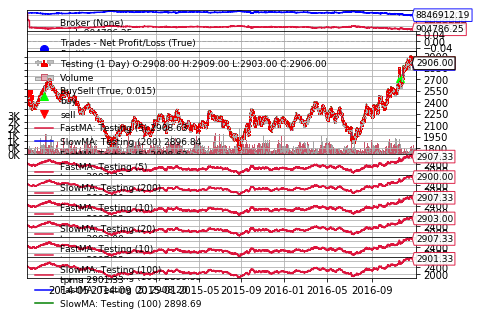

[[<Figure size 432x288 with 10 Axes>]]

In [46]:
imagefile = "graph{}.png".format("finalRun")
datapath = join(getDataPath(),"Graph",imagefile)
cerebro.plot(style='candlestick', iplot=False, ytight=True, subplot=False, path=datapath)

In [47]:
print ("Run,Ror")
for line in zip(training.keys(), training.values()):
    print ('{},{}'.format(*line))

Run,Ror
0,1.1931798349619276
1,1.1555251627215948
2,1.1555251627215948
3,1.1555251627215948
4,1.1555251627215948
5,1.0415108955125527
6,1.1931798349619276
7,1.0328
8,1.0328
9,1.0328
10,0.8489314658866296
11,1.0328
12,1.034238347854518
13,1.0328
14,1.0328
15,1.0328
16,1.0328
17,1.0328
18,1.166090735908529
19,1.0328
20,1.116163359840267
21,1.116163359840267
22,1.0328
23,1.0328
24,1.2411162456151574
25,1.2411162456151574
26,1.2411162456151574
27,1.0328
28,1.03382595641742
29,1.0328
30,1.0328
31,1.1055131726527405
32,1.1055131726527405
33,1.071517345671854
34,1.0328
35,1.0328
36,1.0328
37,1.0328
38,1.0328
39,1.0328
40,1.0328
41,1.0328
42,1.0328
43,1.209533571608117
44,1.209533571608117
45,1.1062788918430153
46,1.1931414327775975
47,1.1931414327775975
48,1.1931414327775975
49,1.1931414327775975
50,1.0617377832768378


### Rerunning with the stored best individual
Running the trades again

In [48]:
manualBestInd = {'individual': [['tma', '10', '100', 'H', '-0.5'],
       ['tpma', '5', '10', 'VL', '0.1'],
       ['sma', '5', '150', 'VL', '-0.2'],
       ['tpma', '20', '200', 'VL', '-0.6'],
       ['sma', '15', '20', 'L', '-0.8'],
       ['ama', '5', '100', 'EL', '-0.2'],
       ['tma', '20', '200', 'EH', '0.4'],
       ['sma', '20', '100', 'EH', '0.7'],
       ['tma', '10', '50', 'EL', '-1.0'],
       ['ama', '5', '100', 'VH', '0.1']], 
                 'co_rate': 0.24255226433051835, 'ror': 1.3165614282729488, 
                 'profit': 13218658.076668203, 'rating': 0, 'probability': 0.600365709799237}

In [49]:
cerebro = main(manualBestInd, bSilentMode=False, bTestMode=False, plotFileName="finalRerun.png")

Starting Portfolio Value: 10000000.00
2014-01-17, Testing SELL CREATE, 2345.00 with volume 6.00
2014-01-17, SELL EXECUTED, Size: -257.14, Price: 2338.00, Cost: 1028564.34, Comm 30.00, Portfolio Value: 10000000.00, Cash: 10000000.00
2014-01-21, Testing SELL CREATE, 2366.00 with volume 8.00
2014-01-21, SELL EXECUTED, Size: -341.42, Price: 2370.00, Cost: 1365692.70, Comm 30.00, Portfolio Value: 9991932.74, Cash: 8963368.40
2014-02-08, Testing SELL CREATE, 2375.00 with volume 10.00
2014-02-08, SELL EXECUTED, Size: -233.01, Price: 2373.00, Cost: 932024.32, Comm 30.00, Portfolio Value: 9989154.38, Cash: 7594897.34
2014-02-15, Testing SELL CREATE, 2470.00 with volume 111.00
2014-02-15, SELL EXECUTED, Size: -281.69, Price: 2454.00, Cost: 1126743.17, Comm 30.00, Portfolio Value: 9921390.66, Cash: 6595109.30
2014-02-19, Testing SELL CREATE, 2492.00 with volume 46.00
2014-02-19, SELL EXECUTED, Size: -276.98, Price: 2491.00, Cost: 1107922.40, Comm 30.00, Portfolio Value: 9879879.28, Cash: 5426854.

2014-03-06, Testing SELL CREATE, 2650.00 with volume 40.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -783598.5635211866
2014-03-06, Testing SELL CREATE, 2647.00 with volume 99.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -893430.564874124
2014-03-06, Testing SELL CREATE, 2647.00 with volume 25.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1003911.1030117483
2014-03-06, Testing SELL CREATE, 2648.00 with volume 16.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1107680.2304881227
2014-03-06, Testing SELL CREATE, 2649.00 with volume 3.00
2014-03-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2014-03-11, Testing SELL CREATE, 2696.00 with volume 47.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1014102.4341038534
2014-03-11, Testing SELL CREATE, 2697.00 with volume 24.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1652353.3112759702
2014-03-11, Testing SELL CREATE, 2697.00 with volume 28.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2187237.3342041364
2014-03-11, Testing SELL CREATE, 2696.00 with volume 106.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2541366.1463747667
2014-03-11, Testing SELL CREATE, 2692.00 with volume 255.00
2014-03-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and

2014-03-21, Testing SELL CREATE, 2600.00 with volume 1.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -559560.7946180919
2014-03-21, Testing SELL CREATE, 2600.00 with volume 1.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -612392.5950430196
2014-03-21, Testing SELL CREATE, 2598.00 with volume 1.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -626312.7602259993
2014-03-21, Testing SELL CREATE, 2599.00 with volume 4.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -623906.101530249
2014-03-21, Testing SELL CREATE, 2598.00 with volume 2.00
2014-03-21, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short s

2014-04-04, Testing SELL CREATE, 2482.00 with volume 25.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -586584.9748366969
2014-04-04, Testing SELL CREATE, 2483.00 with volume 4.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -710699.3840330548
2014-04-04, Testing SELL CREATE, 2485.00 with volume 13.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -801665.5594600129
2014-04-04, Testing SELL CREATE, 2487.00 with volume 10.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -872835.1252376182
2014-04-04, Testing SELL CREATE, 2490.00 with volume 2.00
2014-04-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2014-04-15, Testing SELL CREATE, 2495.00 with volume 6.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -932913.2881454993
2014-04-15, Testing SELL CREATE, 2494.00 with volume 8.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -901638.0361900756
2014-04-15, Testing SELL CREATE, 2493.00 with volume 23.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -895830.0641443926
2014-04-15, Testing SELL CREATE, 2494.00 with volume 7.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -898434.7473889301
2014-04-15, Testing SELL CREATE, 2495.00 with volume 5.00
2014-04-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2014-04-26, Testing SELL CREATE, 2533.00 with volume 113.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -565615.6589240932
2014-04-26, Testing SELL CREATE, 2531.00 with volume 101.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -604123.6656063937
2014-04-26, Testing SELL CREATE, 2531.00 with volume 55.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -607784.5106521958
2014-04-26, Testing SELL CREATE, 2531.00 with volume 25.00
2014-04-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -568867.1331967191
2014-05-24, Testing SELL CREATE, 2406.00 with volume 12.00
2014-05-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2014-06-19, Testing SELL CREATE, 2336.00 with volume 14.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -604484.7739110397
2014-06-19, Testing SELL CREATE, 2336.00 with volume 16.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -688095.3466348411
2014-06-19, Testing SELL CREATE, 2336.00 with volume 22.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -740242.211838815
2014-06-19, Testing SELL CREATE, 2333.00 with volume 104.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -755219.4947288372
2014-06-19, Testing SELL CREATE, 2333.00 with volume 23.00
2014-06-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2014-08-26, Testing SELL CREATE, 1893.00 with volume 83.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -590304.8365952038
2014-08-26, Testing SELL CREATE, 1895.00 with volume 201.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -671844.0545580467
2014-08-26, Testing SELL CREATE, 1896.00 with volume 350.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -798044.3047583429
2014-08-26, Testing SELL CREATE, 1901.00 with volume 102.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -992657.4378563674
2014-08-26, Testing SELL CREATE, 1902.00 with volume 146.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and n

2014-08-26, Testing SELL CREATE, 1929.00 with volume 175.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -674476.6567285979
2014-08-26, Testing SELL CREATE, 1927.00 with volume 91.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -863875.4249019042
2014-08-26, Testing SELL CREATE, 1930.00 with volume 6.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1037337.0527929661
2014-08-26, Testing SELL CREATE, 1929.00 with volume 134.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1181209.883035573
2014-08-26, Testing SELL CREATE, 1930.00 with volume 123.00
2014-08-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2014-09-09, Testing SELL CREATE, 1937.00 with volume 396.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -630364.2133897698
2014-09-09, Testing SELL CREATE, 1937.00 with volume 96.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -842163.2188258242
2014-09-09, Testing SELL CREATE, 1940.00 with volume 66.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -921288.3005749815
2014-09-09, Testing SELL CREATE, 1940.00 with volume 48.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -877248.8160219835
2014-09-09, Testing SELL CREATE, 1941.00 with volume 53.00
2014-09-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2014-09-16, Testing SELL CREATE, 2002.00 with volume 167.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -638336.7766308346
2014-09-16, Testing SELL CREATE, 2002.00 with volume 72.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -746676.4987500967
2014-09-16, Testing SELL CREATE, 1999.00 with volume 180.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -804901.8967740219
2014-09-16, Testing SELL CREATE, 2000.00 with volume 96.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -809505.1309828878
2014-09-16, Testing SELL CREATE, 2004.00 with volume 147.00
2014-09-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2014-09-24, Testing SELL CREATE, 1995.00 with volume 3.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -592550.814957725
2014-09-24, Testing SELL CREATE, 1995.00 with volume 50.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -626949.2281624755
2014-09-24, Testing SELL CREATE, 1995.00 with volume 9.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -652428.7043287846
2014-09-24, Testing SELL CREATE, 1995.00 with volume 35.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -668940.6261012187
2014-09-24, Testing SELL CREATE, 1996.00 with volume 22.00
2014-09-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2014-10-08, Testing SELL CREATE, 2077.00 with volume 3.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -832276.3569755852
2014-10-08, Testing SELL CREATE, 2077.00 with volume 2.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1014624.6333872164
2014-10-08, Testing SELL CREATE, 2075.00 with volume 4.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1070680.6873694884
2014-10-08, Testing SELL CREATE, 2074.00 with volume 9.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1004584.4925568037
2014-10-08, Testing SELL CREATE, 2074.00 with volume 3.00
2014-10-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2014-10-18, Testing SELL CREATE, 1996.00 with volume 49.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -553389.4401715121
2014-10-18, Testing SELL CREATE, 2001.00 with volume 44.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -567307.211451862
2014-10-18, Testing SELL CREATE, 2002.00 with volume 29.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -640118.1287715246
2014-10-18, Testing SELL CREATE, 2001.00 with volume 32.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -701266.1618682477
2014-10-18, Testing SELL CREATE, 2000.00 with volume 15.00
2014-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sh

2014-11-12, Testing SELL CREATE, 2130.00 with volume 573.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -558848.9636659046
2014-11-12, Testing SELL CREATE, 2126.00 with volume 643.00
2014-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -721998.5540817614
2014-11-13, Testing SELL CREATE, 2137.00 with volume 816.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -961527.4700823723
2014-11-13, Testing SELL CREATE, 2144.00 with volume 346.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1270946.3001945675
2014-11-13, Testing SELL CREATE, 2144.00 with volume 104.00
2014-11-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and

2014-12-03, Testing SELL CREATE, 1994.00 with volume 101.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -563926.2616398671
2014-12-03, Testing SELL CREATE, 1994.00 with volume 63.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1015408.341270236
2014-12-03, Testing SELL CREATE, 1993.00 with volume 14.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1441023.8246232728
2014-12-03, Testing SELL CREATE, 1994.00 with volume 66.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1756718.8581917805
2014-12-03, Testing SELL CREATE, 1994.00 with volume 69.00
2014-12-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2014-12-04, Testing SELL CREATE, 2030.00 with volume 34.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -901987.9924318492
2014-12-04, Testing SELL CREATE, 2032.00 with volume 3.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -746581.638531124
2014-12-04, Testing SELL CREATE, 2032.00 with volume 3.00
2014-12-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -613930.0608328934
2014-12-09, Testing SELL CREATE, 2054.00 with volume 19.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -602409.7633206635
2014-12-09, Testing SELL CREATE, 2052.00 with volume 73.00
2014-12-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-01-03, Testing SELL CREATE, 2137.00 with volume 263.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -578248.0624161022
2015-01-03, Testing SELL CREATE, 2138.00 with volume 282.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -704858.5512346029
2015-01-03, Testing SELL CREATE, 2139.00 with volume 56.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -832618.6917349398
2015-01-03, Testing SELL CREATE, 2139.00 with volume 448.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -983355.7317252865
2015-01-03, Testing SELL CREATE, 2142.00 with volume 41.00
2015-01-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-01-08, Testing SELL CREATE, 2168.00 with volume 470.00
2015-01-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -561475.731338854
2015-01-08, Testing SELL CREATE, 2170.00 with volume 158.00
2015-01-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -592101.3115726662
2015-01-08, Testing SELL CREATE, 2171.00 with volume 99.00
2015-01-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -624995.3558072551
2015-01-08, Testing SELL CREATE, 2172.00 with volume 155.00
2015-01-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -660325.5768850533
2015-01-08, Testing SELL CREATE, 2171.00 with volume 42.00
2015-01-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2015-01-13, Testing SELL CREATE, 2227.00 with volume 338.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -606156.2003725356
2015-01-13, Testing SELL CREATE, 2224.00 with volume 225.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -799930.0822285352
2015-01-13, Testing SELL CREATE, 2223.00 with volume 102.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -967110.8915998539
2015-01-13, Testing SELL CREATE, 2224.00 with volume 53.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1094133.1245185616
2015-01-13, Testing SELL CREATE, 2225.00 with volume 115.00
2015-01-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2015-02-05, Testing SELL CREATE, 2077.00 with volume 153.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -984335.5348020329
2015-02-05, Testing SELL CREATE, 2082.00 with volume 14.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1900106.99932382
2015-02-05, Testing SELL CREATE, 2081.00 with volume 91.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3023353.7305785716
2015-02-05, Testing SELL CREATE, 2079.00 with volume 20.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3229616.156655853
2015-02-05, Testing SELL CREATE, 2078.00 with volume 9.00
2015-02-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2015-02-06, Testing SELL CREATE, 2188.00 with volume 85.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -621005.8870387273
2015-02-06, Testing SELL CREATE, 2188.00 with volume 85.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -952285.1657591615
2015-02-06, Testing SELL CREATE, 2193.00 with volume 164.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1419667.1716409586
2015-02-06, Testing SELL CREATE, 2187.00 with volume 13.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1950173.6362031929
2015-02-06, Testing SELL CREATE, 2189.00 with volume 12.00
2015-02-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-02-07, Testing SELL CREATE, 2217.00 with volume 32.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1414215.9415240902
2015-02-07, Testing SELL CREATE, 2216.00 with volume 12.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1346869.576001132
2015-02-07, Testing SELL CREATE, 2213.00 with volume 179.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1250323.600213163
2015-02-07, Testing SELL CREATE, 2212.00 with volume 73.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1141529.0366322673
2015-02-07, Testing SELL CREATE, 2214.00 with volume 44.00
2015-02-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-02-11, Testing SELL CREATE, 2234.00 with volume 76.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -578873.9052180338
2015-02-11, Testing SELL CREATE, 2234.00 with volume 117.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -573065.7594029147
2015-02-11, Testing SELL CREATE, 2235.00 with volume 244.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -581335.4539044779
2015-02-11, Testing SELL CREATE, 2235.00 with volume 10.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -607784.5106521957
2015-02-11, Testing SELL CREATE, 2233.00 with volume 142.00
2015-02-11, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-03-04, Testing SELL CREATE, 2281.00 with volume 118.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -638701.9818364374
2015-03-04, Testing SELL CREATE, 2281.00 with volume 80.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -805288.8850955521
2015-03-04, Testing SELL CREATE, 2281.00 with volume 107.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -958814.0604699178
2015-03-04, Testing SELL CREATE, 2279.00 with volume 100.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1093520.7681288861
2015-03-04, Testing SELL CREATE, 2277.00 with volume 94.00
2015-03-04, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and n

2015-03-20, Testing SELL CREATE, 2118.00 with volume 18.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2196244.92205667
2015-03-20, Testing SELL CREATE, 2116.00 with volume 13.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2139873.3757626736
2015-03-20, Testing SELL CREATE, 2117.00 with volume 5.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1937082.4827929467
2015-03-20, Testing SELL CREATE, 2118.00 with volume 6.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1624417.8167313167
2015-03-20, Testing SELL CREATE, 2119.00 with volume 13.00
2015-03-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2015-03-27, Testing SELL CREATE, 2099.00 with volume 2.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -703879.9233613928
2015-03-27, Testing SELL CREATE, 2099.00 with volume 1.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -845648.184946633
2015-03-27, Testing SELL CREATE, 2101.00 with volume 24.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -954525.6195448219
2015-03-27, Testing SELL CREATE, 2100.00 with volume 1.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1017550.7965688248
2015-03-27, Testing SELL CREATE, 2099.00 with volume 28.00
2015-03-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-04-14, Testing SELL CREATE, 2061.00 with volume 105.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -595386.235655753
2015-04-14, Testing SELL CREATE, 2060.00 with volume 56.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -876554.9397832825
2015-04-14, Testing SELL CREATE, 2060.00 with volume 68.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1101992.4546037342
2015-04-14, Testing SELL CREATE, 2061.00 with volume 168.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1271121.848276114
2015-04-14, Testing SELL CREATE, 2063.00 with volume 251.00
2015-04-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3121704.8726189635
2015-04-16, Testing SELL CREATE, 2088.00 with volume 16.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3086877.3529489036
2015-04-16, Testing SELL CREATE, 2087.00 with volume 20.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3013595.3341760547
2015-04-16, Testing SELL CREATE, 2084.00 with volume 50.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2881373.317684775
2015-04-16, Testing SELL CREATE, 2085.00 with volume 8.00
2015-04-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2691831.4804158253
2015-04-16, Test

2015-05-06, Testing SELL CREATE, 2083.00 with volume 709.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -562590.3368753965
2015-05-06, Testing SELL CREATE, 2082.00 with volume 420.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1949712.1377901055
2015-05-06, Testing SELL CREATE, 2082.00 with volume 129.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3211217.0151053118
2015-05-06, Testing SELL CREATE, 2076.00 with volume 23.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3228964.683843889
2015-05-06, Testing SELL CREATE, 2076.00 with volume 39.00
2015-05-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2015-05-12, Testing SELL CREATE, 2102.00 with volume 51.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -570875.45123587
2015-05-12, Testing SELL CREATE, 2102.00 with volume 51.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -684659.7695336698
2015-05-12, Testing SELL CREATE, 2100.00 with volume 97.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -725670.4485843239
2015-05-12, Testing SELL CREATE, 2100.00 with volume 17.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -690841.1754458521
2015-05-12, Testing SELL CREATE, 2100.00 with volume 23.00
2015-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2015-05-29, Testing SELL CREATE, 2132.00 with volume 206.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -593405.2961000565
2015-05-29, Testing SELL CREATE, 2133.00 with volume 116.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -859974.4662805741
2015-05-29, Testing SELL CREATE, 2134.00 with volume 231.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1038493.7284359783
2015-05-29, Testing SELL CREATE, 2138.00 with volume 124.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1135999.412726304
2015-05-29, Testing SELL CREATE, 2139.00 with volume 67.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2015-05-29, Testing SELL CREATE, 2148.00 with volume 8.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -919976.1984523918
2015-05-29, Testing SELL CREATE, 2148.00 with volume 23.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -884857.1826196223
2015-05-29, Testing SELL CREATE, 2147.00 with volume 1.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -825935.7074712048
2015-05-29, Testing SELL CREATE, 2146.00 with volume 4.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -744828.0112733636
2015-05-29, Testing SELL CREATE, 2145.00 with volume 21.00
2015-05-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-06-05, Testing SELL CREATE, 2247.00 with volume 11.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -674060.6221730363
2015-06-05, Testing SELL CREATE, 2245.00 with volume 28.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -791291.5952048335
2015-06-05, Testing SELL CREATE, 2244.00 with volume 1.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -886604.2071083132
2015-06-05, Testing SELL CREATE, 2244.00 with volume 4.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -953404.8894166766
2015-06-05, Testing SELL CREATE, 2244.00 with volume 4.00
2015-06-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-07-02, Testing SELL CREATE, 2182.00 with volume 111.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -670230.2255062783
2015-07-02, Testing SELL CREATE, 2180.00 with volume 168.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -810573.5632449732
2015-07-02, Testing SELL CREATE, 2180.00 with volume 57.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -846434.8751575107
2015-07-02, Testing SELL CREATE, 2181.00 with volume 41.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -769754.6300728308
2015-07-02, Testing SELL CREATE, 2181.00 with volume 33.00
2015-07-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2015-07-30, Testing SELL CREATE, 2070.00 with volume 320.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -628496.2390112703
2015-07-30, Testing SELL CREATE, 2071.00 with volume 9.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -673690.9273057966
2015-07-30, Testing SELL CREATE, 2072.00 with volume 107.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -714498.6583554806
2015-07-30, Testing SELL CREATE, 2072.00 with volume 133.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -758644.2553982568
2015-07-30, Testing SELL CREATE, 2072.00 with volume 41.00
2015-07-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2015-08-22, Testing SELL CREATE, 1938.00 with volume 357.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -633052.8715019973
2015-08-22, Testing SELL CREATE, 1939.00 with volume 242.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -791099.1945527997
2015-08-22, Testing SELL CREATE, 1939.00 with volume 48.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -943519.8001736113
2015-08-22, Testing SELL CREATE, 1938.00 with volume 133.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1052617.4560503631
2015-08-22, Testing SELL CREATE, 1938.00 with volume 80.00
2015-08-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and n

2015-08-29, Testing SELL CREATE, 1900.00 with volume 135.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -573244.7203714189
2015-08-29, Testing SELL CREATE, 1899.00 with volume 61.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -733767.7277710933
2015-08-29, Testing SELL CREATE, 1900.00 with volume 132.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -868669.0223869388
2015-08-29, Testing SELL CREATE, 1902.00 with volume 56.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -960707.7052934209
2015-08-29, Testing SELL CREATE, 1903.00 with volume 89.00
2015-08-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2015-09-08, Testing SELL CREATE, 1956.00 with volume 10.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -561252.9224342221
2015-09-08, Testing SELL CREATE, 1957.00 with volume 95.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -661751.1470402859
2015-09-08, Testing SELL CREATE, 1958.00 with volume 97.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -764507.8718584863
2015-09-08, Testing SELL CREATE, 1960.00 with volume 216.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -877943.0788142417
2015-09-08, Testing SELL CREATE, 1964.00 with volume 179.00
2015-09-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2015-09-22, Testing SELL CREATE, 2014.00 with volume 7.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -601688.7923535197
2015-09-22, Testing SELL CREATE, 2012.00 with volume 8.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -780334.148949635
2015-09-22, Testing SELL CREATE, 2015.00 with volume 1.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -939613.4201757883
2015-09-22, Testing SELL CREATE, 2007.00 with volume 24.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1035446.6107377162
2015-09-22, Testing SELL CREATE, 2008.00 with volume 3.00
2015-09-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2015-09-26, Testing SELL CREATE, 2155.00 with volume 137.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2235904.5318816337
2015-09-26, Testing SELL CREATE, 2154.00 with volume 38.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2150912.577205018
2015-09-26, Testing SELL CREATE, 2154.00 with volume 106.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2085742.5460264483
2015-09-26, Testing SELL CREATE, 2154.00 with volume 1.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2023519.9058618085
2015-09-26, Testing SELL CREATE, 2154.00 with volume 3.00
2015-09-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-09-29, Testing SELL CREATE, 2236.00 with volume 10.00
2015-09-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -590304.8365951517
2015-09-29, Testing SELL CREATE, 2234.00 with volume 6.00
2015-09-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -618916.7014762204
2015-09-29, Testing SELL CREATE, 2234.00 with volume 7.00
2015-09-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -613206.321301548
2015-09-29, Testing SELL CREATE, 2236.00 with volume 5.00
2015-09-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -558315.3403865253
2015-09-29, Testing SELL CREATE, 2250.00 with volume 10.00
2015-09-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2015-10-02, Testing SELL CREATE, 2257.00 with volume 77.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -557648.612173584
2015-10-02, Testing SELL CREATE, 2258.00 with volume 170.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -619461.8578233451
2015-10-02, Testing SELL CREATE, 2254.00 with volume 8.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -686144.2882943767
2015-10-02, Testing SELL CREATE, 2259.00 with volume 1.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -753652.9224976406
2015-10-02, Testing SELL CREATE, 2259.00 with volume 42.00
2015-10-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2015-10-06, Testing SELL CREATE, 2267.00 with volume 1.00
2015-10-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -557470.8743954266
2015-10-06, Testing SELL CREATE, 2269.00 with volume 24.00
2015-10-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -802003.2929885719
2015-10-06, Testing SELL CREATE, 2267.00 with volume 2.00
2015-10-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -973422.1999238044
2015-10-06, Testing SELL CREATE, 2263.00 with volume 13.00
2015-10-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1043870.4881403138
2015-10-06, Testing SELL CREATE, 2263.00 with volume 3.00
2015-10-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2015-10-13, Testing SELL CREATE, 2125.00 with volume 64.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -880276.6510668859
2015-10-13, Testing SELL CREATE, 2125.00 with volume 117.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -805869.5921027241
2015-10-13, Testing SELL CREATE, 2125.00 with volume 53.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -746866.2406154606
2015-10-13, Testing SELL CREATE, 2125.00 with volume 2.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -702575.2863169204
2015-10-13, Testing SELL CREATE, 2126.00 with volume 7.00
2015-10-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sh

2015-10-16, Testing SELL CREATE, 2164.00 with volume 2.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -647205.2958391657
2015-10-16, Testing SELL CREATE, 2162.00 with volume 29.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -655646.1370214036
2015-10-16, Testing SELL CREATE, 2165.00 with volume 1.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -600563.0707672416
2015-10-16, Testing SELL CREATE, 2176.00 with volume 63.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -658488.4689135214
2015-10-16, Testing SELL CREATE, 2178.00 with volume 5.00
2015-10-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-10-30, Testing SELL CREATE, 2187.00 with volume 71.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -708032.6286800634
2015-10-30, Testing SELL CREATE, 2178.00 with volume 871.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -986039.1276427867
2015-10-30, Testing SELL CREATE, 2177.00 with volume 290.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1125490.8648740146
2015-10-30, Testing SELL CREATE, 2176.00 with volume 189.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1131501.6483664322
2015-10-30, Testing SELL CREATE, 2181.00 with volume 48.00
2015-10-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2015-11-18, Testing SELL CREATE, 2077.00 with volume 48.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -586047.5897612626
2015-11-18, Testing SELL CREATE, 2077.00 with volume 4.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -625540.3262915794
2015-11-18, Testing SELL CREATE, 2077.00 with volume 50.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -655462.5081922081
2015-11-18, Testing SELL CREATE, 2079.00 with volume 1.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -671382.7527762789
2015-11-18, Testing SELL CREATE, 2079.00 with volume 3.00
2015-11-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2015-12-02, Testing SELL CREATE, 2110.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -714686.572272662
2015-12-02, Testing SELL CREATE, 2109.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -786148.7929904298
2015-12-02, Testing SELL CREATE, 2108.00 with volume 1.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -734712.0408188902
2015-12-02, Testing SELL CREATE, 2108.00 with volume 21.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -658947.4994205843
2015-12-02, Testing SELL CREATE, 2108.00 with volume 30.00
2015-12-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2015-12-08, Testing SELL CREATE, 2173.00 with volume 2.00
2015-12-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -590933.3231068536
2015-12-08, Testing SELL CREATE, 2170.00 with volume 1.00
2015-12-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -622273.9333534578
2015-12-08, Testing SELL CREATE, 2169.00 with volume 15.00
2015-12-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -606337.0234064978
2015-12-08, Testing SELL CREATE, 2172.00 with volume 1.00
2015-12-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -574050.3447744701
2015-12-08, Testing SELL CREATE, 2174.00 with volume 2.00
2015-12-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2015-12-22, Testing SELL CREATE, 2124.00 with volume 65.00
2015-12-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -553035.1229792044
2015-12-22, Testing SELL CREATE, 2124.00 with volume 33.00
2015-12-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -640300.9706529649
2015-12-22, Testing SELL CREATE, 2123.00 with volume 176.00
2015-12-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -733626.1417097999
2015-12-22, Testing SELL CREATE, 2123.00 with volume 186.00
2015-12-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -837759.5975992585
2015-12-22, Testing SELL CREATE, 2125.00 with volume 182.00
2015-12-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2015-12-30, Testing SELL CREATE, 2191.00 with volume 45.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1255906.6591054876
2015-12-30, Testing SELL CREATE, 2192.00 with volume 59.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1080193.6231024323
2015-12-30, Testing SELL CREATE, 2193.00 with volume 53.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -936109.799684279
2015-12-30, Testing SELL CREATE, 2192.00 with volume 213.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -812370.1467938868
2015-12-30, Testing SELL CREATE, 2191.00 with volume 126.00
2015-12-30, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-02-03, Testing SELL CREATE, 2117.00 with volume 56.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -607422.4882250243
2016-02-03, Testing SELL CREATE, 2118.00 with volume 302.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -768130.5638862785
2016-02-03, Testing SELL CREATE, 2117.00 with volume 59.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -904490.5428158557
2016-02-03, Testing SELL CREATE, 2115.00 with volume 300.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -994724.2407709699
2016-02-03, Testing SELL CREATE, 2115.00 with volume 6.00
2016-02-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-03-01, Testing SELL CREATE, 2163.00 with volume 218.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -623588.5746242466
2016-03-01, Testing SELL CREATE, 2165.00 with volume 362.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -759501.9043869937
2016-03-01, Testing SELL CREATE, 2167.00 with volume 122.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -905142.0301811803
2016-03-01, Testing SELL CREATE, 2167.00 with volume 16.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1057279.0820341222
2016-03-01, Testing SELL CREATE, 2166.00 with volume 52.00
2016-03-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and n

2016-03-12, Testing SELL CREATE, 2180.00 with volume 269.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -931292.7979074105
2016-03-12, Testing SELL CREATE, 2180.00 with volume 95.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1375986.1704364263
2016-03-12, Testing SELL CREATE, 2180.00 with volume 156.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1700683.4011636337
2016-03-12, Testing SELL CREATE, 2184.00 with volume 45.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1871068.8010652305
2016-03-12, Testing SELL CREATE, 2185.00 with volume 56.00
2016-03-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2016-03-15, Testing SELL CREATE, 2228.00 with volume 46.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -583711.8516803075
2016-03-15, Testing SELL CREATE, 2229.00 with volume 50.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -856025.125796606
2016-03-15, Testing SELL CREATE, 2229.00 with volume 35.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1116576.8937759085
2016-03-15, Testing SELL CREATE, 2228.00 with volume 60.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1330340.5552966774
2016-03-15, Testing SELL CREATE, 2227.00 with volume 64.00
2016-03-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-03-19, Testing SELL CREATE, 2271.00 with volume 6.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -624859.1489726065
2016-03-19, Testing SELL CREATE, 2268.00 with volume 73.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -864566.1471675142
2016-03-19, Testing SELL CREATE, 2266.00 with volume 119.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1024491.405330947
2016-03-19, Testing SELL CREATE, 2268.00 with volume 12.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1105056.509796548
2016-03-19, Testing SELL CREATE, 2269.00 with volume 11.00
2016-03-19, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-03-23, Testing SELL CREATE, 2325.00 with volume 16.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -645514.5248951381
2016-03-23, Testing SELL CREATE, 2326.00 with volume 12.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -851105.9733691752
2016-03-23, Testing SELL CREATE, 2323.00 with volume 20.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1044133.3715769919
2016-03-23, Testing SELL CREATE, 2325.00 with volume 2.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1230807.9591468307
2016-03-23, Testing SELL CREATE, 2323.00 with volume 17.00
2016-03-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-03-29, Testing SELL CREATE, 2355.00 with volume 8.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -554674.6300657492
2016-03-29, Testing SELL CREATE, 2357.00 with volume 7.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -663040.1222055991
2016-03-29, Testing SELL CREATE, 2358.00 with volume 29.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -802968.7484356811
2016-03-29, Testing SELL CREATE, 2357.00 with volume 30.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -931849.6037684608
2016-03-29, Testing SELL CREATE, 2359.00 with volume 25.00
2016-03-29, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2016-04-01, Testing SELL CREATE, 2366.00 with volume 64.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -674245.5097045568
2016-04-01, Testing SELL CREATE, 2364.00 with volume 16.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -795531.9032506541
2016-04-01, Testing SELL CREATE, 2369.00 with volume 27.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -903889.4720997799
2016-04-01, Testing SELL CREATE, 2373.00 with volume 34.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -993277.119759055
2016-04-01, Testing SELL CREATE, 2374.00 with volume 65.00
2016-04-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sh

2016-04-06, Testing SELL CREATE, 2396.00 with volume 1.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -577935.2523501576
2016-04-06, Testing SELL CREATE, 2397.00 with volume 1.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -685912.2182600147
2016-04-06, Testing SELL CREATE, 2391.00 with volume 18.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -744591.2216576119
2016-04-06, Testing SELL CREATE, 2393.00 with volume 3.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -754982.0099190116
2016-04-06, Testing SELL CREATE, 2397.00 with volume 1.00
2016-04-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2016-05-05, Testing SELL CREATE, 2214.00 with volume 146.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -615559.9481219383
2016-05-05, Testing SELL CREATE, 2212.00 with volume 157.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -783694.7044740589
2016-05-05, Testing SELL CREATE, 2212.00 with volume 36.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -966241.1028687477
2016-05-05, Testing SELL CREATE, 2211.00 with volume 50.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1131221.0196141663
2016-05-05, Testing SELL CREATE, 2211.00 with volume 63.00
2016-05-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-05-12, Testing SELL CREATE, 2331.00 with volume 270.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1159162.3168039036
2016-05-12, Testing SELL CREATE, 2329.00 with volume 199.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2650253.558728879
2016-05-12, Testing SELL CREATE, 2331.00 with volume 74.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3216761.270102939
2016-05-12, Testing SELL CREATE, 2333.00 with volume 54.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3131021.962241436
2016-05-12, Testing SELL CREATE, 2334.00 with volume 28.00
2016-05-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-05-26, Testing SELL CREATE, 2166.00 with volume 23.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -561208.3651373475
2016-05-26, Testing SELL CREATE, 2167.00 with volume 13.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -626494.5763111935
2016-05-26, Testing SELL CREATE, 2167.00 with volume 39.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -691815.1155640271
2016-05-26, Testing SELL CREATE, 2168.00 with volume 25.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -757120.9884778755
2016-05-26, Testing SELL CREATE, 2168.00 with volume 19.00
2016-05-26, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-05-27, Testing SELL CREATE, 2215.00 with volume 28.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -677624.4139572566
2016-05-27, Testing SELL CREATE, 2214.00 with volume 66.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -808631.6375114422
2016-05-27, Testing SELL CREATE, 2215.00 with volume 3.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -851351.4707554944
2016-05-27, Testing SELL CREATE, 2215.00 with volume 2.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -843045.8107944446
2016-05-27, Testing SELL CREATE, 2215.00 with volume 12.00
2016-05-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sho

2016-06-01, Testing SELL CREATE, 2261.00 with volume 26.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -584430.0986915646
2016-06-01, Testing SELL CREATE, 2260.00 with volume 18.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -685680.1904656019
2016-06-01, Testing SELL CREATE, 2259.00 with volume 18.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -760694.0546437181
2016-06-01, Testing SELL CREATE, 2260.00 with volume 11.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -815568.0093693851
2016-06-01, Testing SELL CREATE, 2259.00 with volume 16.00
2016-06-01, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-06-24, Testing SELL CREATE, 2066.00 with volume 431.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -686469.257339244
2016-06-24, Testing SELL CREATE, 2070.00 with volume 195.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -856813.9938927483
2016-06-24, Testing SELL CREATE, 2071.00 with volume 264.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1068631.2363439489
2016-06-24, Testing SELL CREATE, 2069.00 with volume 147.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1308041.258994278
2016-06-24, Testing SELL CREATE, 2068.00 with volume 64.00
2016-06-24, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and n

2016-07-05, Testing SELL CREATE, 2061.00 with volume 184.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -871494.5015436641
2016-07-05, Testing SELL CREATE, 2061.00 with volume 89.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1270595.2701405897
2016-07-05, Testing SELL CREATE, 2064.00 with volume 65.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1546233.1585141146
2016-07-05, Testing SELL CREATE, 2064.00 with volume 123.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1666093.7021272478
2016-07-05, Testing SELL CREATE, 2067.00 with volume 92.00
2016-07-05, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2016-07-14, Testing SELL CREATE, 1906.00 with volume 84.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -761362.152791605
2016-07-14, Testing SELL CREATE, 1906.00 with volume 242.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1305570.569617863
2016-07-14, Testing SELL CREATE, 1909.00 with volume 130.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1754265.7178633541
2016-07-14, Testing SELL CREATE, 1906.00 with volume 56.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2116654.319699254
2016-07-14, Testing SELL CREATE, 1905.00 with volume 65.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2016-07-14, Testing SELL CREATE, 1911.00 with volume 18.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -835311.7359797091
2016-07-14, Testing SELL CREATE, 1911.00 with volume 9.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -740903.0508547954
2016-07-14, Testing SELL CREATE, 1911.00 with volume 17.00
2016-07-14, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -634826.9470433283
2016-07-15, Testing SELL CREATE, 1920.00 with volume 223.00
2016-07-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -555251.1522861486
2016-07-15, Testing SELL CREATE, 1920.00 with volume 82.00
2016-07-15, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-07-20, Testing SELL CREATE, 1992.00 with volume 8.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -584340.2963705353
2016-07-20, Testing SELL CREATE, 1994.00 with volume 61.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -755457.0243641328
2016-07-20, Testing SELL CREATE, 1996.00 with volume 78.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -997468.0319627032
2016-07-20, Testing SELL CREATE, 1998.00 with volume 16.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1283053.0753127502
2016-07-20, Testing SELL CREATE, 1998.00 with volume 146.00
2016-07-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-07-27, Testing SELL CREATE, 1999.00 with volume 194.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -640346.6851718493
2016-07-27, Testing SELL CREATE, 2004.00 with volume 11.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1538690.447494298
2016-07-27, Testing SELL CREATE, 2004.00 with volume 296.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2426776.0103566884
2016-07-27, Testing SELL CREATE, 2006.00 with volume 54.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2967008.0268772207
2016-07-27, Testing SELL CREATE, 2007.00 with volume 7.00
2016-07-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-08-02, Testing SELL CREATE, 2040.00 with volume 69.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -724068.5684517162
2016-08-02, Testing SELL CREATE, 2041.00 with volume 97.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -911625.320501174
2016-08-02, Testing SELL CREATE, 2042.00 with volume 81.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -938245.3714326576
2016-08-02, Testing SELL CREATE, 2042.00 with volume 42.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -807564.8621107051
2016-08-02, Testing SELL CREATE, 2043.00 with volume 198.00
2016-08-02, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-08-13, Testing SELL CREATE, 2183.00 with volume 99.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -620643.8154926888
2016-08-13, Testing SELL CREATE, 2185.00 with volume 15.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -737265.2202153137
2016-08-13, Testing SELL CREATE, 2183.00 with volume 33.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -837564.2412545076
2016-08-13, Testing SELL CREATE, 2183.00 with volume 12.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -906646.7640996361
2016-08-13, Testing SELL CREATE, 2181.00 with volume 11.00
2016-08-13, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-08-16, Testing SELL CREATE, 2266.00 with volume 130.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -696136.1894020459
2016-08-16, Testing SELL CREATE, 2265.00 with volume 55.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -791484.0254084617
2016-08-16, Testing SELL CREATE, 2263.00 with volume 37.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -797270.7210799636
2016-08-16, Testing SELL CREATE, 2263.00 with volume 3.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -741186.3736103077
2016-08-16, Testing SELL CREATE, 2263.00 with volume 19.00
2016-08-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-08-18, Testing SELL CREATE, 2325.00 with volume 113.00
2016-08-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -572618.462960241
2016-08-18, Testing SELL CREATE, 2328.00 with volume 185.00
2016-08-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -596017.1631843536
2016-08-18, Testing SELL CREATE, 2328.00 with volume 34.00
2016-08-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -627267.5794071859
2016-08-18, Testing SELL CREATE, 2330.00 with volume 71.00
2016-08-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -670552.8285091987
2016-08-18, Testing SELL CREATE, 2328.00 with volume 354.00
2016-08-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new

2016-09-03, Testing SELL CREATE, 2250.00 with volume 107.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -620824.8386437085
2016-09-03, Testing SELL CREATE, 2249.00 with volume 32.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1067856.5519029251
2016-09-03, Testing SELL CREATE, 2243.00 with volume 183.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1417665.9522469933
2016-09-03, Testing SELL CREATE, 2244.00 with volume 101.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1601511.7726196963
2016-09-03, Testing SELL CREATE, 2241.00 with volume 123.00
2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 an

2016-09-03, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -570920.1151620692
2016-09-06, Testing SELL CREATE, 2307.00 with volume 175.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -690561.6680702224
2016-09-06, Testing SELL CREATE, 2310.00 with volume 104.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -923866.0598252534
2016-09-06, Testing SELL CREATE, 2312.00 with volume 82.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1268432.530196864
2016-09-06, Testing SELL CREATE, 2314.00 with volume 366.00
2016-09-06, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1765126.2956967375
2016-09-06, Tes

2016-09-20, Testing SELL CREATE, 2330.00 with volume 5.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -680077.9507752353
2016-09-20, Testing SELL CREATE, 2331.00 with volume 40.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -807758.7536174756
2016-09-20, Testing SELL CREATE, 2331.00 with volume 22.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -918867.0364624318
2016-09-20, Testing SELL CREATE, 2330.00 with volume 17.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -980369.5016538751
2016-09-20, Testing SELL CREATE, 2330.00 with volume 15.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sh

2016-09-20, Testing SELL CREATE, 2381.00 with volume 14.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -664514.8253211211
2016-09-20, Testing SELL CREATE, 2378.00 with volume 17.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -756788.0195623967
2016-09-20, Testing SELL CREATE, 2379.00 with volume 53.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -818919.9991989854
2016-09-20, Testing SELL CREATE, 2384.00 with volume 30.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -857109.9481330283
2016-09-20, Testing SELL CREATE, 2387.00 with volume 85.00
2016-09-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-09-23, Testing SELL CREATE, 2451.00 with volume 19.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -560317.5328502356
2016-09-23, Testing SELL CREATE, 2453.00 with volume 21.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -632598.3721516837
2016-09-23, Testing SELL CREATE, 2453.00 with volume 26.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -580887.557453879
2016-09-23, Testing SELL CREATE, 2457.00 with volume 5.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -597640.721424053
2016-09-23, Testing SELL CREATE, 2456.00 with volume 1.00
2016-09-23, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2016-09-27, Testing SELL CREATE, 2436.00 with volume 1.00
2016-09-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -556582.5413897492
2016-09-27, Testing SELL CREATE, 2463.00 with volume 25.00
2016-09-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -585643.0304515953
2016-09-27, Testing SELL CREATE, 2466.00 with volume 6.00
2016-09-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -796207.8233038143
2016-09-27, Testing SELL CREATE, 2465.00 with volume 2.00
2016-09-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -918111.3553977225
2016-09-27, Testing SELL CREATE, 2465.00 with volume 5.00
2016-09-27, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2016-10-12, Testing SELL CREATE, 2349.00 with volume 62.00
2016-10-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -605116.9538692482
2016-10-12, Testing SELL CREATE, 2344.00 with volume 71.00
2016-10-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -636557.878900505
2016-10-12, Testing SELL CREATE, 2345.00 with volume 2.00
2016-10-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -628268.6215057708
2016-10-12, Testing SELL CREATE, 2342.00 with volume 16.00
2016-10-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -591966.4905908455
2016-10-12, Testing SELL CREATE, 2351.00 with volume 9.00
2016-10-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new shor

2016-10-18, Testing SELL CREATE, 2504.00 with volume 82.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1609592.229877153
2016-10-18, Testing SELL CREATE, 2539.00 with volume 14.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3214592.112547906
2016-10-18, Testing SELL CREATE, 2539.00 with volume 4.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3084873.0667755352
2016-10-18, Testing SELL CREATE, 2538.00 with volume 19.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2845264.6321828277
2016-10-18, Testing SELL CREATE, 2537.00 with volume 46.00
2016-10-18, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-10-20, Testing SELL CREATE, 2502.00 with volume 192.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -597820.3699590513
2016-10-20, Testing SELL CREATE, 2503.00 with volume 95.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -585598.0870995012
2016-10-20, Testing SELL CREATE, 2506.00 with volume 44.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -565437.7262602795
2016-10-20, Testing SELL CREATE, 2502.00 with volume 49.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -656653.986447552
2016-10-20, Testing SELL CREATE, 2502.00 with volume 40.00
2016-10-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-10-25, Testing SELL CREATE, 2546.00 with volume 119.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -639661.1373796903
2016-10-25, Testing SELL CREATE, 2545.00 with volume 64.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1103440.077945699
2016-10-25, Testing SELL CREATE, 2545.00 with volume 37.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1480091.221939552
2016-10-25, Testing SELL CREATE, 2545.00 with volume 48.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1711505.929354733
2016-10-25, Testing SELL CREATE, 2546.00 with volume 28.00
2016-10-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-10-28, Testing SELL CREATE, 2570.00 with volume 9.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -559605.2967087274
2016-10-28, Testing SELL CREATE, 2571.00 with volume 200.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -567930.9597127778
2016-10-28, Testing SELL CREATE, 2574.00 with volume 390.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -575346.2463847386
2016-10-28, Testing SELL CREATE, 2575.00 with volume 199.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -581693.8807491407
2016-10-28, Testing SELL CREATE, 2576.00 with volume 123.00
2016-10-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-11-08, Testing SELL CREATE, 2537.00 with volume 31.00
2016-11-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -667284.4763966472
2016-11-08, Testing SELL CREATE, 2536.00 with volume 25.00
2016-11-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -843978.1133904874
2016-11-08, Testing SELL CREATE, 2538.00 with volume 80.00
2016-11-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -982531.230390738
2016-11-08, Testing SELL CREATE, 2540.00 with volume 86.00
2016-11-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1077090.818796755
2016-11-08, Testing SELL CREATE, 2542.00 with volume 70.00
2016-11-08, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new sh

2016-11-09, Testing SELL CREATE, 2615.00 with volume 171.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -623407.165571381
2016-11-09, Testing SELL CREATE, 2617.00 with volume 135.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -721011.7853649462
2016-11-09, Testing SELL CREATE, 2614.00 with volume 69.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -765412.5661860801
2016-11-09, Testing SELL CREATE, 2615.00 with volume 156.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -753842.706222177
2016-11-09, Testing SELL CREATE, 2617.00 with volume 21.00
2016-11-09, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-11-12, Testing SELL CREATE, 2808.00 with volume 574.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1126278.4810159197
2016-11-12, Testing SELL CREATE, 2800.00 with volume 444.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3207479.393901438
2016-11-12, Testing SELL CREATE, 2825.00 with volume 36.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3158732.580042538
2016-11-12, Testing SELL CREATE, 2825.00 with volume 45.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2963977.999209147
2016-11-12, Testing SELL CREATE, 2824.00 with volume 80.00
2016-11-12, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-11-17, Testing SELL CREATE, 2627.00 with volume 160.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -742367.5707449176
2016-11-17, Testing SELL CREATE, 2627.00 with volume 29.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1150950.0425021881
2016-11-17, Testing SELL CREATE, 2625.00 with volume 156.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1478063.0980873955
2016-11-17, Testing SELL CREATE, 2624.00 with volume 25.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1657198.4458893656
2016-11-17, Testing SELL CREATE, 2624.00 with volume 14.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2016-11-17, Testing SELL CREATE, 2667.00 with volume 202.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -575881.4862964776
2016-11-17, Testing SELL CREATE, 2666.00 with volume 41.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1155255.3546142702
2016-11-17, Testing SELL CREATE, 2666.00 with volume 12.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1754588.27027227
2016-11-17, Testing SELL CREATE, 2666.00 with volume 21.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2210995.897891964
2016-11-17, Testing SELL CREATE, 2669.00 with volume 15.00
2016-11-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-11-22, Testing SELL CREATE, 2692.00 with volume 39.00
2016-11-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -655094.3927090407
2016-11-22, Testing SELL CREATE, 2690.00 with volume 41.00
2016-11-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1253635.8492382178
2016-11-22, Testing SELL CREATE, 2691.00 with volume 6.00
2016-11-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2156304.9931995124
2016-11-22, Testing SELL CREATE, 2694.00 with volume 5.00
2016-11-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2974289.0806070315
2016-11-22, Testing SELL CREATE, 2695.00 with volume 2.00
2016-11-22, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-11-25, Testing SELL CREATE, 2870.00 with volume 26.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1942172.52399099
2016-11-25, Testing SELL CREATE, 2818.00 with volume 77.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -3211402.660612097
2016-11-25, Testing SELL CREATE, 2814.00 with volume 66.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2915557.4463314638
2016-11-25, Testing SELL CREATE, 2809.00 with volume 297.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -2313274.094766955
2016-11-25, Testing SELL CREATE, 2809.00 with volume 71.00
2016-11-25, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new 

2016-12-07, Testing SELL CREATE, 2903.00 with volume 28.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -555872.3015532222
2016-12-07, Testing SELL CREATE, 2903.00 with volume 4.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -595566.4696569344
2016-12-07, Testing SELL CREATE, 2905.00 with volume 54.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -603446.8565588797
2016-12-07, Testing SELL CREATE, 2910.00 with volume 5.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -617509.438740731
2016-12-07, Testing SELL CREATE, 2910.00 with volume 1.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

2016-12-07, Testing SELL CREATE, 2926.00 with volume 5.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -576372.3135841852
2016-12-07, Testing SELL CREATE, 2948.00 with volume 216.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -567708.1587615862
2016-12-07, Testing SELL CREATE, 2948.00 with volume 52.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -611172.9583645968
2016-12-07, Testing SELL CREATE, 2948.00 with volume 60.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -640163.8368130436
2016-12-07, Testing SELL CREATE, 2947.00 with volume 12.00
2016-12-07, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-12-16, Testing SELL CREATE, 2925.00 with volume 4.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -556404.9459079038
2016-12-16, Testing SELL CREATE, 2925.00 with volume 2.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -608191.9060449466
2016-12-16, Testing SELL CREATE, 2925.00 with volume 26.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -651877.8720563839
2016-12-16, Testing SELL CREATE, 2926.00 with volume 227.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -694926.6686914983
2016-12-16, Testing SELL CREATE, 2930.00 with volume 120.00
2016-12-16, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new s

2016-12-17, Testing SELL CREATE, 2988.00 with volume 77.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -587659.5154075748
2016-12-17, Testing SELL CREATE, 2987.00 with volume 123.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1003494.4171757674
2016-12-17, Testing SELL CREATE, 2988.00 with volume 48.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1355214.5802510374
2016-12-17, Testing SELL CREATE, 2988.00 with volume 146.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1605230.7928713758
2016-12-17, Testing SELL CREATE, 2990.00 with volume 59.00
2016-12-17, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and 

2016-12-20, Testing SELL CREATE, 2987.00 with volume 72.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -871742.6564235552
2016-12-20, Testing SELL CREATE, 2988.00 with volume 26.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1209537.904240362
2016-12-20, Testing SELL CREATE, 2988.00 with volume 110.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1524495.1777022677
2016-12-20, Testing SELL CREATE, 2992.00 with volume 58.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -1802905.3607914825
2016-12-20, Testing SELL CREATE, 2991.00 with volume 76.00
2016-12-20, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and ne

2016-12-28, Testing SELL CREATE, 2898.00 with volume 5.00
2016-12-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -999958.1850173874
2016-12-28, Testing SELL CREATE, 2898.00 with volume 1.00
2016-12-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -914088.779308212
2016-12-28, Testing SELL CREATE, 2898.00 with volume 4.00
2016-12-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -840057.3279626627
2016-12-28, Testing SELL CREATE, 2895.00 with volume 61.00
2016-12-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short sell lot size : -760741.7641695354
2016-12-28, Testing SELL CREATE, 2894.00 with volume 66.00
2016-12-28, Skip short selling as limit -5000000 has been hit with total position -4796566.55657209 and new short

Final Portfolio Value: 8851734.56


---